## Preprocessing

##### JSON to CSV

In [ ]:
import json
import pandas as pd

# Load the JSON data
with open('/content/test.json', 'r') as f:
    data = json.load(f)

# Flatten the JSON data
records = []
for item in data:
    annotations = item.get('annotations', [])
    for annotation in annotations:
        result = annotation.get('result', [])
        for res in result:
            value = res.get('value', {})
            record = {
                'start': value.get('start', ''),
                'end': value.get('end', ''),
                'text': value.get('text', ''),
                'labels': ','.join(value.get('labels', []))
            }
            records.append(record)

# Convert to DataFrame
df = pd.DataFrame(records)

# Save to CSV
csv_path = '/content/test.csv'
df.to_csv(csv_path, index=False)

csv_path


'/content/test.csv'

#### Huggingface Dataset

In [ ]:
!pip install huggingface_hub
!huggingface-cli login

In [ ]:
!pip install datasets
from datasets import load_dataset
# Login using e.g. `huggingface-cli login` to access this dataset
ds = load_dataset("opennyaiorg/InRhetoricalRoles")

In [ ]:
ds

DatasetDict({
    train: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 247
    })
    dev: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 30
    })
    test: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 50
    })
})

In [ ]:
import pandas as pd
pd.DataFrame(ds['train'][:5])

,annotations,data,meta
0,"[{'result': [{'value': {'end': 116, 'labels': ...",{'text': ' IN THE HIGH COURT OF KARNATAKA...,{'group': 'Criminal'}
1,"[{'result': [{'value': {'end': 921, 'labels': ...",{'text': ' ...,{'group': 'Tax'}
2,"[{'result': [{'value': {'end': 39, 'labels': [...",{'text': ' IN THE HIGH COURT OF KARNAT...,{'group': 'Criminal'}
3,"[{'result': [{'value': {'end': 60, 'labels': [...",{'text': 'PETITIONER: RAGHUBAR MANDAL HARIHAR ...,{'group': 'Tax'}
4,"[{'result': [{'value': {'end': 115, 'labels': ...",{'text': 'PETITIONER: P.K. BADIANI Vs. ...,{'group': 'Tax'}


In [ ]:
from datasets import DatasetDict
import pandas as pd

# Convert each dataset to a pandas DataFrame
train_df = ds['train'].to_pandas()
dev_df = ds['dev'].to_pandas()
test_df = ds['test'].to_pandas()

# Merge all DataFrames into one
dataset = pd.concat([train_df, dev_df, test_df], ignore_index=True)

dataset


,annotations,data,meta
0,"[{'result': [{'value': {'end': 116, 'labels': ...",{'text': ' IN THE HIGH COURT OF KARNATAKA...,{'group': 'Criminal'}
1,"[{'result': [{'value': {'end': 921, 'labels': ...",{'text': ' ...,{'group': 'Tax'}
2,"[{'result': [{'value': {'end': 39, 'labels': a...",{'text': ' IN THE HIGH COURT OF KARNAT...,{'group': 'Criminal'}
3,"[{'result': [{'value': {'end': 60, 'labels': a...",{'text': 'PETITIONER: RAGHUBAR MANDAL HARIHAR ...,{'group': 'Tax'}
4,"[{'result': [{'value': {'end': 115, 'labels': ...",{'text': 'PETITIONER: P.K. BADIANI Vs. ...,{'group': 'Tax'}
...,...,...,...
322,"[{'result': [{'value': {'end': 57, 'labels': a...",{'text': 'IN THE COURT OF THE CIVIL JUDGE- CUM...,{'group': 'Tax'}
323,"[{'result': [{'value': {'end': 99, 'labels': a...",{'text': ' $~ * IN THE HIGH COURT OF DELHI AT...,{'group': 'Tax'}
324,"[{'result': [{'value': {'end': 101, 'labels': ...",{'text': 'PETITIONER: KISHAN CHAND MANGAL ...,{'group': 'Criminal'}
325,"[{'result': [{'value': {'end': 55, 'labels': a...",{'text': 'IN THE COURT OF THE CIVIL JUDGE-CUM-...,{'group': 'Criminal'}


In [ ]:
dataset.shape

(327, 3)

#### Train data, Exploratory Data Analysis

In [ ]:
records = []
data = ds['train']
for item in data:
    annotations = item.get('annotations', [])
    for annotation in annotations:
        result = annotation.get('result', [])
        for res in result:
            value = res.get('value', {})
            record = {
                'start': value.get('start', ''),
                'end': value.get('end', ''),
                'text': value.get('text', ''),
                'labels': ','.join(value.get('labels', [])),
                'meta_group': item.get('meta', []).get('group','')
            }
            records.append(record)

# Convert to DataFrame
df = pd.DataFrame(records)

In [ ]:
df.labels.value_counts()

,count
labels,
ANALYSIS,10695
FAC,5744
PREAMBLE,4167
PRE_RELIED,1431
NONE,1423
ARG_PETITIONER,1315
RPC,1081
RLC,752
ARG_RESPONDENT,698


In [ ]:
sum(df.labels.value_counts())

28986

In [ ]:
data = {
    'labels': ['ANALYSIS', 'FAC', 'PREAMBLE', 'PRE_RELIED', 'NONE',
               'ARG_PETITIONER', 'RPC', 'RLC', 'ARG_RESPONDENT', 'RATIO',
               'STA', 'ISSUE', 'PRE_NOT_RELIED'],
    'count': [10695, 5744, 4167, 1431, 1423,
              1315, 1081, 752, 698, 674,
              481, 367, 158]
}
import seaborn as sns
import matplotlib.pyplot as plt

df2 = pd.DataFrame(data)
# Plotting with seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x='labels', y='count', data=df2, palette='viridis')
plt.xlabel('Labels')
plt.ylabel('Count')
plt.title('Labels vs. Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Show plot
plt.show()


In [ ]:
df.tail()

,start,end,text,labels,meta_group
28981,21494,21601,\n So Section 132 of the Evidence Act sufficie...,RATIO,Criminal
28982,21601,21652,"\n For the reasons aforesaid, the appeal is al...",RPC,Criminal
28983,21653,21761,"The judgment and order dated April 27, 1987 pa...",RPC,Criminal
28984,21761,21769,\n R.S.S.,NONE,Criminal
28985,21769,21799,Appeal allowed.,RPC,Criminal


#### Stopword removal and Legal NER Dataset

In [ ]:
!pip install wordcloud
!pip install https://huggingface.co/opennyaiorg/en_legal_ner_trf/resolve/main/en_legal_ner_trf-any-py3-none-any.whl

import spacy
nlp = spacy.load("en_legal_ner_trf")
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import spacy

def preprocess_legal_text(text):

    doc = nlp(text)

    processed_text = []
    for token in doc:
        if token.is_stop:
            continue
        if token.ent_type_:
            processed_text.append(token.ent_type_)  # Mask with entity type
        else:
            processed_text.append(token.text)

    return " ".join(processed_text)

unique_df['processed_text'] = unique_df['text'].apply(preprocess_legal_text)
unique_df.head()

unique_df.to_csv('processed_text_openNyaiNER.csv', index=False)

### InLegalBERT - Model (1)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/processed_dataset_35557.csv')#processed_text_openNyaiNER
unique_df.head()

Mounted at /content/drive


,start,end,text,labels,meta_group
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal


In [ ]:
from sklearn.model_selection import train_test_split
texts = unique_df['text'].tolist()
labels = unique_df['labels'].tolist()
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))



Train set shape: 28445
Test set shape: 7112


In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = unique_df['text'].tolist()
labels = unique_df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

In [ ]:
# len(train_texts), len(test_texts)
# print(f"Length of train_dataset: {len(train_dataset)}")
# print(f"Batch size: {training_args.per_device_train_batch_size}")

# from torch.utils.data import DataLoader

# train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
# print(f"Total steps expected: {len(train_loader)}")
print(f"Gradient Accumulation Steps: {training_args.gradient_accumulation_steps}")
num_epochs = 3
expected_steps = len(train_dataset) // training_args.per_device_train_batch_size * num_epochs
print(f"Expected total steps: {expected_steps}")


Gradient Accumulation Steps: 1
Expected total steps: 2664


In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.196300,1.013686,0.674634,0.656925,"{'0': {'precision': 0.7088607594936709, 'recall': 0.4666666666666667, 'f1-score': 0.5628140703517589, 'support': 120.0}, '1': {'precision': 0.5948275862068966, 'recall': 0.8313253012048193, 'f1-score': 0.6934673366834171, 'support': 83.0}, '2': {'precision': 0.8010752688172043, 'recall': 0.772020725388601, 'f1-score': 0.7862796833773087, 'support': 386.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.7050623624358033, 'recall': 0.6604810996563574, 'f1-score': 0.6820440028388928, 'support': 1455.0}, '5': {'precision': 0.48520710059171596, 'recall': 0.5290322580645161, 'f1-score': 0.5061728395061729, 'support': 310.0}, '6': {'precision': 0.6758409785932722, 'recall': 0.85, 'f1-score': 0.7529812606473594, 'support': 260.0}, '7': {'precision': 0.7442075996292864, 'recall': 0.7684210526315789, 'f1-score': 0.7561205273069681, 'support': 1045.0}, '8': {'precision': 0.9166666666666666, 'recall': 0.06962025316455696, 'f1-score': 0.12941176470588234, 'support': 158.0}, '9': {'precision': 0.7099236641221374, 'recall': 0.2680115273775216, 'f1-score': 0.38912133891213385, 'support': 347.0}, '10': {'precision': 0.5573770491803278, 'recall': 0.19318181818181818, 'f1-score': 0.2869198312236287, 'support': 176.0}, '11': {'precision': 0.5135135135135135, 'recall': 0.31666666666666665, 'f1-score': 0.39175257731958757, 'support': 180.0}, '12': {'precision': 0.6503362151777138, 'recall': 0.791812865497076, 'f1-score': 0.7141350210970464, 'support': 2565.0}, 'accuracy': 0.6746344206974129, 'macro avg': {'precision': 0.6202229818790931, 'recall': 0.5013261718846291, 'f1-score': 0.5116323272284736, 'support': 7112.0}, 'weighted avg': {'precision': 0.6781727501314618, 'recall': 0.6746344206974129, 'f1-score': 0.6569249107290525, 'support': 7112.0}}"
2,0.985700,0.960996,0.697413,0.687217,"{'0': {'precision': 0.7037037037037037, 'recall': 0.6333333333333333, 'f1-score': 0.6666666666666667, 'support': 120.0}, '1': {'precision': 0.7875, 'recall': 0.7590361445783133, 'f1-score': 0.7730061349693251, 'support': 83.0}, '2': {'precision': 0.8402203856749312, 'recall': 0.7901554404145078, 'f1-score': 0.8144192256341789, 'support': 386.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.6818465377417342, 'recall': 0.7512027491408935, 'f1-score': 0.7148463047743623, 'support': 1455.0}, '5': {'precision': 0.5222551928783383, 'recall': 0.567741935483871, 'f1-score': 0.5440494590417311, 'support': 310.0}, '6': {'precision': 0.7263843648208469, 'recall': 0.8576923076923076, 'f1-score': 0.7865961199294532, 'support': 260.0}, '7': {'precision': 0.9343629343629344, 'recall': 0.6947368421052632, 'f1-score': 0.7969264544456641, 'support': 1045.0}, '8': {'precision': 0.9285714285714286, 'recall': 0.08227848101265822, 'f1-score': 0.1511627906976744, 'support': 158.0}, '9': {'precision': 0.6008583690987125, 'recall': 0.4034582132564842, 'f1-score': 0.4827586206896552, 'support': 347.0}, '10': {'precision': 0.5138888888888888, 'recall': 0.21022727272727273, 'f1-score': 0.29838709677419356, 'support': 176.0}, '11': {'precision': 0.4263959390862944, 'recall': 0.4666666666666667, 'f1-score': 0.4456233421750663, 'support': 180.0}, '12': {'precision': 0.6699768288646144, 'recall': 0.789083820662768, 'f1-score': 0.7246688148943787, 'support': 2565.0}, 'accuracy': 0.6974128233970753, 'macro avg': {'precision': 0.6412280441301867, 'recall': 0.538893323621103, 'f1-score': 0.5537777715917193, 'support': 7112.0}, 'weighted avg': {'precision': 0.7078579100243834, 'recall': 0.6974128233970753, 'f1-score': 0.6872173755992198, 'support': 7112.0}}"
3,0.577600,0.969175,0.692351,0.686301,"{'0': {'precision': 0.7075471698113207, 'recall': 0.625, 'f1-score': 0.663716814159292, 'support': 120.0}, '1': {'precision': 0.782051282051282, 'recall': 0.7349397590361446, 'f1-score': 0.7577639751552795, 'support': 83.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.7

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.7

Accuracy: 0.6974
F1 Score: 0.6872
Classification Report:
{'0': {'precision': 0.7037037037037037, 'recall': 0.6333333333333333, 'f1-score': 0.6666666666666667, 'support': 120.0}, '1': {'precision': 0.7875, 'recall': 0.7590361445783133, 'f1-score': 0.7730061349693251, 'support': 83.0}, '2': {'precision': 0.8402203856749312, 'recall': 0.7901554404145078, 'f1-score': 0.8144192256341789, 'support': 386.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.6818465377417342, 'recall': 0.7512027491408935, 'f1-score': 0.7148463047743623, 'support': 1455.0}, '5': {'precision': 0.5222551928783383, 'recall': 0.567741935483871, 'f1-score': 0.5440494590417311, 'support': 310.0}, '6': {'precision': 0.7263843648208469, 'recall': 0.8576923076923076, 'f1-score': 0.7865961199294532, 'support': 260.0}, '7': {'precision': 0.9343629343629344, 'recall': 0.6947368421052632, 'f1-score': 0.7969264544456641, 'support': 1045.0}, '8': {'precision': 0.9285714285714286, '

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6974
F1 Score: 0.6872
Classification Report:
                precision    recall  f1-score   support

           STA       0.70      0.63      0.67       120
         ISSUE       0.79      0.76      0.77        83
          NONE       0.84      0.79      0.81       386
PRE_NOT_RELIED       0.00      0.00      0.00        27
           FAC       0.68      0.75      0.71      1455
ARG_PETITIONER       0.52      0.57      0.54       310
           RPC       0.73      0.86      0.79       260
      PREAMBLE       0.93      0.69      0.80      1045
ARG_RESPONDENT       0.93      0.08      0.15       158
    PRE_RELIED       0.60      0.40      0.48       347
         RATIO       0.51      0.21      0.30       176
           RLC       0.43      0.47      0.45       180
      ANALYSIS       0.67      0.79      0.72      2565

      accuracy                           0.70      7112
     macro avg       0.64      0.54      0.55      7112
  weighted avg       0.71      0.70      0.69

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Cleaned Text/ Judgment Text - Model (2) ***

In [ ]:
!pip install datasets

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/processed_dataset_cleaned_NER.csv')
unique_df.head()

In [ ]:
from sklearn.model_selection import train_test_split
texts = unique_df['cleaned_text'].tolist()
labels = unique_df['labels'].tolist()
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

Train set shape: 28445
Test set shape: 7112


In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = unique_df['cleaned_text'].tolist()
labels = unique_df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.153100,0.986419,0.675759,0.660079,"{'0': {'precision': 0.6209150326797386, 'recall': 0.2737752161383285, 'f1-score': 0.38, 'support': 347.0}, '1': {'precision': 0.6866981769074949, 'recall': 0.6989690721649484, 'f1-score': 0.6927792915531334, 'support': 1455.0}, '2': {'precision': 0.6851851851851852, 'recall': 0.8538461538461538, 'f1-score': 0.7602739726027398, 'support': 260.0}, '3': {'precision': 0.5454545454545454, 'recall': 0.0759493670886076, 'f1-score': 0.13333333333333333, 'support': 158.0}, '4': {'precision': 0.6684727395868608, 'recall': 0.7695906432748538, 'f1-score': 0.7154766219644799, 'support': 2565.0}, '5': {'precision': 0.4959349593495935, 'recall': 0.3388888888888889, 'f1-score': 0.40264026402640263, 'support': 180.0}, '6': {'precision': 0.49295774647887325, 'recall': 0.19886363636363635, 'f1-score': 0.2834008097165992, 'support': 176.0}, '7': {'precision': 0.8136986301369863, 'recall': 0.7694300518134715, 'f1-score': 0.7909454061251664, 'support': 386.0}, '8': {'precision': 0.7467289719626168, 'recall': 0.7645933014354067, 'f1-score': 0.7555555555555555, 'support': 1045.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.6415094339622641, 'recall': 0.8192771084337349, 'f1-score': 0.7195767195767195, 'support': 83.0}, '11': {'precision': 0.7037037037037037, 'recall': 0.475, 'f1-score': 0.5671641791044776, 'support': 120.0}, '12': {'precision': 0.465564738292011, 'recall': 0.5451612903225806, 'f1-score': 0.5022288261515602, 'support': 310.0}, 'accuracy': 0.6757592800899888, 'macro avg': {'precision': 0.5820633741307595, 'recall': 0.5064111330592778, 'f1-score': 0.5156442292084745, 'support': 7112.0}, 'weighted avg': {'precision': 0.667326913166675, 'recall': 0.6757592800899888, 'f1-score': 0.6600786110476957, 'support': 7112.0}}"
2,0.963400,0.942180,0.698678,0.690578,"{'0': {'precision': 0.6060606060606061, 'recall': 0.4034582132564842, 'f1-score': 0.4844290657439446, 'support': 347.0}, '1': {'precision': 0.6925048046124279, 'recall': 0.7429553264604811, 'f1-score': 0.71684350132626, 'support': 1455.0}, '2': {'precision': 0.7417218543046358, 'recall': 0.8615384615384616, 'f1-score': 0.797153024911032, 'support': 260.0}, '3': {'precision': 0.6222222222222222, 'recall': 0.17721518987341772, 'f1-score': 0.27586206896551724, 'support': 158.0}, '4': {'precision': 0.6734084880636605, 'recall': 0.791812865497076, 'f1-score': 0.7278265543809354, 'support': 2565.0}, '5': {'precision': 0.44505494505494503, 'recall': 0.45, 'f1-score': 0.44751381215469616, 'support': 180.0}, '6': {'precision': 0.40625, 'recall': 0.2215909090909091, 'f1-score': 0.286764705882353, 'support': 176.0}, '7': {'precision': 0.8428184281842819, 'recall': 0.805699481865285, 'f1-score': 0.823841059602649, 'support': 386.0}, '8': {'precision': 0.9167717528373266, 'recall': 0.6956937799043063, 'f1-score': 0.7910772578890098, 'support': 1045.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.7777777777777778, 'recall': 0.7590361445783133, 'f1-score': 0.7682926829268293, 'support': 83.0}, '11': {'precision': 0.6851851851851852, 'recall': 0.6166666666666667, 'f1-score': 0.6491228070175439, 'support': 120.0}, '12': {'precision': 0.5182926829268293, 'recall': 0.5483870967741935, 'f1-score': 0.5329153605015674, 'support': 310.0}, 'accuracy': 0.6986782902137233, 'macro avg': {'precision': 0.6098514420946075, 'recall': 0.5441580104235073, 'f1-score': 0.5616647616386413, 'support': 7112.0}, 'weighted avg': {'precision': 0.7000508831154166, 'recall': 0.6986782902137233, 'f1-score': 0.6905783935331371, 'support': 7112.0}}"
3,0.515800,0.968095,0.694460,0.688448,"{'0': {'precision': 0.5793357933579336, 'recall': 0.45244956772334294, 'f1-score': 0.5080906148867314, 'support': 347.0}, '1': {'precision': 0.6913265306122449, 'recall': 0.7450171821305842, 'f1-score': 0.7171683757856433, 'support': 1455.0}, '2': {'pre

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

Accuracy: 0.6987
F1 Score: 0.6906
Classification Report:
{'0': {'precision': 0.6060606060606061, 'recall': 0.4034582132564842, 'f1-score': 0.4844290657439446, 'support': 347.0}, '1': {'precision': 0.6925048046124279, 'recall': 0.7429553264604811, 'f1-score': 0.71684350132626, 'support': 1455.0}, '2': {'precision': 0.7417218543046358, 'recall': 0.8615384615384616, 'f1-score': 0.797153024911032, 'support': 260.0}, '3': {'precision': 0.6222222222222222, 'recall': 0.17721518987341772, 'f1-score': 0.27586206896551724, 'support': 158.0}, '4': {'precision': 0.6734084880636605, 'recall': 0.791812865497076, 'f1-score': 0.7278265543809354, 'support': 2565.0}, '5': {'precision': 0.44505494505494503, 'recall': 0.45, 'f1-score': 0.44751381215469616, 'support': 180.0}, '6': {'precision': 0.40625, 'recall': 0.2215909090909091, 'f1-score': 0.286764705882353, 'support': 176.0}, '7': {'precision': 0.8428184281842819, 'recall': 0.805699481865285, 'f1-score': 0.823841059602649, 'support': 386.0}, '8': {'p

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6987
F1 Score: 0.6906
Classification Report:
                precision    recall  f1-score   support

    PRE_RELIED       0.61      0.40      0.48       347
           FAC       0.69      0.74      0.72      1455
           RPC       0.74      0.86      0.80       260
ARG_RESPONDENT       0.62      0.18      0.28       158
      ANALYSIS       0.67      0.79      0.73      2565
           RLC       0.45      0.45      0.45       180
         RATIO       0.41      0.22      0.29       176
          NONE       0.84      0.81      0.82       386
      PREAMBLE       0.92      0.70      0.79      1045
PRE_NOT_RELIED       0.00      0.00      0.00        27
         ISSUE       0.78      0.76      0.77        83
           STA       0.69      0.62      0.65       120
ARG_PETITIONER       0.52      0.55      0.53       310

      accuracy                           0.70      7112
     macro avg       0.61      0.54      0.56      7112
  weighted avg       0.70      0.70      0.69

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Processed Text (NER Masking) - Model ***

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = unique_df['processed_text'].tolist()
labels = unique_df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    # if not isinstance(texts, list) or not all(isinstance(text, str) for text in texts):
    #     texts = [str(text) for text in texts]
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )


train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.144800,1.000225,0.675337,0.658067,"{'0': {'precision': 0.9166666666666666, 'recall': 0.06962025316455696, 'f1-score': 0.12941176470588234, 'support': 158.0}, '1': {'precision': 0.6782608695652174, 'recall': 0.6969072164948453, 'f1-score': 0.6874576271186441, 'support': 1455.0}, '2': {'precision': 0.6506849315068494, 'recall': 0.2737752161383285, 'f1-score': 0.38539553752535494, 'support': 347.0}, '3': {'precision': 0.7, 'recall': 0.4666666666666667, 'f1-score': 0.56, 'support': 120.0}, '4': {'precision': 0.656910569105691, 'recall': 0.7875243664717348, 'f1-score': 0.7163120567375886, 'support': 2565.0}, '5': {'precision': 0.69, 'recall': 0.8313253012048193, 'f1-score': 0.7540983606557377, 'support': 83.0}, '6': {'precision': 0.8112676056338028, 'recall': 0.7461139896373057, 'f1-score': 0.7773279352226721, 'support': 386.0}, '7': {'precision': 0.5652173913043478, 'recall': 0.28888888888888886, 'f1-score': 0.38235294117647056, 'support': 180.0}, '8': {'precision': 0.4516971279373368, 'recall': 0.5580645161290323, 'f1-score': 0.49927849927849927, 'support': 310.0}, '9': {'precision': 0.6904024767801857, 'recall': 0.8576923076923076, 'f1-score': 0.765008576329331, 'support': 260.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '11': {'precision': 0.7743229689067201, 'recall': 0.738755980861244, 'f1-score': 0.7561214495592556, 'support': 1045.0}, '12': {'precision': 0.5555555555555556, 'recall': 0.17045454545454544, 'f1-score': 0.2608695652173913, 'support': 176.0}, 'accuracy': 0.6753374578177728, 'macro avg': {'precision': 0.6262297048432595, 'recall': 0.4989068652926366, 'f1-score': 0.5133564856559099, 'support': 7112.0}, 'weighted avg': {'precision': 0.6784449718304065, 'recall': 0.6753374578177728, 'f1-score': 0.6580668423180759, 'support': 7112.0}}"
2,0.976600,0.962651,0.694882,0.683862,"{'0': {'precision': 0.6666666666666666, 'recall': 0.13924050632911392, 'f1-score': 0.23036649214659685, 'support': 158.0}, '1': {'precision': 0.6701474201474201, 'recall': 0.7498281786941581, 'f1-score': 0.7077521894258839, 'support': 1455.0}, '2': {'precision': 0.6214953271028038, 'recall': 0.38328530259365995, 'f1-score': 0.4741532976827095, 'support': 347.0}, '3': {'precision': 0.6608695652173913, 'recall': 0.6333333333333333, 'f1-score': 0.6468085106382978, 'support': 120.0}, '4': {'precision': 0.6681937172774869, 'recall': 0.7961013645224172, 'f1-score': 0.7265611101227539, 'support': 2565.0}, '5': {'precision': 0.8048780487804879, 'recall': 0.7951807228915663, 'f1-score': 0.8, 'support': 83.0}, '6': {'precision': 0.821917808219178, 'recall': 0.7772020725388601, 'f1-score': 0.7989347536617843, 'support': 386.0}, '7': {'precision': 0.43859649122807015, 'recall': 0.4166666666666667, 'f1-score': 0.4273504273504274, 'support': 180.0}, '8': {'precision': 0.552901023890785, 'recall': 0.5225806451612903, 'f1-score': 0.5373134328358209, 'support': 310.0}, '9': {'precision': 0.7483221476510067, 'recall': 0.8576923076923076, 'f1-score': 0.7992831541218638, 'support': 260.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '11': {'precision': 0.9103535353535354, 'recall': 0.6899521531100479, 'f1-score': 0.7849755035383779, 'support': 1045.0}, '12': {'precision': 0.47692307692307695, 'recall': 0.17613636363636365, 'f1-score': 0.2572614107883818, 'support': 176.0}, 'accuracy': 0.6948818897637795, 'macro avg': {'precision': 0.6185588329583006, 'recall': 0.5336307397822911, 'f1-score': 0.5531354063317614, 'support': 7112.0}, 'weighted avg': {'precision': 0.6965004841136235, 'recall': 0.6948818897637795, 'f1-score': 0.6838617674345976, 'support': 7112.0}}"
3,0.552800,0.989270,0.684196,0.678061,"{'0': {'precision': 0.5, 'recall': 0.27848101265822783, 'f1-score': 0.35772357723577236, 'support': 158.0}, '1': {'precision': 0.672316384180791, 'recall': 0.7360824742268042, 'f1-score': 0.702755905511811, 'support': 1455.0}, '2': {'precision': 0.56

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.9

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

Accuracy: 0.6949
F1 Score: 0.6839
Classification Report:
{'0': {'precision': 0.6666666666666666, 'recall': 0.13924050632911392, 'f1-score': 0.23036649214659685, 'support': 158.0}, '1': {'precision': 0.6701474201474201, 'recall': 0.7498281786941581, 'f1-score': 0.7077521894258839, 'support': 1455.0}, '2': {'precision': 0.6214953271028038, 'recall': 0.38328530259365995, 'f1-score': 0.4741532976827095, 'support': 347.0}, '3': {'precision': 0.6608695652173913, 'recall': 0.6333333333333333, 'f1-score': 0.6468085106382978, 'support': 120.0}, '4': {'precision': 0.6681937172774869, 'recall': 0.7961013645224172, 'f1-score': 0.7265611101227539, 'support': 2565.0}, '5': {'precision': 0.8048780487804879, 'recall': 0.7951807228915663, 'f1-score': 0.8, 'support': 83.0}, '6': {'precision': 0.821917808219178, 'recall': 0.7772020725388601, 'f1-score': 0.7989347536617843, 'support': 386.0}, '7': {'precision': 0.43859649122807015, 'recall': 0.4166666666666667, 'f1-score': 0.4273504273504274, 'support': 1

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

### Judgment Text
#Accuracy: 0.6987
#F1 Score: 0.6906

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6949
F1 Score: 0.6839
Classification Report:
                precision    recall  f1-score   support

ARG_RESPONDENT       0.67      0.14      0.23       158
           FAC       0.67      0.75      0.71      1455
    PRE_RELIED       0.62      0.38      0.47       347
           STA       0.66      0.63      0.65       120
      ANALYSIS       0.67      0.80      0.73      2565
         ISSUE       0.80      0.80      0.80        83
          NONE       0.82      0.78      0.80       386
           RLC       0.44      0.42      0.43       180
ARG_PETITIONER       0.55      0.52      0.54       310
           RPC       0.75      0.86      0.80       260
PRE_NOT_RELIED       0.00      0.00      0.00        27
      PREAMBLE       0.91      0.69      0.78      1045
         RATIO       0.48      0.18      0.26       176

      accuracy                           0.69      7112
     macro avg       0.62      0.53      0.55      7112
  weighted avg       0.70      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Exploratory Data Analysis with Named Entity Masking

##### EDA Graphs (Cleaned data with NER )

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_Dataset.csv')
df.head()

In [ ]:
mydf = pd.DataFrame(df[['cleaned_text','labels','ner_text']])
mydf = mydf.rename(columns={'cleaned_text': 'text','ner_text': 'ner_processed_text' })
mydf.head()

,text,labels,ner_processed_text
0,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...",PREAMBLE,"IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED..."
1,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,PREAMBLE,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,This Criminal Appeal is filed under Section 37...,PREAMBLE,This Criminal Appeal is filed under PROVISION ...
3,"This appeal coming on for hearing this day, th...",PREAMBLE,"This appeal coming on for hearing this day , t..."
4,Heard the learned Counsel for the appellant an...,NONE,Heard the learned Counsel for the appellant an...


##### Basic Info

In [ ]:
print("Basic Info:")
df.info()

print("\nFirst 5 Rows:")
print(df.head())

print("\nSummary Statistics for Numerical Columns:")
print(df.describe())

print("\nSummary Statistics for All Columns:")
print(df.describe(include='all'))


Basic Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35557 entries, 0 to 35556
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   start           35557 non-null  int64 
 1   end             35557 non-null  int64 
 2   text            35557 non-null  object
 3   labels          35557 non-null  object
 4   meta_group      35557 non-null  object
 5   cleaned_text    35557 non-null  object
 6   processed_text  35557 non-null  object
 7   ner_text        35557 non-null  object
dtypes: int64(2), object(6)
memory usage: 2.2+ MB

First 5 Rows:
   start   end                                               text    labels  \
0      0   116        IN THE HIGH COURT OF KARNATAKA,\n       ...  PREAMBLE   
1    116   678  \n\n      BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...  PREAMBLE   
2    678   964  This Criminal Appeal is filed under Section 37...  PREAMBLE   
3    964  1093  \n\n       This appeal coming on for hearin

In [ ]:
print("\nMissing Values in Each Column:")
print(df.isnull().sum())


Missing Values in Each Column:
start             0
end               0
text              0
labels            0
meta_group        0
cleaned_text      0
processed_text    0
ner_text          0
dtype: int64


##### Value Counts for Labels


Label Distribution:
labels
ANALYSIS          12799
FAC                7183
PREAMBLE           5271
NONE               1859
PRE_RELIED         1711
ARG_PETITIONER     1568
RPC                1357
RLC                 944
RATIO               872
ARG_RESPONDENT      805
STA                 559
ISSUE               458
PRE_NOT_RELIED      171
Name: count, dtype: int64


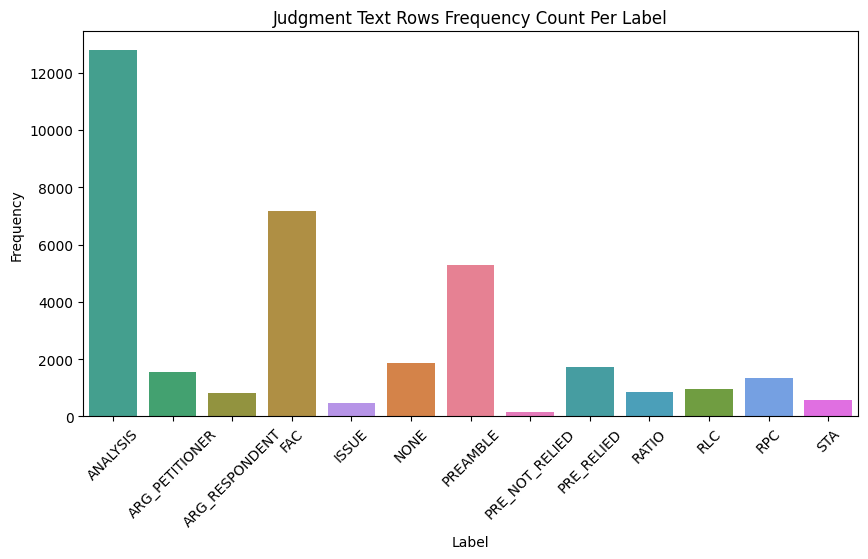

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
print("\nLabel Distribution:")
print(df['labels'].value_counts())

plt.figure(figsize=(10, 5))
sns.countplot(x='labels', data=mydf, order=sorted(mydf['labels'].unique()), hue='labels')
plt.title('Judgment Text Rows Frequency Count Per Label')
plt.xlabel('Label')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

##### Min and Max Length (in characters)

In [ ]:
min_length_text = mydf['text_length'].min()
max_length_text = mydf['text_length'].max()
min_length_processed = mydf['ner_processed_text_length'].min()
max_length_processed = mydf['ner_processed_text_length'].max()

print(f"\nMinimum and Maximum Text Lengths:")
print(f"Judgment Text: Min = {min_length_text}, Max = {max_length_text}")
print(f"NER Processed Text: Min = {min_length_processed}, Max = {max_length_processed}")


Minimum and Maximum Text Lengths:
Judgment Text: Min = 1, Max = 2183
NER Processed Text: Min = 1, Max = 2144


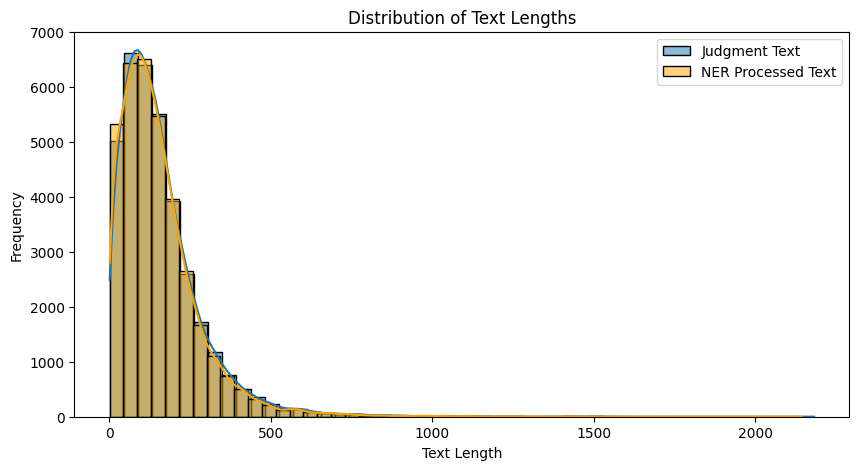

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 5))
sns.histplot(mydf['text_length'], bins=50, kde=True, label='Judgment Text')
sns.histplot(mydf['ner_processed_text_length'], bins=50, kde=True, label='NER Processed Text', color='orange')
plt.title('Distribution of Text Lengths')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.legend()
plt.show()


#####Common Words

In [ ]:
from collections import Counter
from itertools import chain

all_words = list(chain.from_iterable(mydf['text'].str.split()))
word_freq = Counter(all_words)

print("\nMost Common Words in Judgment Text:")
print(word_freq.most_common(10))

all_words = list(chain.from_iterable(mydf['ner_processed_text'].dropna().astype(str).str.split()))
word_freq = Counter(all_words)

print("\nMost Common Words in NER Processed Text:")
print(word_freq.most_common(10))



Most Common Words in Judgment Text:
[('the', 86820), ('of', 46308), ('to', 24455), ('and', 22460), ('in', 18792), ('that', 14262), ('is', 12178), ('was', 10275), ('by', 10231), ('a', 9587)]

Most Common Words in NER Processed Text:
[('the', 87047), ('of', 42926), ('.', 40369), (',', 36142), ('to', 24495), ('and', 21672), ('in', 18998), ('that', 14938), ('is', 12325), ('was', 10363)]


#####Number of Words in Judgment Text and NER Processed Text

In [ ]:
mydf['text_word_count'] = mydf['text'].apply(lambda x: len(x.split()))
mydf['ner_processed_text_word_count'] = mydf['ner_processed_text'].apply(lambda x: len(x.split()))
print("\nWord Count Statistics:")
print(mydf[['text_word_count', 'ner_processed_text_word_count']].describe())
print("\nTotal Word Count for Judgment Text:", sum(mydf['text_word_count']))
print("\nTotal Word Count for NER Processed Text:", sum(mydf['ner_processed_text_word_count']))


# Total Word Count for Judgment Text: 970451

# Total Word Count for NER Processed Text: 1107484


Word Count Statistics:
       text_word_count  ner_processed_text_word_count
count     35557.000000                   35557.000000
mean         27.292826                      28.836094
std          23.112280                      24.582233
min           1.000000                       1.000000
25%          12.000000                      13.000000
50%          22.000000                      24.000000
75%          36.000000                      38.000000
max         370.000000                     449.000000

Total Word Count for Judgment Text: 970451

Total Word Count for NER Processed Text: 1025325


In [ ]:
mydf['text'][5], mydf['ner_processed_text'][5]

("2. The accused is in appeal in the following circumstances:- The appellant was accused of offences punishable under Sections 498A and 306 of the Indian Penal Code, 1860 (Hereinafter referred to as the `IPC', for brevity).",
 "2 . The accused is in appeal in the following circumstances:- The appellant was accused of offences punishable under PROVISION of the STATUTE ( Hereinafter referred to as the ` STATUTE ' , for brevity ) .")

#####Record/Instance Length (Words per instance)

In [ ]:
def instance_length(text):
    return len(text.split())

mydf['instance_length_text'] = mydf['text'].apply(instance_length)
mydf['instance_length_ner_processed'] = mydf['ner_processed_text'].apply(instance_length)

print("\nInstance Length Statistics:")
print(mydf[['instance_length_text', 'instance_length_ner_processed']].describe())
print(f'Average no of words in Record/Instance in Judgment Text: {mydf["instance_length_text"].mean():.2f}')
print(f'Average no of words in Record/Instance in NER Processed Text: {mydf["instance_length_ner_processed"].mean():.2f}')



Instance Length Statistics:
       instance_length_text  instance_length_ner_processed
count          35557.000000                   35557.000000
mean              27.292826                      28.836094
std               23.112280                      24.582233
min                1.000000                       1.000000
25%               12.000000                      13.000000
50%               22.000000                      24.000000
75%               36.000000                      38.000000
max              370.000000                     449.000000
Average no of words in Record/Instance in Judgment Text: 27.29
Average no of words in Record/Instance in NER Processed Text: 28.84


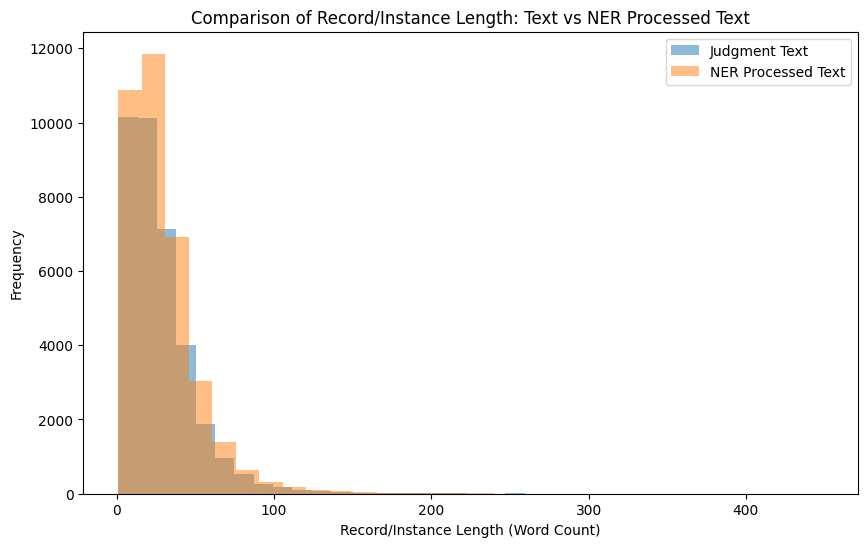

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(mydf['instance_length_text'], bins=30, alpha=0.5, label='Judgment Text')
plt.hist(mydf['instance_length_ner_processed'], bins=30, alpha=0.5, label='NER Processed Text')

plt.xlabel('Record/Instance Length (Word Count)')
plt.ylabel('Frequency')
plt.title('Comparison of Record/Instance Length: Text vs NER Processed Text')

plt.legend()

plt.show()

Total no of words in text:  970451
Total no of words in ner_processed_text:  1025325


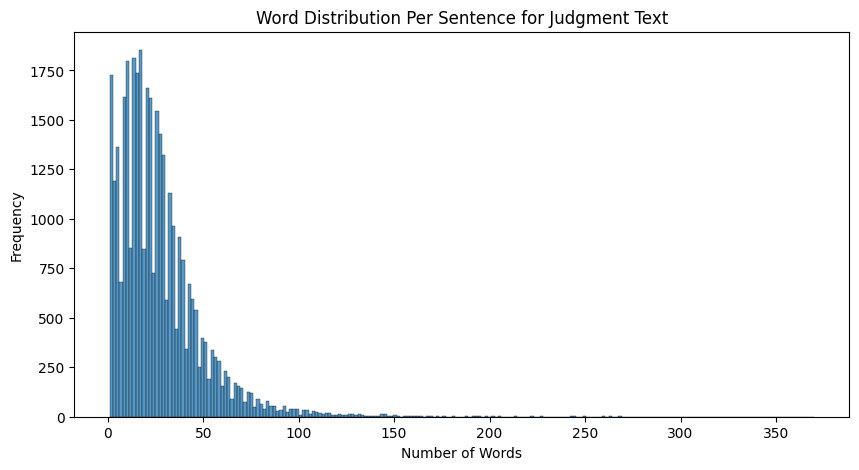

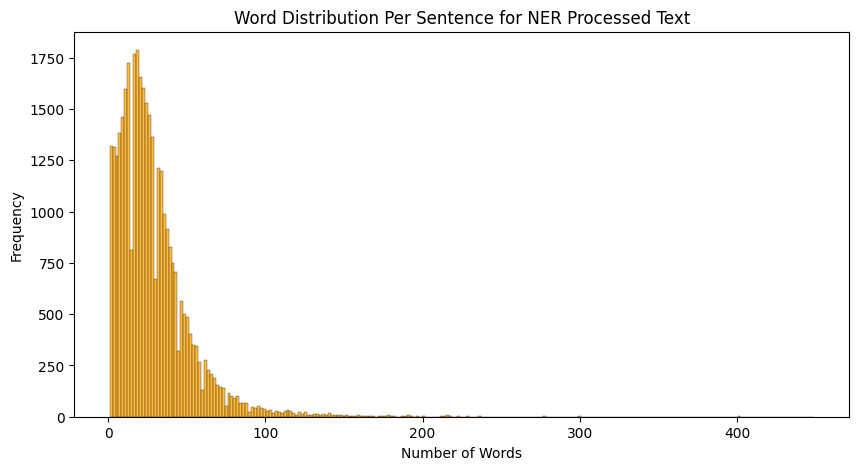

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
def words_per_instance(text):
    return len(text.split())

mydf['words_per_instance_text'] = mydf['text'].apply(words_per_instance)
mydf['words_per_instance_processed'] = mydf['ner_processed_text'].apply(words_per_instance)

print("Total no of words in text: ", sum(mydf['words_per_instance_text']))
print("Total no of words in ner_processed_text: ", sum(mydf['words_per_instance_processed']))

plt.figure(figsize=(10, 5))
sns.histplot(mydf['words_per_instance_text'], bins=len(set(mydf['words_per_instance_text'])), kde=False)
plt.title('Word Distribution Per Sentence for Judgment Text')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.show()

plt.figure(figsize=(10, 5))
sns.histplot(mydf['words_per_instance_processed'], bins=len(set(mydf['words_per_instance_processed'])), kde=False, color='orange')
plt.title('Word Distribution Per Sentence for NER Processed Text')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.show()


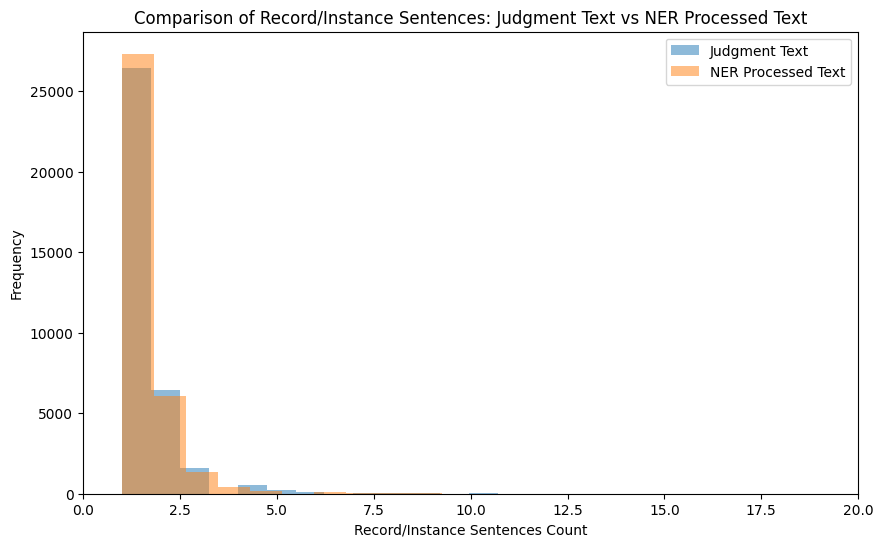

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(mydf['sentences_in_instance_text'], bins=75, alpha=0.5, label='Judgment Text')
plt.hist(mydf['sentences_in_instance_ner_processed'], bins=75, alpha=0.5, label='NER Processed Text')

plt.xlabel('Record/Instance Sentences Count')
plt.ylabel('Frequency')
plt.title('Comparison of Record/Instance Sentences: Judgment Text vs NER Processed Text')
plt.xlim(0, 20)
plt.legend()

plt.show()

##### Sentence Split using Huggingface Legal NER

In [ ]:
# !pip3 install https://huggingface.co/opennyaiorg/en_legal_ner_trf/resolve/main/en_legal_ner_trf-any-py3-none-any.whl

# # Using spacy.load().
# import spacy
# nlp = spacy.load("en_legal_ner_trf")
# nlp.add_pipe('sentencizer')

def sentences_in_instance(text):
    doc = nlp(text)
    return len([x for x in doc.sents])

# mydf['sentences_in_instance_text'] = mydf['text'].apply(sentences_in_instance)
# mydf['sentences_in_instance_ner_processed'] = mydf['ner_processed_text'].apply(sentences_in_instance)

print("Sentences in Row/Instance Statistics:")
print(mydf[['sentences_in_instance_text', 'sentences_in_instance_ner_processed']].describe())
mydf['sentences_in_instance_text'].head(3)

# print("Example of Judgment Text sentences: ",sentences_in_instance(mydf['text'][1]))
# print("Example of NER Processed Text sentences: ",sentences_in_instance(mydf['ner_processed_text'][1]))

print("Total no of sentences in text: ", sum(mydf['sentences_in_instance_text']))
print("Total no of sentences in ner_processed_text: ", sum(mydf['sentences_in_instance_ner_processed']))

print(f'Average no of sentences in Record/Instance in Judgment Text: {mydf["sentences_in_instance_text"].mean():.2f}')
print(f'Average no of sentences in Record/Instance in NER Processed Text: {mydf["sentences_in_instance_ner_processed"].mean():.2f}')


Sentences in Row/Instance Statistics:
       sentences_in_instance_text  sentences_in_instance_ner_processed
count                35557.000000                         35557.000000
mean                     1.363557                             1.286216
std                      0.922179                             0.819251
min                      1.000000                             1.000000
25%                      1.000000                             1.000000
50%                      1.000000                             1.000000
75%                      1.000000                             1.000000
max                     55.000000                            55.000000


/usr/local/lib/python3.10/dist-packages/thinc/shims/pytorch.py:114: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(self._mixed_precision):


Example of Judgment Text sentences:  3
Example of NER Processed Text sentences:  3
Total no of sentences in text:  48484
Total no of sentences in ner_processed_text:  45734
Average no of sentences in Record/Instance in Judgment Text: 1.36
Average no of sentences in Record/Instance in NER Processed Text: 1.29


'\nSentences in Row/Instance Statistics:\n       sentences_in_instance_text  sentences_in_instance_ner_processed\ncount                35557.000000                         35557.000000\nmean                     1.363557                             1.286216\nstd                      0.922179                             0.819251\nmin                      1.000000                             1.000000\n25%                      1.000000                             1.000000\n50%                      1.000000                             1.000000\n75%                      1.000000                             1.000000\nmax                     55.000000                            55.000000\nExample of Judgment Text sentences:  ["BEFORE THE HON\'BLE MR.JUSTICE ANAND BYRAREDDY CRIMINAL APPEAL NO.3532 OF 2012 BETWEEN: R Babu S/o Siddappa, .. APPELLANT Age: 30 Years, Occ: Household, R/o: Sunthan Village, Taluk Chincholi, District Gulbarga.", \'(By Shri Ishwar Raj S.Chowdapur, Advocate) AND: The Stat

In [ ]:
eg1 = [x for x in nlp(mydf['text'][2474]).sents]
eg2 = [x for x in nlp(mydf['ner_processed_text'][2474]).sents]
print(f"Judgment Text, Len: {len(eg1)}, ",eg1)
print(f"NER Text, Len: {len(eg2)}, ",eg2)

print(mydf['text'][2474])
print(mydf['ner_processed_text'][2474])

Judgment Text, Len: 55,  [Ex., P. 1 Complaint Ex., P. Ex., P. 1(a) Signature of PW.1 Ex., P. Ex., P. 1(b) Signature of PW.15 Ex., P. Ex., P. 2 Mahazar Ex., P. Ex., P. 2(a) Signature of PW.2 Ex., P. Ex., P. 2(b) Signature of PW.14 Ex., P. 2(c) Signature of PW.16 Ex., P. Ex., P. 3 Mahazar Ex., P. Ex., P. 3(a) Statement of PW.3 Ex., P. 4 Inquest Mahazar Ex., P. Ex., P. 4(a) & Signature of PW.4 Ex., P. (b) Ex., P. Ex., P. 4(c) Signature of PW.16 Ex., P. Ex., P. 5 F.S.L. Report 5(a) Signature of PW.10 5(b) Signature of Sujatha K.M. 6 FSL Report 6(a) & Signature of PW.11 (b) 6(c) Sample seal 7 Medical record 7(a) Signature of PW.12 8 P.M. Report 8(a) Signature of PW.13 9 Doctor's Report 9(a) Signature of PW.13 Ex., P. 10 Mahazar Ex., P. 10(a) Signature of PW.14 Ex., P. 10(b) Signature of Krishnamurthy Ex., P. 10(c) Signature of PW.16 Ex., P. 11 FIR Ex., P. 11(a) Signature of PW.15 Ex., P. 12 Voluntary statement of the accused Ex., P. 12(a) Signature of the accused Ex., P. 12(b) Signature of 

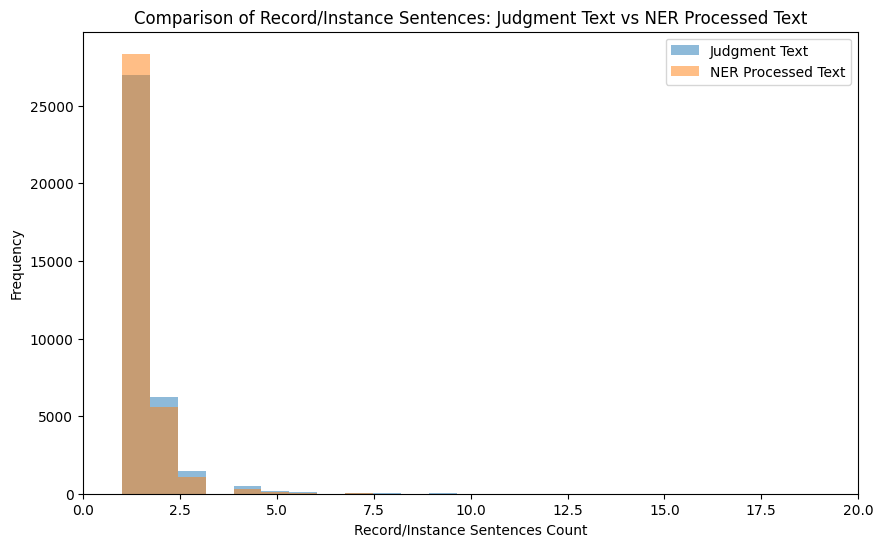

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(mydf['sentences_in_instance_text'], bins=75, alpha=0.5, label='Judgment Text')
plt.hist(mydf['sentences_in_instance_ner_processed'], bins=75, alpha=0.5, label='NER Processed Text')

plt.xlabel('Record/Instance Sentences Count')
plt.ylabel('Frequency')
plt.title('Comparison of Record/Instance Sentences: Judgment Text vs NER Processed Text')
plt.xlim(0, 20)
plt.legend()

plt.show()

In [ ]:
print( 'v' in ' '.join(df[df['labels'] == 'PRE_NOT_RELIED']['text']))

True


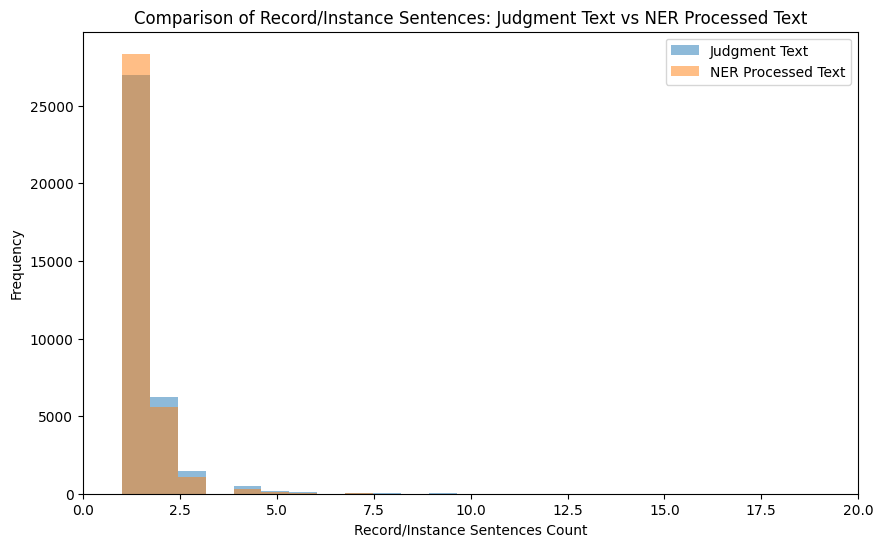

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(mydf['sentences_in_instance_text'], bins=75, alpha=0.5, label='Judgment Text')
plt.hist(mydf['sentences_in_instance_ner_processed'], bins=75, alpha=0.5, label='NER Processed Text')

plt.xlabel('Record/Instance Sentences Count')
plt.ylabel('Frequency')
plt.title('Comparison of Record/Instance Sentences: Judgment Text vs NER Processed Text')
plt.xlim(0, 20)
plt.legend()

plt.show()

##### Vocabulary (Unique words) and Type-Token Ratio

In [ ]:
import pandas as pd

def calculate_ttr_and_vocab(column):
    tokens = column.str.split().explode()  # Split by whitespace and flatten
    vocab = set(tokens)

    num_types = len(vocab)
    num_tokens = len(tokens)
    ttr = num_types / num_tokens if num_tokens > 0 else 0

    vocab_size = len(vocab)

    return ttr, vocab_size

ttr_text, vocab_text = calculate_ttr_and_vocab(mydf['text'])
ttr_ner, vocab_ner = calculate_ttr_and_vocab(mydf['ner_processed_text'])

print(f"Vocabulary Size (Unique Words) in Judgment Text: {vocab_text}, Type Token Ratio: {ttr_text:.4f} ")
print(f"Vocabulary Size (Unique Words) in NER Processed Text : {vocab_ner}, Type Token Ratio: {ttr_ner:.4f}")
print(f"Reduction in Vocab size:  {((vocab_text-vocab_ner)*100/vocab_text):.2f}%")

Vocabulary Size (Unique Words) in Judgment Text: 55646, Type Token Ratio: 0.0573 
Vocabulary Size (Unique Words) in NER Processed Text : 24801, Type Token Ratio: 0.0242
Reduction in Vocab size:  55.43%


#####Word distribution per label Plot

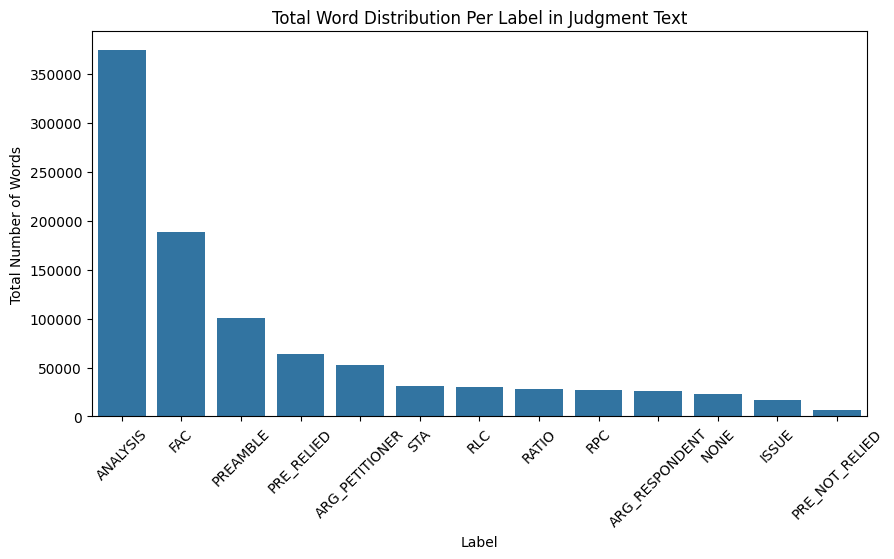

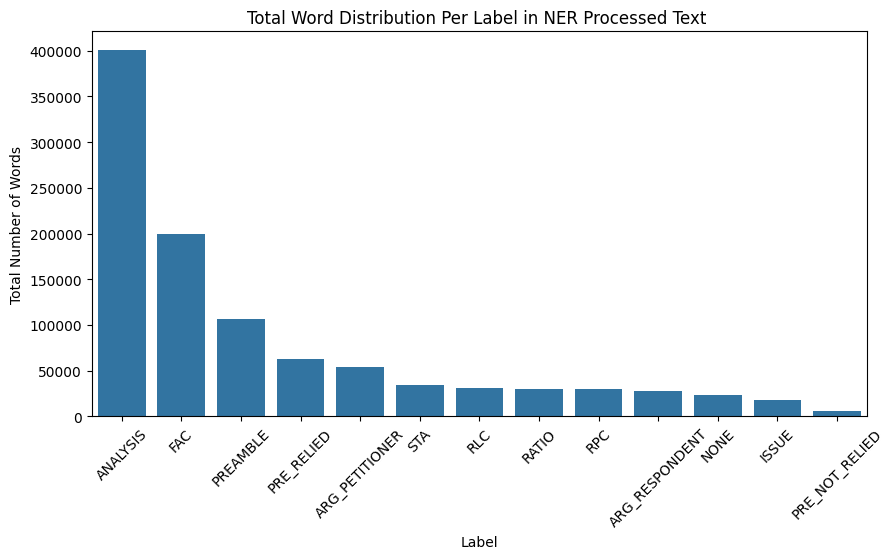

In [ ]:
mydf['label_word_count'] = mydf['text'].apply(lambda x: len(x.split()))
mydf['label_word_count_pr'] = mydf['ner_processed_text'].apply(lambda x: len(x.split()))
total_words_per_label_text = mydf.groupby('labels')['label_word_count'].sum().reset_index()
total_words_per_label_text = total_words_per_label_text.sort_values(by='label_word_count', ascending=False)

plt.figure(figsize=(10, 5))
sns.barplot(x='labels', y='label_word_count', data=total_words_per_label_text)
plt.title('Total Word Distribution Per Label in Judgment Text')
plt.xlabel('Label')
plt.ylabel('Total Number of Words')
plt.xticks(rotation=45)
plt.show()

total_words_per_label = mydf.groupby('labels')['label_word_count_pr'].sum().reset_index()
total_words_per_label = total_words_per_label.sort_values(by='label_word_count_pr', ascending=False)

plt.figure(figsize=(10, 5))
sns.barplot(x='labels', y='label_word_count_pr', data=total_words_per_label)
plt.title('Total Word Distribution Per Label in NER Processed Text ')
plt.xlabel('Label')
plt.ylabel('Total Number of Words')
plt.xticks(rotation=45)
plt.show()

In [ ]:
word_stats_per_label = mydf.groupby('labels')['label_word_count'].agg(['max', 'min', 'mean']).reset_index()
word_stats_per_label.columns = ['Label', 'Max Words', 'Min Words', 'Average Words']

print("Summary Table: Max, Min, and Average Number of Words Per Label in Judgment Text")
print(word_stats_per_label)


word_stats_per_label_pr = mydf.groupby('labels')['label_word_count_pr'].agg(['max', 'min', 'mean']).reset_index()
word_stats_per_label_pr.columns = ['Label', 'Max Words', 'Min Words', 'Average Words']

print("\nSummary Table: Max, Min, and Average Number of Words Per Label in NER Processed Text")
print(word_stats_per_label_pr)

Summary Table: Max, Min, and Average Number of Words Per Label in Judgment Text
             Label  Max Words  Min Words  Average Words
0         ANALYSIS        306          1      29.289007
1   ARG_PETITIONER        217          1      33.624362
2   ARG_RESPONDENT        215          1      32.375155
3              FAC        352          1      26.198524
4            ISSUE        242          1      37.519651
5             NONE        263          1      12.360947
6         PREAMBLE        274          1      19.085183
7   PRE_NOT_RELIED        150          1      39.052632
8       PRE_RELIED        250          1      37.198714
9            RATIO        144          1      32.172018
10             RLC        228          1      32.256356
11             RPC        169          1      20.299189
12             STA        370          1      56.307692

Summary Table: Max, Min, and Average Number of Words Per Label in NER Processed Text
             Label  Max Words  Min Words  Average 

##### Wordcloud Analysis of tokens in Labels


 Judgment Text


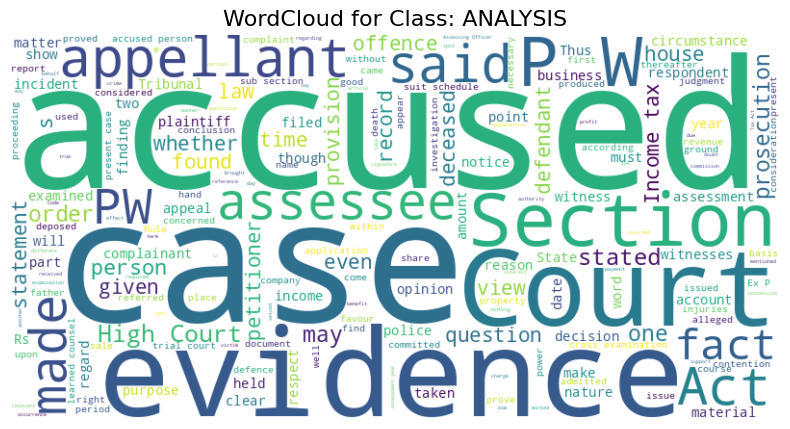


 Processed Text


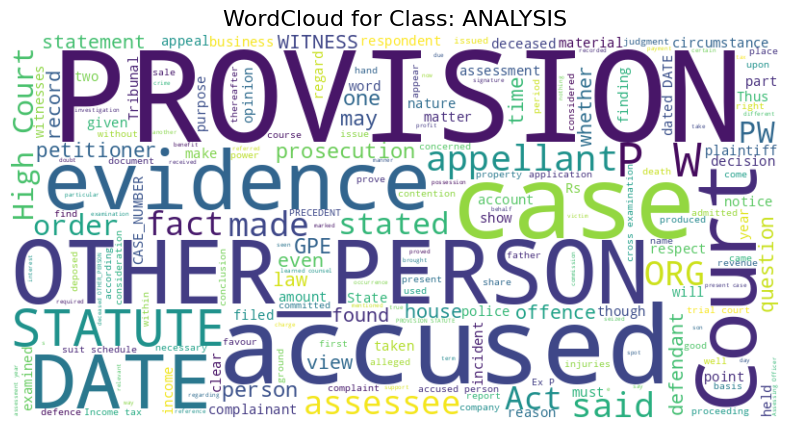


 Judgment Text


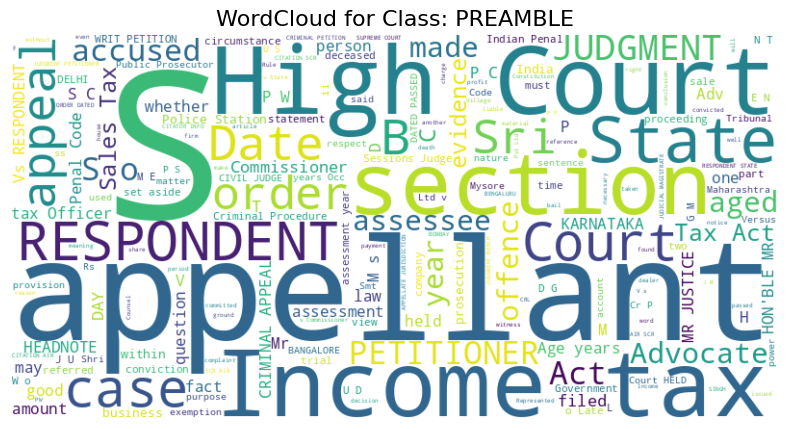


 Processed Text


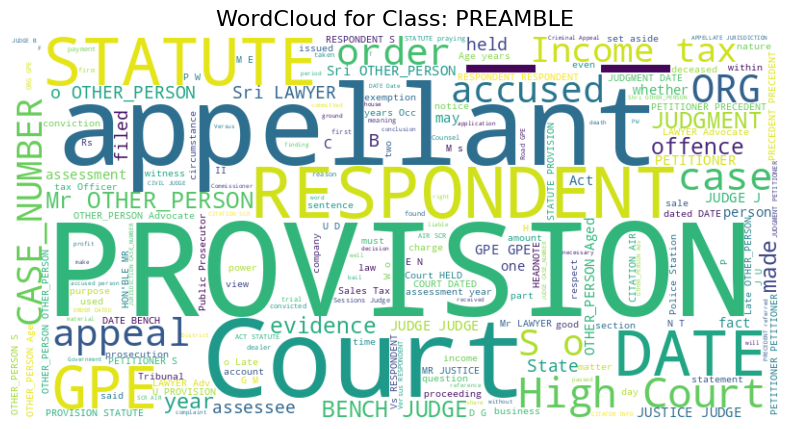


 Judgment Text


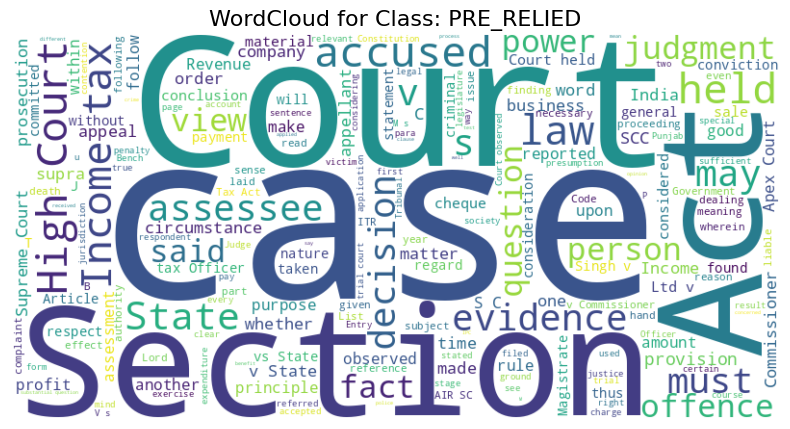


 Processed Text


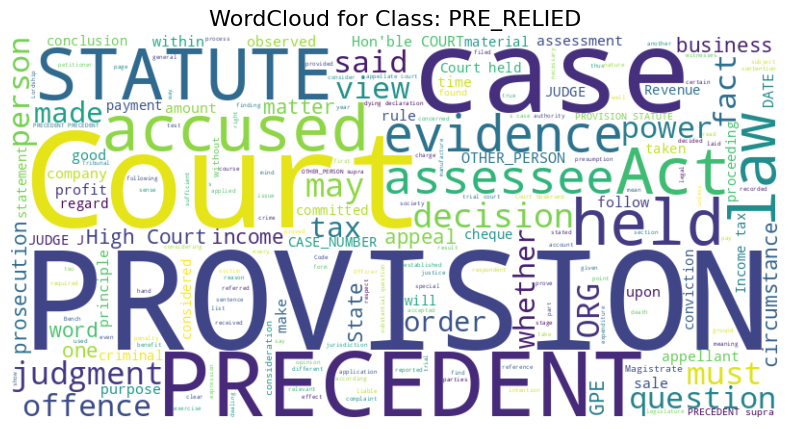


 Judgment Text


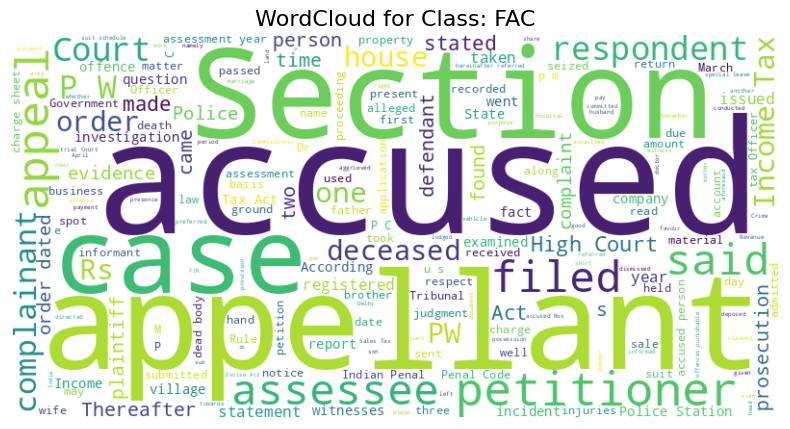


 Processed Text


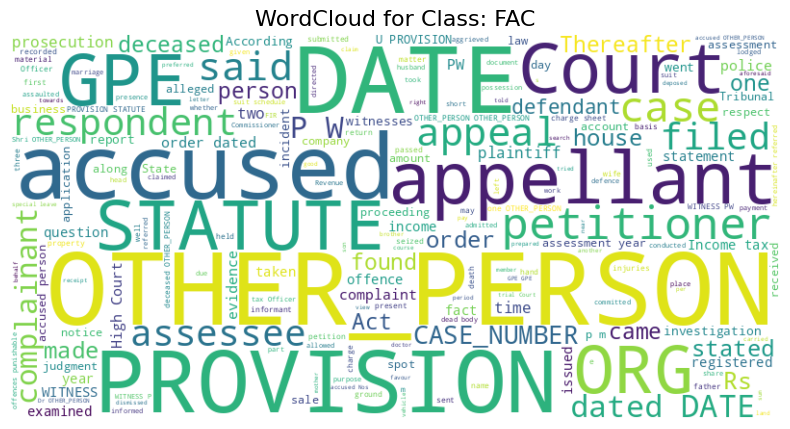


 Judgment Text


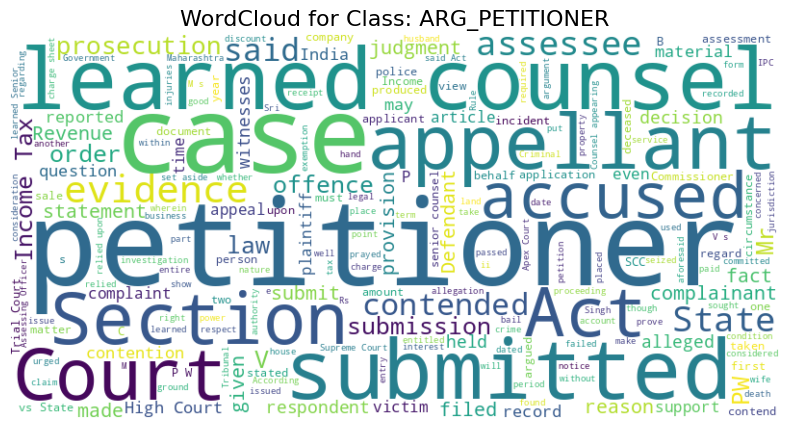


 Processed Text


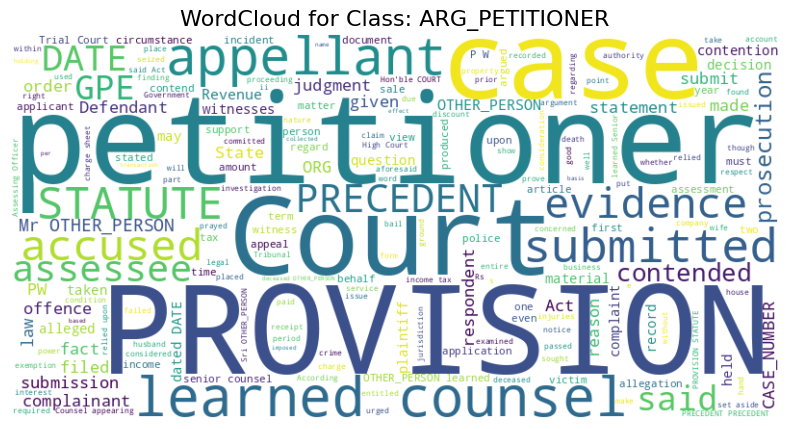


 Judgment Text


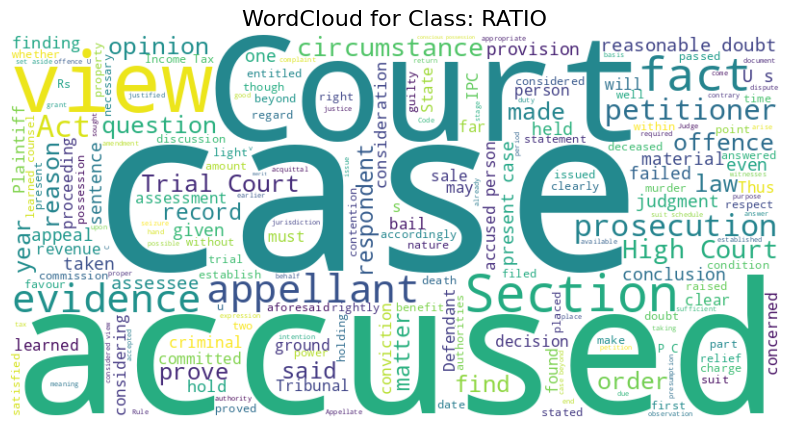


 Processed Text


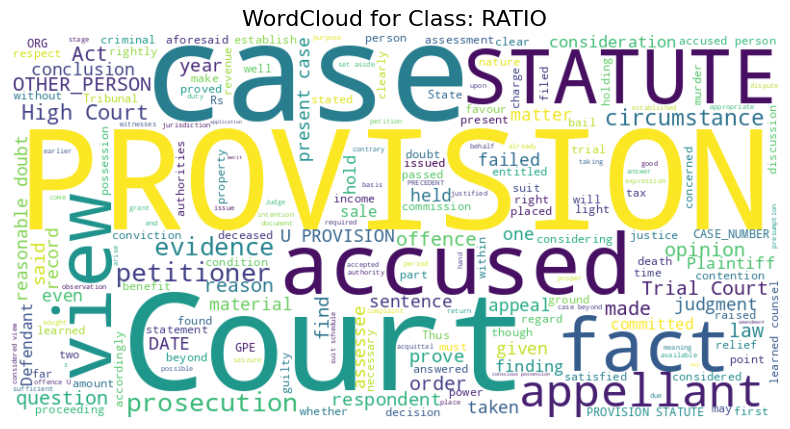


 Judgment Text


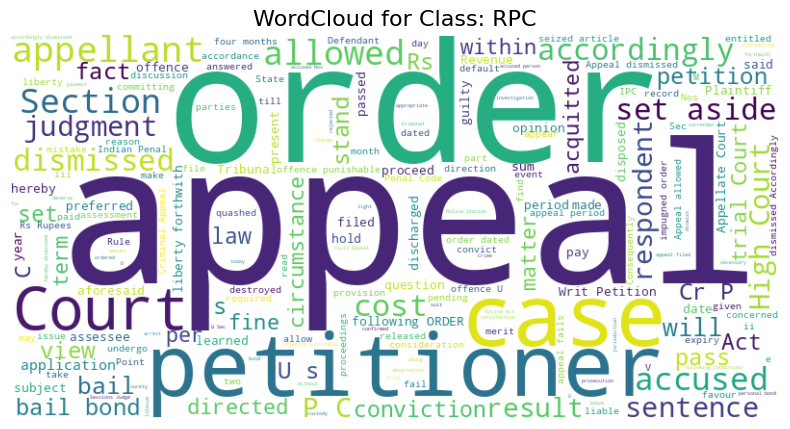


 Processed Text


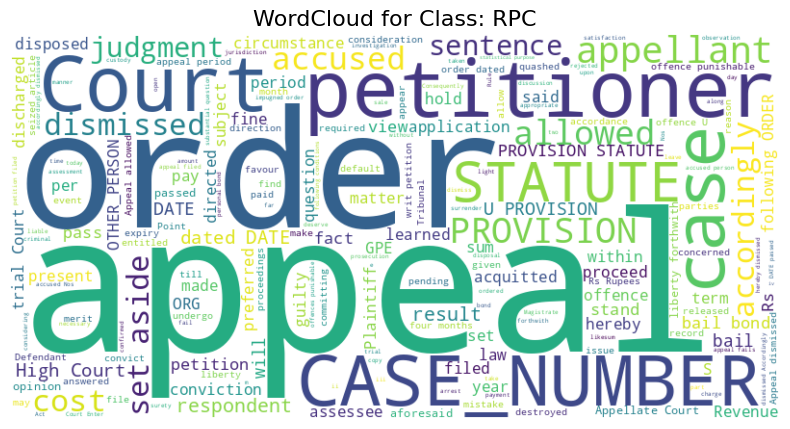


 Judgment Text


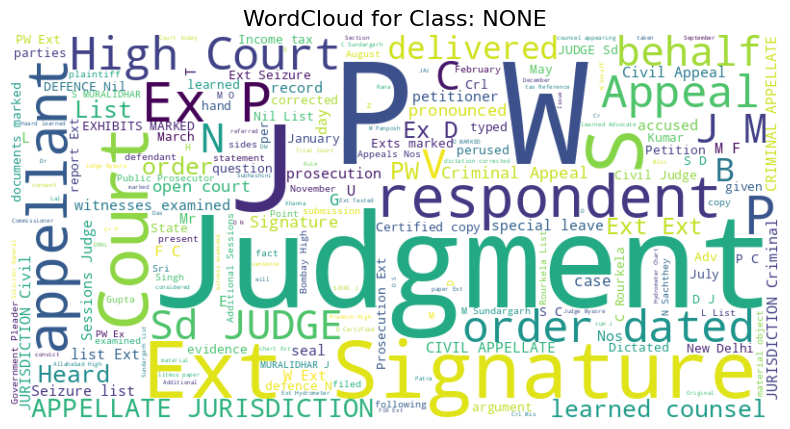


 Processed Text


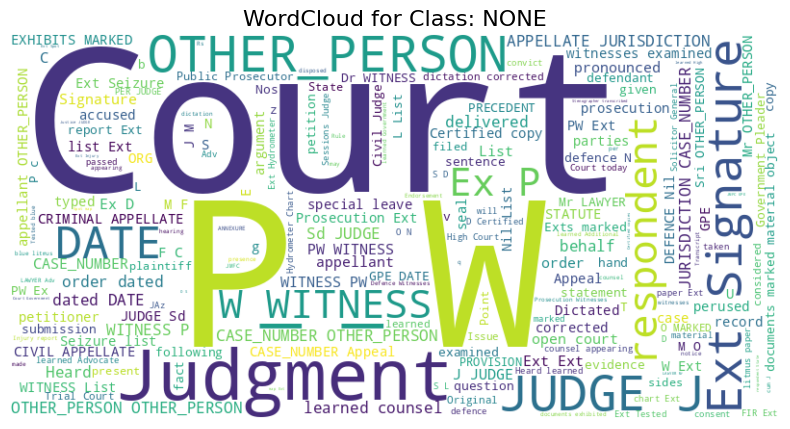


 Judgment Text


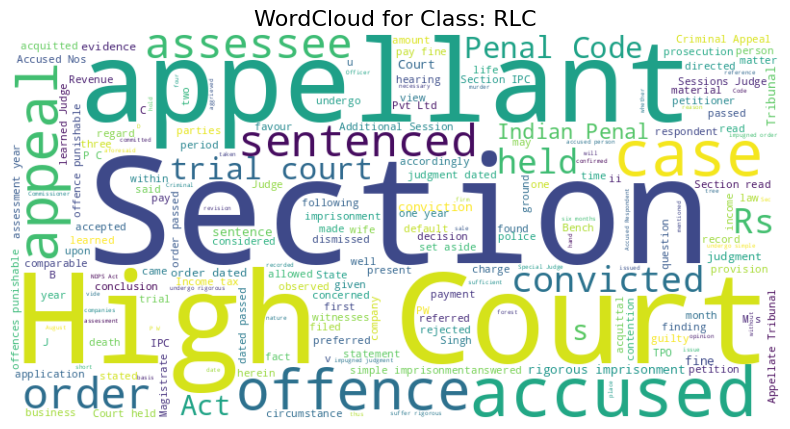


 Processed Text


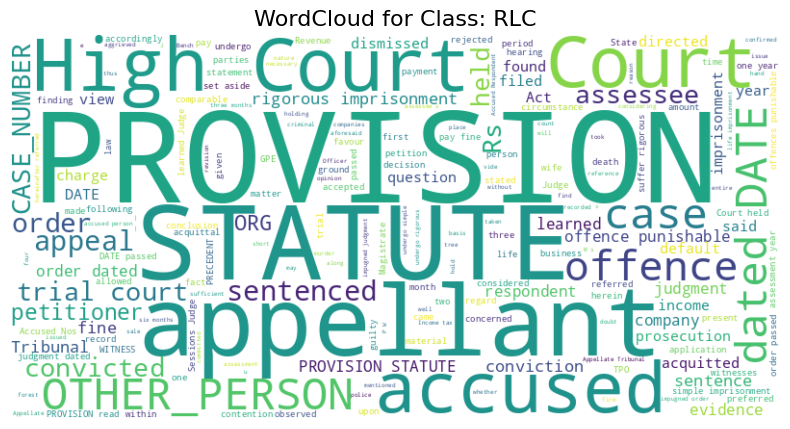


 Judgment Text


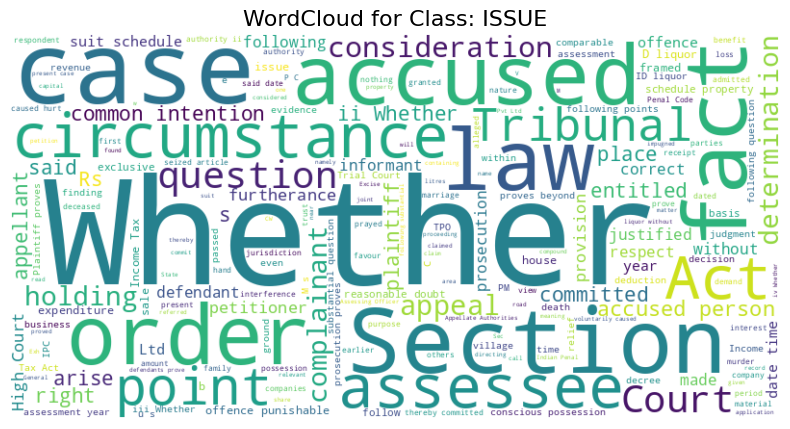


 Processed Text


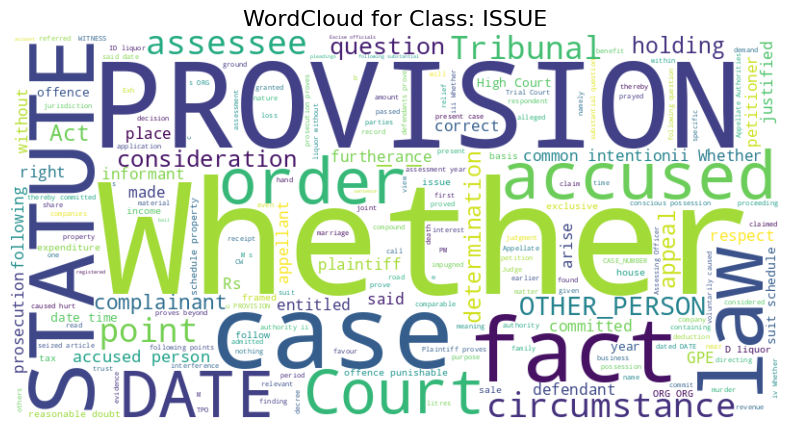


 Judgment Text


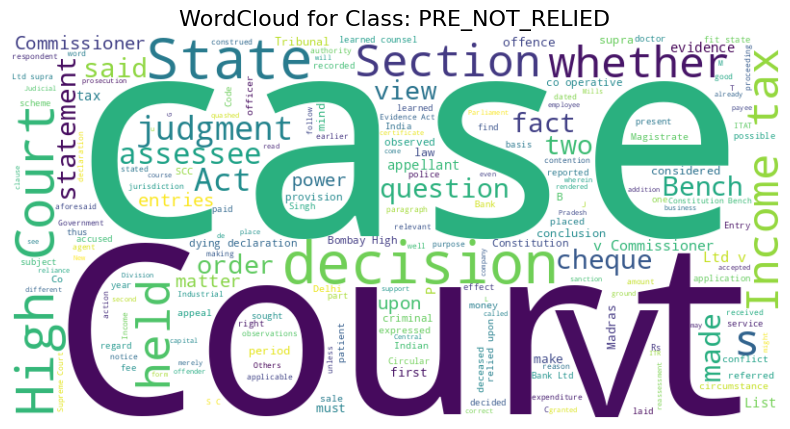


 Processed Text


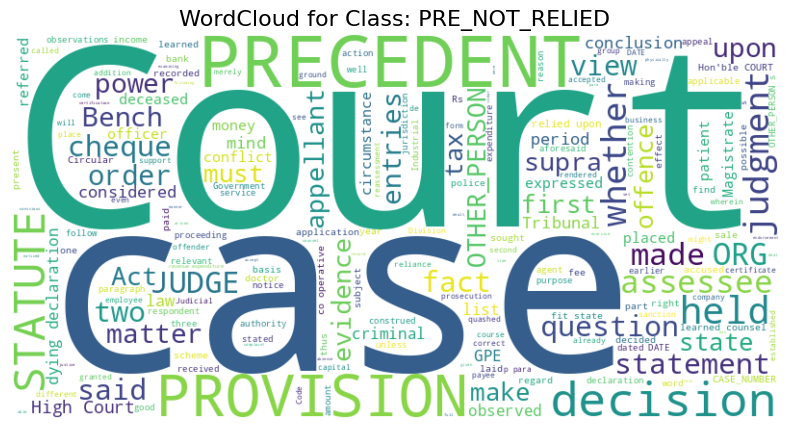


 Judgment Text


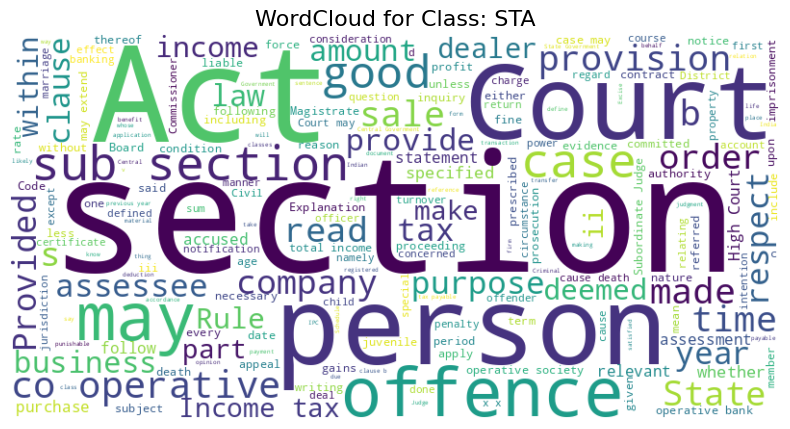


 Processed Text


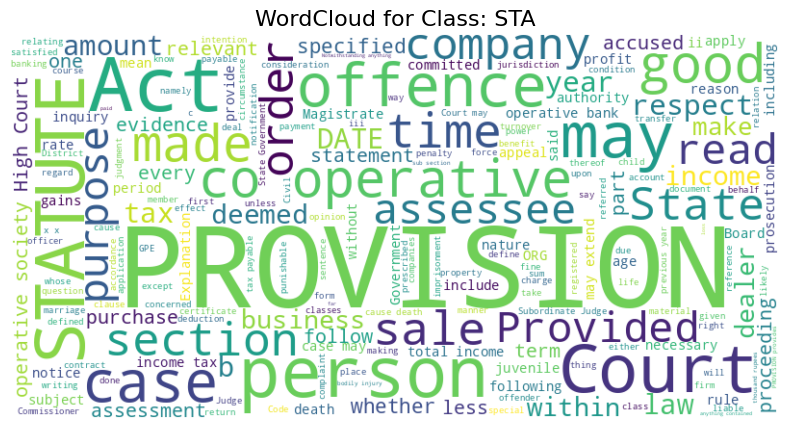


 Judgment Text


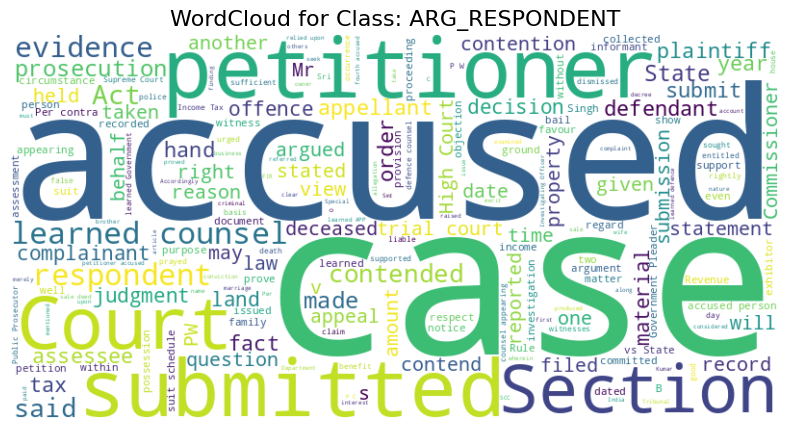


 Processed Text


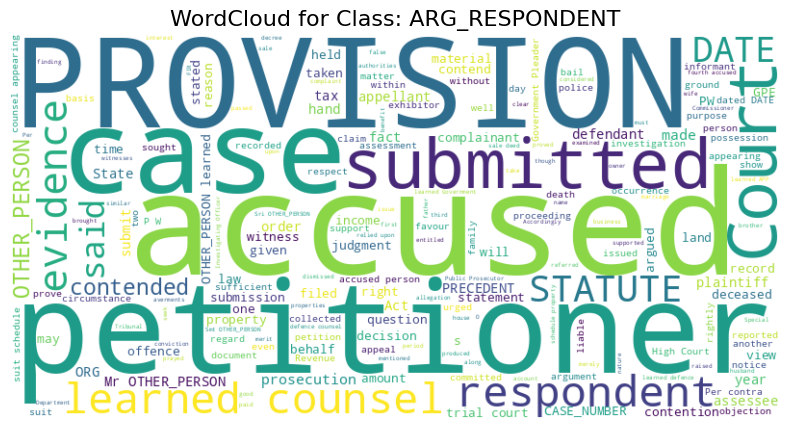

In [ ]:
!pip install wordcloud matplotlib
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Function to generate and plot WordCloud
def plot_wordcloud(text_data, class_label):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(text_data))

    # Plotting the WordCloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'WordCloud for Class: {class_label}', fontsize=16)
    plt.show()

'''
  	       RLC       0.46      0.46      0.46       180
PRE_NOT_RELIED       0.00      0.00      0.00        27
    PRE_RELIED       0.62      0.39      0.48       347
         RATIO       0.51      0.23      0.32       176
           STA       0.64      0.58      0.61       120
ARG_RESPONDENT       0.65      0.11      0.18       158
ARG_PETITIONER       0.52      0.54      0.53       310

'''

# Plot WordCloud for each low-performing class
for class_label in set(df.labels.to_list()):
    print("\n Judgment Text")
    class_texts = df[df['labels'] == class_label]['text']
    plot_wordcloud(class_texts, class_label)
    print("\n Processed Text")
    class_texts = df[df['labels'] == class_label]['ner_text']
    plot_wordcloud(class_texts, class_label)


In [ ]:
set(df.labels.to_list())

{'ANALYSIS',
 'ARG_PETITIONER',
 'ARG_RESPONDENT',
 'FAC',
 'ISSUE',
 'NONE',
 'PREAMBLE',
 'PRE_NOT_RELIED',
 'PRE_RELIED',
 'RATIO',
 'RLC',
 'RPC',
 'STA'}

## Models

### NER Text - Model (3) ***

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_Dataset.csv')
df.head()

In [ ]:
from sklearn.model_selection import train_test_split
texts = df['ner_text'].tolist()
labels = df['labels'].tolist()
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

Train set shape: 28445
Test set shape: 7112


In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['ner_text'].tolist()
labels = df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    # if not isinstance(texts, list) or not all(isinstance(text, str) for text in texts):
    #     texts = [str(text) for text in texts]
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )


train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.160500,1.006689,0.671963,0.653032,"{'0': {'precision': 0.5625, 'recall': 0.25, 'f1-score': 0.34615384615384615, 'support': 180.0}, '1': {'precision': 0.6443958788635654, 'recall': 0.8046783625730994, 'f1-score': 0.7156726768377254, 'support': 2565.0}, '2': {'precision': 0.7263636363636363, 'recall': 0.7645933014354067, 'f1-score': 0.7449883449883449, 'support': 1045.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.6643835616438356, 'recall': 0.27953890489913547, 'f1-score': 0.3935091277890467, 'support': 347.0}, '5': {'precision': 0.6585365853658537, 'recall': 0.1534090909090909, 'f1-score': 0.24884792626728108, 'support': 176.0}, '6': {'precision': 0.8356940509915014, 'recall': 0.7642487046632125, 'f1-score': 0.7983761840324763, 'support': 386.0}, '7': {'precision': 0.696969696969697, 'recall': 0.8313253012048193, 'f1-score': 0.7582417582417583, 'support': 83.0}, '8': {'precision': 0.7012987012987013, 'recall': 0.45, 'f1-score': 0.5482233502538071, 'support': 120.0}, '9': {'precision': 0.5769230769230769, 'recall': 0.0949367088607595, 'f1-score': 0.16304347826086957, 'support': 158.0}, '10': {'precision': 0.4672897196261682, 'recall': 0.4838709677419355, 'f1-score': 0.4754358161648177, 'support': 310.0}, '11': {'precision': 0.70201643017177, 'recall': 0.6460481099656358, 'f1-score': 0.6728704366499642, 'support': 1455.0}, '12': {'precision': 0.6850152905198776, 'recall': 0.8615384615384616, 'f1-score': 0.7632027257240204, 'support': 260.0}, 'accuracy': 0.671962879640045, 'macro avg': {'precision': 0.6093374329798218, 'recall': 0.4910913779839659, 'f1-score': 0.5098896670279968, 'support': 7112.0}, 'weighted avg': {'precision': 0.6692565716479116, 'recall': 0.671962879640045, 'f1-score': 0.6530322093456737, 'support': 7112.0}}"
2,0.994500,0.959282,0.692913,0.682906,"{'0': {'precision': 0.4585635359116022, 'recall': 0.46111111111111114, 'f1-score': 0.45983379501385047, 'support': 180.0}, '1': {'precision': 0.6682103870327489, 'recall': 0.7875243664717348, 'f1-score': 0.7229778095919829, 'support': 2565.0}, '2': {'precision': 0.9107373868046572, 'recall': 0.6736842105263158, 'f1-score': 0.7744774477447744, 'support': 1045.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.6227272727272727, 'recall': 0.39481268011527376, 'f1-score': 0.4832451499118166, 'support': 347.0}, '5': {'precision': 0.5125, 'recall': 0.23295454545454544, 'f1-score': 0.3203125, 'support': 176.0}, '6': {'precision': 0.8209366391184573, 'recall': 0.772020725388601, 'f1-score': 0.7957276368491322, 'support': 386.0}, '7': {'precision': 0.810126582278481, 'recall': 0.7710843373493976, 'f1-score': 0.7901234567901234, 'support': 83.0}, '8': {'precision': 0.6422018348623854, 'recall': 0.5833333333333334, 'f1-score': 0.6113537117903931, 'support': 120.0}, '9': {'precision': 0.6538461538461539, 'recall': 0.10759493670886076, 'f1-score': 0.18478260869565216, 'support': 158.0}, '10': {'precision': 0.5235109717868338, 'recall': 0.5387096774193548, 'f1-score': 0.5310015898251191, 'support': 310.0}, '11': {'precision': 0.6680722891566265, 'recall': 0.7621993127147766, 'f1-score': 0.7120385232744783, 'support': 1455.0}, '12': {'precision': 0.7813620071684588, 'recall': 0.8384615384615385, 'f1-score': 0.8089053803339518, 'support': 260.0}, 'accuracy': 0.6929133858267716, 'macro avg': {'precision': 0.6209842354379753, 'recall': 0.5325762134657571, 'f1-score': 0.5534445853708674, 'support': 7112.0}, 'weighted avg': {'precision': 0.6969192459801669, 'recall': 0.6929133858267716, 'f1-score': 0.6829062598483837, 'support': 7112.0}}"
3,0.539900,0.975831,0.685602,0.679931,"{'0': {'precision': 0.47096774193548385, 'recall': 0.40555555555555556, 'f1-score': 0.43582089552238806, 'support': 180.0}, '1': {'precision': 0.6763268156424581, 'recall': 0.7551656920077973, 'f1-score': 0.7135752440596795, 'support': 2565.0}, '2': {'precis

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.5

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.4

Accuracy: 0.6929
F1 Score: 0.6829
Classification Report:
{'0': {'precision': 0.4585635359116022, 'recall': 0.46111111111111114, 'f1-score': 0.45983379501385047, 'support': 180.0}, '1': {'precision': 0.6682103870327489, 'recall': 0.7875243664717348, 'f1-score': 0.7229778095919829, 'support': 2565.0}, '2': {'precision': 0.9107373868046572, 'recall': 0.6736842105263158, 'f1-score': 0.7744774477447744, 'support': 1045.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '4': {'precision': 0.6227272727272727, 'recall': 0.39481268011527376, 'f1-score': 0.4832451499118166, 'support': 347.0}, '5': {'precision': 0.5125, 'recall': 0.23295454545454544, 'f1-score': 0.3203125, 'support': 176.0}, '6': {'precision': 0.8209366391184573, 'recall': 0.772020725388601, 'f1-score': 0.7957276368491322, 'support': 386.0}, '7': {'precision': 0.810126582278481, 'recall': 0.7710843373493976, 'f1-score': 0.7901234567901234, 'support': 83.0}, '8': {'precision': 0.6422018348623854, 'recall

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6929
F1 Score: 0.6829
Classification Report:
                precision    recall  f1-score   support

           RLC       0.46      0.46      0.46       180
      ANALYSIS       0.67      0.79      0.72      2565
      PREAMBLE       0.91      0.67      0.77      1045
PRE_NOT_RELIED       0.00      0.00      0.00        27
    PRE_RELIED       0.62      0.39      0.48       347
         RATIO       0.51      0.23      0.32       176
          NONE       0.82      0.77      0.80       386
         ISSUE       0.81      0.77      0.79        83
           STA       0.64      0.58      0.61       120
ARG_RESPONDENT       0.65      0.11      0.18       158
ARG_PETITIONER       0.52      0.54      0.53       310
           FAC       0.67      0.76      0.71      1455
           RPC       0.78      0.84      0.81       260

      accuracy                           0.69      7112
     macro avg       0.62      0.53      0.55      7112
  weighted avg       0.70      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
texts

### New Masked NER Dataset

In [ ]:
# !pip install -U spacy
# !pip install spacy-transformers
# !python -m spacy download en_core_web_trf
import spacy

# Load the saved model from the directory
nlp = spacy.load("/content/drive/MyDrive/en_legal_ner_trf")
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/NER_Dataset.csv')
df.head()

/usr/local/lib/python3.10/dist-packages/spacy/util.py:910: UserWarning: [W095] Model 'en_legal_ner_trf' (3.2.0) was trained with spaCy v3.2.2 and may not be 100% compatible with the current version (3.7.6). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)
/usr/local/lib/python3.10/dist-packages/transformers/utils/generic.py:441: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  _torch_pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/transformers/utils/generic.py:309: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  _torch_pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/transformers/util

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
!pip install tqdm
from tqdm.notebook import tqdm
import pandas as pd
import spacy

# Enable tqdm for pandas
tqdm.pandas()

def replace_ents_with_labels(text):
    doc = nlp(text)
    processed_text = []
    last_index = 0

    for ent in doc.ents:
        processed_text.append(text[last_index:ent.start_char])
        processed_text.append(ent.label_)
        last_index = ent.end_char

    processed_text.append(text[last_index:])
    return ''.join(processed_text)

df['new_ner'] = df['cleaned_text'].progress_apply(replace_ents_with_labels)
df.head()

In [ ]:
#df.to_csv('/content/drive/My Drive/NER_masked_dataset.csv', index=False)

from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/NER_masked_dataset.csv')
df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
def instance_length(text):
    return len(text.split())

df['instance_length_text'] = df['text'].apply(instance_length)
df['instance_length_new_ner'] = df['new_ner'].apply(instance_length)

print("\nInstance Length Statistics:")
print(df[['instance_length_text', 'instance_length_new_ner']].describe())
print(f'Average no of words in Record/Instance in Judgment Text: {df["instance_length_text"].mean():.2f}')
print(f'Average no of words in Record/Instance in NER Masked Text: {df["instance_length_new_ner"].mean():.2f}')
# Instance Length Statistics:
#        instance_length_text  instance_length_ner_processed
# count          35557.000000                   35557.000000
# mean              27.292826                      28.836094
# std               23.112280                      24.582233
# min                1.000000                       1.000000
# 25%               12.000000                      13.000000
# 50%               22.000000                      24.000000
# 75%               36.000000                      38.000000
# max              370.000000                     449.000000
# Average no of words in Record/Instance in NER Processed Text: 28.84


Instance Length Statistics:
       instance_length_text  instance_length_new_ner
count          35557.000000             35557.000000
mean              27.292826                25.560902
std               23.112280                21.822797
min                1.000000                 1.000000
25%               12.000000                11.000000
50%               22.000000                21.000000
75%               36.000000                34.000000
max              370.000000               354.000000
Average no of words in Record/Instance in Judgment Text: 27.29
Average no of words in Record/Instance in NER Masked Text: 25.56


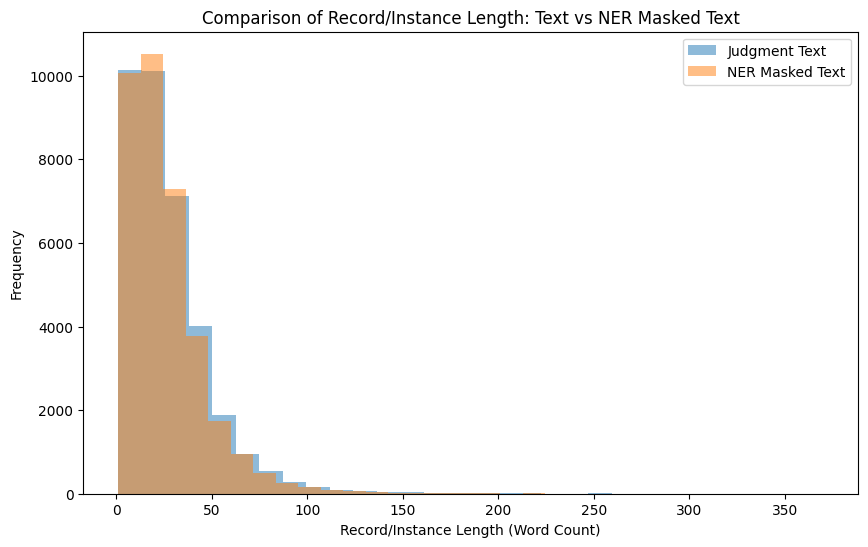

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(df['instance_length_text'], bins=30, alpha=0.5, label='Judgment Text')
plt.hist(df['instance_length_new_ner'], bins=30, alpha=0.5, label='NER Masked Text')

plt.xlabel('Record/Instance Length (Word Count)')
plt.ylabel('Frequency')
plt.title('Comparison of Record/Instance Length: Text vs NER Masked Text')

plt.legend()

plt.show()

Total no of words in text:  970451
Total no of words in new_ner:  908869


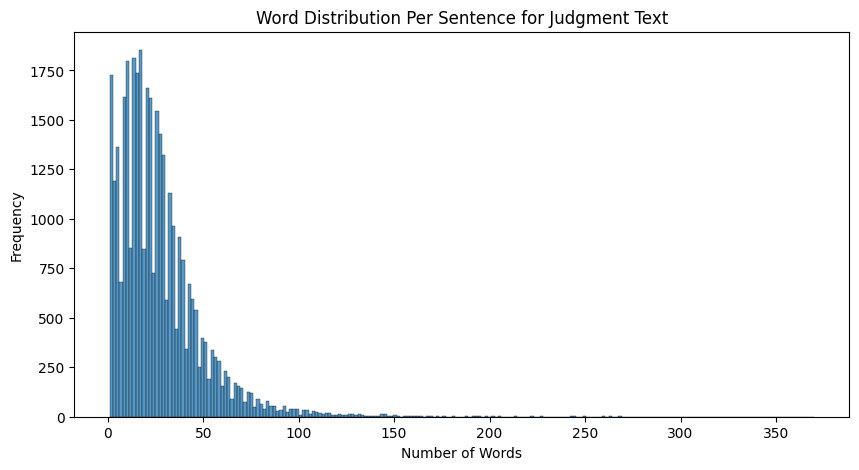

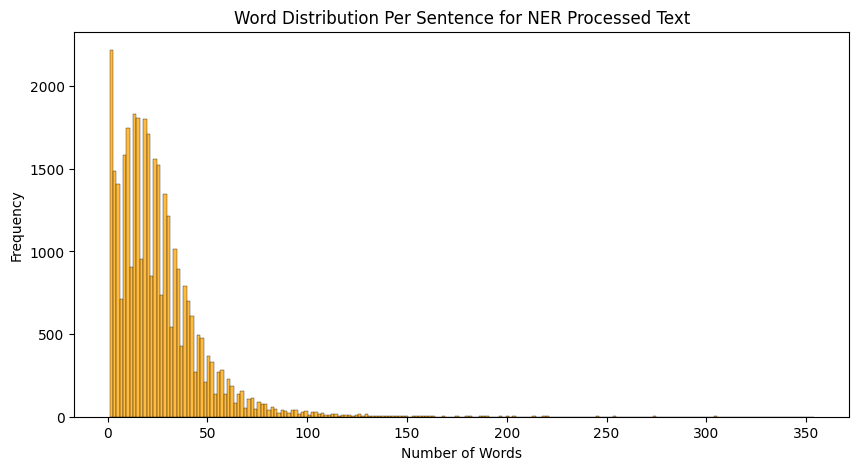

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
def words_per_instance(text):
    return len(text.split())

df['words_per_instance_text'] = df['text'].apply(words_per_instance)
df['words_per_instance_processed'] = df['new_ner'].apply(words_per_instance)

print("Total no of words in text: ", sum(df['words_per_instance_text']))
print("Total no of words in new_ner: ", sum(df['words_per_instance_processed']))

plt.figure(figsize=(10, 5))
sns.histplot(df['words_per_instance_text'], bins=len(set(df['words_per_instance_text'])), kde=False)
plt.title('Word Distribution Per Sentence for Judgment Text')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.show()

plt.figure(figsize=(10, 5))
sns.histplot(df['words_per_instance_processed'], bins=len(set(df['words_per_instance_processed'])), kde=False, color='orange')
plt.title('Word Distribution Per Sentence for NER Processed Text')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.show()
#Total no of words in ner_processed_text:  1025325

#####Vocabulary (Unique words) and Type-Token Ratio

In [ ]:
import pandas as pd

def calculate_ttr_and_vocab(column):
    tokens = column.str.split().explode()  # Split by whitespace and flatten
    vocab = set(tokens)

    num_types = len(vocab)
    num_tokens = len(tokens)
    ttr = num_types / num_tokens if num_tokens > 0 else 0

    vocab_size = len(vocab)

    return ttr, vocab_size

ttr_text, vocab_text = calculate_ttr_and_vocab(df['text'])
ttr_ner, vocab_ner = calculate_ttr_and_vocab(df['new_ner'])

print(f"Vocabulary Size (Unique Words) in Judgment Text: {vocab_text}, Type Token Ratio: {ttr_text:.4f} ")
print(f"Vocabulary Size (Unique Words) in NER Processed Text : {vocab_ner}, Type Token Ratio: {ttr_ner:.4f}")
print(f"Reduction in Vocab size:  {((vocab_text-vocab_ner)*100/vocab_text):.2f}%")

Vocabulary Size (Unique Words) in Judgment Text: 55646, Type Token Ratio: 0.0573 
Vocabulary Size (Unique Words) in NER Processed Text : 41092, Type Token Ratio: 0.0452
Reduction in Vocab size:  26.15%


In [ ]:
print(set(df['new_ner'].str.split().explode())-set(df['ner_text'].str.split().explode()))
'authorisation.' in set(df['ner_text'].str.split().explode())

{'dasti.', 'because,', '"deemed', '"come', "'Asthana',", 'authorisation.', 'Petitioner-accused', 'father,brother', 'prudence,', 'lotteries,', 'upon,', 'forged.', 'accused-appellants', "rare'", 'more?', 'inter-State', 'properties;', 'stomach.', 'Tahsildar,', 'lives,', 'needs.', 'cores,', 'P.W.8:WITNESS', 'Agents,', '7.24%.', 'seizure;', 're-considered', 'accused."', '1952-53.', '45.', 'sub-section', 'eyewitness,', '1918,', 'l,', 'reduced,', '?the', "'settlor", '14.08.2018),', 'Baramati,', 'wool;', 'Prosecutor,', 'and-even', 'loss.', 'identical,', 'petitioner-Society,', 'page-3,', '(1960)', 'practice".', '"available', 'Respondent-State', 'sense,', 'machine,', 'GPE;', 'assessee.”', 'examination."', 'attracted-What', 'schedule,', 'E-H,', '[266', 'Facts:', 'The.', 'applicable.', 'V,', 'directors/principal', 'body,', '(2)588', 'get,', "'winnings'", 'Kanakadasanagara,', 'PRECEDENT."', "`Suresh'", '1870,', 'ner.', 'arises,', 'PW-8.', 'misrepresentation,', 'Branch.', 'arms;', 'families.', 'disr

False

##### Using tokenizer

In [ ]:
import pandas as pd
import string

def calculate_ttr_and_vocab(column):
    text = " ".join(sentence for sentence in column)
    tokens = tokenizer.tokenize(text)
    vocab = set(tokens)

    num_types = len(vocab)
    num_tokens = len(tokens)
    ttr = num_types / num_tokens if num_tokens > 0 else 0
    vocab_size = len(vocab)

    return ttr, vocab_size

ttr_text, vocab_text = calculate_ttr_and_vocab(df['cleaned_text'])
ttr_ner, vocab_ner = calculate_ttr_and_vocab(df['new_ner'])

print(f"Vocabulary Size (Unique Words) in Judgment Text: {vocab_text}, Type Token Ratio: {ttr_text:.4f} ")
print(f"Vocabulary Size (Unique Words) in NER Processed Text : {vocab_ner}, Type Token Ratio: {ttr_ner:.4f}")
print(f"Reduction in Vocab size:  {((vocab_text-vocab_ner)*100/vocab_text):.2f}%")

Vocabulary Size (Unique Words) in Judgment Text: 13650, Type Token Ratio: 0.0104 
Vocabulary Size (Unique Words) in NER Processed Text : 12264, Type Token Ratio: 0.0105
Reduction in Vocab size:  10.15%


In [ ]:
ttr_ner, vocab_ner = calculate_ttr_and_vocab(df['ner_text'])
print(f"Vocabulary Size (Unique Words) in NER Processed Text : {vocab_ner}, Type Token Ratio: {ttr_ner:.4f}")

IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED THIS THE DATE BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL APPEAL NO.3532 OF 2012 BETWEEN : PETITIONER S / o Siddappa , .. APPELLANT Age : 30 Years , Occ : Household , R / o : Sunthan Village , Taluk Chincholi , District Gulbarga . ( By Shri LAWYER , Advocate ) AND : The RESPONDENT .. RESPONDENT ( Through Ratkal Police Station ) Represented by Additional State Public Prosecutor , Circuit Bench , Gulbarga . ( By Shri LAWYER , Government Pleader ) This Criminal Appeal is filed under PROVISION of the STATUTE by the advocate for the appellant praying to set aside the order of conviction and sentence in CASE_NUMBER on the file of the COURT and acquit the appellant . This appeal coming on for hearing this day , the court delivered the following : - JUDGMENT Heard the learned Counsel for the appellant and the learned Government Pleader . 2 . The accused is in appeal in the following circumstances:- The appellant was accused of offences punishable

In [ ]:
text = " ".join(sentence for sentence in df['ner_text'])
tokens = tokenizer.tokenize(text)
vocab = set(tokens)

text = " ".join(sentence for sentence in df['new_ner'])
tokens = tokenizer.tokenize(text)
vocab2 = set(tokens)
vocab2-vocab

{'##969',
 '##cedent',
 '##date',
 '##eea',
 '##eta',
 '##ewes',
 '##provision',
 'zz'}

In [ ]:
x = df['cleaned_text'].iloc[1833].split()
print(len(x), x)

x = df['ner_text'].iloc[1833].split()
print(len(x), x)

x = df['new_ner'].iloc[1833].split()
print(len(x), x)

print(len(tokenizer.tokenize(df['cleaned_text'].iloc[1833])), len(tokenizer.tokenize(df['ner_text'].iloc[1833])), len(tokenizer.tokenize(df['new_ner'].iloc[1833])))

70 ['Dr.', '(Ms.)', 'U.K.', 'Kalsi,', 'Advocate', 'for', 'the', 'appellant,', 'Mr.', 'M.K.', 'Pathan,', 'APP', 'for', 'the', 'respondent.', '___________________________________________________________________', 'CRIMINAL', 'APPEAL', 'NO.70', 'OF', '2007', 'Sau.', 'Vachhalla', 'Kawadu', 'Chauriwal,', '....', 'APPELLANT', 'Aged', 'about', '68', 'years,', 'R/o', 'Nehru', 'Nagar,', 'Ghatanji,', 'TahsilGhatanji,', 'District', 'Yavatmal.', 'VERSUS', 'The', 'State', 'of', 'Maharashtra,', 'through', 'PSO', 'Police', 'Station', 'Ghatanji,', 'Tahsil', 'Ghatanji,', 'District', 'Yavatmal.', '....', 'RESPONDENT', '___________________________________________________________________', 'Dr.', '(Ms.)', 'U.K.', 'Kalsi,', 'Advocate', 'for', 'the', 'appellant,', 'Mr.', 'M.K.', 'Pathan,', 'APP', 'for', 'the', 'respondent.']
215 ['Dr.', '(', 'Ms.', ')', 'OTHER_PERSON', ',', 'Advocate', 'for', 'the', 'appellant', ',', 'Mr.', 'OTHER_PERSON', ',', 'APP', 'for', 'the', 'respondent', '.', '_', '_', '_', '_', '_'

In [ ]:
print(tokenizer.tokenize(df['ner_text'].iloc[1833]) == tokenizer.tokenize(df['new_ner'].iloc[1833]))
print(tokenizer.tokenize(df['new_ner'].iloc[1833]))
print(tokenizer.tokenize(df['cleaned_text'].iloc[1833]))

True
['dr', '.', '(', 'ms', '.', ')', 'other', '_', 'person', ',', 'advocate', 'for', 'the', 'appellant', ',', 'mr', '.', 'other', '_', 'person', ',', 'app', 'for', 'the', 'respondent', '.', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', '_', 'case', '_', 'number', 'sau', '.', 'petitioner', ',', '.', '.', '.', '.', 'appellant', 'aged', 'about', '68', 'years', ',', 'r', '/', 'o', 'ne', '##h', '##ru', 'nag', '##ar', ',', 'gha', '##tan', '##j', '##i', ',', 'tah', '##sil', '##gh', '##at', '##an', '##j', '##i', ',', 'district', 'y', '##ava', '##t', '##mal', '.', 'versu', '##s', 'the', 'respondent', ',', 'through', 'p', '##s', '##o', 'police', 'station', 'gha', '##tan', '##j', '##i', ',', 'tah', '##sil', 'gha', '#

### New NER Masked Dataset (80/20 data)- Model *** (0.6794)

In [ ]:
import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
unique_df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
from sklearn.model_selection import train_test_split
texts = unique_df['new_ner'].tolist()
labels = unique_df['labels'].tolist()
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

Train set shape: 28445
Test set shape: 7112


In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = unique_df['new_ner'].tolist()
labels = unique_df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_80_20_newner',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `to

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.127900,1.010503,0.669713,0.652735,"{'0': {'precision': 0.6664469347396177, 'recall': 0.6948453608247422, 'f1-score': 0.680349932705249, 'support': 1455.0}, '1': {'precision': 0.5625, 'recall': 0.25, 'f1-score': 0.34615384615384615, 'support': 180.0}, '2': {'precision': 0.8285714285714286, 'recall': 0.7512953367875648, 'f1-score': 0.7880434782608695, 'support': 386.0}, '3': {'precision': 0.6666666666666666, 'recall': 0.8433734939759037, 'f1-score': 0.7446808510638298, 'support': 83.0}, '4': {'precision': 0.6408450704225352, 'recall': 0.2622478386167147, 'f1-score': 0.3721881390593047, 'support': 347.0}, '5': {'precision': 0.6537067545304778, 'recall': 0.7734892787524367, 'f1-score': 0.7085714285714285, 'support': 2565.0}, '6': {'precision': 0.6296296296296297, 'recall': 0.19318181818181818, 'f1-score': 0.2956521739130435, 'support': 176.0}, '7': {'precision': 0.67601246105919, 'recall': 0.8346153846153846, 'f1-score': 0.7469879518072289, 'support': 260.0}, '8': {'precision': 0.7432432432432432, 'recall': 0.4583333333333333, 'f1-score': 0.5670103092783505, 'support': 120.0}, '9': {'precision': 0.65, 'recall': 0.08227848101265822, 'f1-score': 0.14606741573033707, 'support': 158.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '11': {'precision': 0.7608486017357763, 'recall': 0.755023923444976, 'f1-score': 0.7579250720461095, 'support': 1045.0}, '12': {'precision': 0.4350132625994695, 'recall': 0.5290322580645161, 'f1-score': 0.4774381368267831, 'support': 310.0}, 'accuracy': 0.6697131608548932, 'macro avg': {'precision': 0.6087295425536949, 'recall': 0.49443973135461916, 'f1-score': 0.5100822104166446, 'support': 7112.0}, 'weighted avg': {'precision': 0.6683958666640127, 'recall': 0.6697131608548932, 'f1-score': 0.6527354046346983, 'support': 7112.0}}"
2,0.973100,0.952128,0.691226,0.679427,"{'0': {'precision': 0.6838095238095238, 'recall': 0.7402061855670103, 'f1-score': 0.7108910891089109, 'support': 1455.0}, '1': {'precision': 0.47337278106508873, 'recall': 0.4444444444444444, 'f1-score': 0.4584527220630373, 'support': 180.0}, '2': {'precision': 0.8286516853932584, 'recall': 0.7642487046632125, 'f1-score': 0.7951482479784366, 'support': 386.0}, '3': {'precision': 0.8051948051948052, 'recall': 0.7469879518072289, 'f1-score': 0.775, 'support': 83.0}, '4': {'precision': 0.6161137440758294, 'recall': 0.3746397694524496, 'f1-score': 0.4659498207885305, 'support': 347.0}, '5': {'precision': 0.6587327114827919, 'recall': 0.7984405458089668, 'f1-score': 0.7218893197039126, 'support': 2565.0}, '6': {'precision': 0.4657534246575342, 'recall': 0.19318181818181818, 'f1-score': 0.27309236947791166, 'support': 176.0}, '7': {'precision': 0.7166123778501629, 'recall': 0.8461538461538461, 'f1-score': 0.7760141093474426, 'support': 260.0}, '8': {'precision': 0.625, 'recall': 0.625, 'f1-score': 0.625, 'support': 120.0}, '9': {'precision': 0.9333333333333333, 'recall': 0.08860759493670886, 'f1-score': 0.16184971098265896, 'support': 158.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '11': {'precision': 0.905422446406053, 'recall': 0.6870813397129186, 'f1-score': 0.7812840043525572, 'support': 1045.0}, '12': {'precision': 0.5309446254071661, 'recall': 0.5258064516129032, 'f1-score': 0.5283630470016207, 'support': 310.0}, 'accuracy': 0.6912260967379078, 'macro avg': {'precision': 0.634072419898119, 'recall': 0.5257537424878082, 'f1-score': 0.5440718800619245, 'support': 7112.0}, 'weighted avg': {'precision': 0.6990718966947689, 'recall': 0.6912260967379078, 'f1-score': 0.6794270880358937, 'support': 7112.0}}"
3,0.565500,0.970477,0.689679,0.683134,"{'0': {'precision': 0.6934640522875817, 'recall': 0.7292096219931271, 'f1-score': 0.7108877721943049, 'support': 1455.0}, '1': {'precision': 0.496551724137931, 'recall': 0.4, 'f1-score': 0.4430769230769231, 'support': 180.0}, '2': {'precision': 0.8272980501392758, 'recall': 0.76943005181

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6912
F1 Score: 0.6794
Classification Report:
{'0': {'precision': 0.6838095238095238, 'recall': 0.7402061855670103, 'f1-score': 0.7108910891089109, 'support': 1455.0}, '1': {'precision': 0.47337278106508873, 'recall': 0.4444444444444444, 'f1-score': 0.4584527220630373, 'support': 180.0}, '2': {'precision': 0.8286516853932584, 'recall': 0.7642487046632125, 'f1-score': 0.7951482479784366, 'support': 386.0}, '3': {'precision': 0.8051948051948052, 'recall': 0.7469879518072289, 'f1-score': 0.775, 'support': 83.0}, '4': {'precision': 0.6161137440758294, 'recall': 0.3746397694524496, 'f1-score': 0.4659498207885305, 'support': 347.0}, '5': {'precision': 0.6587327114827919, 'recall': 0.7984405458089668, 'f1-score': 0.7218893197039126, 'support': 2565.0}, '6': {'precision': 0.4657534246575342, 'recall': 0.19318181818181818, 'f1-score': 0.27309236947791166, 'support': 176.0}, '7': {'precision': 0.7166123778501629, 'recall': 0.8461538461538461, 'f1-score': 0.7760141093474426, 'support':

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6912
F1 Score: 0.6794
Classification Report:
                precision    recall  f1-score   support

           FAC       0.68      0.74      0.71      1455
           RLC       0.47      0.44      0.46       180
          NONE       0.83      0.76      0.80       386
         ISSUE       0.81      0.75      0.78        83
    PRE_RELIED       0.62      0.37      0.47       347
      ANALYSIS       0.66      0.80      0.72      2565
         RATIO       0.47      0.19      0.27       176
           RPC       0.72      0.85      0.78       260
           STA       0.62      0.62      0.62       120
ARG_RESPONDENT       0.93      0.09      0.16       158
PRE_NOT_RELIED       0.00      0.00      0.00        27
      PREAMBLE       0.91      0.69      0.78      1045
ARG_PETITIONER       0.53      0.53      0.53       310

      accuracy                           0.69      7112
     macro avg       0.63      0.53      0.54      7112
  weighted avg       0.70      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### Stratified 80/20 New NER Masked Dataset- Model *** (0.6828)

In [ ]:
# !pip install datasets
# from google.colab import drive
# drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_masked_dataset.csv')
df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
from sklearn.model_selection import train_test_split
texts = df['new_ner'].tolist()
labels = df['labels'].tolist()

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42, stratify=labels
)
train_df = pd.DataFrame({'new_ner': train_texts, 'labels': train_labels})
test_df = pd.DataFrame({'new_ner': test_texts, 'labels': test_labels})

# Checking the shape of the resulting sets
print("Train set shape:", train_df.shape)
print("Test set shape:", test_df.shape)

train_df.head()


Train set shape: (28445, 2)
Test set shape: (7112, 2)


,new_ner,labels
0,Finding no other way the petitioner went to he...,FAC
1,PW.15 in his evidence has stated that on DATE ...,ANALYSIS
2,""" 27 There is a clearcut mention in the reason...",ANALYSIS
3,She was aged about 9 years on the date of inci...,ANALYSIS
4,12,ARG_PETITIONER


In [ ]:
train_df.to_csv('/content/drive/MyDrive/IndianLegalClassification/Code/split_data/train.csv', index=False)
test_df.to_csv('/content/drive/MyDrive/IndianLegalClassification/Code/split_data/test.csv', index=False)

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding

from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch
import os
os.environ["WANDB_DISABLED"] = "true"

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts, train_labels = train_df['new_ner'].tolist(), train_df['labels'].tolist()
test_texts, test_labels = test_df['new_ner'].tolist(), test_df['labels'].tolist()

# Map labels to integers
unique_labels = list(set(train_labels + test_labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}
train_labels = [label_to_int[label] for label in train_labels]
test_labels = [label_to_int[label] for label in test_labels]

# Tokenize & Create Datasets for Classification
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(unique_labels)))

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/IndianLegalClassification/Code/results_80_20strat_newner',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. 

Epoch,Training Loss,Validation Loss


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,0.995000,0.988465,0.672666,0.656259,"{'0': {'precision': 0.5, 'recall': 0.10919540229885058, 'f1-score': 0.1792452830188679, 'support': 174.0}, '1': {'precision': 0.5214285714285715, 'recall': 0.3862433862433862, 'f1-score': 0.44376899696048633, 'support': 189.0}, '2': {'precision': 0.7013291634089132, 'recall': 0.6242171189979123, 'f1-score': 0.6605301914580265, 'support': 1437.0}, '3': {'precision': 0.2, 'recall': 0.006211180124223602, 'f1-score': 0.012048192771084338, 'support': 161.0}, '4': {'precision': 0.6666666666666666, 'recall': 0.625, 'f1-score': 0.6451612903225806, 'support': 112.0}, '5': {'precision': 0.7142857142857143, 'recall': 0.8856088560885609, 'f1-score': 0.7907742998352554, 'support': 271.0}, '6': {'precision': 0.8062678062678063, 'recall': 0.760752688172043, 'f1-score': 0.7828492392807745, 'support': 372.0}, '7': {'precision': 0.6266223966193782, 'recall': 0.8109375, 'f1-score': 0.7069640728758726, 'support': 2560.0}, '8': {'precision': 0.5290102389078498, 'recall': 0.45321637426900585, 'f1-score': 0.4881889763779528, 'support': 342.0}, '9': {'precision': 0.5333333333333333, 'recall': 0.4840764331210191, 'f1-score': 0.5075125208681135, 'support': 314.0}, '10': {'precision': 0.75, 'recall': 0.8152173913043478, 'f1-score': 0.78125, 'support': 92.0}, '11': {'precision': 0.8569780853517878, 'recall': 0.7049335863377609, 'f1-score': 0.773555439875065, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.672665916760405, 'macro avg': {'precision': 0.5696863058669247, 'recall': 0.5127392243813161, 'f1-score': 0.520911423357237, 'support': 7112.0}, 'weighted avg': {'precision': 0.6634598049308031, 'recall': 0.672665916760405, 'f1-score': 0.656258507069808, 'support': 7112.0}}"
2,0.788400,0.936600,0.692070,0.682834,"{'0': {'precision': 0.4722222222222222, 'recall': 0.19540229885057472, 'f1-score': 0.2764227642276423, 'support': 174.0}, '1': {'precision': 0.5564516129032258, 'recall': 0.36507936507936506, 'f1-score': 0.44089456869009586, 'support': 189.0}, '2': {'precision': 0.6810740013097577, 'recall': 0.7237299930410578, 'f1-score': 0.7017543859649122, 'support': 1437.0}, '3': {'precision': 0.6727272727272727, 'recall': 0.22981366459627328, 'f1-score': 0.3425925925925926, 'support': 161.0}, '4': {'precision': 0.6134453781512605, 'recall': 0.6517857142857143, 'f1-score': 0.6320346320346321, 'support': 112.0}, '5': {'precision': 0.7972508591065293, 'recall': 0.8560885608856088, 'f1-score': 0.8256227758007118, 'support': 271.0}, '6': {'precision': 0.8136986301369863, 'recall': 0.7983870967741935, 'f1-score': 0.8059701492537313, 'support': 372.0}, '7': {'precision': 0.6646382691007438, 'recall': 0.76796875, 'f1-score': 0.7125770206596593, 'support': 2560.0}, '8': {'precision': 0.5571428571428572, 'recall': 0.45614035087719296, 'f1-score': 0.5016077170418006, 'support': 342.0}, '9': {'precision': 0.5643564356435643, 'recall': 0.5445859872611465, 'f1-score': 0.5542949756888168, 'support': 314.0}, '10': {'precision': 0.7717391304347826, 'recall': 0.7717391304347826, 'f1-score': 0.7717391304347826, 'support': 92.0}, '11': {'precision': 0.838012958963283, 'recall': 0.7362428842504743, 'f1-score': 0.7838383838383839, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6920697412823397, 'macro avg': {'precision': 0.6155968944494219, 'recall': 0.5459202920258757, 'f1-score': 0.5653345458636739, 'support': 7112.0}, 'weighted avg': {'precision': 0.6869088320385965, 'recall': 0.6920697412823397, 'f1-score': 0.6828344955143774, 'support': 7112.0}}"
3,0.569600,0.976955,0.689820,0.683523,"{'0': {'precision': 0.3977272727272727, 'recall': 0.20114942528735633, 'f1-score': 0.26717557251908397, 'support': 174.0}, '1': {'precision': 0.5352112676056338, 'recall': 0.4021164021164021, 'f1-score': 0.459214501510574, 'support': 189.0}, '2': {'precision': 0.6903654485049834,

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6921
F1 Score: 0.6828
Classification Report:
{'0': {'precision': 0.4722222222222222, 'recall': 0.19540229885057472, 'f1-score': 0.2764227642276423, 'support': 174.0}, '1': {'precision': 0.5564516129032258, 'recall': 0.36507936507936506, 'f1-score': 0.44089456869009586, 'support': 189.0}, '2': {'precision': 0.6810740013097577, 'recall': 0.7237299930410578, 'f1-score': 0.7017543859649122, 'support': 1437.0}, '3': {'precision': 0.6727272727272727, 'recall': 0.22981366459627328, 'f1-score': 0.3425925925925926, 'support': 161.0}, '4': {'precision': 0.6134453781512605, 'recall': 0.6517857142857143, 'f1-score': 0.6320346320346321, 'support': 112.0}, '5': {'precision': 0.7972508591065293, 'recall': 0.8560885608856088, 'f1-score': 0.8256227758007118, 'support': 271.0}, '6': {'precision': 0.8136986301369863, 'recall': 0.7983870967741935, 'f1-score': 0.8059701492537313, 'support': 372.0}, '7': {'precision': 0.6646382691007438, 'recall': 0.76796875, 'f1-score': 0.7125770206596593, 'sup

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6921
F1 Score: 0.6828
Classification Report:
                precision    recall  f1-score   support

         RATIO       0.47      0.20      0.28       174
           RLC       0.56      0.37      0.44       189
           FAC       0.68      0.72      0.70      1437
ARG_RESPONDENT       0.67      0.23      0.34       161
           STA       0.61      0.65      0.63       112
           RPC       0.80      0.86      0.83       271
          NONE       0.81      0.80      0.81       372
      ANALYSIS       0.66      0.77      0.71      2560
    PRE_RELIED       0.56      0.46      0.50       342
ARG_PETITIONER       0.56      0.54      0.55       314
         ISSUE       0.77      0.77      0.77        92
      PREAMBLE       0.84      0.74      0.78      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.69      7112
     macro avg       0.62      0.55      0.57      7112
  weighted avg       0.69      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


#### SMOTE (Support < 500) - Model ***

In [ ]:
!pip install datasets
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
df.head()

In [ ]:
import pandas as pd
import torch
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import os
import json

# Load tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['new_ner'].tolist()
labels = df['labels'].tolist()

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))
unique_labels = list(set(labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Perform stratified split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)

# Save split datasets to CSV files
train_df = pd.DataFrame({'new_ner': train_texts, 'labels': train_labels})
test_df = pd.DataFrame({'new_ner': test_texts, 'labels': test_labels})
os.makedirs('/content/drive/MyDrive/split_data', exist_ok=True)
train_df.to_csv('/content/drive/MyDrive/split_data/train.csv', index=False)
test_df.to_csv('/content/drive/MyDrive/split_data/test.csv', index=False)

# Tokenize and save encodings
def tokenize_and_save(texts, labels, filename):
    encodings = tokenizer(
        texts, padding=True, truncation=True, max_length=512, return_tensors='pt'
    )
    data = {
        'input_ids': encodings['input_ids'].tolist(),
        'attention_mask': encodings['attention_mask'].tolist(),
        'labels': labels
    }
    with open(filename, 'w') as f:
        json.dump(data, f)

tokenize_and_save(train_texts, train_labels, '/content/drive/MyDrive/split_data/train_encodings.json')
tokenize_and_save(test_texts, test_labels, '/content/drive/MyDrive/split_data/test_encodings.json')

print('Training Split size: ',train_df.shape)
print('Testing Split size: ',test_df.shape)
train_df.head()

In [ ]:
label_to_int

{'PRE_RELIED': 0,
 'ANALYSIS': 1,
 'RPC': 2,
 'FAC': 3,
 'ARG_PETITIONER': 4,
 'ISSUE': 5,
 'ARG_RESPONDENT': 6,
 'PRE_NOT_RELIED': 7,
 'STA': 8,
 'PREAMBLE': 9,
 'RATIO': 10,
 'RLC': 11,
 'NONE': 12}

In [ ]:
import json
import torch
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from imblearn.over_sampling import SMOTE
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from datasets import Dataset
import warnings
warnings.filterwarnings('ignore')

# Load InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

# Load encodings from JSON
def load_encodings(filename):
    with open(filename, 'r') as f:
        data = json.load(f)
    input_ids = torch.tensor(data['input_ids'])
    attention_mask = torch.tensor(data['attention_mask'])
    labels = torch.tensor(data['labels'])
    return input_ids, attention_mask, labels

train_input_ids, train_attention_mask, train_labels = load_encodings('/content/drive/MyDrive/split_data/train_encodings.json')
test_input_ids, test_attention_mask, test_labels = load_encodings('/content/drive/MyDrive/split_data/test_encodings.json')

# Identify minority classes (support < 500)
unique, counts = np.unique(train_labels.numpy(), return_counts=True)
minority_classes = unique[counts < 500]

# Prepare SMOTE-compatible data (flattened embeddings)
train_embeddings = train_input_ids.numpy().reshape(len(train_input_ids), -1)  # Flatten input_ids

# Apply SMOTE only on minority class embeddings
smote = SMOTE(sampling_strategy={label: 500 for label in minority_classes.tolist()}, random_state=42)
X_resampled, y_resampled = smote.fit_resample(train_embeddings, train_labels.numpy())

# Reshape resampled embeddings back to original shape
input_ids_resampled = torch.tensor(X_resampled).reshape(-1, train_input_ids.shape[1])
attention_mask_resampled = train_attention_mask.repeat(len(X_resampled) // len(train_input_ids), 1)
labels_resampled = torch.tensor(y_resampled)

# Regenerate attention masks for resampled input_ids
def regenerate_attention_mask(input_ids):
    return (input_ids != tokenizer.pad_token_id).long()

attention_mask_resampled = torch.stack(
    [regenerate_attention_mask(ids) for ids in input_ids_resampled]
)


# Create train and test datasets with regenerated attention masks
train_dataset = Dataset.from_dict({
    'input_ids': input_ids_resampled,
    'attention_mask': attention_mask_resampled,
    'labels': labels_resampled
})
test_dataset = Dataset.from_dict({
    'input_ids': test_input_ids,
    'attention_mask': test_attention_mask,
    'labels': test_labels
})

print(train_dataset.shape)
print(test_dataset.shape)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


(28995, 3)
(7112, 3)


In [ ]:
from collections import Counter

train_labels = train_dataset['labels']
test_labels = test_dataset['labels']

train_label_counts = Counter(train_labels)
test_label_counts = Counter(test_labels)

print("Train Dataset Class Counts:")
for label, count in train_label_counts.items():
    print(f"Label {label}: {count}")

print("\nTest Dataset Class Counts:")
for label, count in test_label_counts.items():
    print(f"Label {label}: {count}")


Train Dataset Class Counts:
Label 3: 5746
Label 0: 1369
Label 1: 10239
Label 9: 4217
Label 10: 698
Label 12: 1487
Label 11: 755
Label 2: 1086
Label 6: 644
Label 4: 1254
Label 8: 500
Label 5: 500
Label 7: 500

Test Dataset Class Counts:
Label 1: 2560
Label 9: 1054
Label 3: 1437
Label 0: 342
Label 10: 174
Label 12: 372
Label 4: 314
Label 6: 161
Label 2: 271
Label 7: 34
Label 8: 112
Label 11: 189
Label 5: 92


In [ ]:
# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {'accuracy': accuracy, 'f1': f1, 'report': report}

# Define training arguments
training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
)

# Initialize Trainer
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix) #2d76aaabf65ad36c20ced0a0b4c20db1fce67f33

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,0.933900,1.019293,0.663386,0.654344,"{'0': {'precision': 0.6164383561643836, 'recall': 0.39473684210526316, 'f1-score': 0.48128342245989303, 'support': 342.0}, '1': {'precision': 0.6699432892249527, 'recall': 0.6921875, 'f1-score': 0.6808837656099904, 'support': 2560.0}, '2': {'precision': 0.7785714285714286, 'recall': 0.8044280442804428, 'f1-score': 0.7912885662431942, 'support': 271.0}, '3': {'precision': 0.6150537634408603, 'recall': 0.7961029923451636, 'f1-score': 0.6939642098877767, 'support': 1437.0}, '4': {'precision': 0.4346590909090909, 'recall': 0.4872611464968153, 'f1-score': 0.4594594594594595, 'support': 314.0}, '5': {'precision': 0.7551020408163265, 'recall': 0.8043478260869565, 'f1-score': 0.7789473684210526, 'support': 92.0}, '6': {'precision': 0.6285714285714286, 'recall': 0.13664596273291926, 'f1-score': 0.22448979591836735, 'support': 161.0}, '7': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '8': {'precision': 0.5121951219512195, 'recall': 0.5625, 'f1-score': 0.5361702127659574, 'support': 112.0}, '9': {'precision': 0.819068255687974, 'recall': 0.7172675521821632, 'f1-score': 0.7647951441578149, 'support': 1054.0}, '10': {'precision': 0.5492957746478874, 'recall': 0.22413793103448276, 'f1-score': 0.3183673469387755, 'support': 174.0}, '11': {'precision': 0.4406779661016949, 'recall': 0.4126984126984127, 'f1-score': 0.4262295081967213, 'support': 189.0}, '12': {'precision': 0.8024316109422492, 'recall': 0.7096774193548387, 'f1-score': 0.7532097004279601, 'support': 372.0}, 'accuracy': 0.6633858267716536, 'macro avg': {'precision': 0.5863083174638073, 'recall': 0.5186147407167276, 'f1-score': 0.5314683461913048, 'support': 7112.0}, 'weighted avg': {'precision': 0.6644949592995161, 'recall': 0.6633858267716536, 'f1-score': 0.6543441896174376, 'support': 7112.0}}"
2,0.833600,0.967922,0.684055,0.677321,"{'0': {'precision': 0.4908616187989556, 'recall': 0.5497076023391813, 'f1-score': 0.5186206896551724, 'support': 342.0}, '1': {'precision': 0.6431018374338212, 'recall': 0.806640625, 'f1-score': 0.7156472015248657, 'support': 2560.0}, '2': {'precision': 0.8206106870229007, 'recall': 0.7933579335793358, 'f1-score': 0.8067542213883677, 'support': 271.0}, '3': {'precision': 0.741337630942788, 'recall': 0.640222686151705, 'f1-score': 0.6870799103808812, 'support': 1437.0}, '4': {'precision': 0.50814332247557, 'recall': 0.4968152866242038, 'f1-score': 0.5024154589371981, 'support': 314.0}, '5': {'precision': 0.7934782608695652, 'recall': 0.7934782608695652, 'f1-score': 0.7934782608695652, 'support': 92.0}, '6': {'precision': 0.6458333333333334, 'recall': 0.19254658385093168, 'f1-score': 0.2966507177033493, 'support': 161.0}, '7': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '8': {'precision': 0.5480769230769231, 'recall': 0.5089285714285714, 'f1-score': 0.5277777777777778, 'support': 112.0}, '9': {'precision': 0.8781902552204176, 'recall': 0.7182163187855788, 'f1-score': 0.7901878914405011, 'support': 1054.0}, '10': {'precision': 0.45161290322580644, 'recall': 0.2413793103448276, 'f1-score': 0.3146067415730337, 'support': 174.0}, '11': {'precision': 0.45962732919254656, 'recall': 0.3915343915343915, 'f1-score': 0.4228571428571429, 'support': 189.0}, '12': {'precision': 0.8247126436781609, 'recall': 0.771505376344086, 'f1-score': 0.7972222222222223, 'support': 372.0}, 'accuracy': 0.6840551181102362, 'macro avg': {'precision': 0.6004297496362145, 'recall': 0.5311025343732599, 'f1-score': 0.5517921720253905, 'support': 7112.0}, 'weighted avg': {'precision': 0.6886501233753805, 'recall': 0.6840551181102362, 'f1-score': 0.6773208584119225, 'support': 7112.0}}"
3,0.555200,0.991077,0.686586,0.680128,"{'0': {'precision': 0.5457627118644067, 'recall': 0.47076023391812866, 'f1-score': 0.5054945054945055, 'support': 342.0}, '1': {'precision': 0.673097158891617, 'recall': 0.749609375, 'f1-score': 0.7092958787654777, 'support': 

wandb: WARNING Fatal error while uploading data. Some run data will not be synced, but it will still be written to disk. Use `wandb sync` at the end of the run to try uploading.
Trainer is attempting to log a value of "{'0': {'precision': 0.6164383561643836, 'recall': 0.39473684210526316, 'f1-score': 0.48128342245989303, 'support': 342.0}, '1': {'precision': 0.6699432892249527, 'recall': 0.6921875, 'f1-score': 0.6808837656099904, 'support': 2560.0}, '2': {'precision': 0.7785714285714286, 'recall': 0.8044280442804428, 'f1-score': 0.7912885662431942, 'support': 271.0}, '3': {'precision': 0.6150537634408603, 'recall': 0.7961029923451636, 'f1-score': 0.6939642098877767, 'support': 1437.0}, '4': {'precision': 0.4346590909090909, 'recall': 0.4872611464968153, 'f1-score': 0.4594594594594595, 'support': 314.0}, '5': {'precision': 0.7551020408163265, 'recall': 0.8043478260869565, 'f1-score': 0.7789473684210526, 'support': 92.0}, '6': {'precision': 0.6285714285714286, 'recall': 0.136645962732919

Trainer is attempting to log a value of "{'0': {'precision': 0.4908616187989556, 'recall': 0.5497076023391813, 'f1-score': 0.5186206896551724, 'support': 342.0}, '1': {'precision': 0.6431018374338212, 'recall': 0.806640625, 'f1-score': 0.7156472015248657, 'support': 2560.0}, '2': {'precision': 0.8206106870229007, 'recall': 0.7933579335793358, 'f1-score': 0.8067542213883677, 'support': 271.0}, '3': {'precision': 0.741337630942788, 'recall': 0.640222686151705, 'f1-score': 0.6870799103808812, 'support': 1437.0}, '4': {'precision': 0.50814332247557, 'recall': 0.4968152866242038, 'f1-score': 0.5024154589371981, 'support': 314.0}, '5': {'precision': 0.7934782608695652, 'recall': 0.7934782608695652, 'f1-score': 0.7934782608695652, 'support': 92.0}, '6': {'precision': 0.6458333333333334, 'recall': 0.19254658385093168, 'f1-score': 0.2966507177033493, 'support': 161.0}, '7': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '8': {'precision': 0.5480769230769231, 'recall': 0.50

Accuracy: 0.6841
F1 Score: 0.6773
Classification Report:
{'0': {'precision': 0.4908616187989556, 'recall': 0.5497076023391813, 'f1-score': 0.5186206896551724, 'support': 342.0}, '1': {'precision': 0.6431018374338212, 'recall': 0.806640625, 'f1-score': 0.7156472015248657, 'support': 2560.0}, '2': {'precision': 0.8206106870229007, 'recall': 0.7933579335793358, 'f1-score': 0.8067542213883677, 'support': 271.0}, '3': {'precision': 0.741337630942788, 'recall': 0.640222686151705, 'f1-score': 0.6870799103808812, 'support': 1437.0}, '4': {'precision': 0.50814332247557, 'recall': 0.4968152866242038, 'f1-score': 0.5024154589371981, 'support': 314.0}, '5': {'precision': 0.7934782608695652, 'recall': 0.7934782608695652, 'f1-score': 0.7934782608695652, 'support': 92.0}, '6': {'precision': 0.6458333333333334, 'recall': 0.19254658385093168, 'f1-score': 0.2966507177033493, 'support': 161.0}, '7': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '8': {'precision': 0.5480769230769231

### Fine Tuning with External Dataset

#### Hyperparameter Tuning with Optuna for MLM Fine-Tuning

In [ ]:
#!pip install optuna
#!pip install datasets
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/SemanticSegmentation/SSIdata_cleaned.csv')
df.head()

,text,label,cleaned_text,processed_text
0,These three appeals by special leave are direc...,Facts,These three appeals by special leave are direc...,These three appeals by special leave are direc...
1,The appellant is Infosys Technologies Limited,Facts,The appellant is Infosys Technologies Limited,The appellant is ORG
2,It was incorporated and registered under the C...,Facts,It was incorporated and registered under the C...,It was incorporated and registered under the S...
3,The appellant got the trade mark 'Infosys' reg...,Facts,The appellant got the trade mark ' Infosys ' r...,The appellant got the trade mark ' Infosys ' r...
4,"On April 21,1992,the name of the company Infos...",Facts,"On April 21,1992,the name of the company Infos...",On DATE name of the company ORG


In [ ]:
import os
import pandas as pd
import torch
import optuna
os.environ["WANDB_DISABLED"] = "true"
from transformers import (
    AutoTokenizer, AutoModelForMaskedLM, AutoModelForSequenceClassification, Trainer, TrainingArguments,
    DataCollatorForLanguageModeling, DataCollatorWithPadding
)
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset

# Initialize the tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Step 1: Add NER-Masked Tokens
new_tokens = ["LAWYER", "COURT", "JUDGE", "PETITIONER", "RESPONDENT", "CASE_NUMBER",
              "GPE", "DATE", "ORG", "STATUTE", "WITNESS", "PRECEDENT", "PROVISION", "OTHER_PERSON"]
missing_tokens = [token for token in new_tokens if tokenizer.convert_tokens_to_ids(token) == tokenizer.unk_token_id]
if missing_tokens:
    tokenizer.add_tokens(missing_tokens)
    print(f"Added new tokens: {missing_tokens}")

# Load the model and resize embeddings
model = AutoModelForMaskedLM.from_pretrained(model_name)
model.resize_token_embeddings(len(tokenizer))

# Step 2: Prepare the SSI dataset for MLM fine-tuning
ssi_texts = df['processed_text'].tolist()

# Tokenize the SSI dataset for MLM
encodings = tokenizer(ssi_texts, truncation=True, padding=True, max_length=512)
mlm_dataset = Dataset.from_dict(encodings)

# Step 3: Hyperparameter Tuning with Optuna for MLM Fine-Tuning
def objective_mlm(trial):
    # Define search space for hyperparameters
    learning_rate = trial.suggest_loguniform("learning_rate", 3e-5, 7e-5)
    batch_size = trial.suggest_categorical("batch_size", [8, 16, 32])
    num_train_epochs = trial.suggest_int("num_train_epochs", 1, 3)
    warmup_steps = trial.suggest_int("warmup_steps", 100, 500)

    # Data collator with masking for MLM
    data_collator = DataCollatorForLanguageModeling(tokenizer=tokenizer, mlm=True, mlm_probability=0.15)
    training_args = TrainingArguments(
        output_dir='./mlm_results',
        per_device_train_batch_size=batch_size,
        num_train_epochs=num_train_epochs,
        learning_rate=learning_rate,
        warmup_steps=warmup_steps,
        logging_steps=50,
        save_steps=500,
        evaluation_strategy="no"
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        data_collator=data_collator,
        train_dataset=mlm_dataset
    )

    train_output = trainer.train()
    final_loss = train_output.training_loss  # Directly get the training loss from the output
    return final_loss

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction="minimize")
study.optimize(objective_mlm, n_trials=5)


In [ ]:
best_params = study.best_params
print("Best hyperparameters for MLM:", best_params)

# Step 4: Fine-Tune the MLM with Optimal Hyperparameters
data_collator_mlm = DataCollatorForLanguageModeling(tokenizer=tokenizer, mlm=True, mlm_probability=0.15)
training_args_mlm = TrainingArguments(
    output_dir='./mlm_fine_tuned_embeddings',
    per_device_train_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    learning_rate=best_params['learning_rate'],
    warmup_steps=best_params['warmup_steps'],
    logging_dir='./logs_mlm',
)

trainer_mlm = Trainer(
    model=model,
    args=training_args_mlm,
    data_collator=data_collator_mlm,
    train_dataset=mlm_dataset
)

# Train the model on the SSI dataset
trainer_mlm.train()
trainer_mlm.save_model('/content/drive/My Drive/SemanticSegmentation/fine_tuned_inlegalbert_embeddings')

Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Best hyperparameters for MLM: {'learning_rate': 3.00918855134898e-05, 'batch_size': 16, 'num_train_epochs': 3, 'warmup_steps': 168}


Step,Training Loss
500,0.385800
1000,0.309500
1500,1.175500


In [ ]:
#!pip install datasets
# import pandas as pd
# train_df=pd.read_csv('/content/drive/MyDrive/split_data/train.csv')
# test_df=pd.read_csv('/content/drive/MyDrive/split_data/test.csv')
print(train_df.head())
train_df.shape, test_df.shape

In [ ]:
# Initialize the study with shared storage
import optuna

# Create or connect to a study with SQLite storage
study_name = "classification_optimization"
storage_name = "sqlite:////content/drive/MyDrive/IndianLegalClassification/Code/SemanticSegmentation/optuna_classification_trials.db"  # Local SQLite file for storage

study_classification = optuna.create_study(direction="minimize", study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2024-11-05 06:00:06,821] A new study created in RDB with name: classification_optimization


##### Trial 0

In [ ]:
#Trial 0

[I 2024-11-04 05:30:30,778] A new study created in memory with name: no-name-044400ab-ee46-49a1-a971-29f1b66f979d
<ipython-input-10-151eeb829f62>:68: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 5e-5)
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.070000,0.999498,0.668870,0.653816,"{'0': {'precision': 0.7142857142857143, 'recall': 0.615866388308977, 'f1-score': 0.6614349775784754, 'support': 1437.0}, '1': {'precision': 0.6342750698540826, 'recall': 0.798046875, 'f1-score': 0.7067981318111053, 'support': 2560.0}, '2': {'precision': 0.8078175895765473, 'recall': 0.7058823529411765, 'f1-score': 0.7534177215189873, 'support': 1054.0}, '3': {'precision': 0.5392491467576792, 'recall': 0.4619883040935672, 'f1-score': 0.49763779527559054, 'support': 342.0}, '4': {'precision': 0.527027027027027, 'recall': 0.4126984126984127, 'f1-score': 0.4629080118694362, 'support': 189.0}, '5': {'precision': 0.8235294117647058, 'recall': 0.7608695652173914, 'f1-score': 0.7909604519774012, 'support': 92.0}, '6': {'precision': 0.36363636363636365, 'recall': 0.049689440993788817, 'f1-score': 0.08743169398907104, 'support': 161.0}, '7': {'precision': 0.7252475247524752, 'recall': 0.7876344086021505, 'f1-score': 0.7551546391752577, 'support': 372.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '9': {'precision': 0.5252525252525253, 'recall': 0.4968152866242038, 'f1-score': 0.5106382978723404, 'support': 314.0}, '10': {'precision': 0.7051671732522796, 'recall': 0.8560885608856088, 'f1-score': 0.7733333333333333, 'support': 271.0}, '11': {'precision': 0.6260869565217392, 'recall': 0.6428571428571429, 'f1-score': 0.6343612334801763, 'support': 112.0}, '12': {'precision': 0.47368421052631576, 'recall': 0.10344827586206896, 'f1-score': 0.16981132075471697, 'support': 174.0}, 'accuracy': 0.6688695163104612, 'macro avg': {'precision': 0.5742506702467273, 'recall': 0.5147603856988069, 'f1-score': 0.5233759698950685, 'support': 7112.0}, 'weighted avg': {'precision': 0.6606184525093282, 'recall': 0.6688695163104612, 'f1-score': 0.6538162367602632, 'support': 7112.0}}"
2,0.717700,0.966957,0.687711,0.679147,"{'0': {'precision': 0.6857335127860027, 'recall': 0.709116214335421, 'f1-score': 0.6972288744440643, 'support': 1437.0}, '1': {'precision': 0.6751392757660167, 'recall': 0.757421875, 'f1-score': 0.7139175257731959, 'support': 2560.0}, '2': {'precision': 0.8028747433264887, 'recall': 0.7419354838709677, 'f1-score': 0.7712031558185405, 'support': 1054.0}, '3': {'precision': 0.5506756756756757, 'recall': 0.4766081871345029, 'f1-score': 0.5109717868338558, 'support': 342.0}, '4': {'precision': 0.5153846153846153, 'recall': 0.3544973544973545, 'f1-score': 0.4200626959247649, 'support': 189.0}, '5': {'precision': 0.7395833333333334, 'recall': 0.7717391304347826, 'f1-score': 0.7553191489361702, 'support': 92.0}, '6': {'precision': 0.5428571428571428, 'recall': 0.2360248447204969, 'f1-score': 0.329004329004329, 'support': 161.0}, '7': {'precision': 0.8152173913043478, 'recall': 0.8064516129032258, 'f1-score': 0.8108108108108109, 'support': 372.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '9': {'precision': 0.5233918128654971, 'recall': 0.5700636942675159, 'f1-score': 0.5457317073170732, 'support': 314.0}, '10': {'precision': 0.7773972602739726, 'recall': 0.8376383763837638, 'f1-score': 0.8063943161634103, 'support': 271.0}, '11': {'precision': 0.6371681415929203, 'recall': 0.6428571428571429, 'f1-score': 0.64, 'support': 112.0}, '12': {'precision': 0.4657534246575342, 'recall': 0.19540229885057472, 'f1-score': 0.27530364372469635, 'support': 174.0}, 'accuracy': 0.6877109111361079, 'macro avg': {'precision': 0.5947058715248883, 'recall': 0.5461350934812115, 'f1-score': 0.5596883072885317, 'support': 7112.0}, 'weighted avg': {'precision': 0.679394053352657, 'recall': 0.6877109111361079, 'f1-score': 0.6791472462731428, 'support': 7112.0}}"
3,0.667900,1.022074,0.685321,0.679638,"{'0': {'precision': 0.6858673811118553, 'recall': 0.7125956854558108, 'f1-score': 0.6989761092150171, 'support': 1437.0}, '1': {'precision': 0.6759656652360515, 'recall': 0.73828125, 'f1-score': 0.7057505601194921, 'support

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss


##### Trial 1

In [ ]:
#Trial 1

[I 2024-11-05 06:05:51,978] Using an existing study with name 'classification_optimization' instead of creating a new one.
<ipython-input-6-d654f420e3cf>:69: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 5e-5)
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.057900,1.003347,0.666901,0.649894,"{'0': {'precision': 0.7012678288431062, 'recall': 0.615866388308977, 'f1-score': 0.6557984438680993, 'support': 1437.0}, '1': {'precision': 0.7367088607594937, 'recall': 0.782258064516129, 'f1-score': 0.758800521512386, 'support': 372.0}, '2': {'precision': 0.6255693896143334, 'recall': 0.8046875, 'f1-score': 0.7039125234922262, 'support': 2560.0}, '3': {'precision': 0.8238573021181717, 'recall': 0.7011385199240987, 'f1-score': 0.7575602255253716, 'support': 1054.0}, '4': {'precision': 0.503030303030303, 'recall': 0.5286624203821656, 'f1-score': 0.515527950310559, 'support': 314.0}, '5': {'precision': 0.546875, 'recall': 0.37037037037037035, 'f1-score': 0.4416403785488959, 'support': 189.0}, '6': {'precision': 0.3333333333333333, 'recall': 0.018633540372670808, 'f1-score': 0.03529411764705882, 'support': 161.0}, '7': {'precision': 0.7609427609427609, 'recall': 0.8339483394833949, 'f1-score': 0.795774647887324, 'support': 271.0}, '8': {'precision': 0.56, 'recall': 0.08045977011494253, 'f1-score': 0.1407035175879397, 'support': 174.0}, '9': {'precision': 0.584, 'recall': 0.6517857142857143, 'f1-score': 0.6160337552742616, 'support': 112.0}, '10': {'precision': 0.8045977011494253, 'recall': 0.7608695652173914, 'f1-score': 0.7821229050279329, 'support': 92.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.553030303030303, 'recall': 0.4269005847953216, 'f1-score': 0.48184818481848185, 'support': 342.0}, 'accuracy': 0.6669010123734533, 'macro avg': {'precision': 0.5794779063708638, 'recall': 0.5058139059823982, 'f1-score': 0.5142320901154259, 'support': 7112.0}, 'weighted avg': {'precision': 0.6606835204261955, 'recall': 0.6669010123734533, 'f1-score': 0.6498944551839587, 'support': 7112.0}}"
2,0.713400,0.973199,0.681665,0.674427,"{'0': {'precision': 0.6724715338245144, 'recall': 0.6986778009742519, 'f1-score': 0.6853242320819113, 'support': 1437.0}, '1': {'precision': 0.8164383561643835, 'recall': 0.8010752688172043, 'f1-score': 0.8086838534599728, 'support': 372.0}, '2': {'precision': 0.6617138908085695, 'recall': 0.748046875, 'f1-score': 0.7022368903557022, 'support': 2560.0}, '3': {'precision': 0.8294243070362474, 'recall': 0.7381404174573055, 'f1-score': 0.7811244979919679, 'support': 1054.0}, '4': {'precision': 0.5072886297376094, 'recall': 0.554140127388535, 'f1-score': 0.5296803652968036, 'support': 314.0}, '5': {'precision': 0.5555555555555556, 'recall': 0.3439153439153439, 'f1-score': 0.42483660130718953, 'support': 189.0}, '6': {'precision': 0.6111111111111112, 'recall': 0.2732919254658385, 'f1-score': 0.3776824034334764, 'support': 161.0}, '7': {'precision': 0.7744107744107744, 'recall': 0.8487084870848709, 'f1-score': 0.8098591549295775, 'support': 271.0}, '8': {'precision': 0.4444444444444444, 'recall': 0.22988505747126436, 'f1-score': 0.30303030303030304, 'support': 174.0}, '9': {'precision': 0.6422018348623854, 'recall': 0.625, 'f1-score': 0.6334841628959276, 'support': 112.0}, '10': {'precision': 0.7448979591836735, 'recall': 0.7934782608695652, 'f1-score': 0.7684210526315789, 'support': 92.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.5322033898305085, 'recall': 0.4590643274853801, 'f1-score': 0.49293563579277866, 'support': 342.0}, 'accuracy': 0.6816647919010124, 'macro avg': {'precision': 0.5993970605361367, 'recall': 0.5471864532253508, 'f1-score': 0.5628691656313223, 'support': 7112.0}, 'weighted avg': {'precision': 0.6764066917297231, 'recall': 0.6816647919010124, 'f1-score': 0.6744265535330091, 'support': 7112.0}}"
3,0.666100,1.030141,0.683352,0.677778,"{'0': {'precision': 0.6831415030467163, 'recall': 0.7021572720946416, 'f1-score': 0.6925188743994509, 'support': 1437.0}, '1': {'precision': 0.8309859154929577, 'recall': 0.793010752688172, 'f1-score': 0.811554332874828, 'support': 372.0}, '2': {'precision': 0.673

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Trainer is attempting to log a value of "{'0': {'precision': 0.6724715338245144, 'recall': 0.6986778009742519, 'f1-score': 0.6853242320819113, 'support': 1437.0}, '1': {'precision': 0.8164383561643835, 'recall': 0.8010752688172043, 'f1-score': 0.8086838534599728, 'support': 372.0}, '2': {'precision': 0.6617138908085695, 'recall': 0.748046875, 'f1-score': 0.7022368903557022, 'support': 2560.0}, '3': {'precision': 0.8294243070362474, 'recall': 0.7381404174573055, 'f1-score': 0.7811244979919679, 'support': 1054.0}, '4': {'precision': 0.5072886297376094, 'recall': 0.554140127388535, 'f1-score': 0.5296803652968036, 'support': 314.0}, '5': {'precision': 0.5555555555555556, 'recall': 0.3439153439153439, 'f1-score': 0.42483660130718953, 'support': 189.0}, '6': {'precision': 0.6111111111111112, 'recall': 0.2732919254658385, 'f1-score': 0.3776824034334764, 'support': 161.0}, '7': {'precision': 0.7744107744107744, 'recall': 0.8487084870848709, 'f1-score': 0.8098591549295775, 'support': 271.0}, '8

#### Classification using Optuna Hyperparameters Model - *** (0.6734)

In [ ]:
# from sklearn.model_selection import train_test_split
# import pandas as pd
# import os
# import torch
# os.environ["WANDB_DISABLED"] = "true"
# from transformers import (
#     AutoTokenizer, AutoModelForMaskedLM, AutoModelForSequenceClassification, Trainer, TrainingArguments,
#     DataCollatorForLanguageModeling, DataCollatorWithPadding
# )
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score, f1_score, classification_report
# from datasets import Dataset

# train_df=pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/split_data/train.csv')
# test_df=pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/split_data/test.csv')

train_texts, train_labels = train_df['new_ner'].tolist(), train_df['labels'].tolist()
test_texts, test_labels = test_df['new_ner'].tolist(), test_df['labels'].tolist()

# Map labels to integers
unique_labels = list(set(train_labels + test_labels))
#label_to_int = {label: i for i, label in enumerate(unique_labels)}
label_to_int = {
    'RATIO': 0,
    'RLC': 1,
    'FAC': 2,
    'ARG_RESPONDENT': 3,
    'STA': 4,
    'RPC': 5,
    'NONE': 6,
    'ANALYSIS': 7,
    'PRE_RELIED': 8,
    'ARG_PETITIONER': 9,
    'ISSUE': 10,
    'PREAMBLE': 11,
    'PRE_NOT_RELIED': 12
}
train_labels = [label_to_int[label] for label in train_labels]
test_labels = [label_to_int[label] for label in test_labels]

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

new_tokens = ["LAWYER", "COURT", "JUDGE", "PETITIONER", "RESPONDENT", "CASE_NUMBER",
              "GPE", "DATE", "ORG", "STATUTE", "WITNESS", "PRECEDENT", "PROVISION", "OTHER_PERSON"]
missing_tokens = [token for token in new_tokens if tokenizer.convert_tokens_to_ids(token) == tokenizer.unk_token_id]
if missing_tokens:
    tokenizer.add_tokens(missing_tokens)
    print(f"Added new tokens: {missing_tokens}")

# Tokenize & Create Datasets for Classification
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(unique_labels)))

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})
test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Step 6: Load the Fine-Tuned MLM Embeddings and Prepare for Classification
classification_model = AutoModelForSequenceClassification.from_pretrained(
    '/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=len(unique_labels)
)

best_params_classification = {'learning_rate': 3.975362900052171e-05,
 'batch_size': 32,
 'num_train_epochs': 4}

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Step 7: Final Classification Training with Optimal Hyperparameters
classification_training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/final_classification_finetunedresults',
    evaluation_strategy="epoch",
    logging_dir='./logs_final_classification',
    per_device_train_batch_size=best_params_classification['batch_size'],
    per_device_eval_batch_size=best_params_classification['batch_size'],
    num_train_epochs=best_params_classification['num_train_epochs'],
    learning_rate=best_params_classification['learning_rate'],
    load_best_model_at_end=True,
    save_strategy = "epoch",
    save_total_limit=1,
)

final_trainer = Trainer(
    model=classification_model,
    args=classification_training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=DataCollatorWithPadding(tokenizer=tokenizer),
    compute_metrics=compute_metrics
)


from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

final_trainer.train()
predictions = final_trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Added new tokens: ['LAWYER', 'COURT', 'JUDGE', 'PETITIONER', 'RESPONDENT', 'CASE_NUMBER', 'GPE', 'DATE', 'ORG', 'STATUTE', 'WITNESS', 'PRECEDENT', 'PROVISION', 'OTHER_PERSON']


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment v

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.273400,0.996199,0.670838,0.654557,"{'0': {'precision': 0.5476190476190477, 'recall': 0.13218390804597702, 'f1-score': 0.21296296296296297, 'support': 174.0}, '1': {'precision': 0.5714285714285714, 'recall': 0.38095238095238093, 'f1-score': 0.45714285714285713, 'support': 189.0}, '2': {'precision': 0.6965098634294385, 'recall': 0.6388308977035491, 'f1-score': 0.6664246823956442, 'support': 1437.0}, '3': {'precision': 0.5, 'recall': 0.006211180124223602, 'f1-score': 0.012269938650306749, 'support': 161.0}, '4': {'precision': 0.6634615384615384, 'recall': 0.6160714285714286, 'f1-score': 0.6388888888888888, 'support': 112.0}, '5': {'precision': 0.75, 'recall': 0.8634686346863468, 'f1-score': 0.8027444253859348, 'support': 271.0}, '6': {'precision': 0.8011204481792717, 'recall': 0.7688172043010753, 'f1-score': 0.7846364883401921, 'support': 372.0}, '7': {'precision': 0.6235972095844707, 'recall': 0.803125, 'f1-score': 0.7020659040464402, 'support': 2560.0}, '8': {'precision': 0.5367647058823529, 'recall': 0.4269005847953216, 'f1-score': 0.4755700325732899, 'support': 342.0}, '9': {'precision': 0.5170068027210885, 'recall': 0.4840764331210191, 'f1-score': 0.5, 'support': 314.0}, '10': {'precision': 0.7448979591836735, 'recall': 0.7934782608695652, 'f1-score': 0.7684210526315789, 'support': 92.0}, '11': {'precision': 0.8325842696629213, 'recall': 0.7030360531309298, 'f1-score': 0.7623456790123457, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6708380202474691, 'macro avg': {'precision': 0.5988454166271058, 'recall': 0.5090116897155244, 'f1-score': 0.5218056086177263, 'support': 7112.0}, 'weighted avg': {'precision': 0.6676942971788874, 'recall': 0.6708380202474691, 'f1-score': 0.654556819572351, 'support': 7112.0}}"
2,0.844300,0.956952,0.684477,0.673383,"{'0': {'precision': 0.47692307692307695, 'recall': 0.1781609195402299, 'f1-score': 0.2594142259414226, 'support': 174.0}, '1': {'precision': 0.559322033898305, 'recall': 0.3492063492063492, 'f1-score': 0.42996742671009774, 'support': 189.0}, '2': {'precision': 0.6622558286074354, 'recall': 0.7313848295059151, 'f1-score': 0.6951058201058201, 'support': 1437.0}, '3': {'precision': 0.5714285714285714, 'recall': 0.07453416149068323, 'f1-score': 0.13186813186813187, 'support': 161.0}, '4': {'precision': 0.6486486486486487, 'recall': 0.6428571428571429, 'f1-score': 0.6457399103139013, 'support': 112.0}, '5': {'precision': 0.782312925170068, 'recall': 0.8487084870848709, 'f1-score': 0.8141592920353983, 'support': 271.0}, '6': {'precision': 0.7973684210526316, 'recall': 0.8145161290322581, 'f1-score': 0.8058510638297872, 'support': 372.0}, '7': {'precision': 0.6659793814432989, 'recall': 0.75703125, 'f1-score': 0.7085923217550274, 'support': 2560.0}, '8': {'precision': 0.5178571428571429, 'recall': 0.5087719298245614, 'f1-score': 0.5132743362831859, 'support': 342.0}, '9': {'precision': 0.5045045045045045, 'recall': 0.535031847133758, 'f1-score': 0.5193199381761978, 'support': 314.0}, '10': {'precision': 0.75, 'recall': 0.75, 'f1-score': 0.75, 'support': 92.0}, '11': {'precision': 0.8716763005780347, 'recall': 0.715370018975332, 'f1-score': 0.7858259510161543, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6844769403824522, 'macro avg': {'precision': 0.6006366796239784, 'recall': 0.5311979280500847, 'f1-score': 0.543009109079625, 'support': 7112.0}, 'weighted avg': {'precision': 0.6807944606407826, 'recall': 0.6844769403824522, 'f1-score': 0.6733829534851451, 'support': 7112.0}}"
3,0.649500,0.992956,0.680821,0.672997,"{'0': {'precision': 0.3333333333333333, 'recall': 0.21264367816091953, 'f1-score': 0.2596491228070175, 'support': 174.0}, '1': {'precision': 0.5302013422818792, 'recall': 0.41798941798941797, 'f1-score': 0.46745562130177515, 'support': 189.0}, '2': {'precision': 0.7037845705967977, 'recall': 0.672

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6845
F1 Score: 0.6734
Classification Report:
                precision    recall  f1-score   support

           STA       0.48      0.18      0.26       174
         RATIO       0.56      0.35      0.43       189
      PREAMBLE       0.66      0.73      0.70      1437
PRE_NOT_RELIED       0.57      0.07      0.13       161
      ANALYSIS       0.65      0.64      0.65       112
ARG_RESPONDENT       0.78      0.85      0.81       271
           FAC       0.80      0.81      0.81       372
         ISSUE       0.67      0.76      0.71      2560
           RPC       0.52      0.51      0.51       342
    PRE_RELIED       0.50      0.54      0.52       314
          NONE       0.75      0.75      0.75        92
           RLC       0.87      0.72      0.79      1054
ARG_PETITIONER       0.00      0.00      0.00        34

      accuracy                           0.68      7112
     macro avg       0.60      0.53      0.54      7112
  weighted avg       0.68      0.68      0.67

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6845
F1 Score: 0.6734
Classification Report:
{'0': {'precision': 0.47692307692307695, 'recall': 0.1781609195402299, 'f1-score': 0.2594142259414226, 'support': 174.0}, '1': {'precision': 0.559322033898305, 'recall': 0.3492063492063492, 'f1-score': 0.42996742671009774, 'support': 189.0}, '2': {'precision': 0.6622558286074354, 'recall': 0.7313848295059151, 'f1-score': 0.6951058201058201, 'support': 1437.0}, '3': {'precision': 0.5714285714285714, 'recall': 0.07453416149068323, 'f1-score': 0.13186813186813187, 'support': 161.0}, '4': {'precision': 0.6486486486486487, 'recall': 0.6428571428571429, 'f1-score': 0.6457399103139013, 'support': 112.0}, '5': {'precision': 0.782312925170068, 'recall': 0.8487084870848709, 'f1-score': 0.8141592920353983, 'support': 271.0}, '6': {'precision': 0.7973684210526316, 'recall': 0.8145161290322581, 'f1-score': 0.8058510638297872, 'support': 372.0}, '7': {'precision': 0.6659793814432989, 'recall': 0.75703125, 'f1-score': 0.7085923217550274, 'suppo

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.48      0.18      0.26       174
           RLC       0.56      0.35      0.43       189
           FAC       0.66      0.73      0.70      1437
ARG_RESPONDENT       0.57      0.07      0.13       161
           STA       0.65      0.64      0.65       112
           RPC       0.78      0.85      0.81       271
          NONE       0.80      0.81      0.81       372
      ANALYSIS       0.67      0.76      0.71      2560
    PRE_RELIED       0.52      0.51      0.51       342
ARG_PETITIONER       0.50      0.54      0.52       314
         ISSUE       0.75      0.75      0.75        92
      PREAMBLE       0.87      0.72      0.79      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.68      7112
     macro avg       0.60      0.53      0.54      7112
  weighted avg       0.68      0.68      0.67      7112



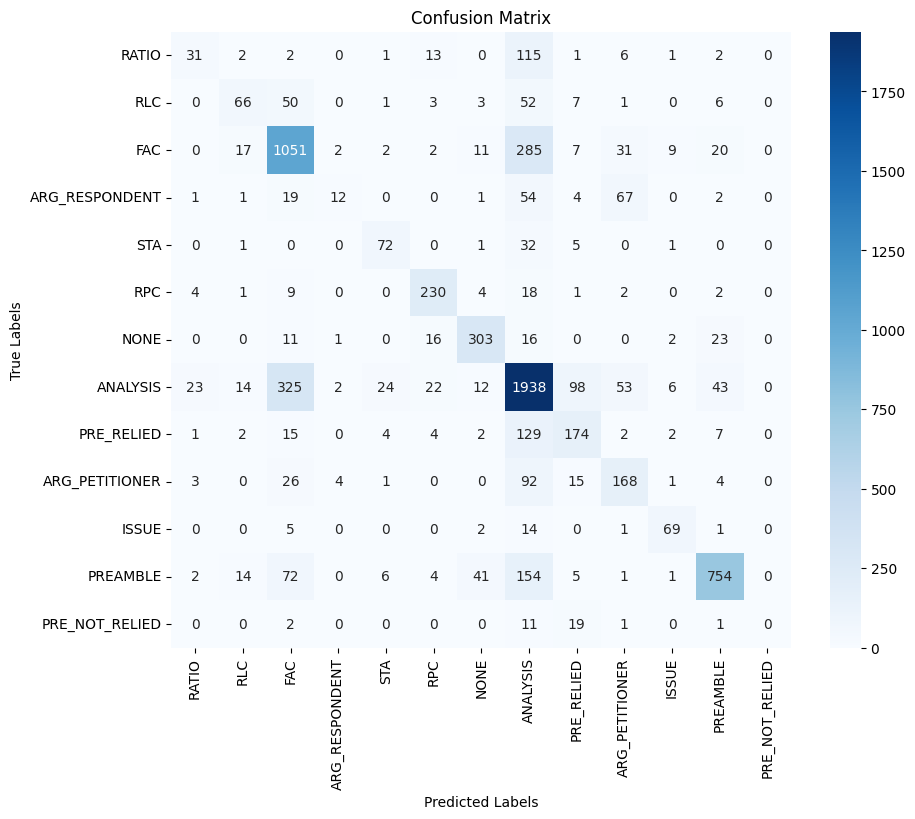

In [ ]:
results = final_trainer.evaluate()
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

print("Classification Report:")
print(report)


from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)

# Print the classification report
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display the confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

In [ ]:
from transformers import AutoModel
import numpy as np
# Load fine-tuned model
#fine_tuned_model = AutoModel.from_pretrained('/content/drive/My Drive/SemanticSegmentation/fine_tuned_inlegalbert_embeddings')

def extract_sentence_embeddings(texts, model, tokenizer):
    model.eval()
    embeddings = []

    with torch.no_grad():
        for text in texts:
            inputs = tokenizer(text, return_tensors='pt', truncation=True, padding=True, max_length=512)
            outputs = model(**inputs)
            # Use the CLS token representation for the sentence embedding
            cls_embedding = outputs.last_hidden_state[:, 0, :]  # [CLS] token embedding
            embeddings.append(cls_embedding.squeeze().numpy())

    return np.array(embeddings)

# Get embeddings for processed_text in SSI dataset
#ssi_texts = df['processed_text'].tolist()
ssi_embeddings = extract_sentence_embeddings(ssi_texts, fine_tuned_model, tokenizer)
print(ssi_embeddings.shape)


(9380, 768)


### Multiple Features (4) - Model ***

In [ ]:
!pip install datasets
#!pip install optuna
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
df.head()

In [ ]:
import pandas as pd
from transformers import AutoTokenizer,  AutoModel, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
from datasets import Dataset
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import torch.nn as nn
os.environ["WANDB_DISABLED"] = "true"

# Assuming df is your DataFrame with columns ['new_ner', 'start', 'end', 'meta_group', 'labels']
# Map labels to integers for classification
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}

df['label'] = df['labels'].map(label_to_int)

# Stratified train/test split
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['label'], random_state=42)

# Initialize tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize text data
train_encodings = tokenizer(train_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Convert meta_group to numerical format if it's categorical (e.g., by factorizing)
train_df['meta_group_id'], _ = pd.factorize(train_df['meta_group'])
test_df['meta_group_id'], _ = pd.factorize(test_df['meta_group'])

# Create datasets with additional numerical features (start, end, meta_group_id)
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'start': torch.tensor(train_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(train_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(train_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(train_df['label'].tolist(), dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'start': torch.tensor(test_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(test_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(test_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(test_df['label'].tolist(), dtype=torch.long)
})

# Define a custom model to handle both text and additional features
class CustomLegalBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(CustomLegalBERTClassifier, self).__init__()
        self.bert = AutoModel.from_pretrained(model_name)
        self.meta_embedding = nn.Embedding(len(train_df['meta_group_id'].unique()), 8)  # Embed meta_group feature
        self.linear1 = nn.Linear(self.bert.config.hidden_size + 8 + 2, 128)  # Combine BERT, meta_group, start/end
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(128, num_labels)

    def forward(self, input_ids, attention_mask, start, end, meta_group, labels=None):
        # Get BERT embeddings
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output  # [batch_size, hidden_size]

        # Embed and process additional features
        meta_embedding = self.meta_embedding(meta_group)
        numerical_features = torch.cat((start.unsqueeze(1), end.unsqueeze(1)), dim=1)  # [batch_size, 2]

        # Concatenate BERT embeddings with additional features
        combined = torch.cat((pooled_output, meta_embedding, numerical_features), dim=1)  # [batch_size, hidden_size + 8 + 2]
        combined = self.dropout(self.linear1(combined))  # Feed through a linear layer with dropout
        logits = self.classifier(combined)  # [batch_size, num_labels]

        # Calculate loss if labels are provided
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss()
            loss = loss_fn(logits, labels)

        return (loss, logits) if loss is not None else logits

# Instantiate the custom model
model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/IndianLegalClassification/Code/results_80_20strat_all',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
)

# Data collator to handle padding
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
train_df.head()

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner,label,meta_group_id
728,8034,8060,These persons are Baories.,FAC,Criminal,These persons are Baories.,These persons are Baories .,These persons are Baories .,These persons are Baories.,2,0
29072,3317,3396,"\nThereafter, the son carried on the said lott...",FAC,Tax,"Thereafter, the son carried on the said lotter...","Thereafter , the son carried on the said lotte...","Thereafter , the son carried on the said lotte...","Thereafter, the son carried on the said lotter...",2,1
7119,7766,7842,"The Judicial Magistrate, First Class, Degloor ...",FAC,Criminal,"The Judicial Magistrate, First Class, Degloor ...",The COURT COURT COURT COURT COURT COURT COURT ...,The COURT rejected the said application .,The COURT rejected the said application.,2,0
26983,27074,27251,Viscount Simon quoted with approval a passage ...,PRE_RELIED,Tax,Viscount Simon quoted with approval a passage ...,OTHER_PERSON OTHER_PERSON quoted with approval...,OTHER_PERSON quoted with approval a passage fr...,OTHER_PERSON quoted with approval a passage fr...,8,1
17739,7991,8068,\nThe Appellate 'tribunal accordingly reduced ...,RLC,Tax,The Appellate 'tribunal accordingly reduced th...,The Appellate ' tribunal accordingly reduced t...,The Appellate ' tribunal accordingly reduced t...,The Appellate 'tribunal accordingly reduced th...,1,1


In [ ]:
test_df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner,label,meta_group_id
23575,27873,28310,A case like the one before us stands on the Sa...,ANALYSIS,Criminal,A case like the one before us stands on the Sa...,A case like the one before us stands on the Sa...,A case like the one before us stands on the Sa...,A case like the one before us stands on the Sa...,7,0
15767,7637,7758,"When the search was conducted, the accused was...",FAC,Tax,"When the search was conducted, the accused was...","When the search was conducted , the accused wa...","When the search was conducted , the accused wa...","When the search was conducted, the accused was...",2,1
1866,4856,4950,It is alleged that the appellants had poured k...,FAC,Criminal,It is alleged that the appellants had poured k...,It is alleged that the appellants had poured k...,It is alleged that the appellants had poured k...,It is alleged that the appellants had poured k...,2,0
13578,13210,13303,\nFurther contention of the plaintiffs is that...,ANALYSIS,Criminal,"Further contention of the plaintiffs is that, ...","Further contention of the plaintiffs is that ,...","Further contention of the plaintiffs is that ,...","Further contention of the plaintiffs is that, ...",7,0
29940,16941,17032,There is also the possibility of his calling s...,ANALYSIS,Criminal,There is also the possibility of his calling s...,There is also the possibility of his calling s...,There is also the possibility of his calling s...,There is also the possibility of his calling s...,7,0


In [ ]:
train_df.shape, test_df.shape

((28445, 11), (7112, 11))

In [ ]:
# Trainer setup
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,60.059400,32.312279,0.546400,0.452618,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.49460431654676257, 'recall': 0.5741127348643006, 'f1-score': 0.5314009661835749, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 372.0}, '7': {'precision': 0.5153309367731022, 'recall': 0.951953125, 'f1-score': 0.6686788311153793, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.8727272727272727, 'recall': 0.5920303605313093, 'f1-score': 0.7054833239118146, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.546400449943757, 'macro avg': {'precision': 0.14482019431131826, 'recall': 0.16293047849196998, 'f1-score': 0.14658177855467452, 'support': 7112.0}, 'weighted avg': {'precision': 0.41477054927887863, 'recall': 0.546400449943757, 'f1-score': 0.452618169216004, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

KeyboardInterrupt: 

### With Another feature - Cleaned Text - Model *** (0.6774)

In [ ]:
import pandas as pd
from transformers import AutoTokenizer,  AutoModel, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
from datasets import Dataset
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import torch.nn as nn
os.environ["WANDB_DISABLED"] = "true"

# Assuming df is your DataFrame with columns ['new_ner', 'start', 'end', 'meta_group', 'labels']
# Map labels to integers for classification
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}

df['label'] = df['labels'].map(label_to_int)

# Stratified train/test split
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['label'], random_state=42)

# Initialize tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize text data
train_encodings = tokenizer(train_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Tokenize 'cleaned_text' as well
train_cleaned_encodings = tokenizer(train_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")


# Convert meta_group to numerical format if it's categorical (e.g., by factorizing)
train_df['meta_group_id'], _ = pd.factorize(train_df['meta_group'])
test_df['meta_group_id'], _ = pd.factorize(test_df['meta_group'])


train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],  # Added for cleaned_text
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],  # Added for cleaned_text
    'start': torch.tensor(train_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(train_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(train_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(train_df['label'].tolist(), dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],  # Added for cleaned_text
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],  # Added for cleaned_text
    'start': torch.tensor(test_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(test_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(test_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(test_df['label'].tolist(), dtype=torch.long)
})

# Define a custom model to handle both text and additional features
class CustomLegalBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(CustomLegalBERTClassifier, self).__init__()
        # Initialize two BERT models for new_ner and cleaned_text
        self.bert_new_ner = AutoModel.from_pretrained(model_name)
        self.bert_cleaned_text = AutoModel.from_pretrained(model_name)

        self.meta_embedding = nn.Embedding(len(train_df['meta_group_id'].unique()), 8)  # Embed meta_group feature
        self.linear1 = nn.Linear(self.bert_new_ner.config.hidden_size * 2 + 8 + 2, 128)  # Combine two BERT outputs + meta_group + start/end
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(128, num_labels)

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, start, end, meta_group, labels=None):
        # Get BERT embeddings for new_ner
        outputs_new_ner = self.bert_new_ner(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output_new_ner = outputs_new_ner.pooler_output  # [batch_size, hidden_size]

        # Get BERT embeddings for cleaned_text
        outputs_cleaned_text = self.bert_cleaned_text(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask)
        pooled_output_cleaned_text = outputs_cleaned_text.pooler_output  # [batch_size, hidden_size]

        # Concatenate both BERT embeddings
        combined_bert_output = torch.cat((pooled_output_new_ner, pooled_output_cleaned_text), dim=1)  # [batch_size, hidden_size * 2]

        # Embed and process additional features
        meta_embedding = self.meta_embedding(meta_group)
        numerical_features = torch.cat((start.unsqueeze(1), end.unsqueeze(1)), dim=1)  # [batch_size, 2]

        # Concatenate all features
        combined = torch.cat((combined_bert_output, meta_embedding, numerical_features), dim=1)  # [batch_size, hidden_size * 2 + 8 + 2]
        combined = self.dropout(self.linear1(combined))  # Feed through a linear layer with dropout
        logits = self.classifier(combined)  # [batch_size, num_labels]

        # Calculate loss if labels are provided
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss()
            loss = loss_fn(logits, labels)

        return (loss, logits) if loss is not None else logits

# Instantiate the custom model
model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

In [ ]:
# Training arguments

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/Results/results_80_20strat_allfeatures2',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True
)

# Data collator to handle padding
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
# Trainer setup
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,3.968800,3.168970,0.615720,0.563884,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.05555555555555555, 'recall': 0.015873015873015872, 'f1-score': 0.024691358024691357, 'support': 189.0}, '2': {'precision': 0.6334716459197787, 'recall': 0.6374391092553932, 'f1-score': 0.6354491848768644, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.05982905982905983, 'recall': 0.0625, 'f1-score': 0.0611353711790393, 'support': 112.0}, '5': {'precision': 0.5423728813559322, 'recall': 0.47232472324723246, 'f1-score': 0.504930966469428, 'support': 271.0}, '6': {'precision': 0.7647058823529411, 'recall': 0.5591397849462365, 'f1-score': 0.6459627329192547, 'support': 372.0}, '7': {'precision': 0.65495304453196, 'recall': 0.84453125, 'f1-score': 0.7377580617642041, 'support': 2560.0}, '8': {'precision': 0.19047619047619047, 'recall': 0.011695906432748537, 'f1-score': 0.02203856749311295, 'support': 342.0}, '9': {'precision': 0.1791044776119403, 'recall': 0.11464968152866242, 'f1-score': 0.13980582524271845, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.6284340659340659, 'recall': 0.8681214421252372, 'f1-score': 0.7290836653386454, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6157199100112486, 'macro avg': {'precision': 0.28530021565903263, 'recall': 0.2758673010314251, 'f1-score': 0.269296594869843, 'support': 7112.0}, 'weighted avg': {'precision': 0.537033775531448, 'recall': 0.6157199100112486, 'f1-score': 0.5638835455649751, 'support': 7112.0}}"
2,1.301100,1.215283,0.676603,0.626282,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.09090909090909091, 'recall': 0.005291005291005291, 'f1-score': 0.01, 'support': 189.0}, '2': {'precision': 0.7097833223900197, 'recall': 0.7522616562282533, 'f1-score': 0.7304054054054054, 'support': 1437.0}, '3': {'precision': 0.4, 'recall': 0.012422360248447204, 'f1-score': 0.024096385542168676, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.835, 'recall': 0.6162361623616236, 'f1-score': 0.7091295116772823, 'support': 271.0}, '6': {'precision': 0.8169398907103825, 'recall': 0.803763440860215, 'f1-score': 0.8102981029810298, 'support': 372.0}, '7': {'precision': 0.6591574019894675, 'recall': 0.880078125, 'f1-score': 0.753763800602208, 'support': 2560.0}, '8': {'precision': 0.24693877551020407, 'recall': 0.3538011695906433, 'f1-score': 0.29086538461538464, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 1.0, 'recall': 0.05434782608695652, 'f1-score': 0.10309278350515463, 'support': 92.0}, '11': {'precision': 0.8071297989031079, 'recall': 0.8377609108159393, 'f1-score': 0.8221601489757915, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6766029246344207, 'macro avg': {'precision': 0.4281429446470979, 'recall': 0.3319971274217757, 'f1-score': 0.32721627102341727, 'support': 7112.0}, 'weighted avg': {'precision': 0.6111273776943111, 'recall': 0.6766029246344207, 'f1-score': 0.6262822977778987, 'support': 7112.0}}"
3,1.102300,0.979390,0.711614,0.677379,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.5714285714285714, 'recall': 0.042328042328042326, 'f1-score': 0.07881773399014778, 'support': 189.0}, '2': {'precision': 0.6917605216360403, 'recall': 0.8121085594989561, 'f1-score': 0.7471190781049936, 'support': 1437.0}, '3': {'precision': 0.3835616438356164, 'recall': 0.17391304347826086, 'f1-score': 0.23931623931623933, 'support': 161.0}, '4': {'precision': 0.5789473684210527, 'recall': 0.09821428571428571, 'f1-score': 0.167938931

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.7116
F1 Score: 0.6774
Classification Report:
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.5714285714285714, 'recall': 0.042328042328042326, 'f1-score': 0.07881773399014778, 'support': 189.0}, '2': {'precision': 0.6917605216360403, 'recall': 0.8121085594989561, 'f1-score': 0.7471190781049936, 'support': 1437.0}, '3': {'precision': 0.3835616438356164, 'recall': 0.17391304347826086, 'f1-score': 0.23931623931623933, 'support': 161.0}, '4': {'precision': 0.5789473684210527, 'recall': 0.09821428571428571, 'f1-score': 0.16793893129770993, 'support': 112.0}, '5': {'precision': 0.8207171314741036, 'recall': 0.7601476014760148, 'f1-score': 0.789272030651341, 'support': 271.0}, '6': {'precision': 0.8543417366946778, 'recall': 0.8198924731182796, 'f1-score': 0.8367626886145405, 'support': 372.0}, '7': {'precision': 0.6919924337957125, 'recall': 0.857421875, 'f1-score': 0.7658757850662945, 'support': 2560.0}, '8': {'precision': 0.39920

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.00      0.00      0.00       174
           RLC       0.57      0.04      0.08       189
           FAC       0.69      0.81      0.75      1437
ARG_RESPONDENT       0.38      0.17      0.24       161
           STA       0.58      0.10      0.17       112
           RPC       0.82      0.76      0.79       271
          NONE       0.85      0.82      0.84       372
      ANALYSIS       0.69      0.86      0.77      2560
    PRE_RELIED       0.40      0.30      0.34       342
ARG_PETITIONER       0.46      0.24      0.32       314
         ISSUE       0.84      0.51      0.64        92
      PREAMBLE       0.86      0.87      0.87      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.71      7112
     macro avg       0.55      0.42      0.44      7112
  weighted avg       0.68      0.71      0.68      7112



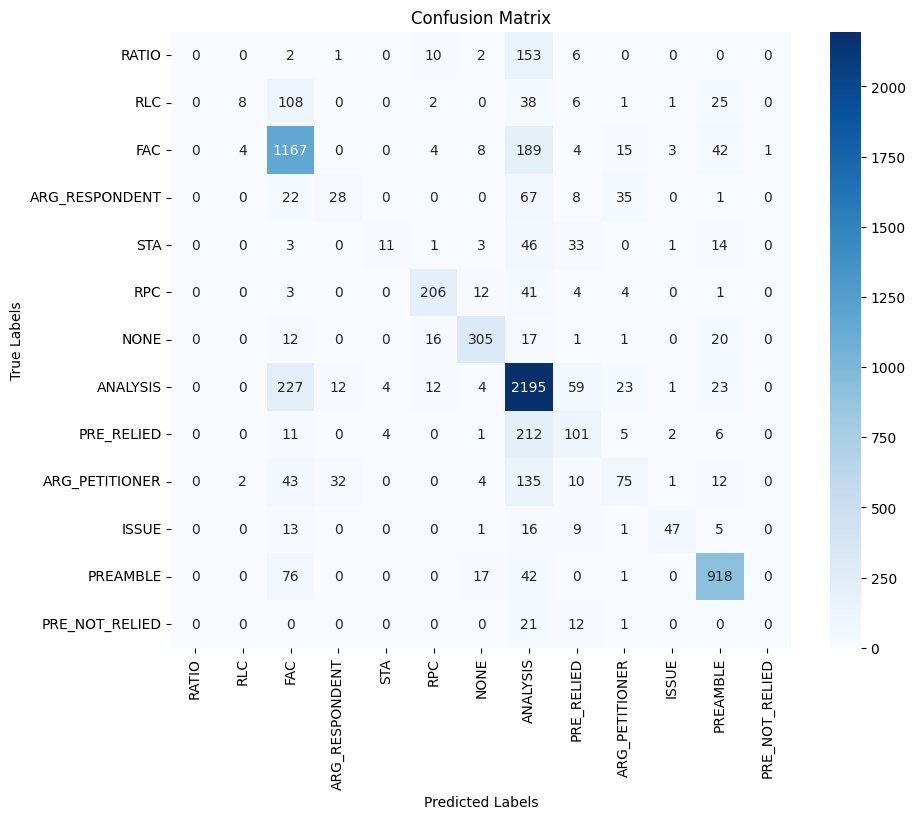

In [ ]:
# Predictions for confusion matrix and classification report
predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_df['label'].tolist()
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

### Hyperparameter Tuning with Optuna - Model *** (0.7003)

In [ ]:
# !pip install datasets
# !pip install optuna
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_masked_dataset.csv')
df.head()

In [ ]:
import pandas as pd
from transformers import AutoTokenizer,  AutoModel, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
from datasets import Dataset
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import torch.nn as nn
os.environ["WANDB_DISABLED"] = "true"

# Assuming df is your DataFrame with columns ['new_ner', 'start', 'end', 'meta_group', 'labels']
# Map labels to integers for classification
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}

df['label'] = df['labels'].map(label_to_int)

# Stratified train/test split
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['label'], random_state=42)

# Initialize tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize text data
train_encodings = tokenizer(train_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_df['new_ner'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Tokenize 'cleaned_text' as well
train_cleaned_encodings = tokenizer(train_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Convert meta_group to numerical format if it's categorical (e.g., by factorizing)
train_df['meta_group_id'], _ = pd.factorize(train_df['meta_group'])
test_df['meta_group_id'], _ = pd.factorize(test_df['meta_group'])


train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],  # Added for cleaned_text
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],  # Added for cleaned_text
    'start': torch.tensor(train_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(train_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(train_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(train_df['label'].tolist(), dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],  # Added for cleaned_text
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],  # Added for cleaned_text
    'start': torch.tensor(test_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(test_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(test_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(test_df['label'].tolist(), dtype=torch.long)
})

# Define a custom model to handle both text and additional features
class CustomLegalBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(CustomLegalBERTClassifier, self).__init__()
        # Initialize two BERT models for new_ner and cleaned_text
        self.bert_new_ner = AutoModel.from_pretrained(model_name)
        self.bert_cleaned_text = AutoModel.from_pretrained(model_name)

        self.meta_embedding = nn.Embedding(len(train_df['meta_group_id'].unique()), 8)  # Embed meta_group feature
        self.linear1 = nn.Linear(self.bert_new_ner.config.hidden_size * 2 + 8 + 2, 128)  # Combine two BERT outputs + meta_group + start/end
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(128, num_labels)

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, start, end, meta_group, labels=None):
        # Get BERT embeddings for new_ner
        outputs_new_ner = self.bert_new_ner(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output_new_ner = outputs_new_ner.pooler_output  # [batch_size, hidden_size]

        # Get BERT embeddings for cleaned_text
        outputs_cleaned_text = self.bert_cleaned_text(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask)
        pooled_output_cleaned_text = outputs_cleaned_text.pooler_output  # [batch_size, hidden_size]

        # Concatenate both BERT embeddings
        combined_bert_output = torch.cat((pooled_output_new_ner, pooled_output_cleaned_text), dim=1)  # [batch_size, hidden_size * 2]

        # Embed and process additional features
        meta_embedding = self.meta_embedding(meta_group)
        numerical_features = torch.cat((start.unsqueeze(1), end.unsqueeze(1)), dim=1)  # [batch_size, 2]

        # Concatenate all features
        combined = torch.cat((combined_bert_output, meta_embedding, numerical_features), dim=1)  # [batch_size, hidden_size * 2 + 8 + 2]
        combined = self.dropout(self.linear1(combined))  # Feed through a linear layer with dropout
        logits = self.classifier(combined)  # [batch_size, num_labels]

        # Calculate loss if labels are provided
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss()
            loss = loss_fn(logits, labels)

        return (loss, logits) if loss is not None else logits

# Instantiate the custom model
model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

In [ ]:
import optuna
from optuna.trial import TrialState
from transformers import TrainerCallback
import os
import torch.nn as nn
os.environ["WANDB_DISABLED"] = "true"

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Callback to report the intermediate training loss to Optuna
class OptunaCallback(TrainerCallback):
    def __init__(self, trial):
        self.trial = trial

    def on_evaluate(self, args, state, control, metrics, **kwargs):
        # Report the validation loss to Optuna
        self.trial.report(metrics["eval_loss"], step=state.global_step)
        # Handle pruning based on the intermediate value
        if self.trial.should_prune():
            raise optuna.exceptions.TrialPruned()

# Define the Optuna objective function
def objective(trial):
    # Hyperparameters to be tuned
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 5e-5)
    batch_size = trial.suggest_categorical("batch_size", [8, 16, 32])
    num_train_epochs = trial.suggest_int("num_train_epochs", 2, 4)
    dropout_rate = trial.suggest_uniform("dropout_rate", 0.1, 0.5)
    weight_decay = trial.suggest_uniform("weight_decay", 0.0, 0.3)

    # Update the dropout rate in the custom model
    model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))
    model.dropout.p = dropout_rate  # Set dropout rate

    # Define training arguments with dynamic parameters
    training_args = TrainingArguments(
        output_dir='/content/drive/MyDrive/IndianLegalClassification/Code/Results/results_optuna',
        evaluation_strategy="epoch",
        learning_rate=learning_rate,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        num_train_epochs=num_train_epochs,
        weight_decay=weight_decay,
        logging_dir='./logs',
        logging_steps=10,
        save_steps=10,
        save_total_limit=1,
        load_best_model_at_end=True,
        save_strategy="epoch"
    )

    # Initialize Trainer with Optuna callback
    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=test_dataset,
        tokenizer=tokenizer,
        data_collator=data_collator,
        compute_metrics=compute_metrics,
        callbacks=[OptunaCallback(trial)]
    )

    # Train and evaluate
    trainer.train()
    eval_results = trainer.evaluate()

    # Return the evaluation loss as the objective to minimize
    return eval_results["eval_loss"]

# Create an Optuna study
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=5)

# Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)


[I 2024-11-06 12:14:30,674] A new study created in memory with name: no-name-db6a64a3-4f68-471c-b953-dca80909a0af
<ipython-input-3-b6974ce06219>:25: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 5e-5)
<ipython-input-3-b6974ce06219>:28: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  dropout_rate = trial.suggest_uniform("dropout_rate", 0.1, 0.5)
<ipython-input-3-b6974ce06219>:29: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  weight_decay = trial.suggest_uniform("weight_decay", 0.0, 0.3)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,51.109400,37.494759,0.547103,0.453437,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.5656041512231282, 'recall': 0.5309672929714684, 'f1-score': 0.5477386934673367, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 372.0}, '7': {'precision': 0.492029128124385, 'recall': 0.9765625, 'f1-score': 0.6543646119617851, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.9208211143695014, 'recall': 0.5958254269449715, 'f1-score': 0.7235023041474654, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.5471034870641169, 'macro avg': {'precision': 0.15218879951669345, 'recall': 0.16179655537818768, 'f1-score': 0.14812350842896824, 'support': 7112.0}, 'weighted avg': {'precision': 0.42785618501849204, 'recall': 0.5471034870641169, 'f1-score': 0.4534371959654332, 'support': 7112.0}}"
2,52.979500,32.911968,0.572694,0.477443,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.5986301369863014, 'recall': 0.6082115518441197, 'f1-score': 0.6033828098032448, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 372.0}, '7': {'precision': 0.5123213915924623, 'recall': 0.96640625, 'f1-score': 0.6696440655027744, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.8809234507897934, 'recall': 0.6878557874762808, 'f1-score': 0.7725093233883857, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.5726940382452194, 'macro avg': {'precision': 0.15322115225911978, 'recall': 0.17403642994772311, 'f1-score': 0.15734893836110808, 'support': 7112.0}, 'weighted avg': {'precision': 0.43592063926581287, 'recall': 0.5726940382452194, 'f1-score': 0.47744301634219966, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,25.247200,14.760980,0.562992,0.479321,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.48180815876515987, 'recall': 0.6082115518441197, 'f1-score': 0.5376807136265764, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.7419354838709677, 'recall': 0.18548387096774194, 'f1-score': 0.2967741935483871, 'support': 372.0}, '7': {'precision': 0.5502542988617098, 'recall': 0.8875, 'f1-score': 0.6793242637165495, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.25, 'recall': 0.006369426751592357, 'f1-score': 0.012422360248447204, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7389671361502348, 'recall': 0.7466793168880456, 'f1-score': 0.7428032090608778, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.562992125984252, 'macro avg': {'precision': 0.21253577520369787, 'recall': 0.18724955126549997, 'f1-score': 0.17453882616929525, 'support': 7112.0}, 'weighted avg': {'precision': 0.45477793739227496, 'recall': 0.562992125984252, 'f1-score': 0.4793212182317119, 'support': 7112.0}}"
2,1.819500,1.606045,0.608971,0.534556,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7954022988505747, 'recall': 0.4815588030619346, 'f1-score': 0.5999133073255309, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.7532467532467533, 'recall': 0.2140221402214022, 'f1-score': 0.3333333333333333, 'support': 271.0}, '6': {'precision': 0.6308411214953271, 'recall': 0.7258064516129032, 'f1-score': 0.675, 'support': 372.0}, '7': {'precision': 0.5646179013788268, 'recall': 0.94375, 'f1-score': 0.7065360432811815, 'support': 2560.0}, '8': {'precision': 0.30434782608695654, 'recall': 0.02046783625730994, 'f1-score': 0.038356164383561646, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.6543846720707442, 'recall': 0.8425047438330171, 'f1-score': 0.7366238075487349, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.608970753655793, 'macro avg': {'precision': 0.2848338902407064, 'recall': 0.24831615192204362, 'f1-score': 0.23767405045171863, 'support': 7112.0}, 'weighted avg': {'precision': 0.5372646371187441, 'recall': 0.608970753655793, 'f1-score': 0.5345557266782186, 'support': 7112.0}}"
3,1.430300,1.167806,0.645810,0.571525,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7425454545454545, 'recall': 0.7105080027835768, 'f1-score': 0.7261735419630156, 'support': 1437.0}, '3': {'precision': 0.05172413793103448, 'recall': 0.018633540372670808, 'f1-score': 0.0273972602739726, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.38571428571428573, 'recall': 0.0996309963099631, 'f1-score': 0.15835777126099707, 'support': 271.0}, '6': {'precision': 0.5113636363636364, 'recall': 0.8467741935483871, 'f1-score': 0.6376518218623481, 'support': 372.0}, '7': {'precision': 0.6208256639495136, 'recall': 0.922265625, 'f1-score': 0.7421027817067422, 'support': 2560

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,27.801700,15.986702,0.599691,0.516801,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.6645435244161358, 'recall': 0.6534446764091858, 'f1-score': 0.6589473684210526, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.37249283667621774, 'recall': 0.34946236559139787, 'f1-score': 0.3606102635228849, 'support': 372.0}, '7': {'precision': 0.5548416704910509, 'recall': 0.94453125, 'f1-score': 0.6990459670424979, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.25, 'recall': 0.0031847133757961785, 'f1-score': 0.006289308176100629, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7880324543610547, 'recall': 0.7371916508538899, 'f1-score': 0.7617647058823529, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.5996906636670416, 'macro avg': {'precision': 0.20230080661111227, 'recall': 0.20675497355617461, 'f1-score': 0.19128135484960682, 'support': 7112.0}, 'weighted avg': {'precision': 0.48129882778166233, 'recall': 0.5996906636670416, 'f1-score': 0.516800745900964, 'support': 7112.0}}"
2,19.219400,10.416368,0.616564,0.537968,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.6536346976175932, 'recall': 0.7446068197633959, 'f1-score': 0.6961613532856213, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.14285714285714285, 'recall': 0.01107011070110701, 'f1-score': 0.02054794520547945, 'support': 271.0}, '6': {'precision': 0.3603082851637765, 'recall': 0.5026881720430108, 'f1-score': 0.41975308641975306, 'support': 372.0}, '7': {'precision': 0.5934093789607098, 'recall': 0.914453125, 'f1-score': 0.7197540353574173, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.07142857142857142, 'recall': 0.006369426751592357, 'f1-score': 0.011695906432748537, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.8128898128898129, 'recall': 0.7419354838709677, 'f1-score': 0.7757936507936508, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6165635545556806, 'macro avg': {'precision': 0.2026559914552005, 'recall': 0.22470177985615955, 'f1-score': 0.2033619982688208, 'support': 7112.0}, 'weighted avg': {'precision': 0.49358330604971085, 'recall': 0.6165635545556806, 'f1-score': 0.5379682029023694, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,2.224400,1.735606,0.612767,0.533381,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7563098346388164, 'recall': 0.60473208072373, 'f1-score': 0.6720804331013148, 'support': 1437.0}, '3': {'precision': 0.029411764705882353, 'recall': 0.006211180124223602, 'f1-score': 0.010256410256410256, 'support': 161.0}, '4': {'precision': 0.13043478260869565, 'recall': 0.026785714285714284, 'f1-score': 0.044444444444444446, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.4099462365591398, 'recall': 0.8198924731182796, 'f1-score': 0.546594982078853, 'support': 372.0}, '7': {'precision': 0.602764269260302, 'recall': 0.919921875, 'f1-score': 0.728312973558064, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.6573705179282868, 'recall': 0.7827324478178368, 'f1-score': 0.714595062797748, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6127671541057368, 'macro avg': {'precision': 0.1989413389000864, 'recall': 0.24309813623613724, 'f1-score': 0.20894494663360266, 'support': 7112.0}, 'weighted avg': {'precision': 0.4913675868037946, 'recall': 0.6127671541057368, 'f1-score': 0.5333811001162054, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,2.224400,1.735606,0.612767,0.533381,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7563098346388164, 'recall': 0.60473208072373, 'f1-score': 0.6720804331013148, 'support': 1437.0}, '3': {'precision': 0.029411764705882353, 'recall': 0.006211180124223602, 'f1-score': 0.010256410256410256, 'support': 161.0}, '4': {'precision': 0.13043478260869565, 'recall': 0.026785714285714284, 'f1-score': 0.044444444444444446, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.4099462365591398, 'recall': 0.8198924731182796, 'f1-score': 0.546594982078853, 'support': 372.0}, '7': {'precision': 0.602764269260302, 'recall': 0.919921875, 'f1-score': 0.728312973558064, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.6573705179282868, 'recall': 0.7827324478178368, 'f1-score': 0.714595062797748, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6127671541057368, 'macro avg': {'precision': 0.1989413389000864, 'recall': 0.24309813623613724, 'f1-score': 0.20894494663360266, 'support': 7112.0}, 'weighted avg': {'precision': 0.4913675868037946, 'recall': 0.6127671541057368, 'f1-score': 0.5333811001162054, 'support': 7112.0}}"
2,1.353400,1.327932,0.669010,0.616591,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.21621621621621623, 'recall': 0.08465608465608465, 'f1-score': 0.12167300380228137, 'support': 189.0}, '2': {'precision': 0.8211920529801324, 'recall': 0.6040361864996521, 'f1-score': 0.6960705693664796, 'support': 1437.0}, '3': {'precision': 0.14285714285714285, 'recall': 0.043478260869565216, 'f1-score': 0.06666666666666667, 'support': 161.0}, '4': {'precision': 0.9, 'recall': 0.08035714285714286, 'f1-score': 0.14754098360655737, 'support': 112.0}, '5': {'precision': 0.8620689655172413, 'recall': 0.5535055350553506, 'f1-score': 0.6741573033707865, 'support': 271.0}, '6': {'precision': 0.8482142857142857, 'recall': 0.7661290322580645, 'f1-score': 0.8050847457627118, 'support': 372.0}, '7': {'precision': 0.6067050287715787, 'recall': 0.947265625, 'f1-score': 0.7396675308830257, 'support': 2560.0}, '8': {'precision': 0.44029850746268656, 'recall': 0.17251461988304093, 'f1-score': 0.24789915966386555, 'support': 342.0}, '9': {'precision': 0.48484848484848486, 'recall': 0.050955414012738856, 'f1-score': 0.09221902017291066, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7395833333333334, 'recall': 0.8757115749525617, 'f1-score': 0.8019113814074718, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6690101237345332, 'macro avg': {'precision': 0.4663064629000847, 'recall': 0.32143149815724625, 'f1-score': 0.33791464343867356, 'support': 7112.0}, 'weighted avg': {'precision': 0.6368650829192125, 'recall': 0.6690101237345332, 'f1-score': 0.6165913166529948, 'support': 7112.0}}"
3,1.092400,1.027788,0.719066,0.682088,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.574468085106383, 'recall': 0.14285714285714285, 'f1-score': 0.2288135593220339, 'support': 189.0}, '2': {'precision': 0.7280813214739518, 'recall': 0.7974947807933194, 'f1-score': 0.7612089006974427, 'support': 1437.0}, '3': {'precision': 0.2, 'recall': 0.012422360248447204, 'f1-score': 0.023391812865497075, 'support': 161.0}, '4': {'precision': 0.7333333333333333, 'recall': 0.09821428571428571, 'f1-score': 0.1732283464566929, 'support': 112.0}, '5': {'precision'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,26.694100,14.176752,0.614033,0.533026,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.65174456879526, 'recall': 0.6889352818371608, 'f1-score': 0.6698240866035182, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 271.0}, '6': {'precision': 0.5226586102719033, 'recall': 0.4650537634408602, 'f1-score': 0.492176386913229, 'support': 372.0}, '7': {'precision': 0.5644895071917001, 'recall': 0.93515625, 'f1-score': 0.7040141155712395, 'support': 2560.0}, '8': {'precision': 0.21875, 'recall': 0.02046783625730994, 'f1-score': 0.0374331550802139, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.8152284263959391, 'recall': 0.7618595825426945, 'f1-score': 0.7876410004904365, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6140326209223848, 'macro avg': {'precision': 0.21329777789652324, 'recall': 0.22088251646754042, 'f1-score': 0.20700682651220287, 'support': 7112.0}, 'weighted avg': {'precision': 0.4935520737081002, 'recall': 0.6140326209223848, 'f1-score': 0.5330256914788672, 'support': 7112.0}}"
2,10.903300,5.991124,0.651153,0.594138,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7557251908396947, 'recall': 0.6889352818371608, 'f1-score': 0.7207863123407353, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 1.0, 'recall': 0.017857142857142856, 'f1-score': 0.03508771929824561, 'support': 112.0}, '5': {'precision': 0.7333333333333333, 'recall': 0.04059040590405904, 'f1-score': 0.07692307692307693, 'support': 271.0}, '6': {'precision': 0.4326465927099842, 'recall': 0.7338709677419355, 'f1-score': 0.5443668993020937, 'support': 372.0}, '7': {'precision': 0.6296195652173913, 'recall': 0.905078125, 'f1-score': 0.7426282051282052, 'support': 2560.0}, '8': {'precision': 0.5161290322580645, 'recall': 0.2807017543859649, 'f1-score': 0.36363636363636365, 'support': 342.0}, '9': {'precision': 0.33587786259541985, 'recall': 0.14012738853503184, 'f1-score': 0.19775280898876405, 'support': 314.0}, '10': {'precision': 0.8, 'recall': 0.17391304347826086, 'f1-score': 0.2857142857142857, 'support': 92.0}, '11': {'precision': 0.7757255936675461, 'recall': 0.8368121442125237, 'f1-score': 0.805111821086262, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6511529808773904, 'macro avg': {'precision': 0.4599274746631872, 'recall': 0.2936835579963138, 'f1-score': 0.2901544224936948, 'support': 7112.0}, 'weighted avg': {'precision': 0.6106127117023937, 'recall': 0.6511529808773904, 'f1-score': 0.5941381036285883, 'support': 7112.0}}"
3,4.687100,3.193065,0.703318,0.664263,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.4444444444444444, 'recall': 0.021164021164021163, 'f1-score': 0.04040404040404041, 'support': 189.0}, '2': {'precision': 0.6745527986151183, 'recall': 0.813500347947112, 'f1-score': 0.7375394321766562, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.42857142857142855, 'recall': 0.08035714285714286, 'f1-score': 0.13533834586466165, 'support': 112.0}, '5': {'precision': 0.7323943661971831, 'recall': 0.7675276752767528, 'f1-score': 0.7495495495495496, 'support': 271.0}, '6': {'precision': 0.856655290102389, 'recall': 0.674731

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Best hyperparameters: {'learning_rate': 4.829817294596051e-05, 'batch_size': 16, 'num_train_epochs': 4, 'dropout_rate': 0.4609865014489495, 'weight_decay': 0.21798043138675602}


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,2.195500,1.658453,0.589426,0.513039,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.7640807651434643, 'recall': 0.500347947112039, 'f1-score': 0.6047098402018503, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.2, 'recall': 0.125, 'f1-score': 0.15384615384615385, 'support': 112.0}, '5': {'precision': 0.75, 'recall': 0.01107011070110701, 'f1-score': 0.02181818181818182, 'support': 271.0}, '6': {'precision': 0.3608108108108108, 'recall': 0.717741935483871, 'f1-score': 0.4802158273381295, 'support': 372.0}, '7': {'precision': 0.5619775495581562, 'recall': 0.919140625, 'f1-score': 0.697495183044316, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7145299145299145, 'recall': 0.793168880455408, 'f1-score': 0.7517985611510791, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.5894263217097863, 'macro avg': {'precision': 0.25779992615710356, 'recall': 0.2358822691348019, 'f1-score': 0.2084525959538239, 'support': 7112.0}, 'weighted avg': {'precision': 0.5131654580872033, 'recall': 0.5894263217097863, 'f1-score': 0.5130392543152454, 'support': 7112.0}}"
2,1.283800,1.220802,0.669573,0.611903,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.3076923076923077, 'recall': 0.021164021164021163, 'f1-score': 0.039603960396039604, 'support': 189.0}, '2': {'precision': 0.7136054421768707, 'recall': 0.7299930410577592, 'f1-score': 0.7217062263501892, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.45, 'recall': 0.08035714285714286, 'f1-score': 0.13636363636363635, 'support': 112.0}, '5': {'precision': 0.72, 'recall': 0.5977859778597786, 'f1-score': 0.6532258064516129, 'support': 271.0}, '6': {'precision': 0.8080495356037152, 'recall': 0.7016129032258065, 'f1-score': 0.7510791366906475, 'support': 372.0}, '7': {'precision': 0.6254378873618971, 'recall': 0.906640625, 'f1-score': 0.7402328177324191, 'support': 2560.0}, '8': {'precision': 0.37435897435897436, 'recall': 0.2134502923976608, 'f1-score': 0.2718808193668529, 'support': 342.0}, '9': {'precision': 0.5, 'recall': 0.006369426751592357, 'f1-score': 0.012578616352201259, 'support': 314.0}, '10': {'precision': 1.0, 'recall': 0.010869565217391304, 'f1-score': 0.021505376344086023, 'support': 92.0}, '11': {'precision': 0.7652173913043478, 'recall': 0.8349146110056926, 'f1-score': 0.7985480943738656, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6695725534308211, 'macro avg': {'precision': 0.4818739644998548, 'recall': 0.31562750819514196, 'f1-score': 0.31897880695550396, 'support': 7112.0}, 'weighted avg': {'precision': 0.6206988449266873, 'recall': 0.6695725534308211, 'f1-score': 0.6119027672520905, 'support': 7112.0}}"
3,1.147000,1.054268,0.712739,0.676626,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.504424778761062, 'recall': 0.30158730158730157, 'f1-score': 0.37748344370860926, 'support': 189.0}, '2': {'precision': 0.7281045751633987, 'recall': 0.7752261656228253, 'f1-score': 0.7509268621503202, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.5, 'recall': 0.07142857142857142, 'f1-score': 0.125, 'support': 112.0}, '5': {'precision': 0.7878787878787878, 'recall': 0.7675276752767528, 'f1-score': 0.7775700934579439, 'support': 271.0}, '6': {'precision': 0.83008356545961, 'recall': 0.80

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Final Accuracy: 0.7264
Final F1 Score: 0.7003
Final Classification Report: {'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.48360655737704916, 'recall': 0.31216931216931215, 'f1-score': 0.37942122186495175, 'support': 189.0}, '2': {'precision': 0.7450199203187251, 'recall': 0.7807933194154488, 'f1-score': 0.762487257900102, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.5714285714285714, 'recall': 0.17857142857142858, 'f1-score': 0.272108843537415, 'support': 112.0}, '5': {'precision': 0.740484429065744, 'recall': 0.7896678966789668, 'f1-score': 0.7642857142857142, 'support': 271.0}, '6': {'precision': 0.8397790055248618, 'recall': 0.8172043010752689, 'f1-score': 0.8283378746594006, 'support': 372.0}, '7': {'precision': 0.7106815203145478, 'recall': 0.847265625, 'f1-score': 0.7729864575908767, 'support': 2560.0}, '8': {'precision': 0.5244299674267101, 'recall': 0.4707602

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.00      0.00      0.00       174
           RLC       0.48      0.31      0.38       189
           FAC       0.75      0.78      0.76      1437
ARG_RESPONDENT       0.00      0.00      0.00       161
           STA       0.57      0.18      0.27       112
           RPC       0.74      0.79      0.76       271
          NONE       0.84      0.82      0.83       372
      ANALYSIS       0.71      0.85      0.77      2560
    PRE_RELIED       0.52      0.47      0.50       342
ARG_PETITIONER       0.49      0.45      0.47       314
         ISSUE       0.79      0.65      0.71        92
      PREAMBLE       0.85      0.87      0.86      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.73      7112
     macro avg       0.52      0.47      0.49      7112
  weighted avg       0.68      0.73      0.70      7112



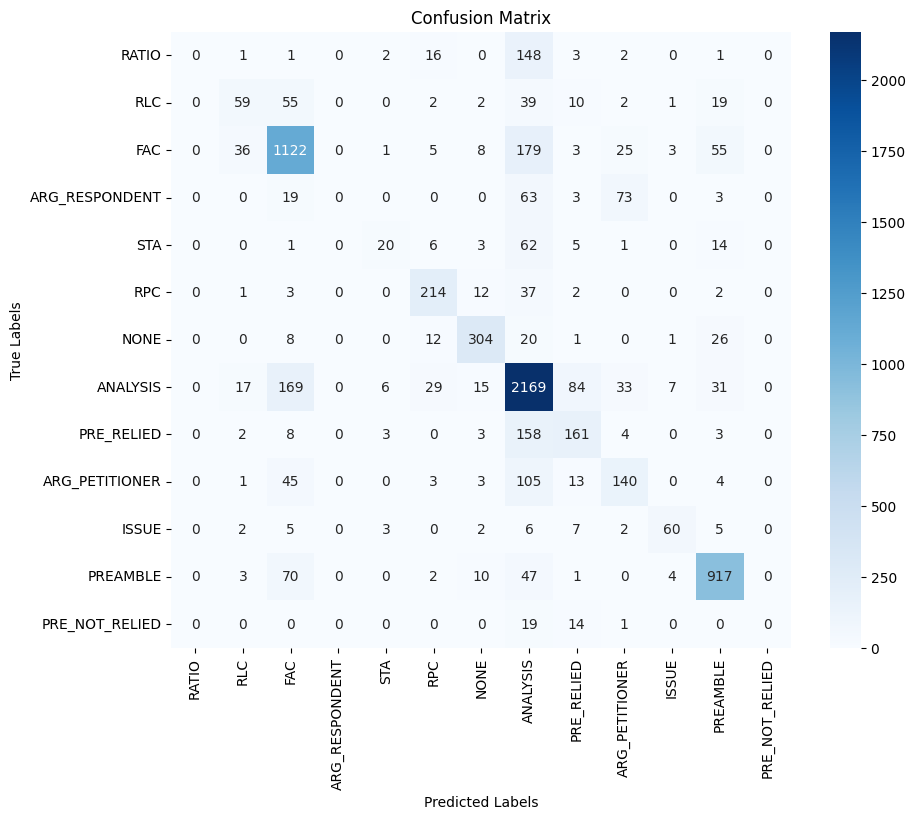

In [ ]:
# Final training with the best hyperparameters
final_training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/IndianLegalClassification/Code/Results/final_results_80_20strat_optuna_all',
    evaluation_strategy="epoch",
    learning_rate=best_params['learning_rate'],
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    weight_decay=best_params['weight_decay'],
    logging_dir='./logs_final',
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch"
)

# Final trainer setup with the best hyperparameters
final_model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))
final_model.dropout.p = best_params['dropout_rate']

final_trainer = Trainer(
    model=final_model,
    args=final_training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the final model
final_trainer.train()
final_results = final_trainer.evaluate()

# Print the final results
accuracy = final_results['eval_accuracy']
f1 = final_results['eval_f1']
report = final_results['eval_report']
print(f"Final Accuracy: {accuracy:.4f}")
print(f"Final F1 Score: {f1:.4f}")
print("Final Classification Report:", report)

# Predictions for confusion matrix and classification report
predictions = final_trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_df['label'].tolist()
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

#### New NER + Cleaned Text with aggregate Subwords and TF-iDF (0.6893)

In [ ]:
import os
import json
import torch
import numpy as np
import torch.nn as nn
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, AutoModel, Trainer, TrainingArguments, DataCollatorWithPadding
from datasets import Dataset
from sklearn.model_selection import train_test_split

# Disable wandb logs
os.environ["WANDB_DISABLED"] = "true"

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
checkpoint_dir = '/content/drive/MyDrive/IndianLegalClassification/Code/Results/final_results_80_20strat_optuna_all/checkpoint-7112'
tokenizer = AutoTokenizer.from_pretrained(checkpoint_dir)

# Define the best hyperparameters from Optuna tuning
best_params = {
    'learning_rate': 4.829817294596051e-05,
    'batch_size': 16,
    'num_train_epochs': 4,
    'dropout_rate': 0.4609865014489495,
    'weight_decay': 0.21798043138675602
}

# Load the TF-IDF dictionary from JSON
with open('/content/drive/MyDrive/IndianLegalClassification/Code/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Create combined TF-IDF vector per label
def create_combined_tfidf_dict(discriminative_words, max_length=512):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value

    combined_tfidf_vectors = {}
    for label, word_dict in tfidf_dict.items():
        tfidf_vector = list(word_dict.values())
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        combined_tfidf_vectors[label] = tfidf_vector
    return combined_tfidf_vectors

# Create TF-IDF dictionary for appending
combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# Function to get the combined TF-IDF vector based on label
def get_label_tfidf_vector(label, tfidf_dict):
    return np.array(tfidf_dict.get(label, [0.0] * 512))

# Load and split the dataset
texts = df['new_ner'].tolist()
cleaned_texts = df['cleaned_text'].tolist()
labels = df['labels'].tolist()

# Mapping labels to integers
unique_labels = list(set(labels))
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
int_labels = [label_to_int[label] for label in labels]

# Stratified 80-20 split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
train_cleaned_texts, test_cleaned_texts = train_test_split(cleaned_texts, test_size=0.2, random_state=42, stratify=int_labels)

# Tokenize the texts
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
train_cleaned_encodings = tokenizer(train_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

# Add combined TF-IDF features to the encodings
def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
    tfidf_features = [get_label_tfidf_vector(unique_labels[label], tfidf_dict) for label in labels]
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# Dataset Preparation
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings_with_tfidf['input_ids'],
    'attention_mask': train_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
    'tfidf_features': train_encodings_with_tfidf['tfidf_features'],
    'labels': torch.tensor(train_labels, dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings_with_tfidf['input_ids'],
    'attention_mask': test_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
    'tfidf_features': test_encodings_with_tfidf['tfidf_features'],
    'labels': torch.tensor(test_labels, dtype=torch.long)
})

# Define Custom Model with Subword Aggregation and TF-IDF Features
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        self.bert_new_ner = AutoModel.from_pretrained(model_name)
        self.bert_cleaned_text = AutoModel.from_pretrained(model_name)
        self.dropout = nn.Dropout(best_params['dropout_rate'])
        self.classifier = nn.Linear(self.bert_new_ner.config.hidden_size * 2 + tfidf_dim, num_labels)

    def aggregate_subword_embeddings(self, input_ids, attention_mask, model):
        outputs = model(input_ids=input_ids, attention_mask=attention_mask, output_hidden_states=True)
        hidden_states = outputs.hidden_states[-1]  # Last hidden layer
        word_embeddings = torch.mean(hidden_states, dim=1)  # Aggregate subword embeddings by averaging
        return word_embeddings

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, tfidf_features, labels=None):
        new_ner_embeddings = self.aggregate_subword_embeddings(input_ids, attention_mask, self.bert_new_ner)
        cleaned_text_embeddings = self.aggregate_subword_embeddings(cleaned_input_ids, cleaned_attention_mask, self.bert_cleaned_text)

        combined_embeddings = torch.cat((new_ner_embeddings, cleaned_text_embeddings, tfidf_features), dim=1)
        combined_embeddings = self.dropout(combined_embeddings)
        logits = self.classifier(combined_embeddings)

        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss()
            loss = loss_fct(logits, labels)
        return (loss, logits) if loss is not None else logits

# Instantiate the model
tfidf_dim = 512
model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=tfidf_dim)

# Custom DataCollator to handle TF-IDF features
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        # Ensure tfidf_features are converted to tensors
        tfidf_features = [torch.tensor(f['tfidf_features'], dtype=torch.float) for f in features]
        batch['tfidf_features'] = torch.stack(tfidf_features)
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

# Define compute_metrics function
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {'accuracy': accuracy, 'f1': f1, 'report': report}

# Training Arguments
training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/IndianLegalClassification/Code/Results/final_combined80_20strat',
    evaluation_strategy="epoch",
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    learning_rate=best_params['learning_rate'],
    weight_decay=best_params['weight_decay'],
    logging_dir='./logs',
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch"
)

# Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and Evaluate
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Final Accuracy: {accuracy:.4f}")
print(f"Final F1 Score: {f1:.4f}")
print("Final Classification Report:", report)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,0.932400,0.956961,0.671541,0.659011,"{'0': {'precision': 0.37254901960784315, 'recall': 0.10919540229885058, 'f1-score': 0.1688888888888889, 'support': 174.0}, '1': {'precision': 0.6333333333333333, 'recall': 0.20105820105820105, 'f1-score': 0.30522088353413657, 'support': 189.0}, '2': {'precision': 0.586639879457559, 'recall': 0.8128044537230341, 'f1-score': 0.6814469078179697, 'support': 1437.0}, '3': {'precision': 0.4576271186440678, 'recall': 0.16770186335403728, 'f1-score': 0.24545454545454545, 'support': 161.0}, '4': {'precision': 0.6407766990291263, 'recall': 0.5892857142857143, 'f1-score': 0.6139534883720931, 'support': 112.0}, '5': {'precision': 0.8015564202334631, 'recall': 0.7601476014760148, 'f1-score': 0.7803030303030303, 'support': 271.0}, '6': {'precision': 0.8435754189944135, 'recall': 0.8118279569892473, 'f1-score': 0.8273972602739726, 'support': 372.0}, '7': {'precision': 0.6587103669397933, 'recall': 0.722265625, 'f1-score': 0.6890255263648221, 'support': 2560.0}, '8': {'precision': 0.5719844357976653, 'recall': 0.4298245614035088, 'f1-score': 0.49081803005008345, 'support': 342.0}, '9': {'precision': 0.5307692307692308, 'recall': 0.4394904458598726, 'f1-score': 0.4808362369337979, 'support': 314.0}, '10': {'precision': 0.7684210526315789, 'recall': 0.7934782608695652, 'f1-score': 0.7807486631016043, 'support': 92.0}, '11': {'precision': 0.9127764127764127, 'recall': 0.7049335863377609, 'f1-score': 0.7955032119914347, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.671541057367829, 'macro avg': {'precision': 0.5983630298626529, 'recall': 0.5032318209735236, 'f1-score': 0.5276612825451061, 'support': 7112.0}, 'weighted avg': {'precision': 0.672854565398352, 'recall': 0.671541057367829, 'f1-score': 0.6590107493463923, 'support': 7112.0}}"
2,0.828200,0.918906,0.695866,0.689342,"{'0': {'precision': 0.32558139534883723, 'recall': 0.2413793103448276, 'f1-score': 0.27722772277227725, 'support': 174.0}, '1': {'precision': 0.4682926829268293, 'recall': 0.5079365079365079, 'f1-score': 0.4873096446700508, 'support': 189.0}, '2': {'precision': 0.72869429241595, 'recall': 0.6485734168406402, 'f1-score': 0.6863033873343152, 'support': 1437.0}, '3': {'precision': 0.4269005847953216, 'recall': 0.453416149068323, 'f1-score': 0.4397590361445783, 'support': 161.0}, '4': {'precision': 0.6973684210526315, 'recall': 0.4732142857142857, 'f1-score': 0.5638297872340425, 'support': 112.0}, '5': {'precision': 0.8326996197718631, 'recall': 0.8081180811808119, 'f1-score': 0.8202247191011236, 'support': 271.0}, '6': {'precision': 0.8641618497109826, 'recall': 0.803763440860215, 'f1-score': 0.8328690807799443, 'support': 372.0}, '7': {'precision': 0.6532880518678604, 'recall': 0.8265625, 'f1-score': 0.729780996723573, 'support': 2560.0}, '8': {'precision': 0.631578947368421, 'recall': 0.42105263157894735, 'f1-score': 0.5052631578947369, 'support': 342.0}, '9': {'precision': 0.6030927835051546, 'recall': 0.37261146496815284, 'f1-score': 0.46062992125984253, 'support': 314.0}, '10': {'precision': 0.782608695652174, 'recall': 0.782608695652174, 'f1-score': 0.782608695652174, 'support': 92.0}, '11': {'precision': 0.8831460674157303, 'recall': 0.74573055028463, 'f1-score': 0.808641975308642, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6958661417322834, 'macro avg': {'precision': 0.6074933378332119, 'recall': 0.5449974641868858, 'f1-score': 0.5688037019134846, 'support': 7112.0}, 'weighted avg': {'precision': 0.69838058806028, 'recall': 0.6958661417322834, 'f1-score': 0.6893421317468654, 'support': 7112.0}}"
3,0.453200,1.011905,0.687289,0.683769,"{'0': {'precision': 0.31788079470198677, 'recall': 0.27586206896551724, 'f1-score': 0.2953846153846154, 'support': 174.0}, '1': {'precision': 0.5380116959064327, 'recall': 0.48677248677248675, 'f1-score': 0.511111111111111

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Final Accuracy: 0.6959
Final F1 Score: 0.6893
Final Classification Report: {'0': {'precision': 0.32558139534883723, 'recall': 0.2413793103448276, 'f1-score': 0.27722772277227725, 'support': 174.0}, '1': {'precision': 0.4682926829268293, 'recall': 0.5079365079365079, 'f1-score': 0.4873096446700508, 'support': 189.0}, '2': {'precision': 0.72869429241595, 'recall': 0.6485734168406402, 'f1-score': 0.6863033873343152, 'support': 1437.0}, '3': {'precision': 0.4269005847953216, 'recall': 0.453416149068323, 'f1-score': 0.4397590361445783, 'support': 161.0}, '4': {'precision': 0.6973684210526315, 'recall': 0.4732142857142857, 'f1-score': 0.5638297872340425, 'support': 112.0}, '5': {'precision': 0.8326996197718631, 'recall': 0.8081180811808119, 'f1-score': 0.8202247191011236, 'support': 271.0}, '6': {'precision': 0.8641618497109826, 'recall': 0.803763440860215, 'f1-score': 0.8328690807799443, 'support': 372.0}, '7': {'precision': 0.6532880518678604, 'recall': 0.8265625, 'f1-score': 0.72978099672

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.33      0.24      0.28       174
           RLC       0.47      0.51      0.49       189
           FAC       0.73      0.65      0.69      1437
ARG_RESPONDENT       0.43      0.45      0.44       161
           STA       0.70      0.47      0.56       112
           RPC       0.83      0.81      0.82       271
          NONE       0.86      0.80      0.83       372
      ANALYSIS       0.65      0.83      0.73      2560
    PRE_RELIED       0.63      0.42      0.51       342
ARG_PETITIONER       0.60      0.37      0.46       314
         ISSUE       0.78      0.78      0.78        92
      PREAMBLE       0.88      0.75      0.81      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.70      7112
     macro avg       0.61      0.54      0.57      7112
  weighted avg       0.70      0.70      0.69      7112



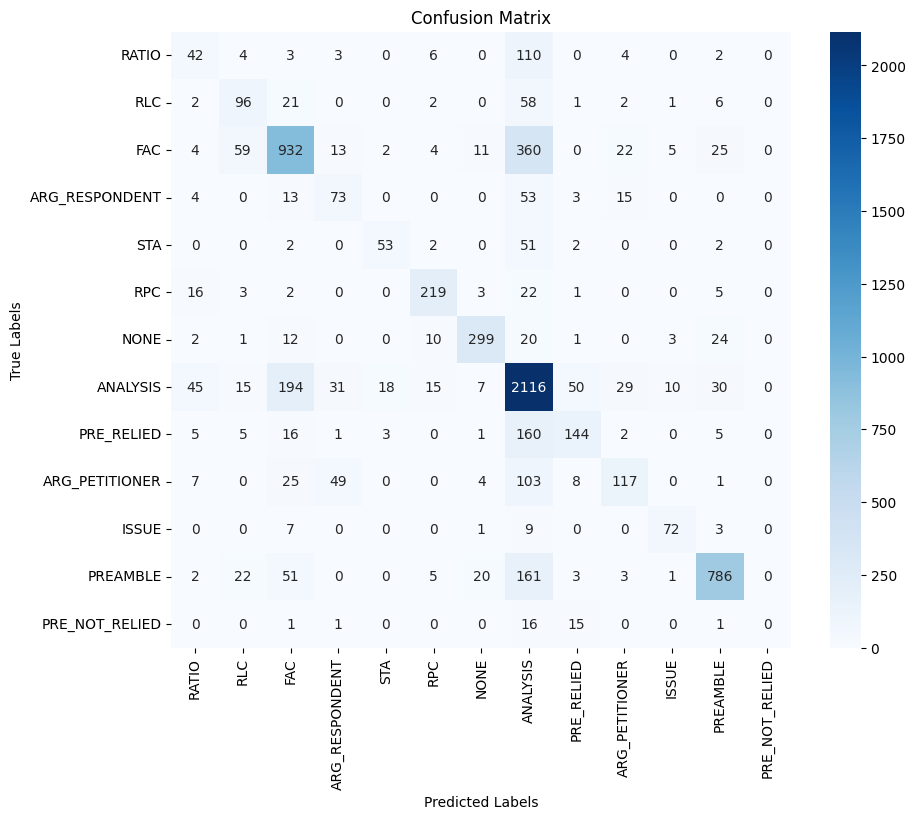

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_labels
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

In [ ]:
df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


### All features - With Aggregate Subword Embedding, Tf-IDF - Model *** (0.7026)

In [ ]:
!pip install datasets
!pip install optuna
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_masked_dataset.csv')
df.head()

In [ ]:
import os
import json
import torch
import numpy as np
import torch.nn as nn
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, AutoModel, Trainer, TrainingArguments, DataCollatorWithPadding
from datasets import Dataset
from sklearn.model_selection import train_test_split

# Disable wandb logs
os.environ["WANDB_DISABLED"] = "true"

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
checkpoint_dir = '/content/drive/MyDrive/IndianLegalClassification/Code/Results/final_results_80_20strat_optuna_all/checkpoint-7112'
tokenizer = AutoTokenizer.from_pretrained(checkpoint_dir)

# Define the best hyperparameters from Optuna tuning
best_params = {
    'learning_rate': 4.829817294596051e-05,
    'batch_size': 16,
    'num_train_epochs': 4,
    'dropout_rate': 0.4609865014489495,
    'weight_decay': 0.21798043138675602
}

# Load the TF-IDF dictionary from JSON
with open('/content/drive/MyDrive/IndianLegalClassification/Code/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Create combined TF-IDF vector per label
def create_combined_tfidf_dict(discriminative_words, max_length=512):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value

    combined_tfidf_vectors = {}
    for label, word_dict in tfidf_dict.items():
        tfidf_vector = list(word_dict.values())
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        combined_tfidf_vectors[label] = tfidf_vector
    return combined_tfidf_vectors

# Create TF-IDF dictionary for appending
combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# Function to get the combined TF-IDF vector based on label
def get_label_tfidf_vector(label, tfidf_dict):
    return np.array(tfidf_dict.get(label, [0.0] * 512))

texts = df['new_ner'].tolist()
cleaned_texts = df['cleaned_text'].tolist()
labels = df['labels'].tolist()
starts = df['start'].tolist()
ends = df['end'].tolist()
df['meta_group_id'], _ = pd.factorize(df['meta_group'])
meta_groups = df['meta_group_id'].tolist()

# Mapping labels to integers
unique_labels = list(set(labels))
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
train_cleaned_texts, test_cleaned_texts = train_test_split(cleaned_texts, test_size=0.2, random_state=42, stratify=int_labels)
train_starts, test_starts = train_test_split(starts, test_size=0.2, random_state=42, stratify=int_labels)
train_ends, test_ends = train_test_split(ends, test_size=0.2, random_state=42, stratify=int_labels)
train_meta_groups, test_meta_groups = train_test_split(meta_groups, test_size=0.2, random_state=42, stratify=int_labels)


# Tokenize the texts
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
train_cleaned_encodings = tokenizer(train_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

# Add combined TF-IDF features to the encodings
def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
    tfidf_features = [get_label_tfidf_vector(unique_labels[label], tfidf_dict) for label in labels]
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# Dataset Preparation
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings_with_tfidf['input_ids'],
    'attention_mask': train_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
    'tfidf_features': train_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(train_starts, dtype=torch.float),
    'end': torch.tensor(train_ends, dtype=torch.float),
    'meta_group': torch.tensor(train_meta_groups, dtype=torch.long),
    'labels': torch.tensor(train_labels, dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings_with_tfidf['input_ids'],
    'attention_mask': test_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
    'tfidf_features': test_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(test_starts, dtype=torch.float),
    'end': torch.tensor(test_ends, dtype=torch.float),
    'meta_group': torch.tensor(test_meta_groups, dtype=torch.long),
    'labels': torch.tensor(test_labels, dtype=torch.long)
})

# Define Custom Model with Subword Aggregation and TF-IDF Features
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        self.bert_new_ner = AutoModel.from_pretrained(model_name)
        self.bert_cleaned_text = AutoModel.from_pretrained(model_name)
        self.dropout = nn.Dropout(best_params['dropout_rate'])
        self.classifier = nn.Linear(self.bert_new_ner.config.hidden_size * 2 + tfidf_dim + 3, num_labels)  # +3 for start, end, meta_group

    def aggregate_subword_embeddings(self, input_ids, attention_mask, model):
        outputs = model(input_ids=input_ids, attention_mask=attention_mask, output_hidden_states=True)
        hidden_states = outputs.hidden_states[-1]  # Last hidden layer
        word_embeddings = torch.mean(hidden_states, dim=1)  # Aggregate subword embeddings by averaging
        return word_embeddings

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, tfidf_features, start, end, meta_group, labels=None):
        new_ner_embeddings = self.aggregate_subword_embeddings(input_ids, attention_mask, self.bert_new_ner)
        cleaned_text_embeddings = self.aggregate_subword_embeddings(cleaned_input_ids, cleaned_attention_mask, self.bert_cleaned_text)

        # Concatenate the embeddings, TF-IDF features, and additional numerical features
        combined_embeddings = torch.cat((new_ner_embeddings, cleaned_text_embeddings, tfidf_features, start.unsqueeze(1), end.unsqueeze(1), meta_group.unsqueeze(1).float()), dim=1)
        combined_embeddings = self.dropout(combined_embeddings)
        logits = self.classifier(combined_embeddings)

        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss()
            loss = loss_fct(logits, labels)
        return (loss, logits) if loss is not None else logits

# Instantiate the model
tfidf_dim = 512
model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=tfidf_dim)

# Custom DataCollator to handle TF-IDF features
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        batch['tfidf_features'] = torch.stack([torch.tensor(f['tfidf_features'], dtype=torch.float) for f in features])
        batch['start'] = torch.stack([torch.tensor(f['start'], dtype=torch.float) for f in features])
        batch['end'] = torch.stack([torch.tensor(f['end'], dtype=torch.float) for f in features])
        batch['meta_group'] = torch.stack([torch.tensor(f['meta_group'], dtype=torch.long) for f in features])
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

# Define compute_metrics function
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {'accuracy': accuracy, 'f1': f1, 'report': report}

# Define Training Arguments and Trainer
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/Results/final_results_with_all_features',
    evaluation_strategy="epoch",
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    weight_decay=best_params['weight_decay'],
    learning_rate=best_params['learning_rate'],
    save_strategy="epoch",
    load_best_model_at_end=True
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Final Accuracy: {accuracy:.4f}")
print(f"Final F1 Score: {f1:.4f}")
print("Final Classification Report:", report)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.592300,1.239350,0.675900,0.632169,"{'0': {'precision': 0.36363636363636365, 'recall': 0.022988505747126436, 'f1-score': 0.043243243243243246, 'support': 174.0}, '1': {'precision': 0.5862068965517241, 'recall': 0.08994708994708994, 'f1-score': 0.1559633027522936, 'support': 189.0}, '2': {'precision': 0.7380410022779044, 'recall': 0.6764091858037579, 'f1-score': 0.7058823529411765, 'support': 1437.0}, '3': {'precision': 0.5238095238095238, 'recall': 0.06832298136645963, 'f1-score': 0.12087912087912088, 'support': 161.0}, '4': {'precision': 0.6941176470588235, 'recall': 0.5267857142857143, 'f1-score': 0.5989847715736041, 'support': 112.0}, '5': {'precision': 0.8318181818181818, 'recall': 0.6752767527675276, 'f1-score': 0.745417515274949, 'support': 271.0}, '6': {'precision': 0.702355460385439, 'recall': 0.8817204301075269, 'f1-score': 0.7818831942789034, 'support': 372.0}, '7': {'precision': 0.5932668329177058, 'recall': 0.929296875, 'f1-score': 0.7242009132420091, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.5934959349593496, 'recall': 0.23248407643312102, 'f1-score': 0.3340961098398169, 'support': 314.0}, '10': {'precision': 0.8235294117647058, 'recall': 0.7608695652173914, 'f1-score': 0.7909604519774012, 'support': 92.0}, '11': {'precision': 0.9556451612903226, 'recall': 0.674573055028463, 'f1-score': 0.7908787541713015, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6758998875140607, 'macro avg': {'precision': 0.5696863397284649, 'recall': 0.42605186397724454, 'f1-score': 0.44556844078260155, 'support': 7112.0}, 'weighted avg': {'precision': 0.6568531694408464, 'recall': 0.6758998875140607, 'f1-score': 0.6321690020216173, 'support': 7112.0}}"
2,1.032900,0.966910,0.694882,0.672238,"{'0': {'precision': 0.37037037037037035, 'recall': 0.05747126436781609, 'f1-score': 0.09950248756218906, 'support': 174.0}, '1': {'precision': 0.4482758620689655, 'recall': 0.48148148148148145, 'f1-score': 0.4642857142857143, 'support': 189.0}, '2': {'precision': 0.8436170212765958, 'recall': 0.5518441196938065, 'f1-score': 0.6672275978123685, 'support': 1437.0}, '3': {'precision': 0.368, 'recall': 0.2857142857142857, 'f1-score': 0.32167832167832167, 'support': 161.0}, '4': {'precision': 0.7222222222222222, 'recall': 0.23214285714285715, 'f1-score': 0.35135135135135137, 'support': 112.0}, '5': {'precision': 0.7821428571428571, 'recall': 0.8081180811808119, 'f1-score': 0.79491833030853, 'support': 271.0}, '6': {'precision': 0.8196286472148541, 'recall': 0.8306451612903226, 'f1-score': 0.8251001335113485, 'support': 372.0}, '7': {'precision': 0.6158221302998966, 'recall': 0.93046875, 'f1-score': 0.7411325451151214, 'support': 2560.0}, '8': {'precision': 0.6277372262773723, 'recall': 0.25146198830409355, 'f1-score': 0.35908141962421714, 'support': 342.0}, '9': {'precision': 0.6470588235294118, 'recall': 0.2802547770700637, 'f1-score': 0.39111111111111113, 'support': 314.0}, '10': {'precision': 0.7777777777777778, 'recall': 0.8369565217391305, 'f1-score': 0.806282722513089, 'support': 92.0}, '11': {'precision': 0.9219457013574661, 'recall': 0.7732447817836812, 'f1-score': 0.8410732714138287, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6948818897637795, 'macro avg': {'precision': 0.6111229722721377, 'recall': 0.48613877459756544, 'f1-score': 0.5125188466374763, 'support': 7112.0}, 'weighted avg': {'precision': 0.7109250959248641, 'recall': 0.6948818897637795, 'f1-score': 0.6722376908956765, 'support': 7112.0}}"
3,0.812900,0.882880,0.713020,0.702645,"{'0': {'precision': 0.3684210526315789, 'recall': 0.16091954022988506, 'f1-score': 0.224, 'support': 174.0}, '1': {'precision': 0.5496688741721855, 'recall': 0.43915343915343913, 'f1-score': 0.48823529411764705, 'support': 189.0}, '2': {'precision': 0.69774

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Trainer is attempting to log a value of "{'0': {'precision': 0.3684210526315789, 'recall': 0.16091954022988506, 'f1-score': 0.224, 'support': 174.0}, '1': {'precision': 0.5496688741721855, 'recall': 0.43915343915343913, 'f1-score': 0.48823529411764705, 'support': 189.0}, '2': {'precision': 0.6977491961414791, 'recall': 0.7550452331245651, 'f1-score': 0.7252673796791443, 'support': 1437.0}, '3': {'precision': 0.5588235294117647, 'recall': 0.11801242236024845, 'f1-score': 0.19487179487179487, 'support': 161.0}, '4': {'precision': 0.6344086021505376, 'recall': 0.5267857142857143, 'f1-score': 0.5756097560975609, 'support': 112.0}, '5': {'precision': 0.7773972602739726, 'recall': 0.8376383763837638, 'f1-score': 0.8063943161634103, 'support': 271.0}, '6': {'precision': 0.8714285714285714, 'recall': 0.8198924731182796, 'f1-score': 0.8448753462603878, 'support': 372.0}, '7': {'precision': 0.686522462562396, 'recall': 0.805859375, 'f1-score': 0.7414195867026055, 'support': 2560.0}, '8': {'preci

Final Accuracy: 0.7130
Final F1 Score: 0.7026
Final Classification Report: {'0': {'precision': 0.3684210526315789, 'recall': 0.16091954022988506, 'f1-score': 0.224, 'support': 174.0}, '1': {'precision': 0.5496688741721855, 'recall': 0.43915343915343913, 'f1-score': 0.48823529411764705, 'support': 189.0}, '2': {'precision': 0.6977491961414791, 'recall': 0.7550452331245651, 'f1-score': 0.7252673796791443, 'support': 1437.0}, '3': {'precision': 0.5588235294117647, 'recall': 0.11801242236024845, 'f1-score': 0.19487179487179487, 'support': 161.0}, '4': {'precision': 0.6344086021505376, 'recall': 0.5267857142857143, 'f1-score': 0.5756097560975609, 'support': 112.0}, '5': {'precision': 0.7773972602739726, 'recall': 0.8376383763837638, 'f1-score': 0.8063943161634103, 'support': 271.0}, '6': {'precision': 0.8714285714285714, 'recall': 0.8198924731182796, 'f1-score': 0.8448753462603878, 'support': 372.0}, '7': {'precision': 0.686522462562396, 'recall': 0.805859375, 'f1-score': 0.7414195867026055

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.37      0.16      0.22       174
           RLC       0.55      0.44      0.49       189
           FAC       0.70      0.76      0.73      1437
ARG_RESPONDENT       0.56      0.12      0.19       161
           STA       0.63      0.53      0.58       112
           RPC       0.78      0.84      0.81       271
          NONE       0.87      0.82      0.84       372
      ANALYSIS       0.69      0.81      0.74      2560
    PRE_RELIED       0.57      0.41      0.48       342
ARG_PETITIONER       0.49      0.54      0.51       314
         ISSUE       0.68      0.79      0.73        92
      PREAMBLE       0.96      0.78      0.86      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.71      7112
     macro avg       0.60      0.54      0.55      7112
  weighted avg       0.71      0.71      0.70      7112



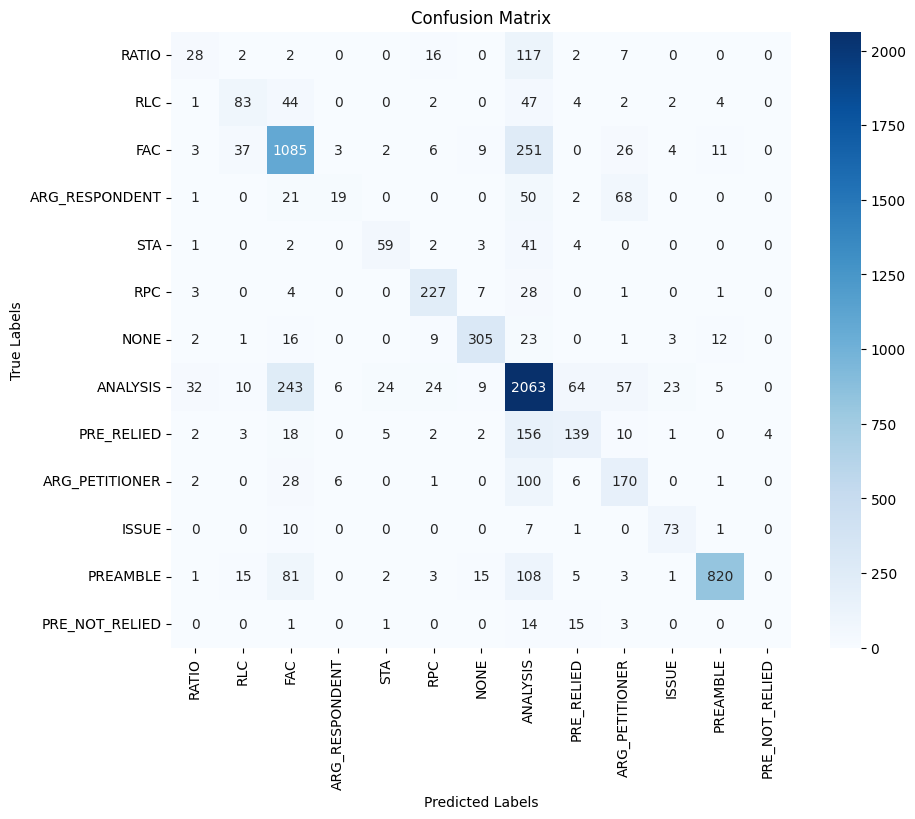

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_labels
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

### Optuna All features - With Tf-IDF - Model *** (0.7108)

In [ ]:
# #!pip install optuna
# import os
# import json
# import torch
# import numpy as np
# import torch.nn as nn
# import pandas as pd
# import optuna
# from sklearn.metrics import accuracy_score, f1_score, classification_report
# from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments, DataCollatorWithPadding
# from datasets import Dataset
# from sklearn.model_selection import train_test_split

# # Disable wandb logs
# os.environ["WANDB_DISABLED"] = "true"

# # Load the InLegalBERT model and tokenizer
# model_name = "law-ai/InLegalBERT"
# tokenizer = AutoTokenizer.from_pretrained(model_name)

# # Load the TF-IDF dictionary from JSON
# with open('/content/drive/MyDrive/IndianLegalClassification/Code/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
#     discriminative_words_data = json.load(f)

# # Create combined TF-IDF vector per label
# def create_combined_tfidf_dict(discriminative_words, max_length=512):
#     tfidf_dict = {}
#     for item in discriminative_words:
#         label = item['label']
#         word = item['word']
#         tfidf_value = item['tfidf_value']
#         if label not in tfidf_dict:
#             tfidf_dict[label] = {}
#         tfidf_dict[label][word] = tfidf_value

#     combined_tfidf_vectors = {}
#     for label, word_dict in tfidf_dict.items():
#         tfidf_vector = list(word_dict.values())
#         if len(tfidf_vector) < max_length:
#             tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
#         else:
#             tfidf_vector = tfidf_vector[:max_length]
#         combined_tfidf_vectors[label] = tfidf_vector
#     return combined_tfidf_vectors

# # Create TF-IDF dictionary for appending
# combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# # Function to get the combined TF-IDF vector based on label
# def get_label_tfidf_vector(label, tfidf_dict):
#     return np.array(tfidf_dict.get(label, [0.0] * 512))

# # Load and split the dataset
# texts = df['new_ner'].tolist()
# cleaned_texts = df['cleaned_text'].tolist()
# labels = df['labels'].tolist()
# starts = df['start'].tolist()
# ends = df['end'].tolist()
# df['meta_group_id'], _ = pd.factorize(df['meta_group'])
# meta_groups = df['meta_group_id'].tolist()

# # Mapping labels to integers
# unique_labels = list(set(labels))
# label_to_int = {
#     'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
#     'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
#     'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
# }
# int_labels = [label_to_int[label] for label in labels]

# # Stratified 80-20 split
# train_texts, test_texts, train_labels, test_labels = train_test_split(
#     texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
# )
# train_cleaned_texts, test_cleaned_texts = train_test_split(cleaned_texts, test_size=0.2, random_state=42, stratify=int_labels)
# train_starts, test_starts = train_test_split(starts, test_size=0.2, random_state=42, stratify=int_labels)
# train_ends, test_ends = train_test_split(ends, test_size=0.2, random_state=42, stratify=int_labels)
# train_meta_groups, test_meta_groups = train_test_split(meta_groups, test_size=0.2, random_state=42, stratify=int_labels)

# # Tokenize the texts
# train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
# test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
# train_cleaned_encodings = tokenizer(train_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
# test_cleaned_encodings = tokenizer(test_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

# # Add combined TF-IDF features to the encodings
# def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
#     tfidf_features = [get_label_tfidf_vector(unique_labels[label], tfidf_dict) for label in labels]
#     encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
#     return encodings

# train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
# test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# # Dataset Preparation
# train_dataset = Dataset.from_dict({
#     'input_ids': train_encodings_with_tfidf['input_ids'],
#     'attention_mask': train_encodings_with_tfidf['attention_mask'],
#     'cleaned_input_ids': train_cleaned_encodings['input_ids'],
#     'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
#     'tfidf_features': train_encodings_with_tfidf['tfidf_features'],
#     'start': torch.tensor(train_starts, dtype=torch.float),
#     'end': torch.tensor(train_ends, dtype=torch.float),
#     'meta_group': torch.tensor(train_meta_groups, dtype=torch.long),
#     'labels': torch.tensor(train_labels, dtype=torch.long)
# })

# test_dataset = Dataset.from_dict({
#     'input_ids': test_encodings_with_tfidf['input_ids'],
#     'attention_mask': test_encodings_with_tfidf['attention_mask'],
#     'cleaned_input_ids': test_cleaned_encodings['input_ids'],
#     'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
#     'tfidf_features': test_encodings_with_tfidf['tfidf_features'],
#     'start': torch.tensor(test_starts, dtype=torch.float),
#     'end': torch.tensor(test_ends, dtype=torch.float),
#     'meta_group': torch.tensor(test_meta_groups, dtype=torch.long),
#     'labels': torch.tensor(test_labels, dtype=torch.long)
# })

# # Define Custom Model with TF-IDF Features
# class CustomBERTClassifier(nn.Module):
#     def __init__(self, model_name, num_labels, tfidf_dim):
#         super(CustomBERTClassifier, self).__init__()
#         # self.bert_new_ner = AutoModelForSequenceClassification.from_pretrained(model_name)
#         # self.bert_cleaned_text = AutoModelForSequenceClassification.from_pretrained(model_name)
#         self.bert_new_ner = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
#         self.bert_cleaned_text = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
#         self.dropout = nn.Dropout(0.3)
#         # Calculate the input size for the classifier layer
#         hidden_size = self.bert_new_ner.config.hidden_size
#         combined_input_size = hidden_size * 2 + tfidf_dim + 3  # new_ner, cleaned_text, tfidf + start, end, meta_group
#         self.classifier = nn.Linear(combined_input_size, num_labels)  # Correct combined size for input

#     def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, tfidf_features, start, end, meta_group, labels=None):
#         # Get the hidden layer outputs from BERT (not logits) for both text features
#         new_ner_outputs = self.bert_new_ner.bert(input_ids=input_ids, attention_mask=attention_mask).pooler_output
#         cleaned_text_outputs = self.bert_cleaned_text.bert(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask).pooler_output

#         # Concatenate all features: BERT outputs, TF-IDF features, and scalar features (start, end, meta_group)
#         combined_embeddings = torch.cat((
#             new_ner_outputs,
#             cleaned_text_outputs,
#             tfidf_features,
#             start.unsqueeze(1),
#             end.unsqueeze(1),
#             meta_group.unsqueeze(1).float()
#         ), dim=1)

#         # Apply dropout and pass through the classifier
#         combined_embeddings = self.dropout(combined_embeddings)
#         logits = self.classifier(combined_embeddings)

#         # Calculate loss if labels are provided
#         loss = None
#         if labels is not None:
#             loss_fct = nn.CrossEntropyLoss()
#             loss = loss_fct(logits, labels)
#         return (loss, logits) if loss is not None else logits

# # Custom DataCollator to handle TF-IDF features
# class CustomDataCollator(DataCollatorWithPadding):
#     def __call__(self, features):
#         batch = super().__call__(features)
#         batch['tfidf_features'] = torch.stack([torch.tensor(f['tfidf_features'], dtype=torch.float) for f in features])
#         batch['start'] = torch.stack([torch.tensor(f['start'], dtype=torch.float) for f in features])
#         batch['end'] = torch.stack([torch.tensor(f['end'], dtype=torch.float) for f in features])
#         batch['meta_group'] = torch.stack([torch.tensor(f['meta_group'], dtype=torch.long) for f in features])
#         return batch

# data_collator = CustomDataCollator(tokenizer=tokenizer)

# def compute_metrics(pred):
#     labels = pred.label_ids
#     preds = pred.predictions.argmax(-1)
#     accuracy = accuracy_score(labels, preds)
#     f1 = f1_score(labels, preds, average='weighted')
#     report = classification_report(labels, preds, output_dict=True)
#     return {'accuracy': accuracy, 'f1': f1, 'report': report}


# # Hyperparameter Tuning with Optuna
# def objective(trial):
#     learning_rate = trial.suggest_loguniform('learning_rate', 3e-5, 5e-5)
#     dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)
#     num_train_epochs = trial.suggest_int('num_train_epochs', 3, 4)
#     batch_size = trial.suggest_categorical('batch_size', [16, 32])
#     weight_decay = trial.suggest_uniform("weight_decay", 0.0, 0.3)

#     # Initialize model
#     tfidf_dim = 512
#     model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=tfidf_dim)
#     model.dropout.p = dropout_rate

#     training_args = TrainingArguments(
#         output_dir='./results',
#         evaluation_strategy="epoch",
#         per_device_train_batch_size=batch_size,
#         per_device_eval_batch_size=batch_size,
#         num_train_epochs=num_train_epochs,
#         weight_decay=weight_decay,
#         learning_rate=learning_rate,
#         save_strategy="epoch",
#         save_total_limit=1,
#         load_best_model_at_end=True,
#         logging_dir='./logs',
#         report_to='none'
#     )

#     trainer = Trainer(
#         model=model,
#         args=training_args,
#         train_dataset=train_dataset,
#         eval_dataset=test_dataset,
#         tokenizer=tokenizer,
#         data_collator=data_collator,
#         compute_metrics=compute_metrics,
#     )

#     trainer.train()
#     eval_results = trainer.evaluate()
#     return eval_results["eval_loss"]

# study = optuna.create_study(direction="minimize", study_name="inlegalbert_optimization", storage="sqlite:////content/drive/My Drive/IndianLegalClassification/Code/optuna_classification_all.db", load_if_exists=True)
# study.optimize(objective, n_trials=5)

# # Use best params
# best_params = study.best_params
# print("Best hyperparameters:", best_params)


[I 2024-11-07 19:08:02,365] Using an existing study with name 'inlegalbert_optimization' instead of creating a new one.
<ipython-input-3-e2b675411fcc>:183: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 3e-5, 5e-5)
<ipython-input-3-e2b675411fcc>:187: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  weight_decay = trial.suggest_uniform("weight_decay", 0.0, 0.3)
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,189.139900,1.932668,0.625141,0.557420,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.571917808219178, 'recall': 0.813500347947112, 'f1-score': 0.6716460787130135, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.09090909090909091, 'recall': 0.017857142857142856, 'f1-score': 0.029850746268656716, 'support': 112.0}, '5': {'precision': 0.7656903765690377, 'recall': 0.6752767527675276, 'f1-score': 0.7176470588235294, 'support': 271.0}, '6': {'precision': 0.6207865168539326, 'recall': 0.5940860215053764, 'f1-score': 0.6071428571428571, 'support': 372.0}, '7': {'precision': 0.6113475177304964, 'recall': 0.841796875, 'f1-score': 0.7082990961380444, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7732181425485961, 'recall': 0.6793168880455408, 'f1-score': 0.7232323232323232, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.625140607424072, 'macro avg': {'precision': 0.26414380406387167, 'recall': 0.27860261754789994, 'f1-score': 0.26598601233218655, 'support': 7112.0}, 'weighted avg': {'precision': 0.5132851451840468, 'recall': 0.625140607424072, 'f1-score': 0.5574199591241946, 'support': 7112.0}}"
2,1.520700,0.960875,0.700506,0.688665,"{'0': {'precision': 0.3409090909090909, 'recall': 0.25862068965517243, 'f1-score': 0.29411764705882354, 'support': 174.0}, '1': {'precision': 0.5, 'recall': 0.1164021164021164, 'f1-score': 0.1888412017167382, 'support': 189.0}, '2': {'precision': 0.700507614213198, 'recall': 0.7682672233820459, 'f1-score': 0.732824427480916, 'support': 1437.0}, '3': {'precision': 0.2603550295857988, 'recall': 0.2732919254658385, 'f1-score': 0.26666666666666666, 'support': 161.0}, '4': {'precision': 0.696969696969697, 'recall': 0.4107142857142857, 'f1-score': 0.5168539325842697, 'support': 112.0}, '5': {'precision': 0.8681818181818182, 'recall': 0.7047970479704797, 'f1-score': 0.7780040733197556, 'support': 271.0}, '6': {'precision': 0.7755610972568578, 'recall': 0.8360215053763441, 'f1-score': 0.8046571798188874, 'support': 372.0}, '7': {'precision': 0.6822061720288903, 'recall': 0.81171875, 'f1-score': 0.7413485551195148, 'support': 2560.0}, '8': {'precision': 0.5247524752475248, 'recall': 0.4649122807017544, 'f1-score': 0.4930232558139535, 'support': 342.0}, '9': {'precision': 0.5314285714285715, 'recall': 0.2961783439490446, 'f1-score': 0.3803680981595092, 'support': 314.0}, '10': {'precision': 0.6460176991150443, 'recall': 0.7934782608695652, 'f1-score': 0.7121951219512195, 'support': 92.0}, '11': {'precision': 0.9411764705882353, 'recall': 0.7741935483870968, 'f1-score': 0.8495575221238938, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7005061867266592, 'macro avg': {'precision': 0.5744665950403636, 'recall': 0.5006612290672111, 'f1-score': 0.5198813601395499, 'support': 7112.0}, 'weighted avg': {'precision': 0.6957855366773144, 'recall': 0.7005061867266592, 'f1-score': 0.6886650907624211, 'support': 7112.0}}"
3,0.892100,0.892915,0.706412,0.694840,"{'0': {'precision': 0.4065934065934066, 'recall': 0.21264367816091953, 'f1-score': 0.2792452830188679, 'support': 174.0}, '1': {'precision': 0.47863247863247865, 'recall': 0.2962962962962963, 'f1-score': 0.3660130718954248, 'support': 189.0}, '2': {'precision': 0.6810293237582286, 'recall': 0.7919276270006959, 'f1-score': 0.7323037323037324, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.6190476190476191, 'recall': 0.5803

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-07 20:06:51,863] Trial 9 finished with

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,2.287900,1.622162,0.683774,0.639796,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.5111111111111111, 'recall': 0.12169312169312169, 'f1-score': 0.19658119658119658, 'support': 189.0}, '2': {'precision': 0.7913419913419913, 'recall': 0.6360473208072372, 'f1-score': 0.7052469135802469, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.5575221238938053, 'recall': 0.5625, 'f1-score': 0.56, 'support': 112.0}, '5': {'precision': 0.7970297029702971, 'recall': 0.5940959409594095, 'f1-score': 0.6807610993657506, 'support': 271.0}, '6': {'precision': 0.7116704805491991, 'recall': 0.8360215053763441, 'f1-score': 0.7688504326328801, 'support': 372.0}, '7': {'precision': 0.5996507857321027, 'recall': 0.9390625, 'f1-score': 0.7319226670726138, 'support': 2560.0}, '8': {'precision': 0.68, 'recall': 0.049707602339181284, 'f1-score': 0.09264305177111716, 'support': 342.0}, '9': {'precision': 0.5655737704918032, 'recall': 0.2197452229299363, 'f1-score': 0.3165137614678899, 'support': 314.0}, '10': {'precision': 0.71, 'recall': 0.7717391304347826, 'f1-score': 0.7395833333333334, 'support': 92.0}, '11': {'precision': 0.918141592920354, 'recall': 0.7874762808349146, 'f1-score': 0.8478038815117467, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6837739032620922, 'macro avg': {'precision': 0.5263108891546664, 'recall': 0.42446835579807135, 'f1-score': 0.4338389490243673, 'support': 7112.0}, 'weighted avg': {'precision': 0.6686213163737996, 'recall': 0.6837739032620922, 'f1-score': 0.6397961909629905, 'support': 7112.0}}"
2,0.947200,0.914213,0.717379,0.701076,"{'0': {'precision': 0.14285714285714285, 'recall': 0.005747126436781609, 'f1-score': 0.011049723756906077, 'support': 174.0}, '1': {'precision': 0.4066390041493776, 'recall': 0.5185185185185185, 'f1-score': 0.4558139534883721, 'support': 189.0}, '2': {'precision': 0.8112889637742208, 'recall': 0.6701461377870563, 'f1-score': 0.7339939024390244, 'support': 1437.0}, '3': {'precision': 0.2849162011173184, 'recall': 0.3167701863354037, 'f1-score': 0.3, 'support': 161.0}, '4': {'precision': 0.6296296296296297, 'recall': 0.6071428571428571, 'f1-score': 0.6181818181818182, 'support': 112.0}, '5': {'precision': 0.8232931726907631, 'recall': 0.7564575645756457, 'f1-score': 0.7884615384615384, 'support': 271.0}, '6': {'precision': 0.867816091954023, 'recall': 0.8118279569892473, 'f1-score': 0.8388888888888889, 'support': 372.0}, '7': {'precision': 0.6702605570530099, 'recall': 0.87421875, 'f1-score': 0.7587726733344635, 'support': 2560.0}, '8': {'precision': 0.5691056910569106, 'recall': 0.4093567251461988, 'f1-score': 0.47619047619047616, 'support': 342.0}, '9': {'precision': 0.5725806451612904, 'recall': 0.22611464968152867, 'f1-score': 0.3242009132420091, 'support': 314.0}, '10': {'precision': 0.7222222222222222, 'recall': 0.8478260869565217, 'f1-score': 0.78, 'support': 92.0}, '11': {'precision': 0.9088114754098361, 'recall': 0.8415559772296015, 'f1-score': 0.8738916256157635, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7173790776152981, 'macro avg': {'precision': 0.5699554459289035, 'recall': 0.5296678874461047, 'f1-score': 0.5353419625845585, 'support': 7112.0}, 'weighted avg': {'precision': 0.7092923865289168, 'recall': 0.7173790776152981, 'f1-score': 0.7010760518735045, 'support': 7112.0}}"
3,0.758100,0.830646,0.731299,0.718063,"{'0': {'precision': 0.3717948717948718, 'recall': 0.16666666666666666, 'f1-score': 0.23015873015873015, 'support': 174.0}, '1': {'precision': 0.5089820359281437, 'recall': 0.4497354497354497, 'f1-score': 0.47752808988764045, 'support': 189.0}, '2': {'precision': 0.7429322813938198, 'recall': 0.7863604732080723, 'f1-score': 0.7640297498309668, 'support': 1437.0}, '3': {'precisi

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-07 21:29:05,689] Trial 10 finished wit

Epoch,Training Loss,Validation Loss


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,11.145000,4.364859,0.681102,0.638568,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.38095238095238093, 'recall': 0.08465608465608465, 'f1-score': 0.13852813852813853, 'support': 189.0}, '2': {'precision': 0.7214236824093087, 'recall': 0.7334725121781489, 'f1-score': 0.7273982056590752, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.5098039215686274, 'recall': 0.6964285714285714, 'f1-score': 0.5886792452830188, 'support': 112.0}, '5': {'precision': 0.7556390977443609, 'recall': 0.7416974169741697, 'f1-score': 0.7486033519553073, 'support': 271.0}, '6': {'precision': 0.7216981132075472, 'recall': 0.8225806451612904, 'f1-score': 0.7688442211055276, 'support': 372.0}, '7': {'precision': 0.6269241533725161, 'recall': 0.875, 'f1-score': 0.7304744823088212, 'support': 2560.0}, '8': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 342.0}, '9': {'precision': 0.50390625, 'recall': 0.410828025477707, 'f1-score': 0.45263157894736844, 'support': 314.0}, '10': {'precision': 0.76, 'recall': 0.8260869565217391, 'f1-score': 0.7916666666666666, 'support': 92.0}, '11': {'precision': 0.8910179640718563, 'recall': 0.7058823529411765, 'f1-score': 0.787718369507676, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6811023622047244, 'macro avg': {'precision': 0.4516435048712767, 'recall': 0.4535871204106836, 'f1-score': 0.44111878922781533, 'support': 7112.0}, 'weighted avg': {'precision': 0.620252965931548, 'recall': 0.6811023622047244, 'f1-score': 0.6385680763654712, 'support': 7112.0}}"
2,0.934300,0.917156,0.709364,0.694937,"{'0': {'precision': 0.417910447761194, 'recall': 0.16091954022988506, 'f1-score': 0.23236514522821577, 'support': 174.0}, '1': {'precision': 0.42857142857142855, 'recall': 0.49206349206349204, 'f1-score': 0.458128078817734, 'support': 189.0}, '2': {'precision': 0.8099389712292938, 'recall': 0.6464857341684064, 'f1-score': 0.7190402476780186, 'support': 1437.0}, '3': {'precision': 0.3177083333333333, 'recall': 0.37888198757763975, 'f1-score': 0.34560906515580736, 'support': 161.0}, '4': {'precision': 0.6263736263736264, 'recall': 0.5089285714285714, 'f1-score': 0.5615763546798029, 'support': 112.0}, '5': {'precision': 0.8333333333333334, 'recall': 0.7380073800738007, 'f1-score': 0.7827788649706457, 'support': 271.0}, '6': {'precision': 0.8211382113821138, 'recall': 0.8145161290322581, 'f1-score': 0.8178137651821862, 'support': 372.0}, '7': {'precision': 0.6531428571428571, 'recall': 0.89296875, 'f1-score': 0.7544554455445545, 'support': 2560.0}, '8': {'precision': 0.6335403726708074, 'recall': 0.2982456140350877, 'f1-score': 0.40556660039761433, 'support': 342.0}, '9': {'precision': 0.6239316239316239, 'recall': 0.23248407643312102, 'f1-score': 0.33874709976798145, 'support': 314.0}, '10': {'precision': 0.7572815533980582, 'recall': 0.8478260869565217, 'f1-score': 0.8, 'support': 92.0}, '11': {'precision': 0.9196035242290749, 'recall': 0.7922201138519924, 'f1-score': 0.8511722731906218, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7093644544431946, 'macro avg': {'precision': 0.6032672525659034, 'recall': 0.5233498058346749, 'f1-score': 0.5436348415856295, 'support': 7112.0}, 'weighted avg': {'precision': 0.7162209539452562, 'recall': 0.7093644544431946, 'f1-score': 0.6949367077543196, 'support': 7112.0}}"
3,0.736700,0.862586,0.716254,0.706751,"{'0': {'precision': 0.4307692307692308, 'recall': 0.16091954022988506, 'f1-score': 0.23430962343096234, 'support': 174.0}, '1': {'precision': 0.5413533834586466, 'recall': 0.38095238095238093, 'f1-score': 0.4472049689440994, 'support': 189.0}, '2': {'precision': 0.6995600251414205, 'recall': 0.7745302713987474, 'f1-score': 0.7351387054161163, 'support': 1437.0}, '3': {'precision':

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-07 22:31:10,372] Trial 11 finished wit

Epoch,Training Loss,Validation Loss


[W 2024-11-07 22:31:17,608] Trial 12 failed with parameters: {'learning_rate': 4.714024097046737e-05, 'dropout_rate': 0.394124519600319, 'num_train_epochs': 4, 'batch_size': 16, 'weight_decay': 0.22559986950985889} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-3-e2b675411fcc>", line 219, in objective
    trainer.train()
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 1938, in train
    return inner_training_loop(
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 2279, in _inner_training_loop
    tr_loss_step = self.training_step(model, inputs)
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 3318, in training_step
    loss = self.compute_loss(model, inputs)
  File "/usr/local/lib/python3.10/dist-packag

KeyboardInterrupt: 

In [ ]:
#!pip install optuna
import os
import json
import torch
import numpy as np
import torch.nn as nn
import pandas as pd
import optuna
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments, DataCollatorWithPadding
from datasets import Dataset
from sklearn.model_selection import train_test_split

# Disable wandb logs
os.environ["WANDB_DISABLED"] = "true"

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Load the TF-IDF dictionary from JSON
with open('/content/drive/MyDrive/IndianLegalClassification/Code/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Create combined TF-IDF vector per label
def create_combined_tfidf_dict(discriminative_words, max_length=512):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value

    combined_tfidf_vectors = {}
    for label, word_dict in tfidf_dict.items():
        tfidf_vector = list(word_dict.values())
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        combined_tfidf_vectors[label] = tfidf_vector
    return combined_tfidf_vectors

# Create TF-IDF dictionary for appending
combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# Function to get the combined TF-IDF vector based on label
def get_label_tfidf_vector(label, tfidf_dict):
    return np.array(tfidf_dict.get(label, [0.0] * 512))

# Load and split the dataset
texts = df['new_ner'].tolist()
cleaned_texts = df['cleaned_text'].tolist()
labels = df['labels'].tolist()
starts = df['start'].tolist()
ends = df['end'].tolist()
df['meta_group_id'], _ = pd.factorize(df['meta_group'])
meta_groups = df['meta_group_id'].tolist()

# Mapping labels to integers
unique_labels = list(set(labels))
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
int_labels = [label_to_int[label] for label in labels]

# Stratified 80-20 split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
train_cleaned_texts, test_cleaned_texts = train_test_split(cleaned_texts, test_size=0.2, random_state=42, stratify=int_labels)
train_starts, test_starts = train_test_split(starts, test_size=0.2, random_state=42, stratify=int_labels)
train_ends, test_ends = train_test_split(ends, test_size=0.2, random_state=42, stratify=int_labels)
train_meta_groups, test_meta_groups = train_test_split(meta_groups, test_size=0.2, random_state=42, stratify=int_labels)

# Tokenize the texts
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
train_cleaned_encodings = tokenizer(train_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

# Add combined TF-IDF features to the encodings
def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
    tfidf_features = [get_label_tfidf_vector(unique_labels[label], tfidf_dict) for label in labels]
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# Dataset Preparation
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings_with_tfidf['input_ids'],
    'attention_mask': train_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
    'tfidf_features': train_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(train_starts, dtype=torch.float),
    'end': torch.tensor(train_ends, dtype=torch.float),
    'meta_group': torch.tensor(train_meta_groups, dtype=torch.long),
    'labels': torch.tensor(train_labels, dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings_with_tfidf['input_ids'],
    'attention_mask': test_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
    'tfidf_features': test_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(test_starts, dtype=torch.float),
    'end': torch.tensor(test_ends, dtype=torch.float),
    'meta_group': torch.tensor(test_meta_groups, dtype=torch.long),
    'labels': torch.tensor(test_labels, dtype=torch.long)
})

# Define Custom Model with TF-IDF Features
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        # self.bert_new_ner = AutoModelForSequenceClassification.from_pretrained(model_name)
        # self.bert_cleaned_text = AutoModelForSequenceClassification.from_pretrained(model_name)
        self.bert_new_ner = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
        self.bert_cleaned_text = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
        self.dropout = nn.Dropout(0.3)
        # Calculate the input size for the classifier layer
        hidden_size = self.bert_new_ner.config.hidden_size
        combined_input_size = hidden_size * 2 + tfidf_dim + 3  # new_ner, cleaned_text, tfidf + start, end, meta_group
        self.classifier = nn.Linear(combined_input_size, num_labels)  # Correct combined size for input

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, tfidf_features, start, end, meta_group, labels=None):
        # Get the hidden layer outputs from BERT (not logits) for both text features
        new_ner_outputs = self.bert_new_ner.bert(input_ids=input_ids, attention_mask=attention_mask).pooler_output
        cleaned_text_outputs = self.bert_cleaned_text.bert(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask).pooler_output

        # Concatenate all features: BERT outputs, TF-IDF features, and scalar features (start, end, meta_group)
        combined_embeddings = torch.cat((
            new_ner_outputs,
            cleaned_text_outputs,
            tfidf_features,
            start.unsqueeze(1),
            end.unsqueeze(1),
            meta_group.unsqueeze(1).float()
        ), dim=1)

        # Apply dropout and pass through the classifier
        combined_embeddings = self.dropout(combined_embeddings)
        logits = self.classifier(combined_embeddings)

        # Calculate loss if labels are provided
        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss()
            loss = loss_fct(logits, labels)
        return (loss, logits) if loss is not None else logits

# Custom DataCollator to handle TF-IDF features
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        batch['tfidf_features'] = torch.stack([torch.tensor(f['tfidf_features'], dtype=torch.float) for f in features])
        batch['start'] = torch.stack([torch.tensor(f['start'], dtype=torch.float) for f in features])
        batch['end'] = torch.stack([torch.tensor(f['end'], dtype=torch.float) for f in features])
        batch['meta_group'] = torch.stack([torch.tensor(f['meta_group'], dtype=torch.long) for f in features])
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {'accuracy': accuracy, 'f1': f1, 'report': report}


# Hyperparameter Tuning with Optuna
def objective(trial):
    learning_rate = trial.suggest_loguniform('learning_rate', 3e-5, 5e-5)
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)
    num_train_epochs = trial.suggest_int('num_train_epochs', 3, 4)
    batch_size = trial.suggest_categorical('batch_size', [16, 32])
    weight_decay = trial.suggest_uniform("weight_decay", 0.0, 0.3)

    # Initialize model
    tfidf_dim = 512
    model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=tfidf_dim)
    model.dropout.p = dropout_rate

    training_args = TrainingArguments(
        output_dir='./results',
        evaluation_strategy="epoch",
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        num_train_epochs=num_train_epochs,
        weight_decay=weight_decay,
        learning_rate=learning_rate,
        save_strategy="epoch",
        save_total_limit=1,
        load_best_model_at_end=True,
        logging_dir='./logs',
        report_to='none'
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=test_dataset,
        tokenizer=tokenizer,
        data_collator=data_collator,
        compute_metrics=compute_metrics,
    )

    trainer.train()
    eval_results = trainer.evaluate()
    return eval_results["eval_loss"]

study = optuna.create_study(direction="minimize", study_name="inlegalbert_optimization", storage="sqlite:////content/drive/My Drive/IndianLegalClassification/Code/optuna_classification_all.db", load_if_exists=True)
study.optimize(objective, n_trials=5)

# Use best params
best_params = study.best_params
print("Best hyperparameters:", best_params)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-2-a7deff3cb994>:89: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
[I 2024-11-08 05:12:20,926] Using an existing study with name 'inlegalbert_optimization' instead of creating a new one.
<ipython-input-2-a7deff3cb994>:183: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature wil

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,176.701400,3.149678,0.592379,0.525576,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 189.0}, '2': {'precision': 0.5373665480427047, 'recall': 0.8406402226861517, 'f1-score': 0.6556309362279511, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 112.0}, '5': {'precision': 0.6, 'recall': 0.4317343173431734, 'f1-score': 0.5021459227467812, 'support': 271.0}, '6': {'precision': 0.5565217391304348, 'recall': 0.17204301075268819, 'f1-score': 0.26283367556468173, 'support': 372.0}, '7': {'precision': 0.6059544658493871, 'recall': 0.8109375, 'f1-score': 0.6936184430337454, 'support': 2560.0}, '8': {'precision': 0.16216216216216217, 'recall': 0.03508771929824561, 'f1-score': 0.057692307692307696, 'support': 342.0}, '9': {'precision': 0.06896551724137931, 'recall': 0.012738853503184714, 'f1-score': 0.021505376344086023, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.7492323439099283, 'recall': 0.6944971537001897, 'f1-score': 0.7208271787296898, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.5923790776152981, 'macro avg': {'precision': 0.25232329048738433, 'recall': 0.2305906751756641, 'f1-score': 0.22417337233378792, 'support': 7112.0}, 'weighted avg': {'precision': 0.5005442591989083, 'recall': 0.5923790776152981, 'f1-score': 0.5255759063110657, 'support': 7112.0}}"
2,2.053200,1.157995,0.701350,0.695984,"{'0': {'precision': 0.26294820717131473, 'recall': 0.3793103448275862, 'f1-score': 0.31058823529411766, 'support': 174.0}, '1': {'precision': 0.47058823529411764, 'recall': 0.2962962962962963, 'f1-score': 0.36363636363636365, 'support': 189.0}, '2': {'precision': 0.7357836338418863, 'recall': 0.7383437717466945, 'f1-score': 0.7370614796804446, 'support': 1437.0}, '3': {'precision': 0.205607476635514, 'recall': 0.13664596273291926, 'f1-score': 0.16417910447761194, 'support': 161.0}, '4': {'precision': 0.6307692307692307, 'recall': 0.36607142857142855, 'f1-score': 0.4632768361581921, 'support': 112.0}, '5': {'precision': 0.8125, 'recall': 0.7195571955719557, 'f1-score': 0.7632093933463796, 'support': 271.0}, '6': {'precision': 0.7348837209302326, 'recall': 0.8494623655913979, 'f1-score': 0.7880299251870324, 'support': 372.0}, '7': {'precision': 0.7058201058201058, 'recall': 0.781640625, 'f1-score': 0.7417979610750695, 'support': 2560.0}, '8': {'precision': 0.5181518151815182, 'recall': 0.4590643274853801, 'f1-score': 0.4868217054263566, 'support': 342.0}, '9': {'precision': 0.5151515151515151, 'recall': 0.43312101910828027, 'f1-score': 0.47058823529411764, 'support': 314.0}, '10': {'precision': 0.7, 'recall': 0.7608695652173914, 'f1-score': 0.7291666666666666, 'support': 92.0}, '11': {'precision': 0.9069037656903766, 'recall': 0.8225806451612904, 'f1-score': 0.8626865671641791, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7013498312710911, 'macro avg': {'precision': 0.5537775158835241, 'recall': 0.5186895036392785, 'f1-score': 0.5293109594928102, 'support': 7112.0}, 'weighted avg': {'precision': 0.6967758696015872, 'recall': 0.7013498312710911, 'f1-score': 0.6959841360828217, 'support': 7112.0}}"
3,0.936900,0.883461,0.715832,0.709391,"{'0': {'precision': 0.4642857142857143, 'recall': 0.22413793103448276, 'f1-score': 0.3023255813953488, 'support': 174.0}, '1': {'precision': 0.5433070866141733, 'recall': 0.36507936507936506, 'f1-score': 0.43670886075949367, 'support': 189.0}, '2': {'precision': 0.7216890595009597, 'recall': 0.7849686847599165, 'f1-score': 0.752, 'support': 1437.0}, '3': {'precision': 0.25862068965517243, 'recall': 0.09316770186335403, 'f1-score': 0.136986301369863, 'suppo

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-08 06:30:30,852] Trial 13 finished wit

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,58.792000,1.918976,0.679415,0.636716,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.5131578947368421, 'recall': 0.20634920634920634, 'f1-score': 0.2943396226415094, 'support': 189.0}, '2': {'precision': 0.781021897810219, 'recall': 0.6701461377870563, 'f1-score': 0.7213483146067415, 'support': 1437.0}, '3': {'precision': 0.2591240875912409, 'recall': 0.4409937888198758, 'f1-score': 0.3264367816091954, 'support': 161.0}, '4': {'precision': 0.5833333333333334, 'recall': 0.5625, 'f1-score': 0.5727272727272728, 'support': 112.0}, '5': {'precision': 0.8212765957446808, 'recall': 0.7121771217712177, 'f1-score': 0.7628458498023716, 'support': 271.0}, '6': {'precision': 0.8216783216783217, 'recall': 0.6317204301075269, 'f1-score': 0.7142857142857143, 'support': 372.0}, '7': {'precision': 0.6120644825793031, 'recall': 0.91953125, 'f1-score': 0.7349359975023415, 'support': 2560.0}, '8': {'precision': 0.3888888888888889, 'recall': 0.02046783625730994, 'f1-score': 0.03888888888888889, 'support': 342.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 314.0}, '10': {'precision': 0.8985507246376812, 'recall': 0.6739130434782609, 'f1-score': 0.7701863354037267, 'support': 92.0}, '11': {'precision': 0.8738366080661841, 'recall': 0.801707779886148, 'f1-score': 0.8362196932211776, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6794150731158605, 'macro avg': {'precision': 0.504071756543592, 'recall': 0.4338081995735847, 'f1-score': 0.4440164977453031, 'support': 7112.0}, 'weighted avg': {'precision': 0.6409130259809697, 'recall': 0.6794150731158605, 'f1-score': 0.6367159529362563, 'support': 7112.0}}"
2,1.001800,0.889493,0.711192,0.708060,"{'0': {'precision': 0.32989690721649484, 'recall': 0.367816091954023, 'f1-score': 0.34782608695652173, 'support': 174.0}, '1': {'precision': 0.49162011173184356, 'recall': 0.4656084656084656, 'f1-score': 0.4782608695652174, 'support': 189.0}, '2': {'precision': 0.7742175856929955, 'recall': 0.7230340988169798, 'f1-score': 0.7477509895645916, 'support': 1437.0}, '3': {'precision': 0.31297709923664124, 'recall': 0.2546583850931677, 'f1-score': 0.2808219178082192, 'support': 161.0}, '4': {'precision': 0.5661764705882353, 'recall': 0.6875, 'f1-score': 0.6209677419354839, 'support': 112.0}, '5': {'precision': 0.8870967741935484, 'recall': 0.6088560885608856, 'f1-score': 0.7221006564551422, 'support': 271.0}, '6': {'precision': 0.7835820895522388, 'recall': 0.8467741935483871, 'f1-score': 0.813953488372093, 'support': 372.0}, '7': {'precision': 0.6939669700033704, 'recall': 0.804296875, 'f1-score': 0.7450696580423376, 'support': 2560.0}, '8': {'precision': 0.5128205128205128, 'recall': 0.5263157894736842, 'f1-score': 0.5194805194805194, 'support': 342.0}, '9': {'precision': 0.509009009009009, 'recall': 0.35987261146496813, 'f1-score': 0.4216417910447761, 'support': 314.0}, '10': {'precision': 0.7264150943396226, 'recall': 0.8369565217391305, 'f1-score': 0.7777777777777778, 'support': 92.0}, '11': {'precision': 0.9375, 'recall': 0.7969639468690702, 'f1-score': 0.8615384615384616, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7111923509561305, 'macro avg': {'precision': 0.5788675864911164, 'recall': 0.5598963898560586, 'f1-score': 0.5643992275800879, 'support': 7112.0}, 'weighted avg': {'precision': 0.7136234323000573, 'recall': 0.7111923509561305, 'f1-score': 0.7080603466783063, 'support': 7112.0}}"
3,0.811800,0.861267,0.708661,0.707062,"{'0': {'precision': 0.3741496598639456, 'recall': 0.3160919540229885, 'f1-score': 0.3426791277258567, 'support': 174.0}, '1': {'precision': 0.5214723926380368, 'recall': 0.4497354497354497, 'f1-score': 0.48295454545454547, 'support': 189.0}, '2': {'precision': 0.690951821386604, 'recall': 0.8183716075156576, 'f1-score': 0.74928321121376

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-08 07:48:37,389] Trial 14 finished wit

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,63.170900,6.572503,0.642013,0.585231,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.6153846153846154, 'recall': 0.042328042328042326, 'f1-score': 0.07920792079207921, 'support': 189.0}, '2': {'precision': 0.6747815230961298, 'recall': 0.7522616562282533, 'f1-score': 0.711418229680816, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.6, 'recall': 0.026785714285714284, 'f1-score': 0.05128205128205128, 'support': 112.0}, '5': {'precision': 0.8129032258064516, 'recall': 0.46494464944649444, 'f1-score': 0.5915492957746479, 'support': 271.0}, '6': {'precision': 0.6598173515981736, 'recall': 0.7768817204301075, 'f1-score': 0.7135802469135802, 'support': 372.0}, '7': {'precision': 0.575068698476143, 'recall': 0.89921875, 'f1-score': 0.7015084564985525, 'support': 2560.0}, '8': {'precision': 0.08333333333333333, 'recall': 0.008771929824561403, 'f1-score': 0.015873015873015872, 'support': 342.0}, '9': {'precision': 0.5909090909090909, 'recall': 0.16560509554140126, 'f1-score': 0.25870646766169153, 'support': 314.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 92.0}, '11': {'precision': 0.9105058365758755, 'recall': 0.6660341555977229, 'f1-score': 0.7693150684931507, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6420134983127109, 'macro avg': {'precision': 0.4248233596292164, 'recall': 0.2925255164370998, 'f1-score': 0.29941851945919884, 'support': 7112.0}, 'weighted avg': {'precision': 0.5996642357115091, 'recall': 0.6420134983127109, 'f1-score': 0.585231401424891, 'support': 7112.0}}"
2,1.556300,0.882618,0.716114,0.709076,"{'0': {'precision': 0.3151515151515151, 'recall': 0.2988505747126437, 'f1-score': 0.30678466076696165, 'support': 174.0}, '1': {'precision': 0.5107913669064749, 'recall': 0.37566137566137564, 'f1-score': 0.4329268292682927, 'support': 189.0}, '2': {'precision': 0.784627092846271, 'recall': 0.7174669450243563, 'f1-score': 0.7495456197746274, 'support': 1437.0}, '3': {'precision': 0.26262626262626265, 'recall': 0.16149068322981366, 'f1-score': 0.2, 'support': 161.0}, '4': {'precision': 0.63, 'recall': 0.5625, 'f1-score': 0.5943396226415094, 'support': 112.0}, '5': {'precision': 0.8552036199095022, 'recall': 0.6974169741697417, 'f1-score': 0.7682926829268293, 'support': 271.0}, '6': {'precision': 0.7262693156732892, 'recall': 0.8844086021505376, 'f1-score': 0.7975757575757576, 'support': 372.0}, '7': {'precision': 0.6858450474011115, 'recall': 0.81953125, 'f1-score': 0.7467520911194163, 'support': 2560.0}, '8': {'precision': 0.5555555555555556, 'recall': 0.4678362573099415, 'f1-score': 0.5079365079365079, 'support': 342.0}, '9': {'precision': 0.5308641975308642, 'recall': 0.410828025477707, 'f1-score': 0.4631956912028725, 'support': 314.0}, '10': {'precision': 0.7264150943396226, 'recall': 0.8369565217391305, 'f1-score': 0.7777777777777778, 'support': 92.0}, '11': {'precision': 0.9383783783783783, 'recall': 0.8235294117647058, 'f1-score': 0.877210712481051, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7161136107986502, 'macro avg': {'precision': 0.5785944189476037, 'recall': 0.5428058939415348, 'f1-score': 0.5555644579593542, 'support': 7112.0}, 'weighted avg': {'precision': 0.7117542095011443, 'recall': 0.7161136107986502, 'f1-score': 0.7090763535541025, 'support': 7112.0}}"
3,0.820100,0.830819,0.725112,0.718146,"{'0': {'precision': 0.366412213740458, 'recall': 0.27586206896551724, 'f1-score': 0.31475409836065577, 'support': 174.0}, '1': {'precision': 0.536, 'recall': 0.3544973544973545, 'f1-score': 0.4267515923566879, 'support': 189.0}, '2': {'precision': 0.727214786488209, 'recall': 0.7940153096729298, 'f1-score': 0.759148369926813, 'support': 1437.0}, '3': {'precision': 0.3, 'recall': 0.149068322

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-08 09:06:42,661] Trial 15 finished wit

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,4.262900,1.073388,0.682649,0.640061,"{'0': {'precision': 0.25, 'recall': 0.017241379310344827, 'f1-score': 0.03225806451612903, 'support': 174.0}, '1': {'precision': 0.8235294117647058, 'recall': 0.07407407407407407, 'f1-score': 0.13592233009708737, 'support': 189.0}, '2': {'precision': 0.7661290322580645, 'recall': 0.6610995128740431, 'f1-score': 0.709749719835637, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 0.5039370078740157, 'recall': 0.5714285714285714, 'f1-score': 0.5355648535564853, 'support': 112.0}, '5': {'precision': 0.7756653992395437, 'recall': 0.7527675276752768, 'f1-score': 0.7640449438202247, 'support': 271.0}, '6': {'precision': 0.7242990654205608, 'recall': 0.8333333333333334, 'f1-score': 0.775, 'support': 372.0}, '7': {'precision': 0.6077304779315749, 'recall': 0.908984375, 'f1-score': 0.7284395053999061, 'support': 2560.0}, '8': {'precision': 0.1111111111111111, 'recall': 0.0029239766081871343, 'f1-score': 0.005698005698005698, 'support': 342.0}, '9': {'precision': 0.5194805194805194, 'recall': 0.3821656050955414, 'f1-score': 0.44036697247706424, 'support': 314.0}, '10': {'precision': 0.7526881720430108, 'recall': 0.7608695652173914, 'f1-score': 0.7567567567567568, 'support': 92.0}, '11': {'precision': 0.9177288528389339, 'recall': 0.7514231499051234, 'f1-score': 0.8262910798122066, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6826490438695163, 'macro avg': {'precision': 0.5194076192278493, 'recall': 0.43971623619399136, 'f1-score': 0.4392378639976541, 'support': 7112.0}, 'weighted avg': {'precision': 0.6509561906541803, 'recall': 0.6826490438695163, 'f1-score': 0.640060955464783, 'support': 7112.0}}"
2,0.917700,0.885955,0.714708,0.701525,"{'0': {'precision': 0.4090909090909091, 'recall': 0.15517241379310345, 'f1-score': 0.225, 'support': 174.0}, '1': {'precision': 0.43636363636363634, 'recall': 0.5079365079365079, 'f1-score': 0.46943765281173594, 'support': 189.0}, '2': {'precision': 0.8410535876475931, 'recall': 0.6443980514961726, 'f1-score': 0.7297084318360915, 'support': 1437.0}, '3': {'precision': 0.26217228464419473, 'recall': 0.43478260869565216, 'f1-score': 0.32710280373831774, 'support': 161.0}, '4': {'precision': 0.6623376623376623, 'recall': 0.45535714285714285, 'f1-score': 0.5396825396825397, 'support': 112.0}, '5': {'precision': 0.8142292490118577, 'recall': 0.7601476014760148, 'f1-score': 0.7862595419847328, 'support': 271.0}, '6': {'precision': 0.8364116094986808, 'recall': 0.8521505376344086, 'f1-score': 0.844207723035952, 'support': 372.0}, '7': {'precision': 0.6692537313432836, 'recall': 0.87578125, 'f1-score': 0.7587140439932318, 'support': 2560.0}, '8': {'precision': 0.5615942028985508, 'recall': 0.45321637426900585, 'f1-score': 0.5016181229773463, 'support': 342.0}, '9': {'precision': 0.5428571428571428, 'recall': 0.12101910828025478, 'f1-score': 0.19791666666666666, 'support': 314.0}, '10': {'precision': 0.7247706422018348, 'recall': 0.8586956521739131, 'f1-score': 0.7860696517412935, 'support': 92.0}, '11': {'precision': 0.9279661016949152, 'recall': 0.8311195445920304, 'f1-score': 0.8768768768768769, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7147075365579303, 'macro avg': {'precision': 0.5913923661223278, 'recall': 0.534598214861862, 'f1-score': 0.5417380042572911, 'support': 7112.0}, 'weighted avg': {'precision': 0.7214578789209303, 'recall': 0.7147075365579303, 'f1-score': 0.7015253315278568, 'support': 7112.0}}"
3,0.714400,0.824607,0.728206,0.717384,"{'0': {'precision': 0.4375, 'recall': 0.16091954022988506, 'f1-score': 0.23529411764705882, 'support': 174.0}, '1': {'precision': 0.5338345864661654, 'recall': 0.37566137566137564, 'f1-score': 0.4409937888198758, 'support': 189.0}, '2': {'precision': 0.724293059125964, 'recall': 0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-08 10:08:34,299] Trial 16 finished wit

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,2.351800,1.583748,0.689679,0.648518,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.6296296296296297, 'recall': 0.08994708994708994, 'f1-score': 0.1574074074074074, 'support': 189.0}, '2': {'precision': 0.7705314009661836, 'recall': 0.6659707724425887, 'f1-score': 0.7144456886898096, 'support': 1437.0}, '3': {'precision': 0.5, 'recall': 0.11180124223602485, 'f1-score': 0.18274111675126903, 'support': 161.0}, '4': {'precision': 0.5338345864661654, 'recall': 0.6339285714285714, 'f1-score': 0.5795918367346938, 'support': 112.0}, '5': {'precision': 0.8677248677248677, 'recall': 0.6051660516605166, 'f1-score': 0.7130434782608696, 'support': 271.0}, '6': {'precision': 0.6700404858299596, 'recall': 0.8897849462365591, 'f1-score': 0.7644341801385681, 'support': 372.0}, '7': {'precision': 0.6149775072770575, 'recall': 0.9078125, 'f1-score': 0.7332386811799968, 'support': 2560.0}, '8': {'precision': 0.2857142857142857, 'recall': 0.011695906432748537, 'f1-score': 0.02247191011235955, 'support': 342.0}, '9': {'precision': 0.5588235294117647, 'recall': 0.30254777070063693, 'f1-score': 0.3925619834710744, 'support': 314.0}, '10': {'precision': 0.7075471698113207, 'recall': 0.8152173913043478, 'f1-score': 0.7575757575757576, 'support': 92.0}, '11': {'precision': 0.9218241042345277, 'recall': 0.8055028462998103, 'f1-score': 0.859746835443038, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6896794150731158, 'macro avg': {'precision': 0.5431267359281355, 'recall': 0.44918269912991493, 'f1-score': 0.4520968365972957, 'support': 7112.0}, 'weighted avg': {'precision': 0.6658008766619068, 'recall': 0.6896794150731158, 'f1-score': 0.6485179094378243, 'support': 7112.0}}"
2,0.934000,0.907868,0.714145,0.695745,"{'0': {'precision': 0.4, 'recall': 0.034482758620689655, 'f1-score': 0.06349206349206349, 'support': 174.0}, '1': {'precision': 0.3969465648854962, 'recall': 0.5502645502645502, 'f1-score': 0.4611973392461197, 'support': 189.0}, '2': {'precision': 0.8144239226033422, 'recall': 0.6443980514961726, 'f1-score': 0.7195027195027195, 'support': 1437.0}, '3': {'precision': 0.3352601156069364, 'recall': 0.36024844720496896, 'f1-score': 0.3473053892215569, 'support': 161.0}, '4': {'precision': 0.6, 'recall': 0.6428571428571429, 'f1-score': 0.6206896551724138, 'support': 112.0}, '5': {'precision': 0.8115384615384615, 'recall': 0.7785977859778598, 'f1-score': 0.7947269303201506, 'support': 271.0}, '6': {'precision': 0.8638888888888889, 'recall': 0.8360215053763441, 'f1-score': 0.8497267759562842, 'support': 372.0}, '7': {'precision': 0.6603053435114504, 'recall': 0.878515625, 'f1-score': 0.7539389875963795, 'support': 2560.0}, '8': {'precision': 0.5608856088560885, 'recall': 0.4444444444444444, 'f1-score': 0.49592169657422513, 'support': 342.0}, '9': {'precision': 0.546875, 'recall': 0.11146496815286625, 'f1-score': 0.18518518518518517, 'support': 314.0}, '10': {'precision': 0.6936936936936937, 'recall': 0.8369565217391305, 'f1-score': 0.7586206896551724, 'support': 92.0}, '11': {'precision': 0.9410503751339764, 'recall': 0.8330170777988615, 'f1-score': 0.8837443381982889, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7141451068616423, 'macro avg': {'precision': 0.5865283057475642, 'recall': 0.5347129906871563, 'f1-score': 0.5333885977015815, 'support': 7112.0}, 'weighted avg': {'precision': 0.7152742925660566, 'recall': 0.7141451068616423, 'f1-score': 0.6957450653036502, 'support': 7112.0}}"
3,0.754900,0.840298,0.727081,0.711423,"{'0': {'precision': 0.46153846153846156, 'recall': 0.06896551724137931, 'f1-score': 0.12, 'support': 174.0}, '1': {'precision': 0.46408839779005523, 'recall': 0.4444444444444444, 'f1-score': 0.4540540540540541, 'support': 189.0}, '2': {'precision': 0.7388407728181212, 'recall': 0.7717466945024356, 'f1

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
[I 2024-11-08 11:30:41,197] Trial 17 finished wit

Best hyperparameters: {'learning_rate': 3.91481818411113e-05, 'dropout_rate': 0.20215365550005596, 'num_train_epochs': 4, 'batch_size': 32, 'weight_decay': 0.2572310276816073}


In [ ]:
# Final Training with Best Params
# Best hyperparameters: {'learning_rate': 3.91481818411113e-05, 'dropout_rate': 0.20215365550005596, 'num_train_epochs': 4, 'batch_size': 32, 'weight_decay': 0.2572310276816073}
model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=512)
model.dropout.p = best_params['dropout_rate']
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/Final_Results_ALL',
    evaluation_strategy="epoch",
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    weight_decay=best_params['weight_decay'],
    learning_rate=best_params['learning_rate'],
    save_strategy="epoch",
    load_best_model_at_end=True,
    logging_dir='./logs'
)

final_trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

final_trainer.train()
results = final_trainer.evaluate()

print("Final Evaluation Results:", results)
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Final Accuracy: {accuracy:.4f}")
print(f"Final F1 Score: {f1:.4f}")
print("Final Classification Report:", report)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprec

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,63.150000,6.606776,0.651294,0.596260,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.4, 'recall': 0.031746031746031744, 'f1-score': 0.058823529411764705, 'support': 189.0}, '2': {'precision': 0.6811684275947794, 'recall': 0.7627000695894224, 'f1-score': 0.7196323046618516, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 1.0, 'recall': 0.008928571428571428, 'f1-score': 0.017699115044247787, 'support': 112.0}, '5': {'precision': 0.7513513513513513, 'recall': 0.5129151291512916, 'f1-score': 0.6096491228070176, 'support': 271.0}, '6': {'precision': 0.6298701298701299, 'recall': 0.782258064516129, 'f1-score': 0.697841726618705, 'support': 372.0}, '7': {'precision': 0.581671295127493, 'recall': 0.9, 'f1-score': 0.7066400858763994, 'support': 2560.0}, '8': {'precision': 0.25, 'recall': 0.0029239766081871343, 'f1-score': 0.005780346820809248, 'support': 342.0}, '9': {'precision': 0.5647058823529412, 'recall': 0.15286624203821655, 'f1-score': 0.24060150375939848, 'support': 314.0}, '10': {'precision': 0.8823529411764706, 'recall': 0.4891304347826087, 'f1-score': 0.6293706293706294, 'support': 92.0}, '11': {'precision': 0.9485791610284168, 'recall': 0.6650853889943074, 'f1-score': 0.7819297267150028, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6512935883014623, 'macro avg': {'precision': 0.5145922452693525, 'recall': 0.3314272237580589, 'f1-score': 0.34368985316044814, 'support': 7112.0}, 'weighted avg': {'precision': 0.623909168149465, 'recall': 0.6512935883014623, 'f1-score': 0.5962604056274158, 'support': 7112.0}}"
2,1.542100,0.874270,0.715551,0.706714,"{'0': {'precision': 0.3277310924369748, 'recall': 0.22413793103448276, 'f1-score': 0.26621160409556316, 'support': 174.0}, '1': {'precision': 0.4827586206896552, 'recall': 0.37037037037037035, 'f1-score': 0.41916167664670656, 'support': 189.0}, '2': {'precision': 0.7736686390532544, 'recall': 0.7279053583855254, 'f1-score': 0.7500896378630334, 'support': 1437.0}, '3': {'precision': 0.22413793103448276, 'recall': 0.08074534161490683, 'f1-score': 0.1187214611872146, 'support': 161.0}, '4': {'precision': 0.6074766355140186, 'recall': 0.5803571428571429, 'f1-score': 0.593607305936073, 'support': 112.0}, '5': {'precision': 0.8475336322869955, 'recall': 0.6974169741697417, 'f1-score': 0.7651821862348178, 'support': 271.0}, '6': {'precision': 0.7641509433962265, 'recall': 0.8709677419354839, 'f1-score': 0.8140703517587939, 'support': 372.0}, '7': {'precision': 0.6895414054767404, 'recall': 0.81640625, 'f1-score': 0.7476301198354498, 'support': 2560.0}, '8': {'precision': 0.49854227405247814, 'recall': 0.5, 'f1-score': 0.4992700729927007, 'support': 342.0}, '9': {'precision': 0.49473684210526314, 'recall': 0.44904458598726116, 'f1-score': 0.4707846410684474, 'support': 314.0}, '10': {'precision': 0.7425742574257426, 'recall': 0.8152173913043478, 'f1-score': 0.7772020725388601, 'support': 92.0}, '11': {'precision': 0.9372294372294372, 'recall': 0.8216318785578748, 'f1-score': 0.8756319514661274, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7155511811023622, 'macro avg': {'precision': 0.5684678239000976, 'recall': 0.5349385358628568, 'f1-score': 0.5459663908941376, 'support': 7112.0}, 'weighted avg': {'precision': 0.7065986026113117, 'recall': 0.7155511811023622, 'f1-score': 0.7067135009848909, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,63.150000,6.606776,0.651294,0.596260,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 174.0}, '1': {'precision': 0.4, 'recall': 0.031746031746031744, 'f1-score': 0.058823529411764705, 'support': 189.0}, '2': {'precision': 0.6811684275947794, 'recall': 0.7627000695894224, 'f1-score': 0.7196323046618516, 'support': 1437.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 161.0}, '4': {'precision': 1.0, 'recall': 0.008928571428571428, 'f1-score': 0.017699115044247787, 'support': 112.0}, '5': {'precision': 0.7513513513513513, 'recall': 0.5129151291512916, 'f1-score': 0.6096491228070176, 'support': 271.0}, '6': {'precision': 0.6298701298701299, 'recall': 0.782258064516129, 'f1-score': 0.697841726618705, 'support': 372.0}, '7': {'precision': 0.581671295127493, 'recall': 0.9, 'f1-score': 0.7066400858763994, 'support': 2560.0}, '8': {'precision': 0.25, 'recall': 0.0029239766081871343, 'f1-score': 0.005780346820809248, 'support': 342.0}, '9': {'precision': 0.5647058823529412, 'recall': 0.15286624203821655, 'f1-score': 0.24060150375939848, 'support': 314.0}, '10': {'precision': 0.8823529411764706, 'recall': 0.4891304347826087, 'f1-score': 0.6293706293706294, 'support': 92.0}, '11': {'precision': 0.9485791610284168, 'recall': 0.6650853889943074, 'f1-score': 0.7819297267150028, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.6512935883014623, 'macro avg': {'precision': 0.5145922452693525, 'recall': 0.3314272237580589, 'f1-score': 0.34368985316044814, 'support': 7112.0}, 'weighted avg': {'precision': 0.623909168149465, 'recall': 0.6512935883014623, 'f1-score': 0.5962604056274158, 'support': 7112.0}}"
2,1.542100,0.874270,0.715551,0.706714,"{'0': {'precision': 0.3277310924369748, 'recall': 0.22413793103448276, 'f1-score': 0.26621160409556316, 'support': 174.0}, '1': {'precision': 0.4827586206896552, 'recall': 0.37037037037037035, 'f1-score': 0.41916167664670656, 'support': 189.0}, '2': {'precision': 0.7736686390532544, 'recall': 0.7279053583855254, 'f1-score': 0.7500896378630334, 'support': 1437.0}, '3': {'precision': 0.22413793103448276, 'recall': 0.08074534161490683, 'f1-score': 0.1187214611872146, 'support': 161.0}, '4': {'precision': 0.6074766355140186, 'recall': 0.5803571428571429, 'f1-score': 0.593607305936073, 'support': 112.0}, '5': {'precision': 0.8475336322869955, 'recall': 0.6974169741697417, 'f1-score': 0.7651821862348178, 'support': 271.0}, '6': {'precision': 0.7641509433962265, 'recall': 0.8709677419354839, 'f1-score': 0.8140703517587939, 'support': 372.0}, '7': {'precision': 0.6895414054767404, 'recall': 0.81640625, 'f1-score': 0.7476301198354498, 'support': 2560.0}, '8': {'precision': 0.49854227405247814, 'recall': 0.5, 'f1-score': 0.4992700729927007, 'support': 342.0}, '9': {'precision': 0.49473684210526314, 'recall': 0.44904458598726116, 'f1-score': 0.4707846410684474, 'support': 314.0}, '10': {'precision': 0.7425742574257426, 'recall': 0.8152173913043478, 'f1-score': 0.7772020725388601, 'support': 92.0}, '11': {'precision': 0.9372294372294372, 'recall': 0.8216318785578748, 'f1-score': 0.8756319514661274, 'support': 1054.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, 'accuracy': 0.7155511811023622, 'macro avg': {'precision': 0.5684678239000976, 'recall': 0.5349385358628568, 'f1-score': 0.5459663908941376, 'support': 7112.0}, 'weighted avg': {'precision': 0.7065986026113117, 'recall': 0.7155511811023622, 'f1-score': 0.7067135009848909, 'support': 7112.0}}"
3,0.813100,0.843387,0.718082,0.712855,"{'0': {'precision': 0.34532374100719426, 'recall': 0.27586206896551724, 'f1-score': 0.30670926517571884, 'support': 174.0}, '1': {'precision': 0.5135135135135135, 'recall': 0.4021164021164021, 'f1-score': 0.45103857566765576, 'support': 189.0}, '2': {'precision': 0.7228915662650602, 'recall': 0.7933194154488518, 'f1-score': 0.7564698075646981, 'supp

Trainer is attempting to log a value of "{'0': {'precision': 0.34532374100719426, 'recall': 0.27586206896551724, 'f1-score': 0.30670926517571884, 'support': 174.0}, '1': {'precision': 0.5135135135135135, 'recall': 0.4021164021164021, 'f1-score': 0.45103857566765576, 'support': 189.0}, '2': {'precision': 0.7228915662650602, 'recall': 0.7933194154488518, 'f1-score': 0.7564698075646981, 'support': 1437.0}, '3': {'precision': 0.273972602739726, 'recall': 0.12422360248447205, 'f1-score': 0.17094017094017094, 'support': 161.0}, '4': {'precision': 0.5396825396825397, 'recall': 0.6071428571428571, 'f1-score': 0.5714285714285714, 'support': 112.0}, '5': {'precision': 0.8185328185328186, 'recall': 0.7822878228782287, 'f1-score': 0.8, 'support': 271.0}, '6': {'precision': 0.8409703504043127, 'recall': 0.8387096774193549, 'f1-score': 0.8398384925975774, 'support': 372.0}, '7': {'precision': 0.718475073313783, 'recall': 0.765625, 'f1-score': 0.7413010590015129, 'support': 2560.0}, '8': {'precision'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Final Evaluation Results: {'eval_loss': 0.8372793197631836, 'eval_accuracy': 0.7241282339707537, 'eval_f1': 0.71079548295948, 'eval_report': {'0': {'precision': 0.3770491803278688, 'recall': 0.13218390804597702, 'f1-score': 0.19574468085106383, 'support': 174.0}, '1': {'precision': 0.48905109489051096, 'recall': 0.3544973544973545, 'f1-score': 0.4110429447852761, 'support': 189.0}, '2': {'precision': 0.7407407407407407, 'recall': 0.7654836464857342, 'f1-score': 0.7529089664613279, 'support': 1437.0}, '3': {'precision': 0.5714285714285714, 'recall': 0.049689440993788817, 'f1-score': 0.09142857142857143, 'support': 161.0}, '4': {'precision': 0.6213592233009708, 'recall': 0.5714285714285714, 'f1-score': 0.5953488372093023, 'support': 112.0}, '5': {'precision': 0.7922535211267606, 'recall': 0.8302583025830258, 'f1-score': 0.8108108108108109, 'support': 271.0}, '6': {'precision': 0.8346666666666667, 'recall': 0.8413978494623656, 'f1-score': 0.8380187416331994, 'support': 372.0}, '7': {'prec

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.38      0.13      0.20       174
           RLC       0.49      0.35      0.41       189
           FAC       0.74      0.77      0.75      1437
ARG_RESPONDENT       0.57      0.05      0.09       161
           STA       0.62      0.57      0.60       112
           RPC       0.79      0.83      0.81       271
          NONE       0.83      0.84      0.84       372
      ANALYSIS       0.71      0.80      0.75      2560
    PRE_RELIED       0.52      0.50      0.51       342
ARG_PETITIONER       0.47      0.52      0.49       314
         ISSUE       0.79      0.84      0.81        92
      PREAMBLE       0.91      0.83      0.87      1054
PRE_NOT_RELIED       0.00      0.00      0.00        34

      accuracy                           0.72      7112
     macro avg       0.60      0.54      0.55      7112
  weighted avg       0.71      0.72      0.71      7112



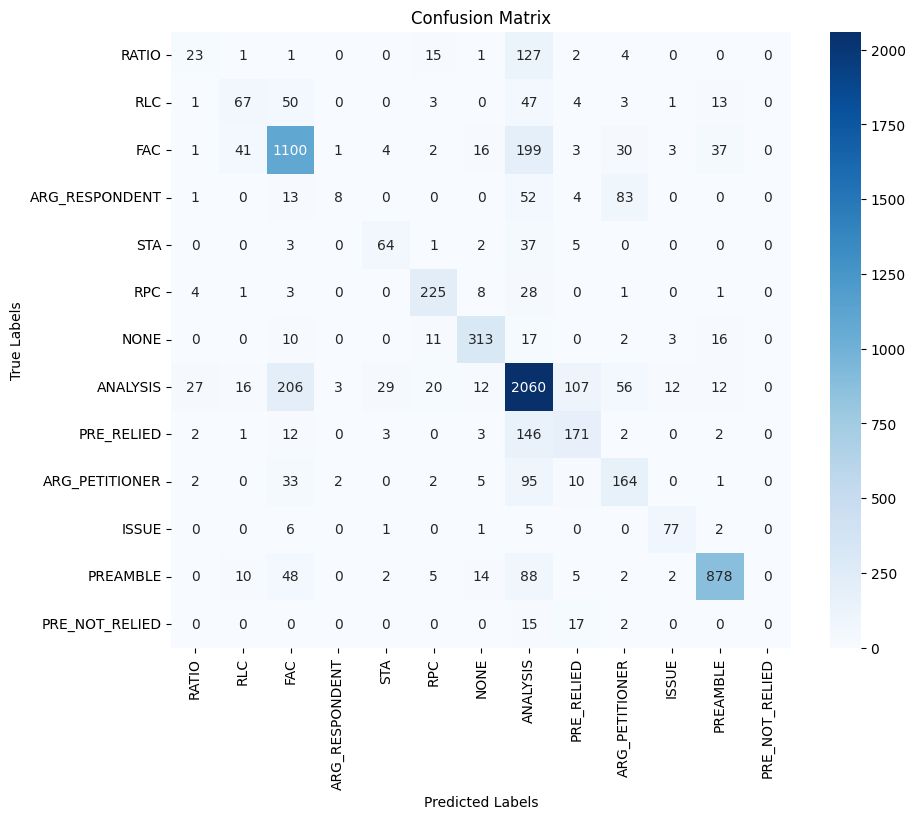

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

predictions = final_trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_labels
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

### Benchmark Split- Model (70-10-20)

#### Using benchmark Train-Test Split (70-10-20)

In [ ]:
!pip install huggingface_hub
!huggingface-cli login

In [ ]:
!pip install datasets
from datasets import load_dataset
# Login using e.g. `huggingface-cli login` to access this dataset
ds = load_dataset("opennyaiorg/InRhetoricalRoles")

In [ ]:
ds

DatasetDict({
    train: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 247
    })
    dev: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 30
    })
    test: Dataset({
        features: ['annotations', 'data', 'meta'],
        num_rows: 50
    })
})

In [ ]:
from datasets import DatasetDict
import pandas as pd

# # Convert each dataset to a pandas DataFrame
# train_df = ds['train'].to_pandas()
# dev_df = ds['dev'].to_pandas()
# test_df = ds['test'].to_pandas()

def preprocess_df_structuring(ds):
  records = []
  for item in ds:
      annotations = item.get('annotations', [])
      for annotation in annotations:
          result = annotation.get('result', [])
          for res in result:
              value = res.get('value', {})
              record = {
                  'start': value.get('start', ''),
                  'end': value.get('end', ''),
                  'text': value.get('text', ''),
                  'labels': ','.join(value.get('labels', [])),
                  'meta_group': item.get('meta', []).get('group','')
              }
              records.append(record)
  df = pd.DataFrame(records)
  print(df.shape)
  return df

train_df = preprocess_df_structuring(ds['train'])
dev_df = preprocess_df_structuring(ds['dev'])
test_df = preprocess_df_structuring(ds['test'])

train_df.head()

(28986, 5)
(2890, 5)
(4158, 5)


,start,end,text,labels,meta_group
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal


In [ ]:
# !pip install -U spacy
# !pip install spacy-transformers
# !python -m spacy download en_core_web_trf
import spacy

# Load the saved model from the directory
nlp = spacy.load("/content/drive/MyDrive/IndianLegalClassification/Code/en_legal_ner_trf")

# # Use it as usual
# doc1 = nlp(x['cleaned_text'])
# doc2 = nlp(x['ner_text'])
# tokens_j = [token.text for token in doc1]
# tokens_ner = [token.text for token in doc2]

# print(len(tokens_j), tokens_j)
# print(len(tokens_ner), tokens_ner)

In [ ]:
def clean_legal_text(text):
    # Remove newlines and excessive spaces
    cleaned_text = text.replace('\n', ' ').strip()
    cleaned_text = " ".join(cleaned_text.split())

    return cleaned_text


def replace_ents_with_labels(text):
    doc = nlp(text)
    processed_text = []
    last_index = 0
    for ent in doc.ents:
        processed_text.append(text[last_index:ent.start_char])
        processed_text.append(ent.label_)
        last_index = ent.end_char
    processed_text.append(text[last_index:])

    return ''.join(processed_text)


def clean_and_split(text):
    text_cleaned = text.translate(str.maketrans('', '', string.punctuation))
    return text_cleaned.split()

def preprocess_dfs(df):

  df['cleaned_text'] = df['text'].apply(clean_legal_text)
  df['ner_text'] = df['cleaned_text'].apply(replace_ents_with_labels)
  df['punct_ner'] = df['ner_text'].apply(clean_and_split)
  return df

train_df = preprocess_dfs(train_df)
dev_df = preprocess_dfs(dev_df)
test_df = preprocess_dfs(test_df)

train_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/train.csv', index=False)
dev_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/dev.csv', index=False)
test_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/test.csv', index=False)
print("Train set shape: ", train_df.shape)
print("Dev set shape: ", dev_df.shape)
print("Test set shape: ", test_df.shape)
train_df.head()



# Apply the function to the 'text' column
df['cleaned_text'] = df['text'].apply(clean_and_split)

/usr/local/lib/python3.10/dist-packages/thinc/shims/pytorch.py:114: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(self._mixed_precision):
/usr/local/lib/python3.10/dist-packages/thinc/shims/pytorch.py:114: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(self._mixed_precision):


Train set shape:  (28986, 7)
Dev set shape:  (2890, 7)
Test set shape:  (4158, 7)


,start,end,text,labels,meta_group,cleaned_text,ner_text
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
x = train_df.iloc[1833]
print(x.cleaned_text)
print(x.ner_text)

Dr. (Ms.) U.K. Kalsi, Advocate for the appellant, Mr. M.K. Pathan, APP for the respondent. ___________________________________________________________________ CRIMINAL APPEAL NO.70 OF 2007 Sau. Vachhalla Kawadu Chauriwal, .... APPELLANT Aged about 68 years, R/o Nehru Nagar, Ghatanji, TahsilGhatanji, District Yavatmal. VERSUS The State of Maharashtra, through PSO Police Station Ghatanji, Tahsil Ghatanji, District Yavatmal. .... RESPONDENT ___________________________________________________________________ Dr. (Ms.) U.K. Kalsi, Advocate for the appellant, Mr. M.K. Pathan, APP for the respondent.
Dr. (Ms.) OTHER_PERSON, Advocate for the appellant, Mr. OTHER_PERSON, APP for the respondent. ___________________________________________________________________ CASE_NUMBER Sau. PETITIONER, .... APPELLANT Aged about 68 years, R/o Nehru Nagar, Ghatanji, TahsilGhatanji, District Yavatmal. VERSUS The RESPONDENT, through PSO Police Station Ghatanji, Tahsil Ghatanji, District Yavatmal. .... RESPONDEN

In [ ]:
!pip install datasets
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
train_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/train.csv')
dev_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/dev.csv')
test_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/test.csv')
train_df.head()

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.3/474.3 kB 14.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 8.9 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
Mounted at /content/drive


,start,end,text,labels,meta_group,cleaned_text,ner_text,punct_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ...",IN THE COURT CIRCUIT BENCH AT GULBARGA DATED T...
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HONBLE MRJUSTICE JUDGE CRIMINAL APP...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day, th...",This appeal coming on for hearing this day the...
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
dev_df.head()

,start,end,text,labels,meta_group,cleaned_text,ner_text
0,0,95,PETITIONER:\nTHE COMMISSIONER OF INCOME-TAXNEW...,PREAMBLE,Tax,PETITIONER: THE COMMISSIONER OF INCOME-TAXNEW ...,PETITIONER: THE PETITIONER Vs. RESPONDENT: M/s...
1,95,143,\n\nDATE OF JUDGMENT:\n05/05/1961\n\nBENCH:\nD...,PREAMBLE,Tax,"DATE OF JUDGMENT: 05/05/1961 BENCH: DAS, S.K.","DATE OF JUDGMENT: DATE BENCH: JUDGE, S.K."
2,143,581,"\nBENCH:\nDAS, S.K.\nHIDAYATULLAH, M.\nSHAH, J...",PREAMBLE,Tax,"BENCH: DAS, S.K. HIDAYATULLAH, M. SHAH, J.C. C...","BENCH: JUDGE, JUDGE, JUDGE, J.C. CITATION: PRE..."
3,582,774,It\nentered into transactions in the nature of...,PREAMBLE,Tax,It entered into transactions in the nature of ...,It entered into transactions in the nature of ...
4,775,855,The assessee claimed deduction of these\nlosse...,PREAMBLE,Tax,The assessee claimed deduction of these losses...,The assessee claimed deduction of these losses...


In [ ]:
test_df.head()

,start,end,text,labels,meta_group,cleaned_text,ner_text
0,0,138,IN THE HIGH COURT OF KARNATAKA\...,PREAMBLE,Tax,IN THE HIGH COURT OF KARNATAKA DHARWAD BENCH D...,IN THE COURT DATED THIS THE DATE
1,180,300,BEFORE\n\nTHE HON'BLE MR. JUSTICE ASHOK G NIJA...,PREAMBLE,Tax,BEFORE THE HON'BLE MR. JUSTICE ASHOK G NIJAGAN...,BEFORE THE HON'BLE MR. JUSTICE JUDGE CASE_NUMB...
2,301,377,CRIMINAL PETITION NOS.100829\n ...,PREAMBLE,Tax,CRIMINAL PETITION NOS.100829 AND 100830 OF 2019,CASE_NUMBER
3,377,632,\n\n IN CRL.P.NO.100827 OF 2019\n BETWEEN:\n...,PREAMBLE,Tax,IN CRL.P.NO.100827 OF 2019 BETWEEN: SHRI BASAV...,IN CASE_NUMBER BETWEEN: SHRI BASAVRAJ S/O. SHI...
4,632,677,"(BY SRI SHIVARAJ S.BALLOLI, ADVOCATE)\n\n AND:",PREAMBLE,Tax,"(BY SRI SHIVARAJ S.BALLOLI, ADVOCATE) AND:","(BY SRI OTHER_PERSON, ADVOCATE) AND:"


##### Preprocessing Benchmark Dataset

In [ ]:
import string
def clean_legal_text(text):
    # Remove newlines and excessive spaces
    cleaned_text = text.replace('\n', ' ').strip()
    cleaned_text = " ".join(cleaned_text.split())

    return cleaned_text

# def replace_ents_with_labels(text):
#     doc = nlp(text)
#     processed_text = []
#     last_index = 0
#     for ent in doc.ents:
#         processed_text.append(text[last_index:ent.start_char])
#         processed_text.append(ent.label_)
#         last_index = ent.end_char
#     processed_text.append(text[last_index:])

#     return ''.join(processed_text)


def clean_and_split(text):
    text_cleaned = text.translate(str.maketrans('', '', string.punctuation))
    return text_cleaned

def preprocess_dfs(df):

  # df['cleaned_text'] = df['text'].apply(clean_legal_text)
  # df['ner_text'] = df['cleaned_text'].apply(replace_ents_with_labels)
  df['punct_ner'] = df['ner_text'].apply(clean_and_split)
  return df

train_df = preprocess_dfs(train_df)
dev_df = preprocess_dfs(dev_df)
test_df = preprocess_dfs(test_df)

train_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/train.csv', index=False)
dev_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/dev.csv', index=False)
test_df.to_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/test.csv', index=False)
print("Train set shape: ", train_df.shape)
print("Dev set shape: ", dev_df.shape)
print("Test set shape: ", test_df.shape)
train_df.head(25)


Train set shape:  (28986, 8)
Dev set shape:  (2890, 8)
Test set shape:  (4158, 8)


,start,end,text,labels,meta_group,cleaned_text,ner_text,punct_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ...",IN THE COURT CIRCUIT BENCH AT GULBARGA DATED T...
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HONBLE MRJUSTICE JUDGE CRIMINAL APP...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day, th...",This appeal coming on for hearing this day the...
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
train_df.iloc[1833].punct_ner

'Dr Ms OTHERPERSON Advocate for the appellant Mr OTHERPERSON APP for the respondent  CASENUMBER Sau PETITIONER  APPELLANT Aged about 68 years Ro Nehru Nagar Ghatanji TahsilGhatanji District Yavatmal VERSUS The RESPONDENT through PSO Police Station Ghatanji Tahsil Ghatanji District Yavatmal  RESPONDENT  Dr Ms OTHERPERSON Advocate for the appellant Mr OTHERPERSON APP for the respondent'

#### Judgment Text- MODEL (0.6938)

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import torch
import numpy as np
from datasets import Dataset

# Load InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts = train_df['cleaned_text'].tolist()
train_labels = train_df['labels'].tolist()

dev_texts = dev_df['cleaned_text'].tolist()
dev_labels = dev_df['labels'].tolist()

test_texts = test_df['cleaned_text'].tolist()
test_labels = test_df['labels'].tolist()

# Get unique labels and map to integers
unique_labels = list(set(train_labels + dev_labels + test_labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}

train_labels = [label_to_int[label] for label in train_labels]
dev_labels = [label_to_int[label] for label in dev_labels]
test_labels = [label_to_int[label] for label in test_labels]

# Define tokenization function
def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

# Tokenize texts
train_encodings = tokenize_function(train_texts)
dev_encodings = tokenize_function(dev_texts)
test_encodings = tokenize_function(test_texts)

# Create dataset from the encodings
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings['input_ids'],
    'attention_mask': dev_encodings['attention_mask'],
    'labels': torch.tensor(dev_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Define compute metrics function
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Set up training arguments
training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Initialize Trainer with train, dev, and test sets
trainer = Trainer(
    model=AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels)),
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate
trainer.train()
results = trainer.evaluate()

# Get evaluation results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Validation Accuracy: {accuracy:.4f}")
print(f"Validation F1 Score: {f1:.4f}")
print("Validation Classification Report:")
print(report)

# Predict on the test dataset
predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
true_labels = predictions.label_ids

# Calculate metrics for the test set
test_accuracy = accuracy_score(true_labels, preds)
test_f1 = f1_score(true_labels, preds, average='weighted')
test_report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test F1 Score: {test_f1:.4f}")
print("Test Classification Report:")
print(test_report)

# Print confusion matrix for the test set
conf_matrix = confusion_matrix(true_labels, preds)
print("Test Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `to

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.058600,1.018873,0.675779,0.659609,"{'0': {'precision': 0.7755102040816326, 'recall': 0.7450980392156863, 'f1-score': 0.76, 'support': 51.0}, '1': {'precision': 0.6206896551724138, 'recall': 0.6206896551724138, 'f1-score': 0.6206896551724138, 'support': 29.0}, '2': {'precision': 0.6207974980453479, 'recall': 0.8052738336713996, 'f1-score': 0.7011037527593819, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6624, 'recall': 0.7125645438898451, 'f1-score': 0.6865671641791045, 'support': 581.0}, '5': {'precision': 0.7169811320754716, 'recall': 0.8260869565217391, 'f1-score': 0.7676767676767676, 'support': 92.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '7': {'precision': 0.9034090909090909, 'recall': 0.828125, 'f1-score': 0.8641304347826086, 'support': 192.0}, '8': {'precision': 0.6019417475728155, 'recall': 0.43661971830985913, 'f1-score': 0.5061224489795918, 'support': 142.0}, '9': {'precision': 0.25675675675675674, 'recall': 0.2714285714285714, 'f1-score': 0.2638888888888889, 'support': 70.0}, '10': {'precision': 0.5573770491803278, 'recall': 0.29310344827586204, 'f1-score': 0.384180790960452, 'support': 116.0}, '11': {'precision': 0.6666666666666666, 'recall': 0.05263157894736842, 'f1-score': 0.0975609756097561, 'support': 38.0}, '12': {'precision': 0.8776041666666666, 'recall': 0.6620825147347741, 'f1-score': 0.7547592385218365, 'support': 509.0}, 'accuracy': 0.6757785467128028, 'macro avg': {'precision': 0.5584718436251686, 'recall': 0.4810541430898091, 'f1-score': 0.49282154750236945, 'support': 2890.0}, 'weighted avg': {'precision': 0.6692272858429973, 'recall': 0.6757785467128028, 'f1-score': 0.6596088165823032, 'support': 2890.0}}"
2,0.891800,1.028959,0.678201,0.669443,"{'0': {'precision': 0.813953488372093, 'recall': 0.6862745098039216, 'f1-score': 0.7446808510638298, 'support': 51.0}, '1': {'precision': 0.5263157894736842, 'recall': 0.6896551724137931, 'f1-score': 0.5970149253731343, 'support': 29.0}, '2': {'precision': 0.6281446540880503, 'recall': 0.8103448275862069, 'f1-score': 0.7077059344552702, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6813380281690141, 'recall': 0.6660929432013769, 'f1-score': 0.6736292428198434, 'support': 581.0}, '5': {'precision': 0.7181818181818181, 'recall': 0.8586956521739131, 'f1-score': 0.7821782178217822, 'support': 92.0}, '6': {'precision': 0.3333333333333333, 'recall': 0.08333333333333333, 'f1-score': 0.13333333333333333, 'support': 72.0}, '7': {'precision': 0.8938547486033519, 'recall': 0.8333333333333334, 'f1-score': 0.862533692722372, 'support': 192.0}, '8': {'precision': 0.5190839694656488, 'recall': 0.4788732394366197, 'f1-score': 0.4981684981684982, 'support': 142.0}, '9': {'precision': 0.32894736842105265, 'recall': 0.35714285714285715, 'f1-score': 0.3424657534246575, 'support': 70.0}, '10': {'precision': 0.5625, 'recall': 0.3103448275862069, 'f1-score': 0.4, 'support': 116.0}, '11': {'precision': 0.52, 'recall': 0.34210526315789475, 'f1-score': 0.4126984126984127, 'support': 38.0}, '12': {'precision': 0.907103825136612, 'recall': 0.6522593320235757, 'f1-score': 0.7588571428571429, 'support': 509.0}, 'accuracy': 0.6782006920415224, 'macro avg': {'precision': 0.5717505402495892, 'recall': 0.5206504070148487, 'f1-score': 0.5317896926721752, 'support': 2890.0}, 'weighted avg': {'precision': 0.6841307039970348, 'recall': 0.6782006920415224, 'f1-score': 0.6694425666470862, 'support': 2890.0}}"
3,0.518600,1.083339,0.678201,0.671909,"{'0': {'precision': 0.8297872340425532, 'recall': 0.7647058823529411, 'f1-score': 0.7959183673469388, 'support': 51.0}, '1': {'precision': 0.5526315789473685, 'recall': 0.7241379310344828, 'f1-score': 0.6268656716417911, 'support': 29.0}, '2': {'precision': 0.6426116838487973, 'recall': 0.7586206896551724, 'f1-score': 0.6958139534

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Validation Accuracy: 0.6758
Validation F1 Score: 0.6596
Validation Classification Report:
{'0': {'precision': 0.7755102040816326, 'recall': 0.7450980392156863, 'f1-score': 0.76, 'support': 51.0}, '1': {'precision': 0.6206896551724138, 'recall': 0.6206896551724138, 'f1-score': 0.6206896551724138, 'support': 29.0}, '2': {'precision': 0.6207974980453479, 'recall': 0.8052738336713996, 'f1-score': 0.7011037527593819, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6624, 'recall': 0.7125645438898451, 'f1-score': 0.6865671641791045, 'support': 581.0}, '5': {'precision': 0.7169811320754716, 'recall': 0.8260869565217391, 'f1-score': 0.7676767676767676, 'support': 92.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '7': {'precision': 0.9034090909090909, 'recall': 0.828125, 'f1-score': 0.8641304347826086, 'support': 192.0}, '8': {'precision': 0.6019417475728155, 'recall': 0.43661971830985913, 'f1-score'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test Accuracy: 0.7066
Test F1 Score: 0.6938
Test Classification Report:
                precision    recall  f1-score   support

         ISSUE       0.82      0.93      0.87        43
           STA       0.85      0.48      0.61        61
      ANALYSIS       0.62      0.83      0.71      1256
PRE_NOT_RELIED       0.00      0.00      0.00         1
           FAC       0.75      0.71      0.73       933
           RPC       0.81      0.80      0.81       197
         RATIO       0.71      0.04      0.07       131
          NONE       0.84      0.76      0.80       250
    PRE_RELIED       0.60      0.60      0.60       141
ARG_PETITIONER       0.55      0.51      0.53       253
           RLC       0.56      0.63      0.59        87
ARG_RESPONDENT       0.57      0.10      0.17        82
      PREAMBLE       0.89      0.75      0.81       723

      accuracy                           0.71      4158
     macro avg       0.66      0.55      0.56      4158
  weighted avg       0.72     

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
test_texts

#### NER Text - MODEL (0.6834)

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import torch
import numpy as np
from datasets import Dataset

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts = train_df['ner_text'].tolist()
train_labels = train_df['labels'].tolist()

dev_texts = dev_df['ner_text'].tolist()
dev_labels = dev_df['labels'].tolist()

test_texts = test_df['ner_text'].tolist()
test_labels = test_df['labels'].tolist()

unique_labels = list(set(train_labels + dev_labels + test_labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}

train_labels = [label_to_int[label] for label in train_labels]
dev_labels = [label_to_int[label] for label in dev_labels]
test_labels = [label_to_int[label] for label in test_labels]

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
dev_encodings = tokenize_function(dev_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings['input_ids'],
    'attention_mask': dev_encodings['attention_mask'],
    'labels': torch.tensor(dev_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels)),
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Validation Accuracy: {accuracy:.4f}")
print(f"Validation F1 Score: {f1:.4f}")
print("Validation Classification Report:")
print(report)

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
true_labels = predictions.label_ids

test_accuracy = accuracy_score(true_labels, preds)
test_f1 = f1_score(true_labels, preds, average='weighted')
test_report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test F1 Score: {test_f1:.4f}")
print("Test Classification Report:")
print(test_report)

conf_matrix = confusion_matrix(true_labels, preds)
print("Test Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.034800,1.008235,0.673702,0.654324,"{'0': {'precision': 0.8125, 'recall': 0.7647058823529411, 'f1-score': 0.7878787878787878, 'support': 51.0}, '1': {'precision': 0.7083333333333334, 'recall': 0.5862068965517241, 'f1-score': 0.6415094339622641, 'support': 29.0}, '2': {'precision': 0.6088856518572469, 'recall': 0.847870182555781, 'f1-score': 0.708774904620602, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6950757575757576, 'recall': 0.6316695352839932, 'f1-score': 0.6618575293056808, 'support': 581.0}, '5': {'precision': 0.7326732673267327, 'recall': 0.8043478260869565, 'f1-score': 0.7668393782383419, 'support': 92.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '7': {'precision': 0.9320987654320988, 'recall': 0.7864583333333334, 'f1-score': 0.8531073446327684, 'support': 192.0}, '8': {'precision': 0.6470588235294118, 'recall': 0.3873239436619718, 'f1-score': 0.4845814977973568, 'support': 142.0}, '9': {'precision': 0.2972972972972973, 'recall': 0.3142857142857143, 'f1-score': 0.3055555555555556, 'support': 70.0}, '10': {'precision': 0.5081967213114754, 'recall': 0.2672413793103448, 'f1-score': 0.3502824858757062, 'support': 116.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '12': {'precision': 0.8198614318706697, 'recall': 0.6974459724950884, 'f1-score': 0.7537154989384289, 'support': 509.0}, 'accuracy': 0.6737024221453287, 'macro avg': {'precision': 0.5201523884256941, 'recall': 0.46827351276291146, 'f1-score': 0.48570018590811476, 'support': 2890.0}, 'weighted avg': {'precision': 0.6579590970078681, 'recall': 0.6737024221453287, 'f1-score': 0.6543239183785511, 'support': 2890.0}}"
2,0.924500,1.040299,0.677855,0.667907,"{'0': {'precision': 0.8409090909090909, 'recall': 0.7254901960784313, 'f1-score': 0.7789473684210526, 'support': 51.0}, '1': {'precision': 0.5675675675675675, 'recall': 0.7241379310344828, 'f1-score': 0.6363636363636364, 'support': 29.0}, '2': {'precision': 0.6234662576687117, 'recall': 0.8245436105476673, 'f1-score': 0.7100436681222707, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6589018302828619, 'recall': 0.6815834767641996, 'f1-score': 0.6700507614213198, 'support': 581.0}, '5': {'precision': 0.7547169811320755, 'recall': 0.8695652173913043, 'f1-score': 0.8080808080808081, 'support': 92.0}, '6': {'precision': 0.4117647058823529, 'recall': 0.09722222222222222, 'f1-score': 0.15730337078651685, 'support': 72.0}, '7': {'precision': 0.9447852760736196, 'recall': 0.8020833333333334, 'f1-score': 0.8676056338028169, 'support': 192.0}, '8': {'precision': 0.5779816513761468, 'recall': 0.44366197183098594, 'f1-score': 0.50199203187251, 'support': 142.0}, '9': {'precision': 0.3150684931506849, 'recall': 0.32857142857142857, 'f1-score': 0.32167832167832167, 'support': 70.0}, '10': {'precision': 0.47692307692307695, 'recall': 0.2672413793103448, 'f1-score': 0.3425414364640884, 'support': 116.0}, '11': {'precision': 0.6, 'recall': 0.3157894736842105, 'f1-score': 0.41379310344827586, 'support': 38.0}, '12': {'precision': 0.9173789173789174, 'recall': 0.6326129666011788, 'f1-score': 0.7488372093023256, 'support': 509.0}, 'accuracy': 0.6778546712802768, 'macro avg': {'precision': 0.5914972191034698, 'recall': 0.516346400566907, 'f1-score': 0.5351721038279955, 'support': 2890.0}, 'weighted avg': {'precision': 0.6873987700796669, 'recall': 0.6778546712802768, 'f1-score': 0.6679067142794812, 'support': 2890.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.034800,1.008235,0.673702,0.654324,"{'0': {'precision': 0.8125, 'recall': 0.7647058823529411, 'f1-score': 0.7878787878787878, 'support': 51.0}, '1': {'precision': 0.7083333333333334, 'recall': 0.5862068965517241, 'f1-score': 0.6415094339622641, 'support': 29.0}, '2': {'precision': 0.6088856518572469, 'recall': 0.847870182555781, 'f1-score': 0.708774904620602, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6950757575757576, 'recall': 0.6316695352839932, 'f1-score': 0.6618575293056808, 'support': 581.0}, '5': {'precision': 0.7326732673267327, 'recall': 0.8043478260869565, 'f1-score': 0.7668393782383419, 'support': 92.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '7': {'precision': 0.9320987654320988, 'recall': 0.7864583333333334, 'f1-score': 0.8531073446327684, 'support': 192.0}, '8': {'precision': 0.6470588235294118, 'recall': 0.3873239436619718, 'f1-score': 0.4845814977973568, 'support': 142.0}, '9': {'precision': 0.2972972972972973, 'recall': 0.3142857142857143, 'f1-score': 0.3055555555555556, 'support': 70.0}, '10': {'precision': 0.5081967213114754, 'recall': 0.2672413793103448, 'f1-score': 0.3502824858757062, 'support': 116.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '12': {'precision': 0.8198614318706697, 'recall': 0.6974459724950884, 'f1-score': 0.7537154989384289, 'support': 509.0}, 'accuracy': 0.6737024221453287, 'macro avg': {'precision': 0.5201523884256941, 'recall': 0.46827351276291146, 'f1-score': 0.48570018590811476, 'support': 2890.0}, 'weighted avg': {'precision': 0.6579590970078681, 'recall': 0.6737024221453287, 'f1-score': 0.6543239183785511, 'support': 2890.0}}"
2,0.924500,1.040299,0.677855,0.667907,"{'0': {'precision': 0.8409090909090909, 'recall': 0.7254901960784313, 'f1-score': 0.7789473684210526, 'support': 51.0}, '1': {'precision': 0.5675675675675675, 'recall': 0.7241379310344828, 'f1-score': 0.6363636363636364, 'support': 29.0}, '2': {'precision': 0.6234662576687117, 'recall': 0.8245436105476673, 'f1-score': 0.7100436681222707, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6589018302828619, 'recall': 0.6815834767641996, 'f1-score': 0.6700507614213198, 'support': 581.0}, '5': {'precision': 0.7547169811320755, 'recall': 0.8695652173913043, 'f1-score': 0.8080808080808081, 'support': 92.0}, '6': {'precision': 0.4117647058823529, 'recall': 0.09722222222222222, 'f1-score': 0.15730337078651685, 'support': 72.0}, '7': {'precision': 0.9447852760736196, 'recall': 0.8020833333333334, 'f1-score': 0.8676056338028169, 'support': 192.0}, '8': {'precision': 0.5779816513761468, 'recall': 0.44366197183098594, 'f1-score': 0.50199203187251, 'support': 142.0}, '9': {'precision': 0.3150684931506849, 'recall': 0.32857142857142857, 'f1-score': 0.32167832167832167, 'support': 70.0}, '10': {'precision': 0.47692307692307695, 'recall': 0.2672413793103448, 'f1-score': 0.3425414364640884, 'support': 116.0}, '11': {'precision': 0.6, 'recall': 0.3157894736842105, 'f1-score': 0.41379310344827586, 'support': 38.0}, '12': {'precision': 0.9173789173789174, 'recall': 0.6326129666011788, 'f1-score': 0.7488372093023256, 'support': 509.0}, 'accuracy': 0.6778546712802768, 'macro avg': {'precision': 0.5914972191034698, 'recall': 0.516346400566907, 'f1-score': 0.5351721038279955, 'support': 2890.0}, 'weighted avg': {'precision': 0.6873987700796669, 'recall': 0.6778546712802768, 'f1-score': 0.6679067142794812, 'support': 2890.0}}"
3,0.563000,1.088527,0.671972,0.663330,"{'0': {'precision': 0.7692307692307693, 'recall': 0.7843137254901961, 'f1-score': 0.7766990291262136, 'support': 51.0}, '1': {'precision': 0.5128205128205128, 'recall': 0.6896551724137931, 'f1-score': 0.5882352941176471, 'support': 29.0}, '2': {'precision': 0.636211232187762, 'recall': 0.7697768762677485, 'f1-score': 0.69664983

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Validation Accuracy: 0.6737
Validation F1 Score: 0.6543
Validation Classification Report:
{'0': {'precision': 0.8125, 'recall': 0.7647058823529411, 'f1-score': 0.7878787878787878, 'support': 51.0}, '1': {'precision': 0.7083333333333334, 'recall': 0.5862068965517241, 'f1-score': 0.6415094339622641, 'support': 29.0}, '2': {'precision': 0.6088856518572469, 'recall': 0.847870182555781, 'f1-score': 0.708774904620602, 'support': 986.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '4': {'precision': 0.6950757575757576, 'recall': 0.6316695352839932, 'f1-score': 0.6618575293056808, 'support': 581.0}, '5': {'precision': 0.7326732673267327, 'recall': 0.8043478260869565, 'f1-score': 0.7668393782383419, 'support': 92.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '7': {'precision': 0.9320987654320988, 'recall': 0.7864583333333334, 'f1-score': 0.8531073446327684, 'support': 192.0}, '8': {'precision': 0.6470588235294118, 'recall': 0.3873239

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test Accuracy: 0.6999
Test F1 Score: 0.6834
Test Classification Report:
                precision    recall  f1-score   support

         ISSUE       0.85      0.93      0.89        43
           STA       0.96      0.44      0.61        61
      ANALYSIS       0.60      0.85      0.70      1256
PRE_NOT_RELIED       0.00      0.00      0.00         1
           FAC       0.78      0.66      0.72       933
           RPC       0.84      0.77      0.80       197
         RATIO       0.80      0.03      0.06       131
          NONE       0.83      0.77      0.80       250
    PRE_RELIED       0.65      0.55      0.59       141
ARG_PETITIONER       0.56      0.53      0.54       253
           RLC       0.57      0.61      0.59        87
ARG_RESPONDENT       0.00      0.00      0.00        82
      PREAMBLE       0.84      0.76      0.80       723

      accuracy                           0.70      4158
     macro avg       0.64      0.53      0.55      4158
  weighted avg       0.71     

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
test_texts = test_df['ner_text'].tolist()
test_texts

#### Test set unprocessed- NER Text (Train, Dev) - Model (0.6831)

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import torch
import numpy as np
from datasets import Dataset

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts = train_df['ner_text'].tolist()
train_labels = train_df['labels'].tolist()

dev_texts = dev_df['ner_text'].tolist()
dev_labels = dev_df['labels'].tolist()

# Unmasked Test set
test_texts = test_df['cleaned_text'].tolist()
test_labels = test_df['labels'].tolist()

unique_labels = list(set(train_labels + dev_labels + test_labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}

train_labels = [label_to_int[label] for label in train_labels]
dev_labels = [label_to_int[label] for label in dev_labels]
test_labels = [label_to_int[label] for label in test_labels]


def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
dev_encodings = tokenize_function(dev_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings['input_ids'],
    'attention_mask': dev_encodings['attention_mask'],
    'labels': torch.tensor(dev_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_testbenchmark',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels)),
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Validation Accuracy: {accuracy:.4f}")
print(f"Validation F1 Score: {f1:.4f}")
print("Validation Classification Report:")
print(report)

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
true_labels = predictions.label_ids

test_accuracy = accuracy_score(true_labels, preds)
test_f1 = f1_score(true_labels, preds, average='weighted')
test_report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test F1 Score: {test_f1:.4f}")
print("Test Classification Report:")
print(test_report)

conf_matrix = confusion_matrix(true_labels, preds)
print("Test Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.030100,1.031368,0.673010,0.657570,"{'0': {'precision': 0.6546052631578947, 'recall': 0.685025817555938, 'f1-score': 0.6694701429772918, 'support': 581.0}, '1': {'precision': 0.5230769230769231, 'recall': 0.29310344827586204, 'f1-score': 0.3756906077348066, 'support': 116.0}, '2': {'precision': 0.9044943820224719, 'recall': 0.8385416666666666, 'f1-score': 0.8702702702702703, 'support': 192.0}, '3': {'precision': 0.7333333333333333, 'recall': 0.8627450980392157, 'f1-score': 0.7927927927927928, 'support': 51.0}, '4': {'precision': 0.5955056179775281, 'recall': 0.3732394366197183, 'f1-score': 0.4588744588744589, 'support': 142.0}, '5': {'precision': 0.6324237560192616, 'recall': 0.7991886409736308, 'f1-score': 0.7060931899641577, 'support': 986.0}, '6': {'precision': 0.4, 'recall': 0.027777777777777776, 'f1-score': 0.05194805194805195, 'support': 72.0}, '7': {'precision': 0.7156862745098039, 'recall': 0.7934782608695652, 'f1-score': 0.7525773195876289, 'support': 92.0}, '8': {'precision': 0.5862068965517241, 'recall': 0.5862068965517241, 'f1-score': 0.5862068965517241, 'support': 29.0}, '9': {'precision': 1.0, 'recall': 0.02631578947368421, 'f1-score': 0.05128205128205128, 'support': 38.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '11': {'precision': 0.8463414634146341, 'recall': 0.6817288801571709, 'f1-score': 0.7551686615886833, 'support': 509.0}, '12': {'precision': 0.27835051546391754, 'recall': 0.38571428571428573, 'f1-score': 0.32335329341317365, 'support': 70.0}, 'accuracy': 0.6730103806228374, 'macro avg': {'precision': 0.6053864942713456, 'recall': 0.48869738451347994, 'f1-score': 0.49182521053731476, 'support': 2890.0}, 'weighted avg': {'precision': 0.6782396545755018, 'recall': 0.6730103806228374, 'f1-score': 0.657569659769828, 'support': 2890.0}}"
2,0.906700,1.040230,0.674740,0.664659,"{'0': {'precision': 0.6684491978609626, 'recall': 0.6454388984509466, 'f1-score': 0.6567425569176882, 'support': 581.0}, '1': {'precision': 0.546875, 'recall': 0.3017241379310345, 'f1-score': 0.3888888888888889, 'support': 116.0}, '2': {'precision': 0.926829268292683, 'recall': 0.7916666666666666, 'f1-score': 0.8539325842696629, 'support': 192.0}, '3': {'precision': 0.7959183673469388, 'recall': 0.7647058823529411, 'f1-score': 0.78, 'support': 51.0}, '4': {'precision': 0.5794392523364486, 'recall': 0.43661971830985913, 'f1-score': 0.4979919678714859, 'support': 142.0}, '5': {'precision': 0.6160241874527589, 'recall': 0.8265720081135902, 'f1-score': 0.7059333044608055, 'support': 986.0}, '6': {'precision': 0.5294117647058824, 'recall': 0.125, 'f1-score': 0.20224719101123595, 'support': 72.0}, '7': {'precision': 0.7383177570093458, 'recall': 0.8586956521739131, 'f1-score': 0.7939698492462312, 'support': 92.0}, '8': {'precision': 0.5128205128205128, 'recall': 0.6896551724137931, 'f1-score': 0.5882352941176471, 'support': 29.0}, '9': {'precision': 0.4827586206896552, 'recall': 0.3684210526315789, 'f1-score': 0.417910447761194, 'support': 38.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '11': {'precision': 0.8954423592493298, 'recall': 0.656188605108055, 'f1-score': 0.7573696145124716, 'support': 509.0}, '12': {'precision': 0.2807017543859649, 'recall': 0.22857142857142856, 'f1-score': 0.25196850393700787, 'support': 70.0}, 'accuracy': 0.6747404844290658, 'macro avg': {'precision': 0.5825375417038832, 'recall': 0.5148660940556774, 'f1-score': 0.5303992463841785, 'support': 2890.0}, 'weighted avg': {'precision': 0.6832936158100056, 'recall': 0.6747404844290658, 'f1-score': 0.6646588456700369, 'support': 2890.0}}"
3,0.524900,1.089157,0.667128,0.658806,"{'0': {'precision': 0.6301369863013698, 'recall': 0.7125645438898451, 'f1-score': 0.6688206785137318, 'support': 581.0}, '1': {'precision': 0.5625, 'recall': 0.3103448275862069, 'f1-score': 0.4, 'support': 116.0}, '2': {'precision': 0.9152542372881356, 'recall': 0.84375, '

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Validation Accuracy: 0.6730
Validation F1 Score: 0.6576
Validation Classification Report:
{'0': {'precision': 0.6546052631578947, 'recall': 0.685025817555938, 'f1-score': 0.6694701429772918, 'support': 581.0}, '1': {'precision': 0.5230769230769231, 'recall': 0.29310344827586204, 'f1-score': 0.3756906077348066, 'support': 116.0}, '2': {'precision': 0.9044943820224719, 'recall': 0.8385416666666666, 'f1-score': 0.8702702702702703, 'support': 192.0}, '3': {'precision': 0.7333333333333333, 'recall': 0.8627450980392157, 'f1-score': 0.7927927927927928, 'support': 51.0}, '4': {'precision': 0.5955056179775281, 'recall': 0.3732394366197183, 'f1-score': 0.4588744588744589, 'support': 142.0}, '5': {'precision': 0.6324237560192616, 'recall': 0.7991886409736308, 'f1-score': 0.7060931899641577, 'support': 986.0}, '6': {'precision': 0.4, 'recall': 0.027777777777777776, 'f1-score': 0.05194805194805195, 'support': 72.0}, '7': {'precision': 0.7156862745098039, 'recall': 0.7934782608695652, 'f1-score': 0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test Accuracy: 0.6977
Test F1 Score: 0.6831
Test Classification Report:
                precision    recall  f1-score   support

           FAC       0.74      0.70      0.72       933
           RLC       0.53      0.57      0.55        87
          NONE       0.83      0.73      0.78       250
         ISSUE       0.82      0.95      0.88        43
    PRE_RELIED       0.59      0.50      0.54       141
      ANALYSIS       0.62      0.81      0.71      1256
         RATIO       0.50      0.05      0.10       131
           RPC       0.85      0.78      0.81       197
           STA       1.00      0.49      0.66        61
ARG_RESPONDENT       0.00      0.00      0.00        82
PRE_NOT_RELIED       0.00      0.00      0.00         1
      PREAMBLE       0.84      0.76      0.80       723
ARG_PETITIONER       0.52      0.55      0.53       253

      accuracy                           0.70      4158
     macro avg       0.60      0.53      0.54      4158
  weighted avg       0.69     

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


##### Punctuation + NER Masking

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import torch
import numpy as np
from datasets import Dataset

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

train_texts = train_df['punct_ner'].tolist()
train_labels = train_df['labels'].tolist()

dev_texts = dev_df['punct_ner'].tolist()
dev_labels = dev_df['labels'].tolist()

# Unmasked Test set
test_texts = test_df['cleaned_text'].tolist()
test_labels = test_df['labels'].tolist()

unique_labels = list(set(train_labels + dev_labels + test_labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}

train_labels = [label_to_int[label] for label in train_labels]
dev_labels = [label_to_int[label] for label in dev_labels]
test_labels = [label_to_int[label] for label in test_labels]

def tokenize_function(texts):
    return tokenizer(
        [str(text) for text in texts],
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
dev_encodings = tokenize_function(dev_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings['input_ids'],
    'attention_mask': dev_encodings['attention_mask'],
    'labels': torch.tensor(dev_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_punctbenchmark',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels)),
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Validation Accuracy: {accuracy:.4f}")
print(f"Validation F1 Score: {f1:.4f}")
print("Validation Classification Report:")
print(report)

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
true_labels = predictions.label_ids

test_accuracy = accuracy_score(true_labels, preds)
test_f1 = f1_score(true_labels, preds, average='weighted')
test_report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test F1 Score: {test_f1:.4f}")
print("Test Classification Report:")
print(test_report)

conf_matrix = confusion_matrix(true_labels, preds)
print("Test Confusion Matrix:")
print(conf_matrix)

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `to

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.078500,1.040456,0.666782,0.647910,"{'0': {'precision': 0.6951219512195121, 'recall': 0.6867469879518072, 'f1-score': 0.6909090909090909, 'support': 581.0}, '1': {'precision': 0.47368421052631576, 'recall': 0.3103448275862069, 'f1-score': 0.375, 'support': 116.0}, '2': {'precision': 0.8819875776397516, 'recall': 0.7395833333333334, 'f1-score': 0.8045325779036827, 'support': 192.0}, '3': {'precision': 0.7636363636363637, 'recall': 0.8235294117647058, 'f1-score': 0.7924528301886793, 'support': 51.0}, '4': {'precision': 0.640625, 'recall': 0.2887323943661972, 'f1-score': 0.39805825242718446, 'support': 142.0}, '5': {'precision': 0.6078431372549019, 'recall': 0.8488843813387424, 'f1-score': 0.7084214980956411, 'support': 986.0}, '6': {'precision': 0.3333333333333333, 'recall': 0.027777777777777776, 'f1-score': 0.05128205128205128, 'support': 72.0}, '7': {'precision': 0.7525773195876289, 'recall': 0.7934782608695652, 'f1-score': 0.7724867724867724, 'support': 92.0}, '8': {'precision': 0.6296296296296297, 'recall': 0.5862068965517241, 'f1-score': 0.6071428571428571, 'support': 29.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '11': {'precision': 0.8471849865951743, 'recall': 0.6208251473477406, 'f1-score': 0.7165532879818595, 'support': 509.0}, '12': {'precision': 0.275, 'recall': 0.3142857142857143, 'f1-score': 0.29333333333333333, 'support': 70.0}, 'accuracy': 0.6667820069204152, 'macro avg': {'precision': 0.5308171930325086, 'recall': 0.4646457794748857, 'f1-score': 0.4777055809039347, 'support': 2890.0}, 'weighted avg': {'precision': 0.6641404518005101, 'recall': 0.6667820069204152, 'f1-score': 0.6479095469261618, 'support': 2890.0}}"
2,0.905200,1.074221,0.660554,0.650851,"{'0': {'precision': 0.6774193548387096, 'recall': 0.6867469879518072, 'f1-score': 0.6820512820512821, 'support': 581.0}, '1': {'precision': 0.463768115942029, 'recall': 0.27586206896551724, 'f1-score': 0.34594594594594597, 'support': 116.0}, '2': {'precision': 0.9177215189873418, 'recall': 0.7552083333333334, 'f1-score': 0.8285714285714286, 'support': 192.0}, '3': {'precision': 0.8181818181818182, 'recall': 0.7058823529411765, 'f1-score': 0.7578947368421053, 'support': 51.0}, '4': {'precision': 0.4774774774774775, 'recall': 0.3732394366197183, 'f1-score': 0.4189723320158103, 'support': 142.0}, '5': {'precision': 0.6130536130536131, 'recall': 0.8002028397565923, 'f1-score': 0.6942366915970084, 'support': 986.0}, '6': {'precision': 0.3, 'recall': 0.08333333333333333, 'f1-score': 0.13043478260869565, 'support': 72.0}, '7': {'precision': 0.7117117117117117, 'recall': 0.8586956521739131, 'f1-score': 0.7783251231527094, 'support': 92.0}, '8': {'precision': 0.5, 'recall': 0.6896551724137931, 'f1-score': 0.5797101449275363, 'support': 29.0}, '9': {'precision': 0.4666666666666667, 'recall': 0.3684210526315789, 'f1-score': 0.4117647058823529, 'support': 38.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, '11': {'precision': 0.8732782369146006, 'recall': 0.6227897838899804, 'f1-score': 0.7270642201834863, 'support': 509.0}, '12': {'precision': 0.27941176470588236, 'recall': 0.2714285714285714, 'f1-score': 0.2753623188405797, 'support': 70.0}, 'accuracy': 0.6605536332179931, 'macro avg': {'precision': 0.5460530983446039, 'recall': 0.49934350657225496, 'f1-score': 0.510025670201457, 'support': 2890.0}, 'weighted avg': {'precision': 0.6646880526594556, 'recall': 0.6605536332179931, 'f1-score': 0.6508506015998685, 'support': 2890.0}}"
3,0.580600,1.113195,0.660554,0.652243,"{'0': {'precision': 0.6512, 'recall': 0.7005163511187608, 'f1-score': 0.6749585406301825, 'support': 581.0}, '1': {'precision': 0.484375, 'recall': 0.2672413793103448, 'f1-score': 0.34444444444444444, 'support': 116.0}, '2': {'precision': 0.8735632183908046, 'recall': 0.7916666666666666, 'f1-score': 0.83060109289617

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Validation Accuracy: 0.6668
Validation F1 Score: 0.6479
Validation Classification Report:
{'0': {'precision': 0.6951219512195121, 'recall': 0.6867469879518072, 'f1-score': 0.6909090909090909, 'support': 581.0}, '1': {'precision': 0.47368421052631576, 'recall': 0.3103448275862069, 'f1-score': 0.375, 'support': 116.0}, '2': {'precision': 0.8819875776397516, 'recall': 0.7395833333333334, 'f1-score': 0.8045325779036827, 'support': 192.0}, '3': {'precision': 0.7636363636363637, 'recall': 0.8235294117647058, 'f1-score': 0.7924528301886793, 'support': 51.0}, '4': {'precision': 0.640625, 'recall': 0.2887323943661972, 'f1-score': 0.39805825242718446, 'support': 142.0}, '5': {'precision': 0.6078431372549019, 'recall': 0.8488843813387424, 'f1-score': 0.7084214980956411, 'support': 986.0}, '6': {'precision': 0.3333333333333333, 'recall': 0.027777777777777776, 'f1-score': 0.05128205128205128, 'support': 72.0}, '7': {'precision': 0.7525773195876289, 'recall': 0.7934782608695652, 'f1-score': 0.772486

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test Accuracy: 0.6809
Test F1 Score: 0.6637
Test Classification Report:
                precision    recall  f1-score   support

           FAC       0.77      0.69      0.73       933
           RLC       0.47      0.62      0.54        87
          NONE       0.84      0.61      0.71       250
         ISSUE       0.76      0.95      0.85        43
    PRE_RELIED       0.56      0.32      0.41       141
      ANALYSIS       0.59      0.84      0.69      1256
         RATIO       0.33      0.03      0.06       131
           RPC       0.84      0.80      0.82       197
           STA       0.88      0.48      0.62        61
ARG_RESPONDENT       0.00      0.00      0.00        82
PRE_NOT_RELIED       0.00      0.00      0.00         1
      PREAMBLE       0.83      0.72      0.77       723
ARG_PETITIONER       0.55      0.50      0.52       253

      accuracy                           0.68      4158
     macro avg       0.57      0.50      0.51      4158
  weighted avg       0.68     

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### All features, no tfidf Benchmark - Model (0.6700)

In [ ]:
!pip install datasets
!pip install optuna
import pandas as pd
from transformers import AutoTokenizer, AutoModel, Trainer, TrainingArguments, DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch
import numpy as np
import os
import torch.nn as nn

os.environ["WANDB_DISABLED"] = "true"

# Assuming df is your DataFrame with columns ['ner_text', 'start', 'end', 'meta_group', 'labels']
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
train_df['label'] = train_df['labels'].map(label_to_int)
dev_df['label'] = dev_df['labels'].map(label_to_int)
test_df['label'] = test_df['labels'].map(label_to_int)

# Initialize tokenizer and model
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize text data
train_encodings = tokenizer(train_df['ner_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
dev_encodings = tokenizer(dev_df['ner_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_df['ner_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Tokenize 'cleaned_text' as well
train_cleaned_encodings = tokenizer(train_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
dev_cleaned_encodings = tokenizer(dev_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_df['cleaned_text'].tolist(), padding=True, truncation=True, max_length=512, return_tensors="pt")

# Convert meta_group to numerical format if it's categorical
train_df['meta_group_id'], _ = pd.factorize(train_df['meta_group'])
dev_df['meta_group_id'], _ = pd.factorize(dev_df['meta_group'])
test_df['meta_group_id'], _ = pd.factorize(test_df['meta_group'])

# Dataset Preparation
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
    'start': torch.tensor(train_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(train_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(train_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(train_df['label'].tolist(), dtype=torch.long)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings['input_ids'],
    'attention_mask': dev_encodings['attention_mask'],
    'cleaned_input_ids': dev_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': dev_cleaned_encodings['attention_mask'],
    'start': torch.tensor(dev_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(dev_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(dev_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(dev_df['label'].tolist(), dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
    'start': torch.tensor(test_df['start'].tolist(), dtype=torch.float),
    'end': torch.tensor(test_df['end'].tolist(), dtype=torch.float),
    'meta_group': torch.tensor(test_df['meta_group_id'].tolist(), dtype=torch.long),
    'labels': torch.tensor(test_df['label'].tolist(), dtype=torch.long)
})

# Define a custom model to handle both text and additional features
class CustomLegalBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(CustomLegalBERTClassifier, self).__init__()
        # Initialize two BERT models for ner_text and cleaned_text
        self.bert_ner_text = AutoModel.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
        self.bert_cleaned_text = AutoModel.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)

        self.meta_embedding = nn.Embedding(len(train_df['meta_group_id'].unique()), 8)
        self.linear1 = nn.Linear(self.bert_ner_text.config.hidden_size * 2 + 8 + 2, 128)
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(128, num_labels)

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, start, end, meta_group, labels=None):
        # Get BERT embeddings for ner_text
        outputs_ner_text = self.bert_ner_text(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output_ner_text = outputs_ner_text.pooler_output

        # Get BERT embeddings for cleaned_text
        outputs_cleaned_text = self.bert_cleaned_text(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask)
        pooled_output_cleaned_text = outputs_cleaned_text.pooler_output

        # Concatenate both BERT embeddings
        combined_bert_output = torch.cat((pooled_output_ner_text, pooled_output_cleaned_text), dim=1)

        # Embed and process additional features
        meta_embedding = self.meta_embedding(meta_group)
        numerical_features = torch.cat((start.unsqueeze(1), end.unsqueeze(1)), dim=1)

        # Concatenate all features
        combined = torch.cat((combined_bert_output, meta_embedding, numerical_features), dim=1)
        combined = self.dropout(self.linear1(combined))
        logits = self.classifier(combined)

        # Calculate loss if labels are provided
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss()
            loss = loss_fn(logits, labels)

        return (loss, logits) if loss is not None else logits

# Instantiate the custom model
model = CustomLegalBERTClassifier(model_name=model_name, num_labels=len(label_to_int))

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/Results/results_benchmark_allfeatures',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    save_total_limit=1,
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    weight_decay=best_params['weight_decay'],
    learning_rate=best_params['learning_rate'],
    load_best_model_at_end=True,
    save_strategy="epoch",
)

# Data collator to handle padding
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Trainer setup
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


Some weights of BertModel were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BertModel were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WAND

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,85.326600,9.398783,0.631488,0.570789,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.5482233502538071, 'recall': 0.7435456110154905, 'f1-score': 0.631117604090577, 'support': 581.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 29.0}, '5': {'precision': 0.45098039215686275, 'recall': 0.25, 'f1-score': 0.32167832167832167, 'support': 92.0}, '6': {'precision': 0.9565217391304348, 'recall': 0.5729166666666666, 'f1-score': 0.7166123778501629, 'support': 192.0}, '7': {'precision': 0.6175839885632595, 'recall': 0.8762677484787018, 'f1-score': 0.7245283018867924, 'support': 986.0}, '8': {'precision': 0.1875, 'recall': 0.04225352112676056, 'f1-score': 0.06896551724137931, 'support': 142.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 70.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 51.0}, '11': {'precision': 0.7722772277227723, 'recall': 0.7662082514734774, 'f1-score': 0.7692307692307693, 'support': 509.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, 'accuracy': 0.6314878892733564, 'macro avg': {'precision': 0.27177589983285666, 'recall': 0.2500916768277767, 'f1-score': 0.24862560707523096, 'support': 2890.0}, 'weighted avg': {'precision': 0.5440526152675439, 'recall': 0.6314878892733564, 'f1-score': 0.5707888514759089, 'support': 2890.0}}"
2,11.362400,1.554513,0.668512,0.651833,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.7356902356902357, 'recall': 0.7521514629948365, 'f1-score': 0.7438297872340426, 'support': 581.0}, '3': {'precision': 0.058823529411764705, 'recall': 0.02631578947368421, 'f1-score': 0.03636363636363636, 'support': 38.0}, '4': {'precision': 0.3, 'recall': 0.20689655172413793, 'f1-score': 0.24489795918367346, 'support': 29.0}, '5': {'precision': 0.8305084745762712, 'recall': 0.532608695652174, 'f1-score': 0.6490066225165563, 'support': 92.0}, '6': {'precision': 0.8910256410256411, 'recall': 0.7239583333333334, 'f1-score': 0.7988505747126436, 'support': 192.0}, '7': {'precision': 0.7179023508137432, 'recall': 0.8052738336713996, 'f1-score': 0.7590822179732314, 'support': 986.0}, '8': {'precision': 0.4090909090909091, 'recall': 0.2535211267605634, 'f1-score': 0.3130434782608696, 'support': 142.0}, '9': {'precision': 0.036036036036036036, 'recall': 0.11428571428571428, 'f1-score': 0.0547945205479452, 'support': 70.0}, '10': {'precision': 0.78125, 'recall': 0.49019607843137253, 'f1-score': 0.6024096385542169, 'support': 51.0}, '11': {'precision': 0.7332214765100671, 'recall': 0.8585461689587426, 'f1-score': 0.7909502262443439, 'support': 509.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, 'accuracy': 0.6685121107266436, 'macro avg': {'precision': 0.4225806656272822, 'recall': 0.36644259656045836, 'f1-score': 0.38409451243008913, 'support': 2890.0}, 'weighted avg': {'precision': 0.646150053581668, 'recall': 0.6685121107266436, 'f1-score': 0.6518326294100748, 'support': 2890.0}}"
3,1.616100,1.174560,0.668858,0.619954,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.5988304093567252, 'recall': 0.8812392426850258, 'f1-score': 0.713091922005571, 'support': 581.0}, '3': {'precision': 0.08333333333333333, 'recall': 0.02631578947368421, 'f1-score': 0.04, 'support': 38.0}, '4': {'precision': 0.13095238095238096, 'recall': 0.3793103448275862, 'f1-score': 0.19469026548672566, 'support': 29.0}, '5': {'precision': 0.8888888888888888, 'recall': 0.5217391304347826, 'f1-score': 0.6575342465753424, 'support': 92

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6976
F1 Score: 0.6573
Classification Report:
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.6545209176788124, 'recall': 0.8347676419965576, 'f1-score': 0.7337367624810892, 'support': 581.0}, '3': {'precision': 0.25, 'recall': 0.05263157894736842, 'f1-score': 0.08695652173913043, 'support': 38.0}, '4': {'precision': 0.5, 'recall': 0.1724137931034483, 'f1-score': 0.2564102564102564, 'support': 29.0}, '5': {'precision': 0.8840579710144928, 'recall': 0.6630434782608695, 'f1-score': 0.7577639751552795, 'support': 92.0}, '6': {'precision': 0.8631578947368421, 'recall': 0.8541666666666666, 'f1-score': 0.8586387434554974, 'support': 192.0}, '7': {'precision': 0.7086267605633803, 'recall': 0.8164300202839757, 'f1-score': 0.7587181903864278, 'support': 986.0}, '8': {'precision': 0.5285714285714286, 'recall': 0.2605633802816901, 'f1-score': 0.3490566037735849, 's

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m


Overall Accuracy: 0.7073
Weighted F1 Score: 0.6700
Classification Report:
                precision    recall  f1-score   support

         RATIO       0.00      0.00      0.00       131
           RLC       0.00      0.00      0.00        87
           FAC       0.71      0.81      0.76       933
ARG_RESPONDENT       0.08      0.02      0.04        82
           STA       0.33      0.07      0.11        61
           RPC       0.96      0.65      0.78       197
          NONE       0.79      0.84      0.82       250
      ANALYSIS       0.69      0.86      0.77      1256
    PRE_RELIED       0.52      0.38      0.44       141
ARG_PETITIONER       0.47      0.33      0.39       253
         ISSUE       0.67      0.09      0.16        43
      PREAMBLE       0.75      0.86      0.80       723
PRE_NOT_RELIED       0.00      0.00      0.00         1

      accuracy                           0.71      4158
     macro avg       0.46      0.38      0.39      4158
  weighted avg       0.65  

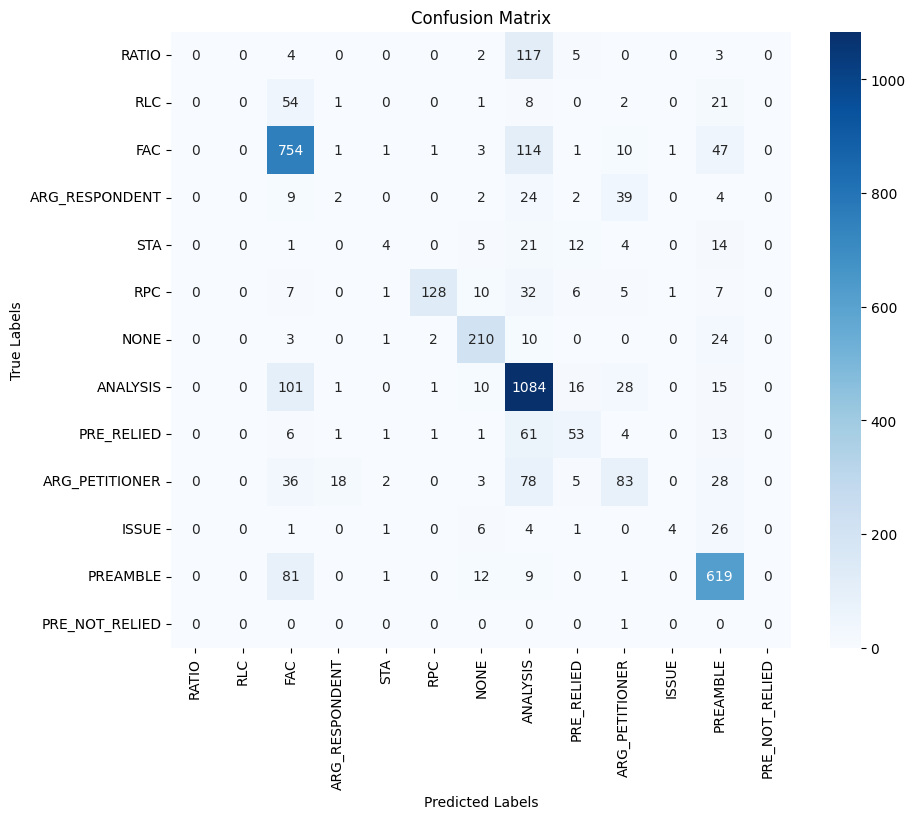

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

f1 = f1_score(true_labels, preds, average='weighted')
accuracy = accuracy_score(true_labels, preds)

# Generate and print classification report
true_labels = test_labels
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print(f"\nOverall Accuracy: {accuracy:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")

print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

### Benchmark Split - BEST MODEL *** (0.7254)

###### All features (Start, end, meta group, Cleaned Text and NER) + TF-iDF Features + FineTuned Model on External SS Dataset

In [ ]:
import pandas as pd
train_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/train.csv')
dev_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/dev.csv')
test_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/test.csv')
train_df.head()

,start,end,text,labels,meta_group,cleaned_text,ner_text,punct_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ...",IN THE COURT CIRCUIT BENCH AT GULBARGA DATED T...
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HONBLE MRJUSTICE JUDGE CRIMINAL APP...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day, th...",This appeal coming on for hearing this day the...
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
import os
import json
import pandas as pd
import torch
import torch.nn as nn
from transformers import AutoTokenizer, TrainingArguments, Trainer, AutoModelForSequenceClassification
from transformers import DataCollatorWithPadding
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import numpy as np

# Disable wandb logs
os.environ["WANDB_DISABLED"] = "true"

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Load the TF-IDF dictionary from JSON
with open('/content/drive/MyDrive/IndianLegalClassification/Code/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Create combined TF-IDF vector per label
def create_combined_tfidf_dict(discriminative_words, max_length=512):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value

    combined_tfidf_vectors = {}
    for label, word_dict in tfidf_dict.items():
        tfidf_vector = list(word_dict.values())
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        combined_tfidf_vectors[label] = tfidf_vector
    return combined_tfidf_vectors

# Create TF-IDF dictionary for appending
combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# Function to get the combined TF-IDF vector based on label
def get_label_tfidf_vector(label, tfidf_dict):
    return np.array(tfidf_dict.get(label, [0.0] * 512))

# Dataset Preparation
train_texts, train_cleaned_texts, train_labels = train_df['ner_text'].tolist(), train_df['cleaned_text'].tolist(), train_df['labels'].tolist()
dev_texts, dev_cleaned_texts, dev_labels = dev_df['ner_text'].tolist(), dev_df['cleaned_text'].tolist(), dev_df['labels'].tolist()
test_texts, test_cleaned_texts, test_labels = test_df['ner_text'].tolist(), test_df['cleaned_text'].tolist(), test_df['labels'].tolist()

# Additional features
train_starts, train_ends = train_df['start'].tolist(), train_df['end'].tolist()
dev_starts, dev_ends = dev_df['start'].tolist(), dev_df['end'].tolist()
test_starts, test_ends = test_df['start'].tolist(), test_df['end'].tolist()

train_df['meta_group_id'], _ = pd.factorize(train_df['meta_group'])
dev_df['meta_group_id'], _ = pd.factorize(dev_df['meta_group'])
test_df['meta_group_id'], _ = pd.factorize(test_df['meta_group'])

train_meta_groups = train_df['meta_group_id'].tolist()
dev_meta_groups = dev_df['meta_group_id'].tolist()
test_meta_groups = test_df['meta_group_id'].tolist()

# Mapping labels to integers
unique_labels = list(set(train_labels + dev_labels + test_labels))
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
train_labels = [label_to_int[label] for label in train_labels]
dev_labels = [label_to_int[label] for label in dev_labels]
test_labels = [label_to_int[label] for label in test_labels]

# Tokenize the texts
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
dev_encodings = tokenizer(dev_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
train_cleaned_encodings = tokenizer(train_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
dev_cleaned_encodings = tokenizer(dev_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_cleaned_encodings = tokenizer(test_cleaned_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

# Add combined TF-IDF features to the encodings
def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
    tfidf_features = [get_label_tfidf_vector(unique_labels[label], tfidf_dict) for label in labels]
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
dev_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(dev_encodings, dev_labels, combined_tfidf_dict)
test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# Define Custom Model with TF-IDF Features
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        self.bert_new_ner = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)
        self.bert_cleaned_text = AutoModelForSequenceClassification.from_pretrained('/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings', num_labels=num_labels)

        self.dropout = nn.Dropout(0.20215365550005596)  # Set to best dropout rate
        hidden_size = self.bert_new_ner.config.hidden_size
        combined_input_size = hidden_size * 2 + tfidf_dim + 3  # new_ner, cleaned_text, tfidf + start, end, meta_group
        self.classifier = nn.Linear(combined_input_size, num_labels)

    def forward(self, input_ids, attention_mask, cleaned_input_ids, cleaned_attention_mask, tfidf_features, start, end, meta_group, labels=None):
        new_ner_outputs = self.bert_new_ner.bert(input_ids=input_ids, attention_mask=attention_mask).pooler_output
        cleaned_text_outputs = self.bert_cleaned_text.bert(input_ids=cleaned_input_ids, attention_mask=cleaned_attention_mask).pooler_output
        combined_embeddings = torch.cat((
            new_ner_outputs,
            cleaned_text_outputs,
            tfidf_features,
            start.unsqueeze(1),
            end.unsqueeze(1),
            meta_group.unsqueeze(1).float()
        ), dim=1)
        combined_embeddings = self.dropout(combined_embeddings)
        logits = self.classifier(combined_embeddings)
        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss()
            loss = loss_fct(logits, labels)
        return (loss, logits) if loss is not None else logits

# Custom DataCollator
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        batch['tfidf_features'] = torch.stack([torch.tensor(f['tfidf_features'], dtype=torch.float) for f in features])
        batch['start'] = torch.stack([torch.tensor(f['start'], dtype=torch.float) for f in features])
        batch['end'] = torch.stack([torch.tensor(f['end'], dtype=torch.float) for f in features])
        batch['meta_group'] = torch.stack([torch.tensor(f['meta_group'], dtype=torch.long) for f in features])
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

# Prepare datasets
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings_with_tfidf['input_ids'],
    'attention_mask': train_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': train_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': train_cleaned_encodings['attention_mask'],
    'tfidf_features': train_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(train_starts, dtype=torch.float),
    'end': torch.tensor(train_ends, dtype=torch.float),
    'meta_group': torch.tensor(train_meta_groups, dtype=torch.long),
    'labels': torch.tensor(train_labels, dtype=torch.long)
})

dev_dataset = Dataset.from_dict({
    'input_ids': dev_encodings_with_tfidf['input_ids'],
    'attention_mask': dev_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': dev_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': dev_cleaned_encodings['attention_mask'],
    'tfidf_features': dev_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(dev_starts, dtype=torch.float),
    'end': torch.tensor(dev_ends, dtype=torch.float),
    'meta_group': torch.tensor(dev_meta_groups, dtype=torch.long),
    'labels': torch.tensor(dev_labels, dtype=torch.long)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings_with_tfidf['input_ids'],
    'attention_mask': test_encodings_with_tfidf['attention_mask'],
    'cleaned_input_ids': test_cleaned_encodings['input_ids'],
    'cleaned_attention_mask': test_cleaned_encodings['attention_mask'],
    'tfidf_features': test_encodings_with_tfidf['tfidf_features'],
    'start': torch.tensor(test_starts, dtype=torch.float),
    'end': torch.tensor(test_ends, dtype=torch.float),
    'meta_group': torch.tensor(test_meta_groups, dtype=torch.long),
    'labels': torch.tensor(test_labels, dtype=torch.long)
})

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {'accuracy': accuracy, 'f1': f1, 'report': report}

# Define training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/Results/Final_Results_benchmark_ALL',
    evaluation_strategy="epoch",
    save_total_limit=1,
    per_device_train_batch_size=best_params['batch_size'],
    per_device_eval_batch_size=best_params['batch_size'],
    num_train_epochs=best_params['num_train_epochs'],
    weight_decay=best_params['weight_decay'],
    learning_rate=best_params['learning_rate'],
    save_strategy="epoch",
    load_best_model_at_end=True,
    logging_dir='./logs'
)

# Initialize and run trainer
model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels), tfidf_dim=512)
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate(test_dataset)
print("Final Evaluation Results:", results)
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Final Accuracy: {accuracy:.4f}")
print(f"Final F1 Score: {f1:.4f}")
print("Final Classification Report:", report)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/fine_tuned_inlegalbert_embeddings and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at /content/drive/My Drive/IndianLegalClas

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,85.214100,2.272439,0.684083,0.638792,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.7065573770491803, 'recall': 0.7418244406196214, 'f1-score': 0.7237615449202351, 'support': 581.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 29.0}, '5': {'precision': 0.8382352941176471, 'recall': 0.6195652173913043, 'f1-score': 0.7125, 'support': 92.0}, '6': {'precision': 0.8505154639175257, 'recall': 0.859375, 'f1-score': 0.8549222797927462, 'support': 192.0}, '7': {'precision': 0.6571648690292758, 'recall': 0.8651115618661258, 'f1-score': 0.7469352014010507, 'support': 986.0}, '8': {'precision': 0.9545454545454546, 'recall': 0.14788732394366197, 'f1-score': 0.25609756097560976, 'support': 142.0}, '9': {'precision': 0.11851851851851852, 'recall': 0.22857142857142856, 'f1-score': 0.15609756097560976, 'support': 70.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 51.0}, '11': {'precision': 0.7708703374777975, 'recall': 0.8526522593320236, 'f1-score': 0.8097014925373134, 'support': 509.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, 'accuracy': 0.684083044982699, 'macro avg': {'precision': 0.3766467165119538, 'recall': 0.3319220947480127, 'f1-score': 0.32769351081558196, 'support': 2890.0}, 'weighted avg': {'precision': 0.6349846940060131, 'recall': 0.684083044982699, 'f1-score': 0.6387921752694192, 'support': 2890.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,85.214100,2.272439,0.684083,0.638792,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 72.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 116.0}, '2': {'precision': 0.7065573770491803, 'recall': 0.7418244406196214, 'f1-score': 0.7237615449202351, 'support': 581.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '4': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 29.0}, '5': {'precision': 0.8382352941176471, 'recall': 0.6195652173913043, 'f1-score': 0.7125, 'support': 92.0}, '6': {'precision': 0.8505154639175257, 'recall': 0.859375, 'f1-score': 0.8549222797927462, 'support': 192.0}, '7': {'precision': 0.6571648690292758, 'recall': 0.8651115618661258, 'f1-score': 0.7469352014010507, 'support': 986.0}, '8': {'precision': 0.9545454545454546, 'recall': 0.14788732394366197, 'f1-score': 0.25609756097560976, 'support': 142.0}, '9': {'precision': 0.11851851851851852, 'recall': 0.22857142857142856, 'f1-score': 0.15609756097560976, 'support': 70.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 51.0}, '11': {'precision': 0.7708703374777975, 'recall': 0.8526522593320236, 'f1-score': 0.8097014925373134, 'support': 509.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, 'accuracy': 0.684083044982699, 'macro avg': {'precision': 0.3766467165119538, 'recall': 0.3319220947480127, 'f1-score': 0.32769351081558196, 'support': 2890.0}, 'weighted avg': {'precision': 0.6349846940060131, 'recall': 0.684083044982699, 'f1-score': 0.6387921752694192, 'support': 2890.0}}"
2,4.275600,0.871702,0.719377,0.715445,"{'0': {'precision': 0.34375, 'recall': 0.1527777777777778, 'f1-score': 0.21153846153846154, 'support': 72.0}, '1': {'precision': 0.5714285714285714, 'recall': 0.3103448275862069, 'f1-score': 0.4022346368715084, 'support': 116.0}, '2': {'precision': 0.7419898819561551, 'recall': 0.7573149741824441, 'f1-score': 0.7495741056218058, 'support': 581.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 38.0}, '4': {'precision': 0.53125, 'recall': 0.5862068965517241, 'f1-score': 0.5573770491803278, 'support': 29.0}, '5': {'precision': 0.7211538461538461, 'recall': 0.8152173913043478, 'f1-score': 0.7653061224489796, 'support': 92.0}, '6': {'precision': 0.9532163742690059, 'recall': 0.8489583333333334, 'f1-score': 0.8980716253443526, 'support': 192.0}, '7': {'precision': 0.7267552182163188, 'recall': 0.7768762677484787, 'f1-score': 0.7509803921568627, 'support': 986.0}, '8': {'precision': 0.45054945054945056, 'recall': 0.5774647887323944, 'f1-score': 0.5061728395061729, 'support': 142.0}, '9': {'precision': 0.18309859154929578, 'recall': 0.37142857142857144, 'f1-score': 0.24528301886792453, 'support': 70.0}, '10': {'precision': 0.7735849056603774, 'recall': 0.803921568627451, 'f1-score': 0.7884615384615384, 'support': 51.0}, '11': {'precision': 0.9094827586206896, 'recall': 0.8290766208251473, 'f1-score': 0.8674203494347379, 'support': 509.0}, '12': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 12.0}, 'accuracy': 0.7193771626297578, 'macro avg': {'precision': 0.531250738338747, 'recall': 0.5253529244690675, 'f1-score': 0.5186477030332826, 'support': 2890.0}, 'weighted avg': {'precision': 0.7206425281254036, 'recall': 0.7193771626297578, 'f1-score': 0.7154449514715927, 'support': 2890.0}}"
3,0.812500,0.895175,0.718685,0.705855,"{'0': {'precision': 0.3684210526315789, 'recall': 0.09722222222222222, 'f1-score': 0.15384615384615385, 'support': 72.0}, '1': {'precision': 0.58, 'recall': 0.25, 'f1-score': 0.3493975903614458, 'support': 116.0}, '2': {'precision': 0.6538987688098495, 'recall': 0.8227194492254734, 'f1-score': 0.7286585365853658, 'support': 581.0}, '3': {'precision': 0.12, 'recall': 0.07894736842105263, 'f1-score': 0.09523809523809523, 'support': 38.0}, '4': {'precision': 0.6, 'recall': 0.6206896551724138, 'f1-score': 0.6101694915254

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Final Evaluation Results: {'eval_loss': 0.8085675835609436, 'eval_accuracy': 0.7328042328042328, 'eval_f1': 0.7253836849230584, 'eval_report': {'0': {'precision': 0.5192307692307693, 'recall': 0.20610687022900764, 'f1-score': 0.29508196721311475, 'support': 131.0}, '1': {'precision': 0.5942028985507246, 'recall': 0.47126436781609193, 'f1-score': 0.5256410256410257, 'support': 87.0}, '2': {'precision': 0.7878440366972477, 'recall': 0.7363344051446945, 'f1-score': 0.7612188365650969, 'support': 933.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 82.0}, '4': {'precision': 0.7090909090909091, 'recall': 0.639344262295082, 'f1-score': 0.6724137931034483, 'support': 61.0}, '5': {'precision': 0.8140703517587939, 'recall': 0.8223350253807107, 'f1-score': 0.8181818181818182, 'support': 197.0}, '6': {'precision': 0.8879310344827587, 'recall': 0.824, 'f1-score': 0.8547717842323651, 'support': 250.0}, '7': {'precision': 0.6943475226796929, 'recall': 0.7921974522292994, 'f1-sc

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Classification Report:
                precision    recall  f1-score   support

         RATIO       0.52      0.21      0.30       131
           RLC       0.59      0.47      0.53        87
           FAC       0.79      0.74      0.76       933
ARG_RESPONDENT       0.00      0.00      0.00        82
           STA       0.71      0.64      0.67        61
           RPC       0.81      0.82      0.82       197
          NONE       0.89      0.82      0.85       250
      ANALYSIS       0.69      0.79      0.74      1256
    PRE_RELIED       0.46      0.69      0.55       141
ARG_PETITIONER       0.47      0.60      0.52       253
         ISSUE       0.80      0.91      0.85        43
      PREAMBLE       0.91      0.83      0.87       723
PRE_NOT_RELIED       0.00      0.00      0.00         1

      accuracy                           0.73      4158
     macro avg       0.59      0.58      0.57      4158
  weighted avg       0.73      0.73      0.73      4158



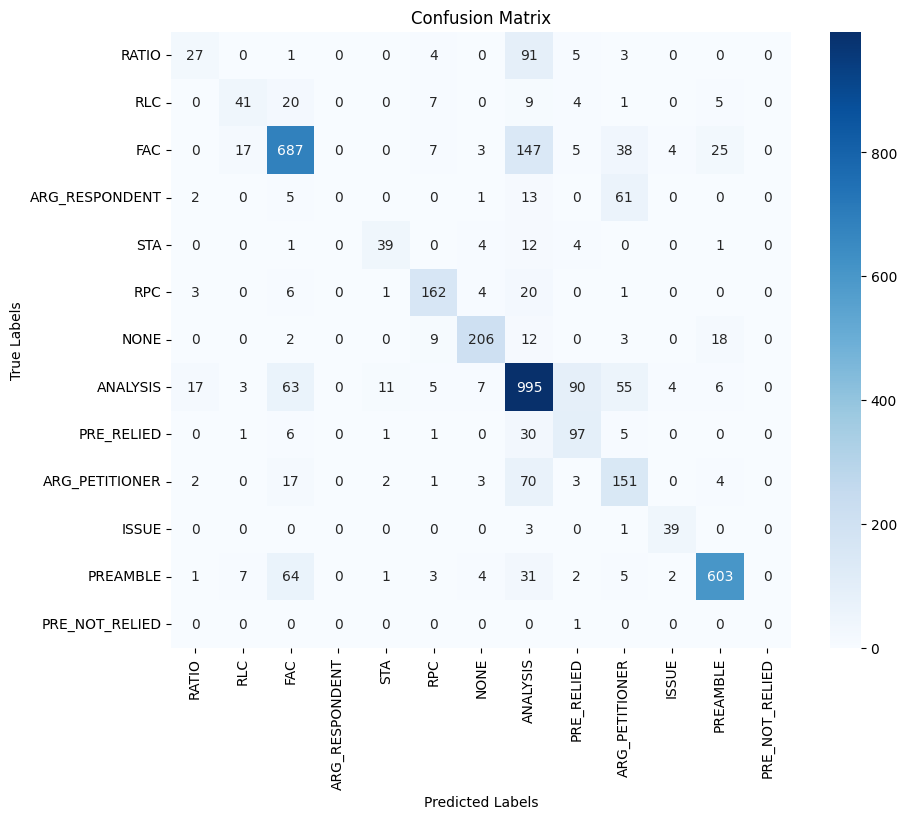

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)
ordered_labels = list(label_to_int.keys())
ordered_label_indices = [label_to_int[label] for label in ordered_labels]

# Generate and print classification report
true_labels = test_labels
report = classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,  # Order based on label_to_int
    target_names=ordered_labels,   # Names for each class
    output_dict=True
)
print("Classification Report:")
print(classification_report(
    true_labels,
    preds,
    labels=ordered_label_indices,
    target_names=ordered_labels
))

# Generate and display confusion matrix
cm = confusion_matrix(
    true_labels,
    preds,
    labels=ordered_label_indices
)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=ordered_labels,
            yticklabels=ordered_labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()

### Semantic Segmentation Dataset

In [ ]:
os.environ["WANDB_DISABLED"] = "true"

texts = ss_df['processed_text'].tolist()
labels = ss_df['label'].tolist()

# Map labels to integers
unique_labels = list(set(labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels))

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=labels
)

# Tokenize & Create Datasets for Classification
train_encodings = tokenizer(train_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")
test_encodings = tokenizer(test_texts, padding=True, truncation=True, max_length=512, return_tensors="pt")

model_name = "law-ai/InLegalBERT"
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(unique_labels)))

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/IndianLegalClassification/Code/SemanticSegmentation/Results/results_80_20ssi',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --rep

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.128100,1.097837,0.624200,0.604726,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 63.0}, '1': {'precision': 0.7363636363636363, 'recall': 0.627906976744186, 'f1-score': 0.6778242677824268, 'support': 129.0}, '2': {'precision': 0.6568627450980392, 'recall': 0.39644970414201186, 'f1-score': 0.4944649446494465, 'support': 169.0}, '3': {'precision': 0.782608695652174, 'recall': 0.34615384615384615, 'f1-score': 0.48, 'support': 52.0}, '4': {'precision': 0.6145251396648045, 'recall': 0.7432432432432432, 'f1-score': 0.672782874617737, 'support': 444.0}, '5': {'precision': 0.6825396825396826, 'recall': 0.4387755102040816, 'f1-score': 0.5341614906832298, 'support': 294.0}, '6': {'precision': 0.5967213114754099, 'recall': 0.7531034482758621, 'f1-score': 0.6658536585365854, 'support': 725.0}, 'accuracy': 0.6242004264392325, 'macro avg': {'precision': 0.5813744586848208, 'recall': 0.4722332469661758, 'f1-score': 0.5035838908956322, 'support': 1876.0}, 'weighted avg': {'precision': 0.6145176677419525, 'recall': 0.6242004264392325, 'f1-score': 0.6047264835926752, 'support': 1876.0}}"
2,1.000200,1.010295,0.643923,0.630619,"{'0': {'precision': 0.4, 'recall': 0.09523809523809523, 'f1-score': 0.15384615384615385, 'support': 63.0}, '1': {'precision': 0.6742424242424242, 'recall': 0.689922480620155, 'f1-score': 0.6819923371647509, 'support': 129.0}, '2': {'precision': 0.7283950617283951, 'recall': 0.34911242603550297, 'f1-score': 0.472, 'support': 169.0}, '3': {'precision': 0.8, 'recall': 0.46153846153846156, 'f1-score': 0.5853658536585366, 'support': 52.0}, '4': {'precision': 0.6230636833046471, 'recall': 0.8153153153153153, 'f1-score': 0.7063414634146341, 'support': 444.0}, '5': {'precision': 0.6258992805755396, 'recall': 0.5918367346938775, 'f1-score': 0.6083916083916084, 'support': 294.0}, '6': {'precision': 0.6508563899868248, 'recall': 0.6813793103448276, 'f1-score': 0.6657681940700808, 'support': 725.0}, 'accuracy': 0.6439232409381663, 'macro avg': {'precision': 0.6432081199768331, 'recall': 0.5263346891123193, 'f1-score': 0.5533865157922521, 'support': 1876.0}, 'weighted avg': {'precision': 0.6446703543583643, 'recall': 0.6439232409381663, 'f1-score': 0.6306188842755029, 'support': 1876.0}}"
3,0.891100,0.995276,0.666311,0.657047,"{'0': {'precision': 0.4090909090909091, 'recall': 0.14285714285714285, 'f1-score': 0.21176470588235294, 'support': 63.0}, '1': {'precision': 0.7327586206896551, 'recall': 0.6589147286821705, 'f1-score': 0.6938775510204082, 'support': 129.0}, '2': {'precision': 0.6764705882352942, 'recall': 0.40828402366863903, 'f1-score': 0.5092250922509225, 'support': 169.0}, '3': {'precision': 0.7567567567567568, 'recall': 0.5384615384615384, 'f1-score': 0.6292134831460674, 'support': 52.0}, '4': {'precision': 0.6679764243614931, 'recall': 0.7657657657657657, 'f1-score': 0.7135362014690452, 'support': 444.0}, '5': {'precision': 0.6714285714285714, 'recall': 0.6394557823129252, 'f1-score': 0.6550522648083623, 'support': 294.0}, '6': {'precision': 0.6555555555555556, 'recall': 0.7324137931034482, 'f1-score': 0.6918566775244299, 'support': 725.0}, 'accuracy': 0.6663113006396588, 'macro avg': {'precision': 0.6528624894454621, 'recall': 0.5551646821216615, 'f1-score': 0.5863608537287984, 'support': 1876.0}, 'weighted avg': {'precision': 0.6627040406711564, 'recall': 0.6663113006396588, 'f1-score': 0.6570474694975206, 'support': 1876.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Trainer is attempting to log a value of "{'0': {'precision': 0.4090909090909091, 'recall': 0.14285714285714285, 'f1-score': 0.21176470588235294, 'support': 63.0}, '1': {'precision': 0.7327586206896551, 'recall': 0.6589147286821705, 'f1-score': 0.6938775510204082, 'support': 129.0}, '2': {'precision': 0.6764705882352942, 'recall': 0.40828402366863903, 'f1-score': 0.5092250922509225, 'support': 169.0}, '3': {'precision': 0.7567567567567568, 'recall': 0.5384615384615384, 'f1-score': 0.6292134831460674, 'support': 52.0}, '4': {'precision': 0.6679764243614931, 'recall': 0.7657657657657657, 'f1-score': 0.7135362014690452, 'support': 444.0}, '5': {'precision': 0.6714285714285714, 'recall': 0.6394557823129252, 'f1-score': 0.6550522648083623, 'support': 294.0}, '6': {'precision': 0.6555555555555556, 'recall': 0.7324137931034482, 'f1-score': 0.6918566775244299, 'support': 725.0}, 'accuracy': 0.6663113006396588, 'macro avg': {'precision': 0.6528624894454621, 'recall': 0.5551646821216615, 'f1-scor

Accuracy: 0.6663
F1 Score: 0.6570
Classification Report:
{'0': {'precision': 0.4090909090909091, 'recall': 0.14285714285714285, 'f1-score': 0.21176470588235294, 'support': 63.0}, '1': {'precision': 0.7327586206896551, 'recall': 0.6589147286821705, 'f1-score': 0.6938775510204082, 'support': 129.0}, '2': {'precision': 0.6764705882352942, 'recall': 0.40828402366863903, 'f1-score': 0.5092250922509225, 'support': 169.0}, '3': {'precision': 0.7567567567567568, 'recall': 0.5384615384615384, 'f1-score': 0.6292134831460674, 'support': 52.0}, '4': {'precision': 0.6679764243614931, 'recall': 0.7657657657657657, 'f1-score': 0.7135362014690452, 'support': 444.0}, '5': {'precision': 0.6714285714285714, 'recall': 0.6394557823129252, 'f1-score': 0.6550522648083623, 'support': 294.0}, '6': {'precision': 0.6555555555555556, 'recall': 0.7324137931034482, 'f1-score': 0.6918566775244299, 'support': 725.0}, 'accuracy': 0.6663113006396588, 'macro avg': {'precision': 0.6528624894454621, 'recall': 0.5551646821

## Explainable AI

In [ ]:
!pip install transformers torch captum interpret bertviz

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch

checkpoint_dir = '/content/drive/MyDrive/Results/results_80_20strat_newner/checkpoint-1778'
tokenizer = AutoTokenizer.from_pretrained(checkpoint_dir)
model = AutoModelForSequenceClassification.from_pretrained(checkpoint_dir)
new_tokens = ["LAWYER", "COURT", "JUDGE", "PETITIONER", "RESPONDENT", "CASE_NUMBER",
              "GPE", "DATE", "ORG", "STATUTE", "WITNESS", "PRECEDENT", "PROVISION", "OTHER_PERSON"]
missing_tokens = [token for token in new_tokens if tokenizer.convert_tokens_to_ids(token) == tokenizer.unk_token_id]
if missing_tokens:
    tokenizer.add_tokens(missing_tokens)
    print(f"Added new tokens: {missing_tokens}")

# Load the model and resize embeddings
model.resize_token_embeddings(len(tokenizer))

import pandas as pd
train_df=pd.read_csv('/content/drive/MyDrive/split_data/train.csv')
test_df=pd.read_csv('/content/drive/MyDrive/split_data/test.csv')

train_texts, train_labels = train_df['new_ner'].tolist(), train_df['labels'].tolist()
test_texts, test_labels = test_df['new_ner'].tolist(), test_df['labels'].tolist()

# Map labels to integers
unique_labels = list(set(train_labels + test_labels))
label_to_int = {
    'RATIO': 0,
    'RLC': 1,
    'FAC': 2,
    'ARG_RESPONDENT': 3,
    'STA': 4,
    'RPC': 5,
    'NONE': 6,
    'ANALYSIS': 7,
    'PRE_RELIED': 8,
    'ARG_PETITIONER': 9,
    'ISSUE': 10,
    'PREAMBLE': 11,
    'PRE_NOT_RELIED': 12
}

Added new tokens: ['LAWYER', 'COURT', 'JUDGE', 'PETITIONER', 'RESPONDENT', 'CASE_NUMBER', 'GPE', 'DATE', 'ORG', 'STATUTE', 'WITNESS', 'PRECEDENT', 'PROVISION', 'OTHER_PERSON']


##### SHAP

In [ ]:
import shap
import numpy as np
import torch

# Function to preprocess and predict with class probabilities
def shap_explanation(text):
    # Define a prediction function for SHAP that returns probabilities
    def f(texts):
        inputs = tokenizer(list(texts), return_tensors="pt", padding=True, truncation=True, max_length=512)
        inputs = {k: v.to(model.device) for k, v in inputs.items()}

        # Get model outputs and convert logits to probabilities
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            probabilities = torch.nn.functional.softmax(logits, dim=-1).cpu().numpy()  # Convert to probabilities
        return probabilities

    # Initialize SHAP explainer with the function and tokenizer
    explainer = shap.Explainer(f, tokenizer)

    # Generate SHAP values for the given text
    shap_values = explainer([text])

    # Get predicted class index and map it to the label using int_to_label
    predicted_class_index = np.argmax(f([text])[0])
    predicted_label = int_to_label[predicted_class_index]

    # Manually create a new Explanation object with output_names set to the custom labels
    custom_shap_values = shap.Explanation(
        values=shap_values.values,
        base_values=shap_values.base_values,
        data=shap_values.data,
        output_names=[int_to_label[i] for i in range(len(int_to_label))]  # Set label names
    )

    # Print the predicted label for clarity
    print(f"Predicted label: {predicted_label}")

    # Display the SHAP explanation plot with custom labels
    shap.plots.text(custom_shap_values[0])

shap_explanation("This Court was thereafter approached against the order of the High Court and special leave to appeal was granted.")

  0%|          | 0/462 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:42, 42.88s/it]               


Predicted label: FAC


##### AnchorText

In [ ]:
# !pip install alibi spacy
# !python -m spacy download en_core_web_sm
import spacy
from alibi.explainers import AnchorText

#nlp = spacy.load("en_core_web_sm")

# Set up AnchorText for rule-based explanations
def anchor_explanation(text, target_class=0):
    # Define a predictor function that returns class probabilities
    def predictor(texts):
        inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")
        inputs = {k: v.to(model.device) for k, v in inputs.items()}  # Move inputs to the correct device

        # Get model outputs and convert logits to probabilities
        with torch.no_grad():
            outputs = model(**inputs)
            probabilities = torch.nn.functional.softmax(outputs.logits, dim=-1).cpu().numpy()  # Convert logits to probabilities
        return probabilities

    # Initialize the AnchorText explainer
    explainer = AnchorText(nlp=nlp, predictor=predictor)

    # Explain the text for the specified target class
    explanation = explainer.explain(text, threshold=0.95, target=target_class)

    # Display explanation details
    print(f"Anchor: {explanation.anchor}")
    print(f"Precision: {explanation.precision}")
    print(f"Coverage: {explanation.coverage}")

    # Optional: Display explanation summary
    for i, anchor in enumerate(explanation.raw['examples']):
        print(f"\nExplanation {i + 1}:")
        print(f"Anchor: {anchor.get('anchor','N/A')}")
        print(f"Precision: {anchor.get('precision','N/A')}")
        print(f"Coverage: {anchor.get('coverage','N/A')}")

    return explanation

# Example
anchor_explanation("This Court was thereafter approached against the order of the High Court and special leave to appeal was granted.",target_class=2)


Anchor: ['thereafter', 'approached', 'granted']
Precision: 0.9778270509977827
Coverage: 0.1271

Explanation 1:
Anchor: N/A
Precision: N/A
Coverage: N/A

Explanation 2:
Anchor: N/A
Precision: N/A
Coverage: N/A

Explanation 3:
Anchor: N/A
Precision: N/A
Coverage: N/A


Explanation(meta={
  'name': 'AnchorText',
  'type': ['blackbox'],
  'explanations': ['local'],
  'params': {'seed': 0, 'sample_proba': 0.5},
  'version': '0.9.6'}
, data={
  'anchor': ['thereafter', 'approached', 'granted'],
  'precision': 0.9778270509977827,
  'coverage': 0.1271,
  'raw': {
           'feature': [3, 4, 18],
           'mean': [0.7591324200913242, 0.9337016574585635, 0.9778270509977827],
           'precision': [0.7591324200913242, 0.9337016574585635, 0.9778270509977827],
           'coverage': [0.5007, 0.2542, 0.1271],
           'examples': [{'covered_true': array(['UNK Court was thereafter approached UNK the order UNK the High Court UNK UNK UNK to appeal UNK granted .',
       'This Court was thereafter approached UNK UNK order UNK the High Court and special leave UNK UNK UNK granted .',
       'UNK Court was thereafter approached UNK UNK UNK of UNK UNK Court UNK special leave to appeal was UNK UNK',
       'This UNK was thereafter UNK UNK UNK UNK UNK the UNK UNK a

##### LIME

In [ ]:
from lime.lime_text import LimeTextExplainer
import numpy as np
import torch

# Set the model in evaluation mode
model.eval()

def lime_explanation(text, num_features=10, num_samples=100):
    # Set up LimeTextExplainer with class names from int_to_label mapping
    class_names = [int_to_label[i] for i in range(model.config.num_labels)]
    explainer = LimeTextExplainer(class_names=class_names)

    # Define a prediction function for LIME that returns probabilities for each label
    def predict_proba(texts):
        # Tokenize the list of texts and process inputs
        inputs = tokenizer(texts, return_tensors="pt", padding=True, truncation=True, max_length=512)
        inputs = {k: v.to(model.device) for k, v in inputs.items()}

        # Get model outputs and convert logits to probabilities
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits[:, :model.config.num_labels]  # Select relevant portion
            probabilities = torch.nn.functional.softmax(logits, dim=-1).cpu().numpy()
        return probabilities

    # Run LIME's explain_instance with reduced num_samples to avoid memory issues
    # Get the predicted class for the original text
    predicted_class = np.argmax(predict_proba([text])[0])

    # Explanation instance with text, predict_proba, and class name mapping
    exp = explainer.explain_instance(
        text,
        predict_proba,
        num_features=num_features,
        num_samples=num_samples,
        labels=(predicted_class,)  # Pass the predicted class as a tuple
    )

    # Display the explanation in terms of class labels
    exp.show_in_notebook(text=text)

# Example usage with optimized settings for multi-class
lime_explanation(
    "This Court was thereafter approached against the order of the High Court and special leave to appeal was granted.",
    num_features=10,
    num_samples=100
) #FAC


## LLMs - T5 Model ***

In [ ]:
import pandas as pd
train_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/train.csv')
dev_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/dev.csv')
test_df = pd.read_csv('/content/drive/My Drive/IndianLegalClassification/Code/Benchmark_Dataset/test.csv')

test_texts = test_df['ner_text'].tolist()
test_labels = test_df['labels'].tolist()
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
test_labels = [label_to_int[label] for label in test_labels]
print(len(test_texts), train_df.shape, dev_df.shape, test_df.shape)
test_df.head()

4158 (28986, 10) (2890, 10) (4158, 10)


,start,end,text,labels,meta_group,cleaned_text,ner_text,punct_ner,meta_group_id,label
0,0,138,IN THE HIGH COURT OF KARNATAKA\...,PREAMBLE,Tax,IN THE HIGH COURT OF KARNATAKA DHARWAD BENCH D...,IN THE COURT DATED THIS THE DATE,IN THE COURT DATED THIS THE DATE,0,11
1,180,300,BEFORE\n\nTHE HON'BLE MR. JUSTICE ASHOK G NIJA...,PREAMBLE,Tax,BEFORE THE HON'BLE MR. JUSTICE ASHOK G NIJAGAN...,BEFORE THE HON'BLE MR. JUSTICE JUDGE CASE_NUMB...,BEFORE THE HONBLE MR JUSTICE JUDGE CASENUMBER CW,0,11
2,301,377,CRIMINAL PETITION NOS.100829\n ...,PREAMBLE,Tax,CRIMINAL PETITION NOS.100829 AND 100830 OF 2019,CASE_NUMBER,CASENUMBER,0,11
3,377,632,\n\n IN CRL.P.NO.100827 OF 2019\n BETWEEN:\n...,PREAMBLE,Tax,IN CRL.P.NO.100827 OF 2019 BETWEEN: SHRI BASAV...,IN CASE_NUMBER BETWEEN: SHRI BASAVRAJ S/O. SHI...,IN CASENUMBER BETWEEN SHRI BASAVRAJ SO SHIVAPP...,0,11
4,632,677,"(BY SRI SHIVARAJ S.BALLOLI, ADVOCATE)\n\n AND:",PREAMBLE,Tax,"(BY SRI SHIVARAJ S.BALLOLI, ADVOCATE) AND:","(BY SRI OTHER_PERSON, ADVOCATE) AND:",BY SRI OTHERPERSON ADVOCATE AND,0,11


In [ ]:
from transformers import AutoTokenizer, AutoModelForCausalLM, AutoModelForSeq2SeqLM
import torch

# Define model names
model_names = {
    "GPT-Neo": "EleutherAI/gpt-neo-2.7B",
    "GPT-J": "EleutherAI/gpt-j-6B",
    "T5": "t5-base" #or google/flan-t5-base
}

# Load the tokenizer and model for GPT-Neo or GPT-J
def load_model_and_tokenizer(model_name):
    if model_name in ["GPT-Neo", "GPT-J"]:
        tokenizer = AutoTokenizer.from_pretrained(model_names[model_name])
        model = AutoModelForCausalLM.from_pretrained(model_names[model_name])
    elif model_name == "T5":
        tokenizer = AutoTokenizer.from_pretrained(model_names[model_name])
        model = AutoModelForSeq2SeqLM.from_pretrained(model_names[model_name])
    return model, tokenizer

# Define zero-shot classification function
def zero_shot_classification(text, model, tokenizer, labels):
    if "t5" in model.config.name_or_path.lower():
        # T5 format for prompting
        prompt = f"Classify the following legal text into one of the categories: {', '.join(labels)}. Text: {text}"
        inputs = tokenizer(prompt, return_tensors="pt")
        outputs = model.generate(**inputs)
        prediction = tokenizer.decode(outputs[0], skip_special_tokens=True)
    else:
        # GPT-Neo or GPT-J format for prompting
        prompt = f"Classify the following legal text into one of the categories: {', '.join(labels)}.\nText: {text}\nCategory:"
        inputs = tokenizer(prompt, return_tensors="pt")
        outputs = model.generate(inputs['input_ids'], max_length=inputs['input_ids'].shape[1] + 10, pad_token_id=tokenizer.eos_token_id)
        prediction = tokenizer.decode(outputs[0], skip_special_tokens=True).split("Category:")[-1].strip()

    return prediction

# Example usage
labels = [
    "RATIO", "RLC", "FAC", "ARG_RESPONDENT", "STA", "RPC", "NONE",
    "ANALYSIS", "PRE_RELIED", "ARG_PETITIONER", "ISSUE", "PREAMBLE", "PRE_NOT_RELIED"
]


In [ ]:
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
# Initialize lists to store true and predicted labels
true_labels = []
predicted_labels = []
test_texts = test_df['ner_text'].tolist()
test_labels = test_df['labels'].tolist()
label_to_int = {
    'RATIO': 0, 'RLC': 1, 'FAC': 2, 'ARG_RESPONDENT': 3, 'STA': 4,
    'RPC': 5, 'NONE': 6, 'ANALYSIS': 7, 'PRE_RELIED': 8, 'ARG_PETITIONER': 9,
    'ISSUE': 10, 'PREAMBLE': 11, 'PRE_NOT_RELIED': 12
}
test_labels = [label_to_int[label] for label in test_labels]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.20k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/1.40k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

Predicting labels:   0%|          | 0/4158 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1258: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
Predicting labels: 100%|██████████| 4158/4158 [47:44<00:00,  1.45it/s]


Accuracy: 0.0606
Weighted F1 Score: 0.0273
Classification Report:
                precision    recall  f1-score   support

         RATIO       0.00      0.00      0.00       131
           RLC       0.03      0.08      0.05        86
           FAC       0.14      0.00      0.01       922
ARG_RESPONDENT       0.00      0.00      0.00        81
           STA       0.03      0.05      0.04        61
           RPC       0.08      0.04      0.05       197
          NONE       0.07      0.76      0.12       237
      ANALYSIS       0.38      0.00      0.01      1239
    PRE_RELIED       0.00      0.00      0.00       139
ARG_PETITIONER       0.08      0.04      0.05       252
         ISSUE       0.03      0.12      0.05        42
      PREAMBLE       0.07      0.04      0.05       705
PRE_NOT_RELIED       0.00      0.00      0.00         1

      accuracy                           0.06      4093
     macro avg       0.07      0.09      0.03      4093
  weighted avg       0.17      0.06 

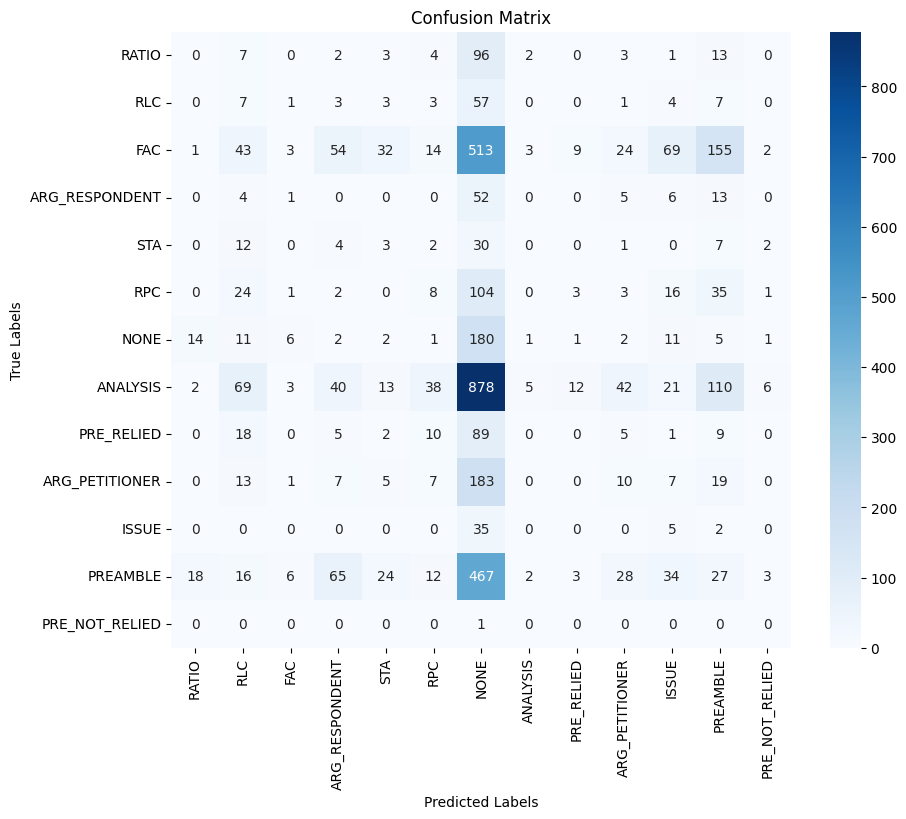

In [ ]:
model_name = "T5"  # or "GPT-J" or "T5"
model, tokenizer = load_model_and_tokenizer(model_name)

# Run zero-shot classification for the entire test dataset
for text, true_label in tqdm(zip(test_texts, test_labels), total=len(test_texts), desc="Predicting labels"):
    prediction = zero_shot_classification(text, model, tokenizer, labels)
    true_labels.append(true_label)  # Store true label as an integer
    predicted_labels.append(prediction)  # Store predicted label as text

# Map predicted label names back to integers to match true labels
predicted_labels_int = [label_to_int[label] if label in label_to_int else None for label in predicted_labels]

# Remove any None values in case of invalid predictions
true_labels_filtered = []
predicted_labels_filtered = []
for true, pred in zip(true_labels, predicted_labels_int):
    if pred is not None:
        true_labels_filtered.append(true)
        predicted_labels_filtered.append(pred)

# Calculate metrics
accuracy = accuracy_score(true_labels_filtered, predicted_labels_filtered)
f1 = f1_score(true_labels_filtered, predicted_labels_filtered, average='weighted')
report = classification_report(true_labels_filtered, predicted_labels_filtered, target_names=labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

# Generate confusion matrix
cm = confusion_matrix(true_labels_filtered, predicted_labels_filtered)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()